## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Packages

In [4]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed

%matplotlib inline

## Compute the camera calibration using chessboard images

The images are in the `./camera_cal` folder. Use the CV2 `findChessboardCorners` function to find the corners and add them to the image points list. We can then use this list and the list of object points in the CV2 `calibrateCamera` function to get the camera distortion coefficients.

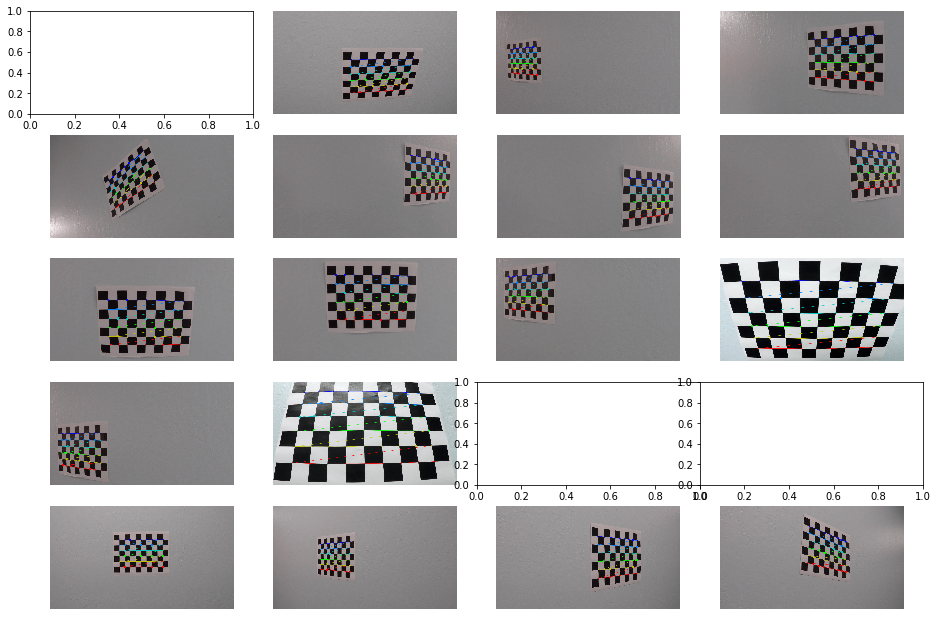

In [5]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners

for i, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        axs[i].axis('off')
        axs[i].imshow(img)

*** Note that some of the images do not show because the chessboard corners were not found (ret == False).

### Calculate the disortion coefficients

In [6]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print("Camera Matrix")
print(mtx)
print("Distortion Coeffs")
print(dist)

Camera Matrix
[[  1.15396093e+03   0.00000000e+00   6.69705357e+02]
 [  0.00000000e+00   1.14802496e+03   3.85656234e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
Distortion Coeffs
[[ -2.41017956e-01  -5.30721173e-02  -1.15810355e-03  -1.28318856e-04
    2.67125290e-02]]


### Helper function to apply the distortion correction to an image

In [7]:
def undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

### Example of applying distortion correction to an image

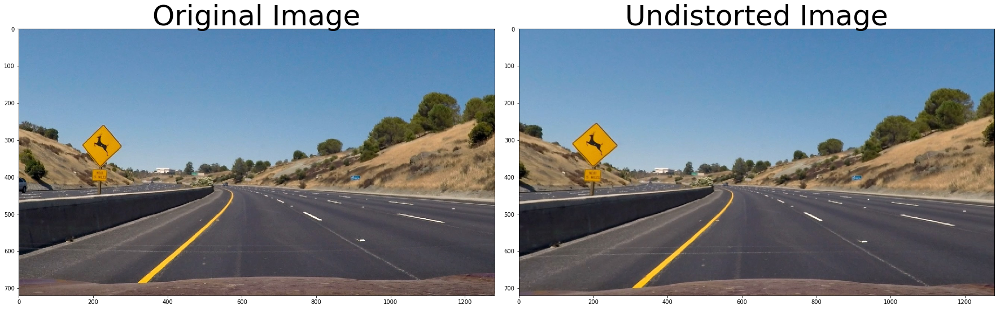

In [8]:
fname = './test_images/test2.jpg'

img = mpimg.imread(fname)

# Use the undistort function, with the mtx and dist calculated above
undist = undistort(img, mtx, dist)

### print an example plot of a comparison of a distorted and undistorted image
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

The undistorted image looks different around the sign and on the hood of the car.

# Perspective Transform

### Helper function to add lines to an image
this will help us view the prospective transforms

In [43]:
def add_lines(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = 2
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.line(img2, (x0, y0), (x1, y1), color, thickness)
    cv2.line(img2, (x1, y1), (x2, y2), color, thickness)
    cv2.line(img2, (x2, y2), (x3, y3), color, thickness)
    cv2.line(img2, (x3, y3), (x0, y0), color, thickness)
    return img2

In [44]:
def add_points(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = -1
    radius = 15
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.circle(img2, (x0, y0), radius, color, thickness)
    cv2.circle(img2, (x1, y1), radius, color, thickness)
    cv2.circle(img2, (x2, y2), radius, color, thickness)
    cv2.circle(img2, (x3, y3), radius, color, thickness)
    return img2

#### Function to warp images based on source and destination points

In [45]:
# Points for the original image
src = np.float32([
    [150, 720],
    [590, 450], 
    [690, 450], 
    [1150, 720]
])

# Points for the new image
dst = np.float32([
    [250, 720],
    [250, 0], 
    [1035, 0], 
    [1035, 720]
])

def warper(img):
    
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped

def unwarp(img):
    
    # Compute and apply inverse perpective transform
    img_size = (img.shape[1], img.shape[0])
    Minv = cv2.getPerspectiveTransform(dst, src)
    unwarped = cv2.warpPerspective(img, Minv, img_size, flags=cv2.INTER_NEAREST)
    
    return unwarped

#### Generate warped perspectives for the straight lines to calibrate the points

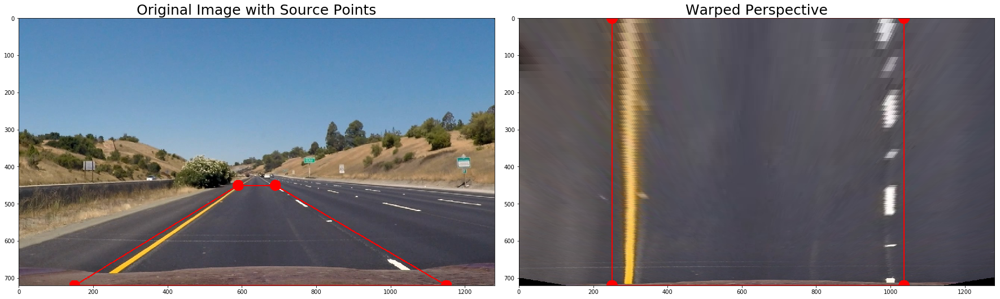

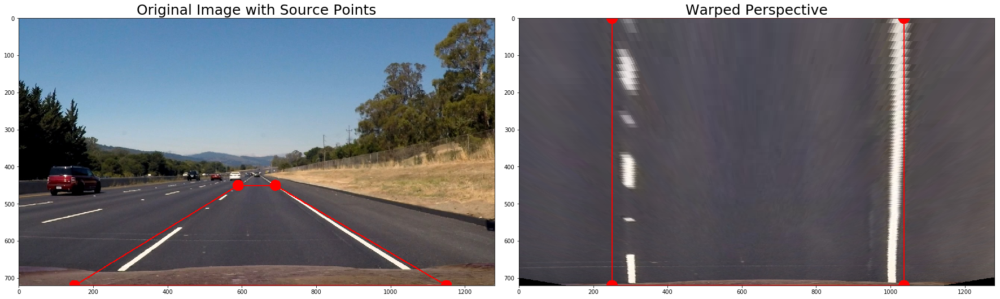

In [46]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/straight*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    src_points_img = add_lines(src_points_img, src)
    dst_points_warped = add_points(warped, dst)
    dst_points_warped = add_lines(dst_points_warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#### Run these settings over all the images and take a look

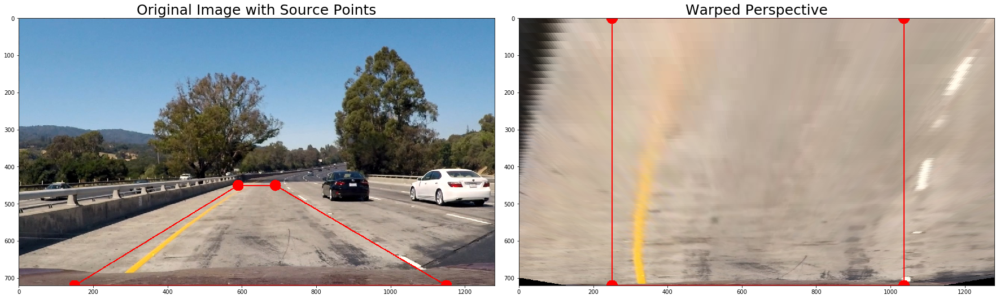

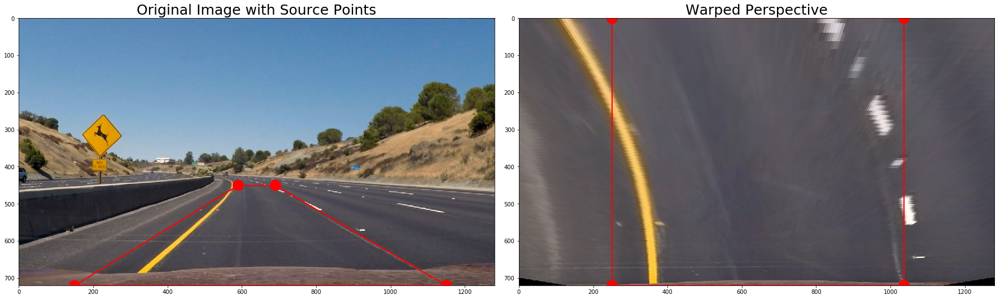

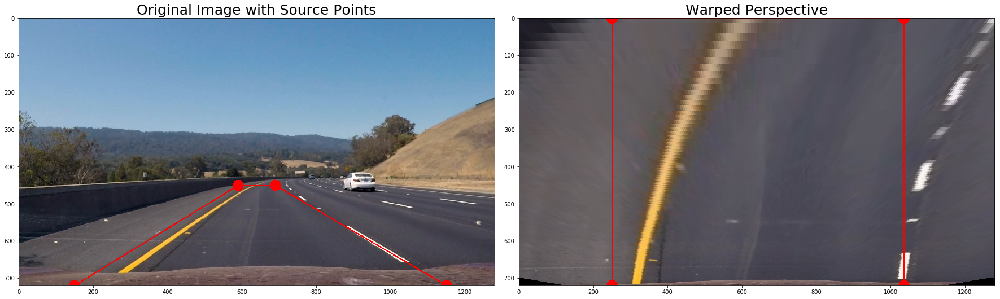

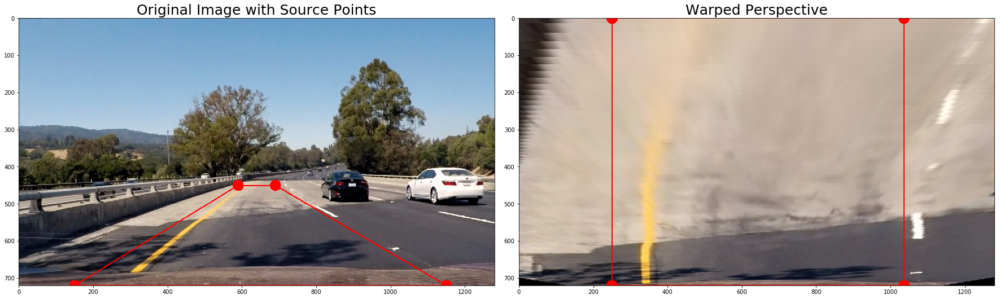

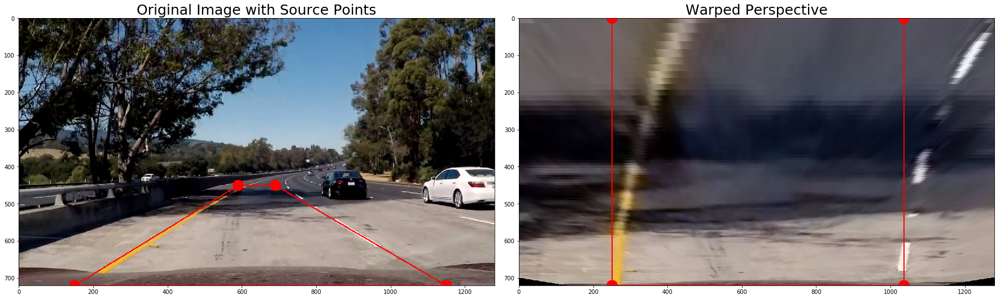

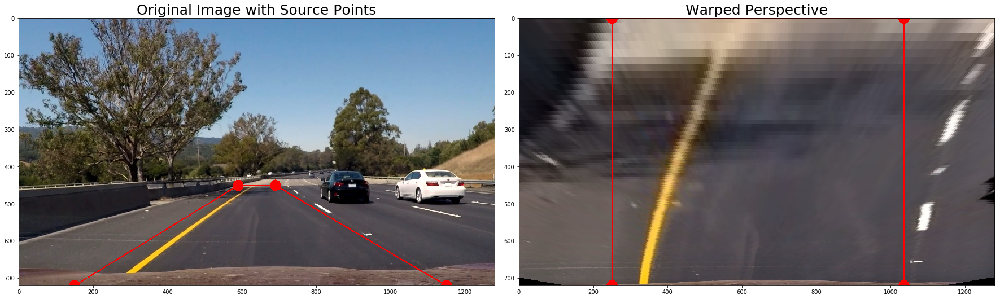

In [47]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    src_points_img = add_lines(src_points_img, src)
    dst_points_warped = add_points(warped, dst)
    dst_points_warped = add_lines(dst_points_warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

That looks pretty good! We're capturing most of the line information with the transform

# Investigation for binary threshold images

Loop through all the test images and take a look at the different channels for each type of color (RGB, HLS, HSV) to try and see which ones might work best for the binary thresholding

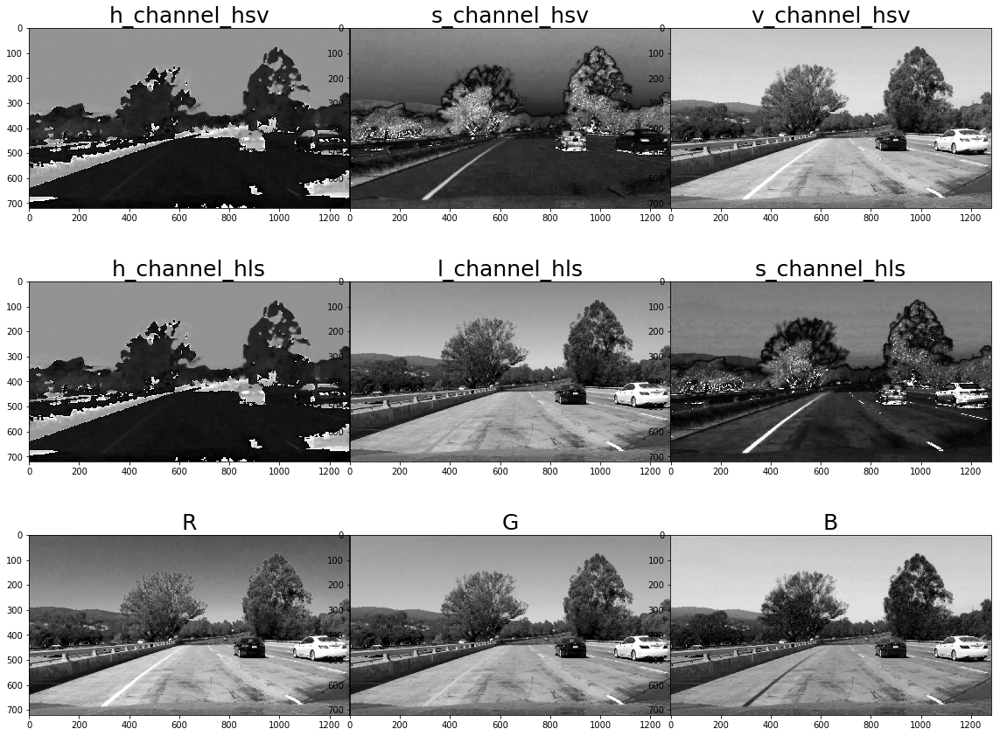

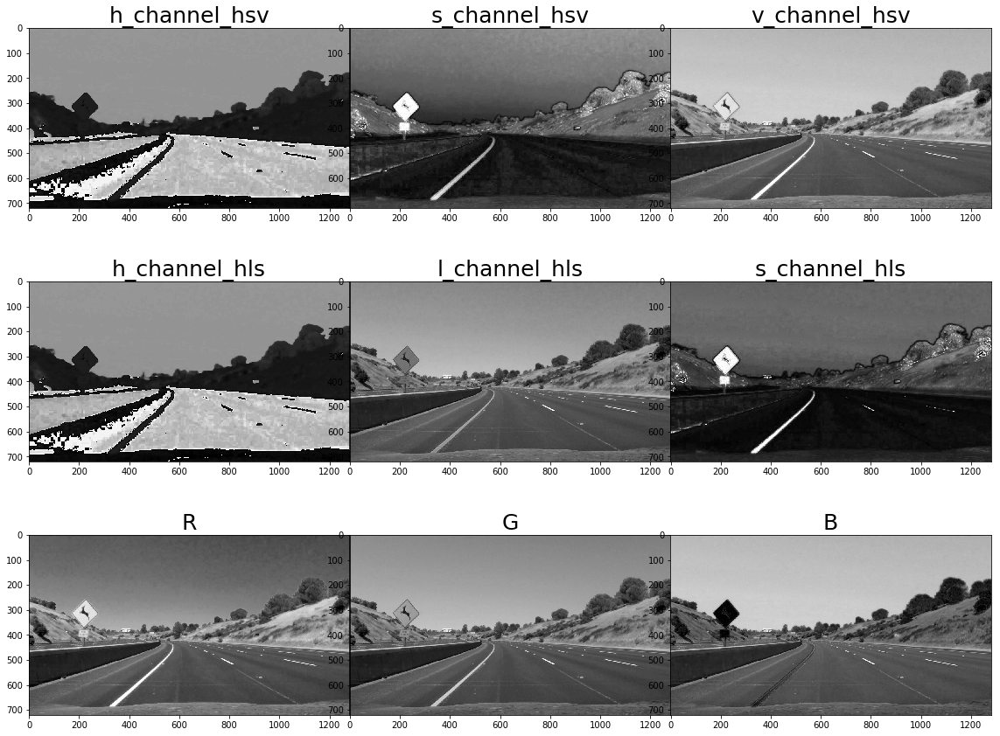

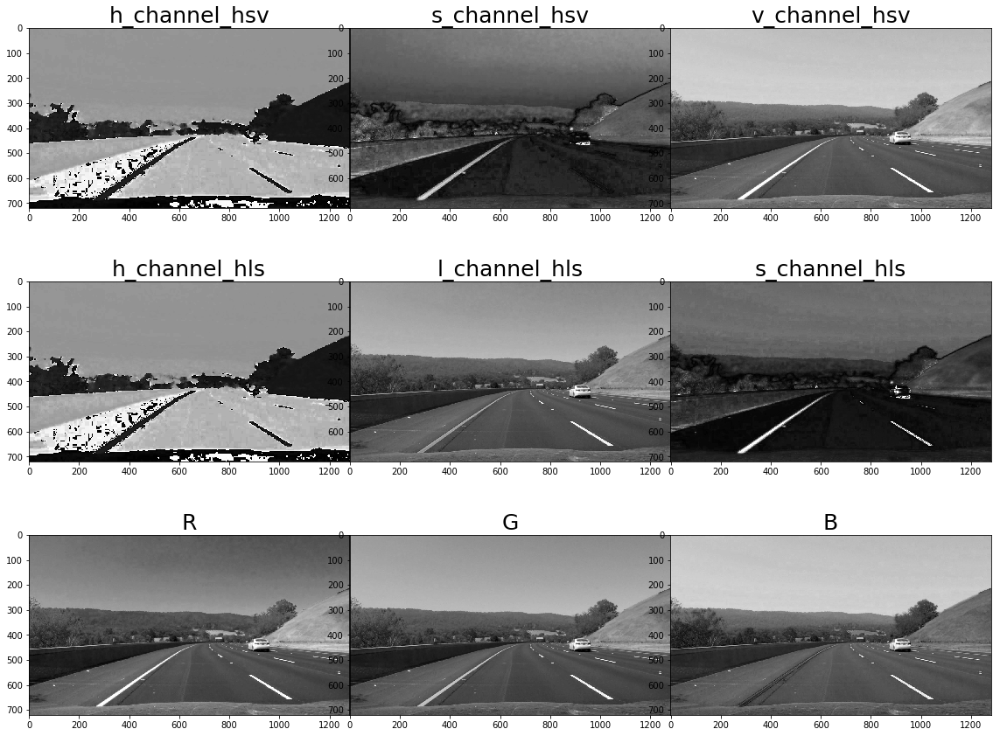

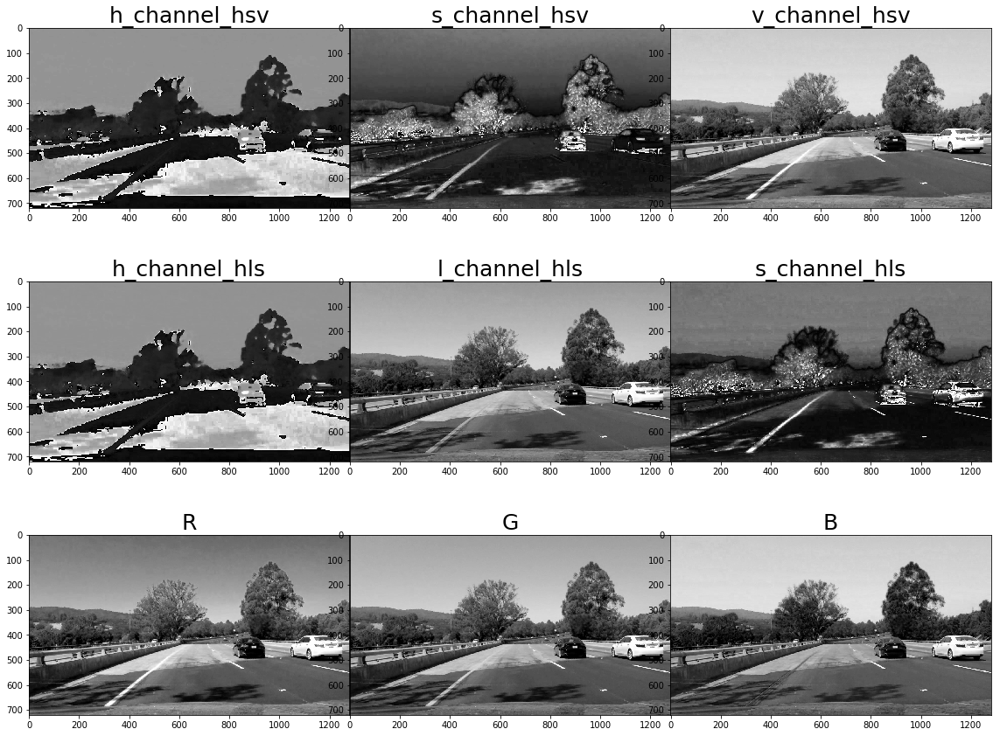

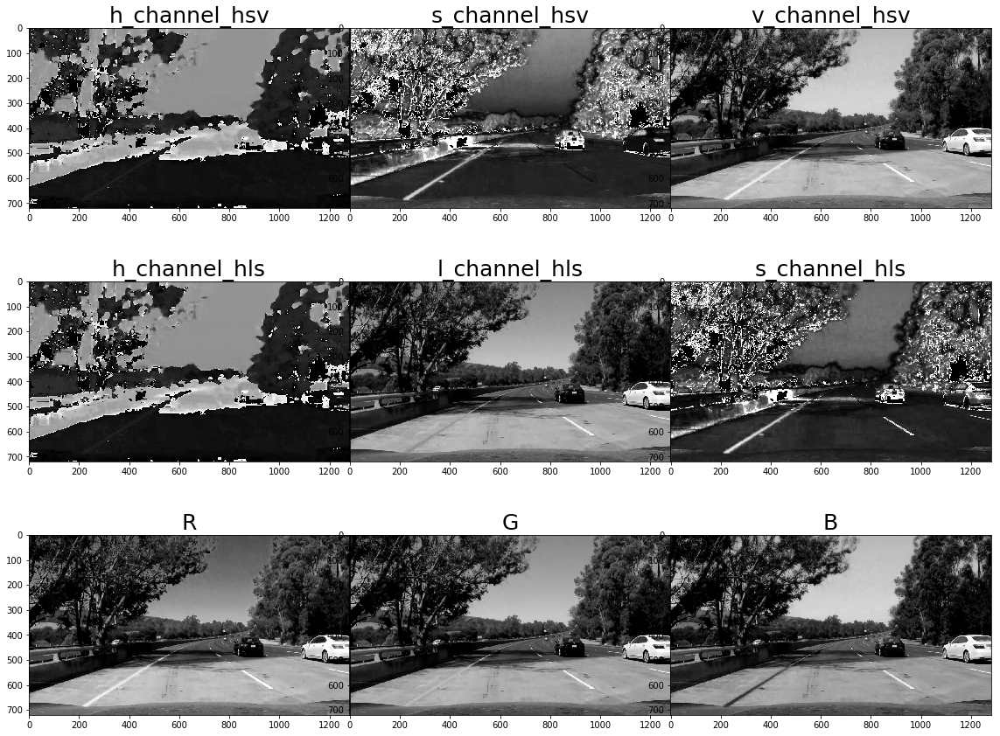

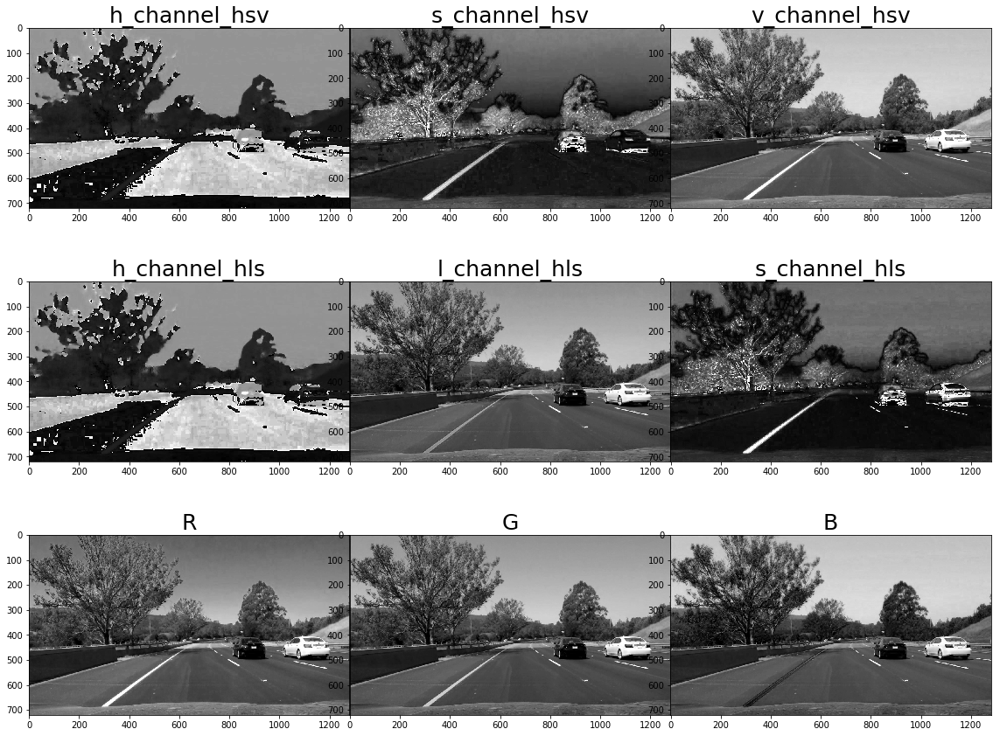

In [48]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.float)

    # Separate the RGB
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize=(16, 12))
    f.tight_layout()

    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.set_title('h_channel_hsv', fontsize=25)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=25)
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=25)
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.set_title('h_channel_hls', fontsize=25)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=25)
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=25)

    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=25)
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=25)
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=25)

    plt.subplots_adjust(hspace = .2, wspace=.001)


From these images, it looks like the saturation channels could provide good data, also the V from HSV and the L from HLS. The Red channel from RGB could be promising as well.

### Do the same thing, but look at images with perspective transform

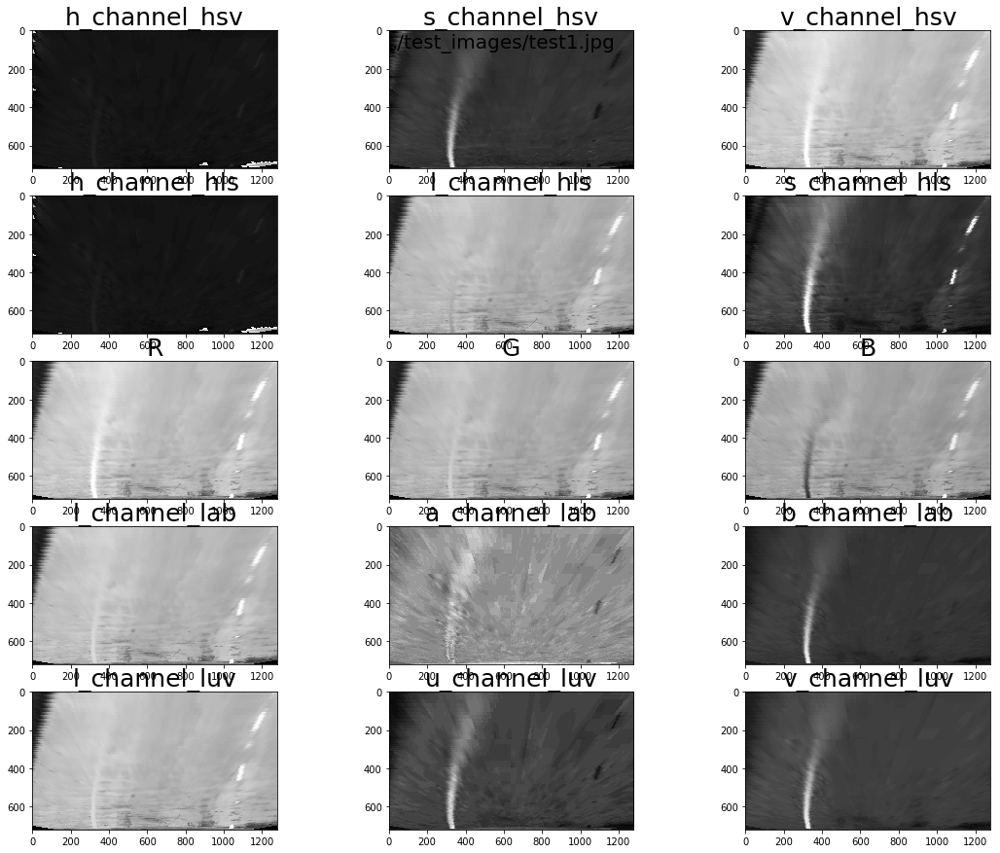

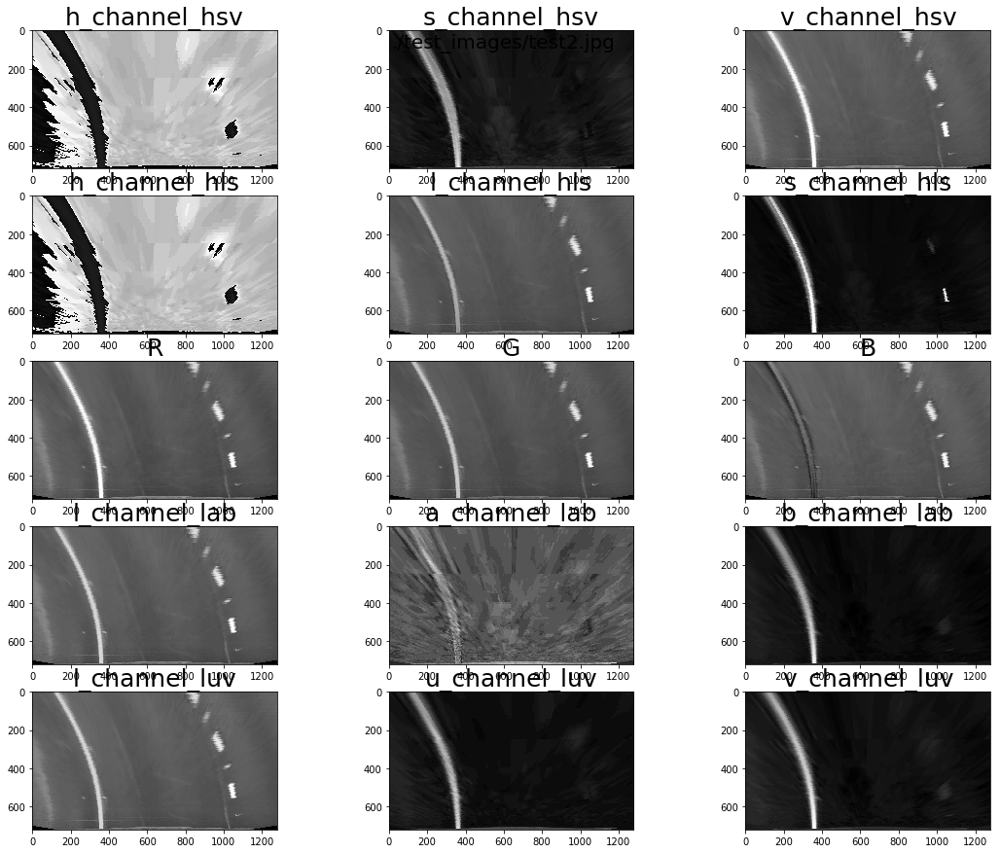

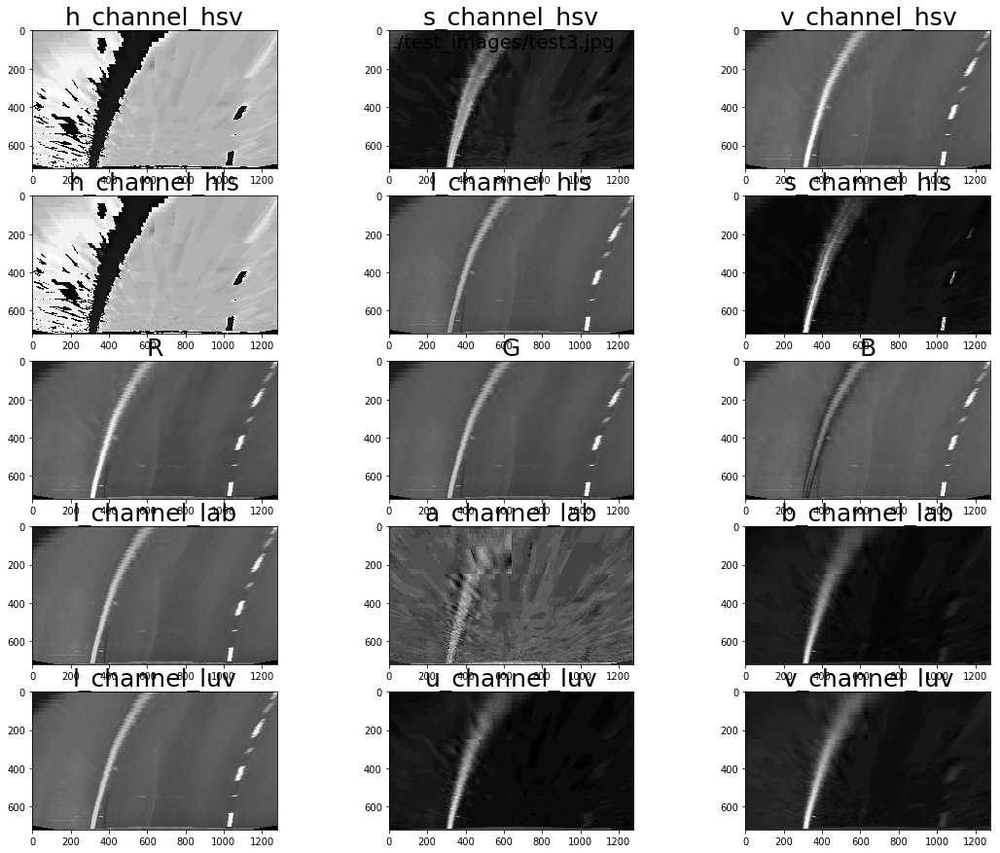

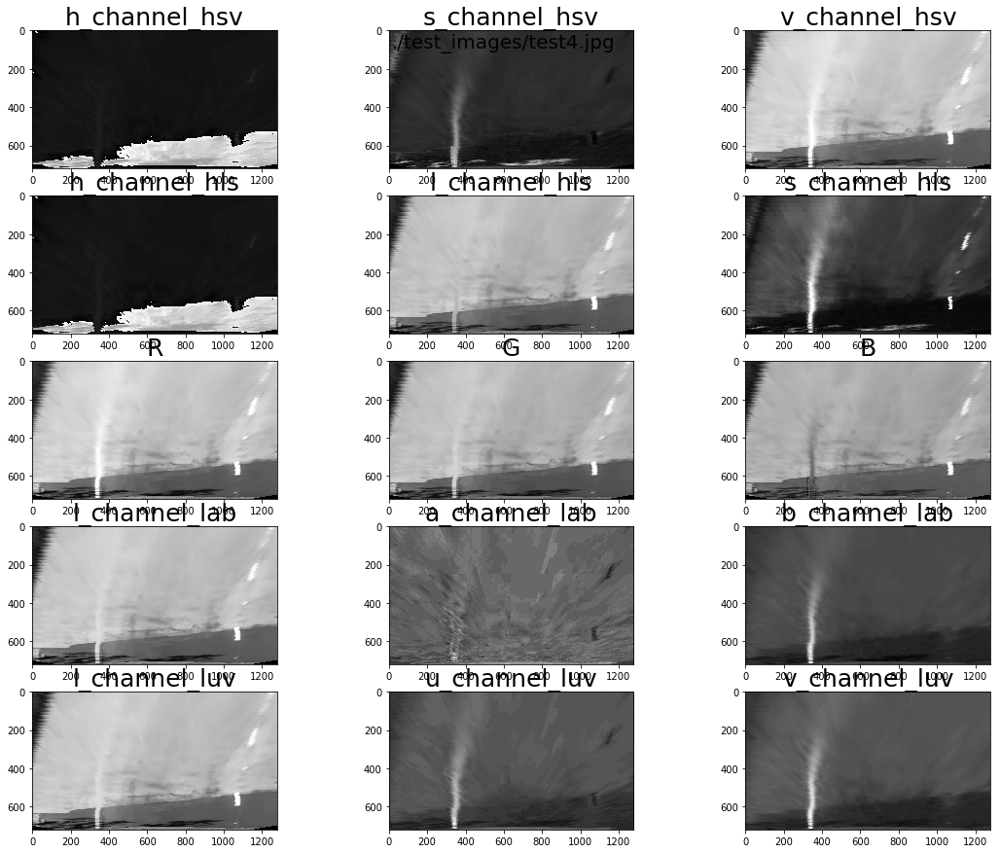

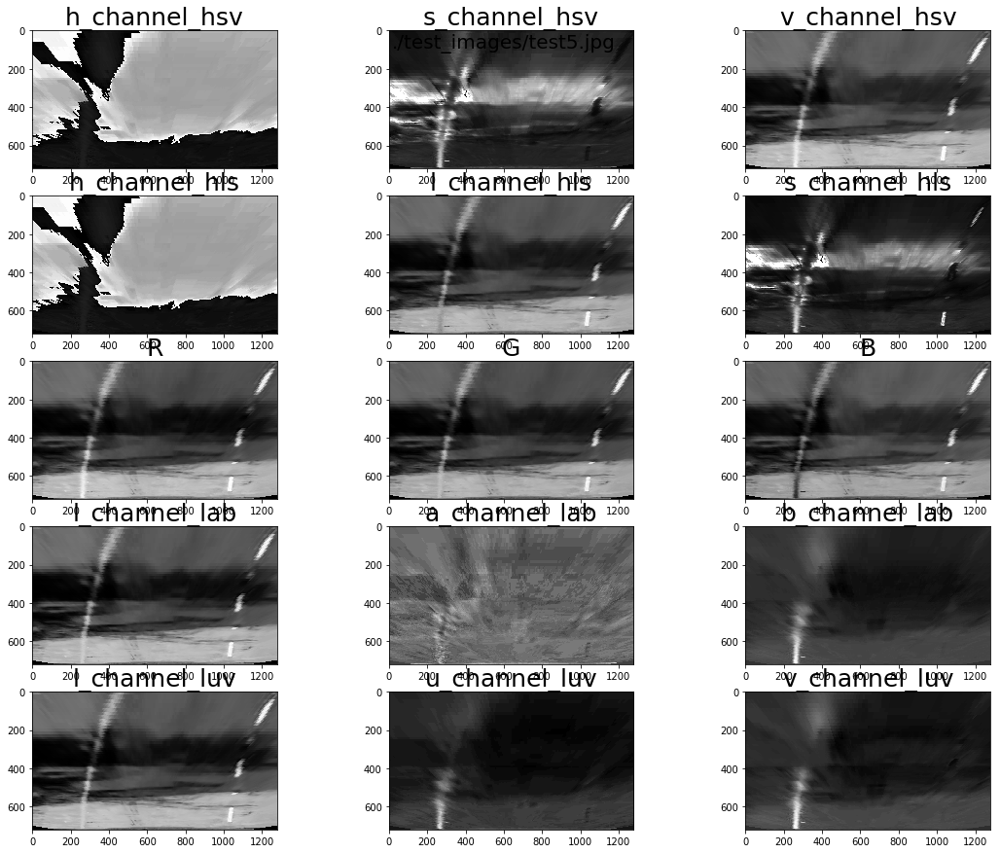

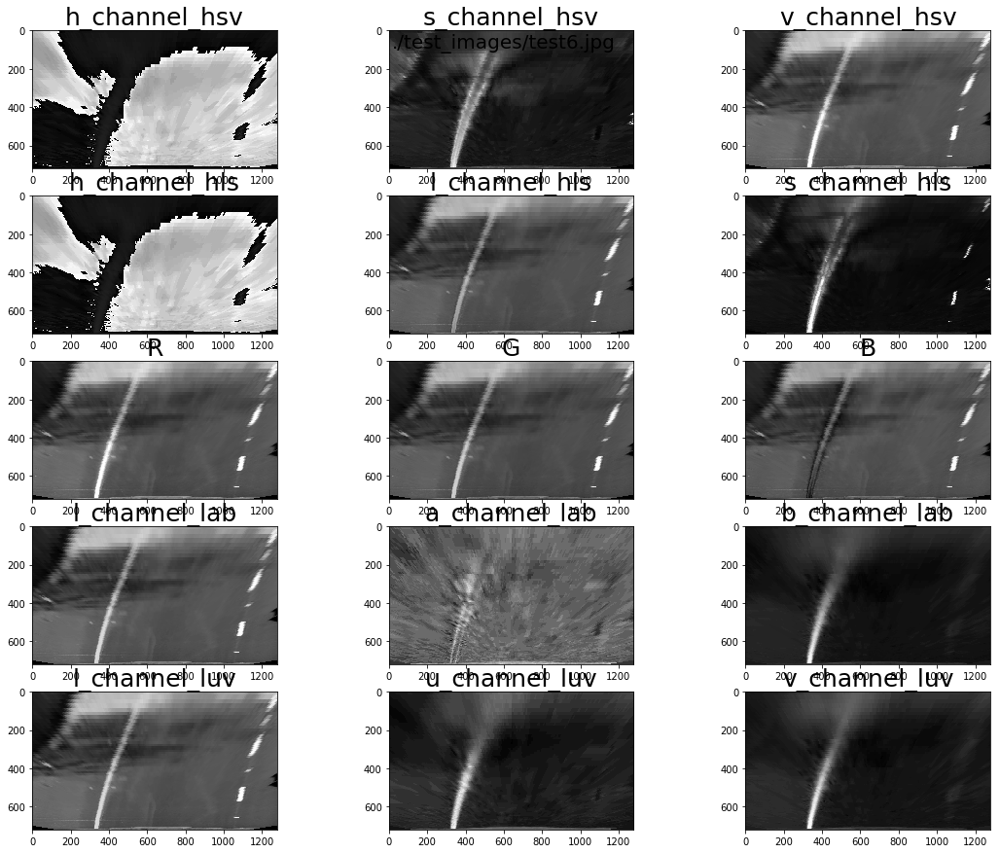

In [49]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    # warp the image
    warped = warper(undist)

    # Separate the RGB
    R = warped[:,:,0]
    G = warped[:,:,1]
    B = warped[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    # Convert to LAB color space
    lab = cv2.cvtColor(warped, cv2.COLOR_RGB2Lab).astype(np.float)
    l_channel_lab = lab[:,:,0]
    a_channel_lab = lab[:,:,1]
    b_channel_lab = lab[:,:,2]
    
    # Convert to LUV color space
    luv = cv2.cvtColor(warped, cv2.COLOR_RGB2Luv).astype(np.float)
    l_channel_luv = luv[:,:,0]
    u_channel_luv = luv[:,:,1]
    v_channel_luv = luv[:,:,2]

    
    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9),(ax10, ax11, ax12),(ax13, ax14, ax15)) = plt.subplots(5, 3, figsize=(16, 12))
    f.tight_layout()
    f.suptitle(fname, fontsize=20)
    
    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.set_title('h_channel_hsv', fontsize=25)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=25)
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=25)
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.set_title('h_channel_hls', fontsize=25)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=25)
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=25)

    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=25)
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=25)
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=25)
    
    # Plot LAB
    ax10.imshow(l_channel_lab, cmap='gray')
    ax10.set_title('l_channel_lab', fontsize=25)
    ax11.imshow(a_channel_lab, cmap='gray')
    ax11.set_title('a_channel_lab', fontsize=25)
    ax12.imshow(b_channel_lab, cmap='gray')
    ax12.set_title('b_channel_lab', fontsize=25)

    # Plot LUV
    ax13.imshow(l_channel_luv, cmap='gray')
    ax13.set_title('l_channel_luv', fontsize=25)
    ax14.imshow(u_channel_luv, cmap='gray')
    ax14.set_title('u_channel_luv', fontsize=25)
    ax15.imshow(v_channel_luv, cmap='gray')
    ax15.set_title('v_channel_luv', fontsize=25)
    
    plt.subplots_adjust(hspace = .2, wspace=.001)

### Look at binary outputs from these different channels on one of the images, and fiddle with the thresholds

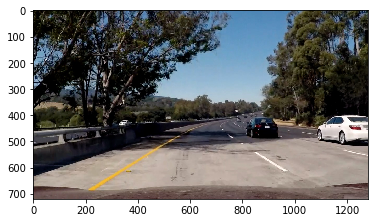

In [51]:
fname = glob.glob('./test_images/test5.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

fname

plt.imshow(img)

#### Helper function to apply the given thresholds to a gvien image color channel

In [52]:
def applyThreshold(channel, thresh):
    # 2) Apply a threshold to the S channel
    binary_output = np.zeros_like(channel)
    
    # Inclusive thresholds 
    binary_output[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    
    # 3) Return a binary image of threshold result
    return binary_output

#### HLS Saturation Channel 

In [53]:

def hls_sthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the S channelc
    s_channel = hls[:,:,2]
    # Return the applied threshold binary image
    return applyThreshold(s_channel, thresh)
    

<function __main__.hls_sthresh_update>

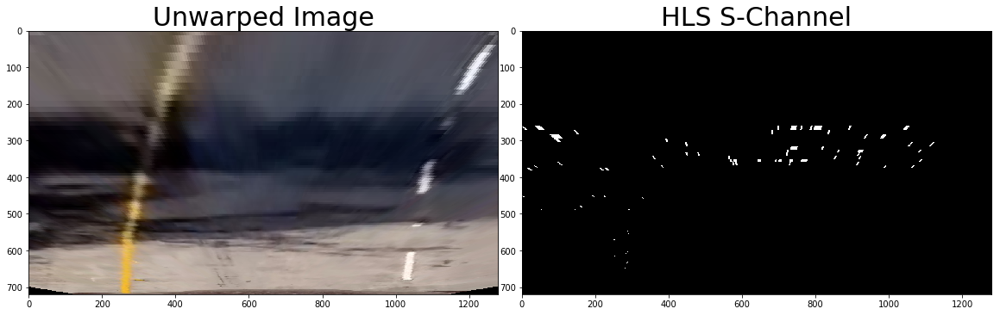

In [54]:
def hls_sthresh_update(min_thresh, max_thresh):
    
    img_sthresh = hls_sthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_sthresh, cmap='gray')
    ax2.set_title('HLS S-Channel', fontsize=30)

interact(hls_sthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### HLS L Channel

In [55]:
def hls_lthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the L channelc
    channel = hls[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)
    

<function __main__.hls_lthresh_update>

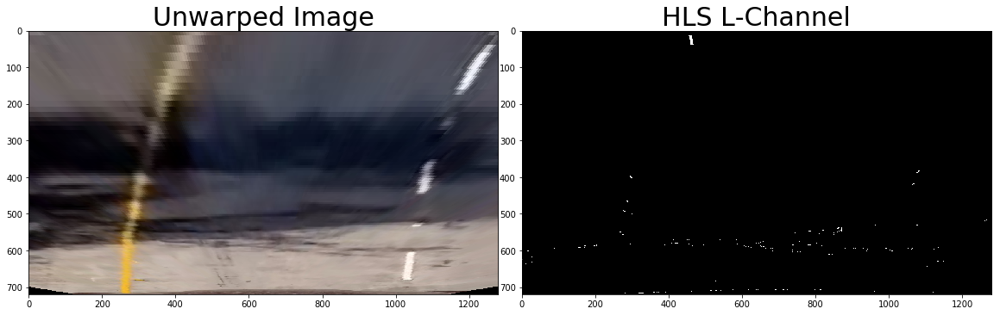

In [56]:
def hls_lthresh_update(min_thresh, max_thresh):
    
    img_lthresh = hls_lthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_lthresh, cmap='gray')
    ax2.set_title('HLS L-Channel', fontsize=30)

interact(hls_lthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### HSV V channel

In [57]:
def hsv_vthresh(img, thresh=(125, 255)):
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # Pull out the V channelc
    channel = hsv[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

<function __main__.hsv_vthresh_update>

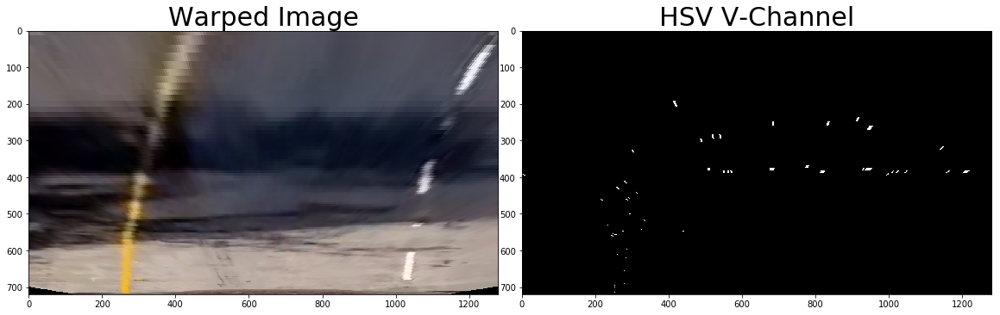

In [58]:
def hsv_vthresh_update(min_thresh, max_thresh):
    
    thresh_img = hsv_vthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('HSV V-Channel', fontsize=30)

interact(hsv_vthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

### RGB Red Channel

In [59]:
def rgb_rthresh(img, thresh=(125, 255)):
    # Pull out the R channelc
    channel = img[:,:,0]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

<function __main__.rgb_rthresh_update>

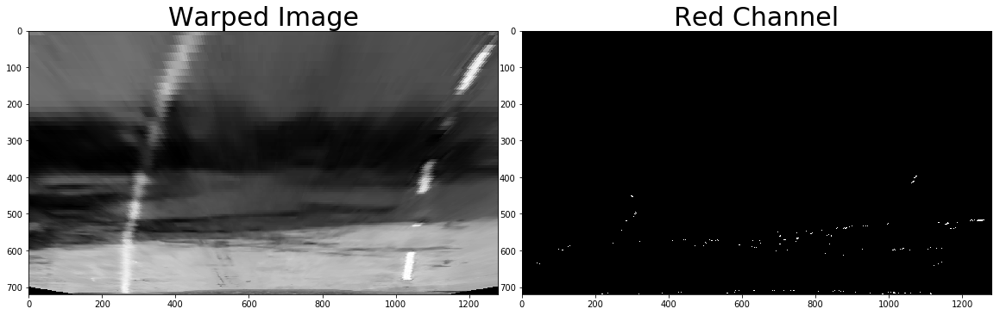

In [60]:
def rgb_rthresh_update(min_thresh, max_thresh):
    
    thresh_img = rgb_rthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped[:,:,0], cmap='gray')
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('Red Channel', fontsize=30)

interact(rgb_rthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### Loop thorugh each image with some of the settings we've found here, and see how we do

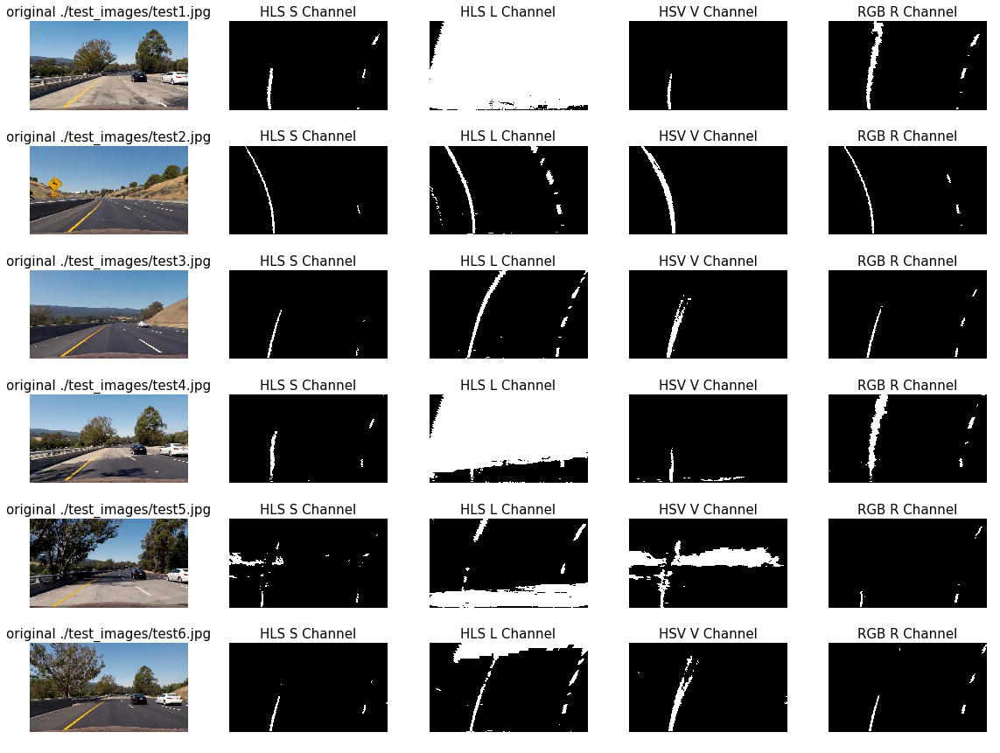

In [61]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(125, 255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    axs[i].axis('off')
    axs[i].imshow(undist)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(L, cmap='gray')
    axs[i].set_title('HLS L Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1

Looking at this, the S and the R channel probably do the best on these example images.

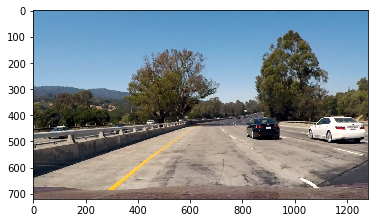

In [62]:
fname = glob.glob('./test_images/test1.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

plt.imshow(img)

In [63]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def calc_sobel(img, sobel_kernel=25, mag_thresh=(25, 255)):
    
    # Convert to grayscale - sobel can only have one color channel
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    L = hls[:,:,1]
    
    # Take the sobel gradient in x and y
    sobelx = cv2.Sobel(L, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(L, cv2.CV_64F, 0, 1)
    
    # Calculate the magnitude 
#     mag_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
#     scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    scaled_sobel = np.uint8(255*sobelx/np.max(sobelx))
    
    # Create a binary mask where mag thresholds are met
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return sxbinary


<function __main__.update>

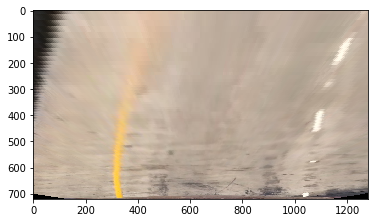

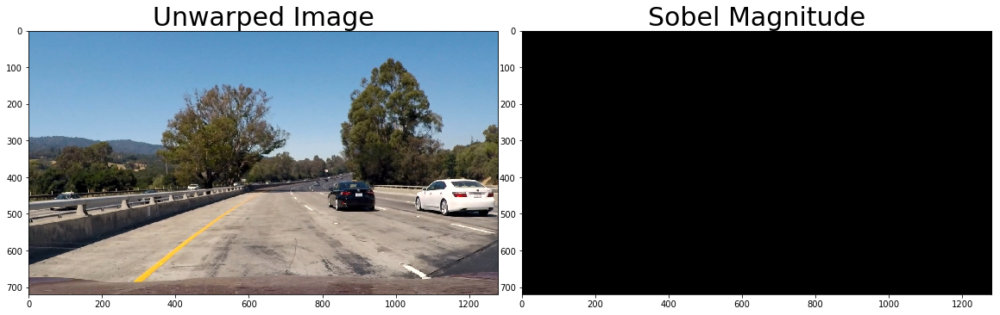

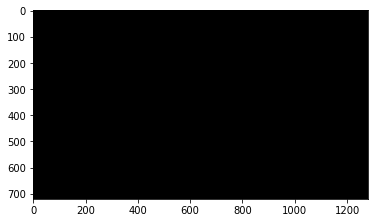

In [64]:



def update(kernel_size, min_thresh, max_thresh):
    plt.imshow(warped)
    sobel = calc_sobel(warped, kernel_size, (min_thresh, max_thresh))
    # Visualize sobel magnitude threshold
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(img)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(sobel, cmap='gray')
    ax2.set_title('Sobel Magnitude', fontsize=30)
    
#     warped_sobel = warper(sobel)
    warped_sobel = sobel
    
    plt.figure()
    plt.imshow(warped_sobel, cmap='gray')

interact(update, kernel_size=(1,31,2), 
                 min_thresh=(0,255), 
                 max_thresh=(0,255))

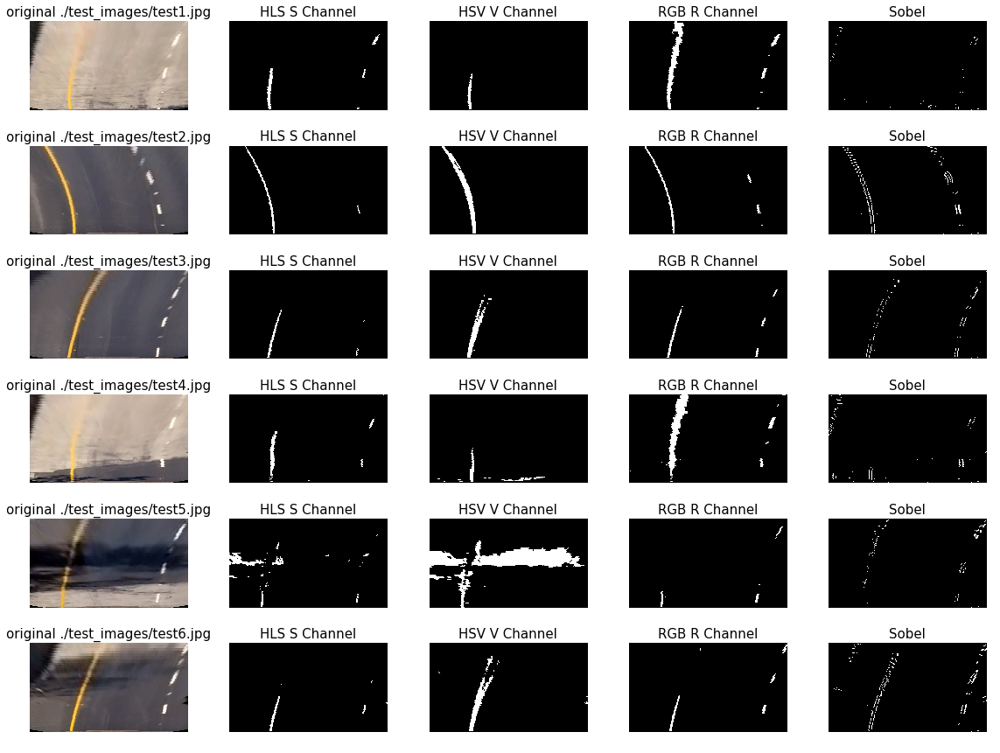

In [65]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
#     axs[i].axis('off')
#     axs[i].imshow(L, cmap='gray')
#     axs[i].set_title('HLS L Channel', fontsize=15)
#     i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1

## Image Pipeline

In [66]:

def binaryPipe(img):
    
    # Copy the image
    img = np.copy(img)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Get the Red and saturation images
    red = rgb_rthresh(warped, thresh=(225, 255))
    # sat = hls_sthresh(warped, thresh=(175, 255))
    
    # Run the sobel magnitude calculation
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    # combine these layers
    combined_binary = np.zeros_like(sobel)
    combined_binary[ (red == 1) | sobel == 1] = 1 #(sat == 1) |
    
    return combined_binary

### Test the image pipeline, and print the intermediate images along with the final one

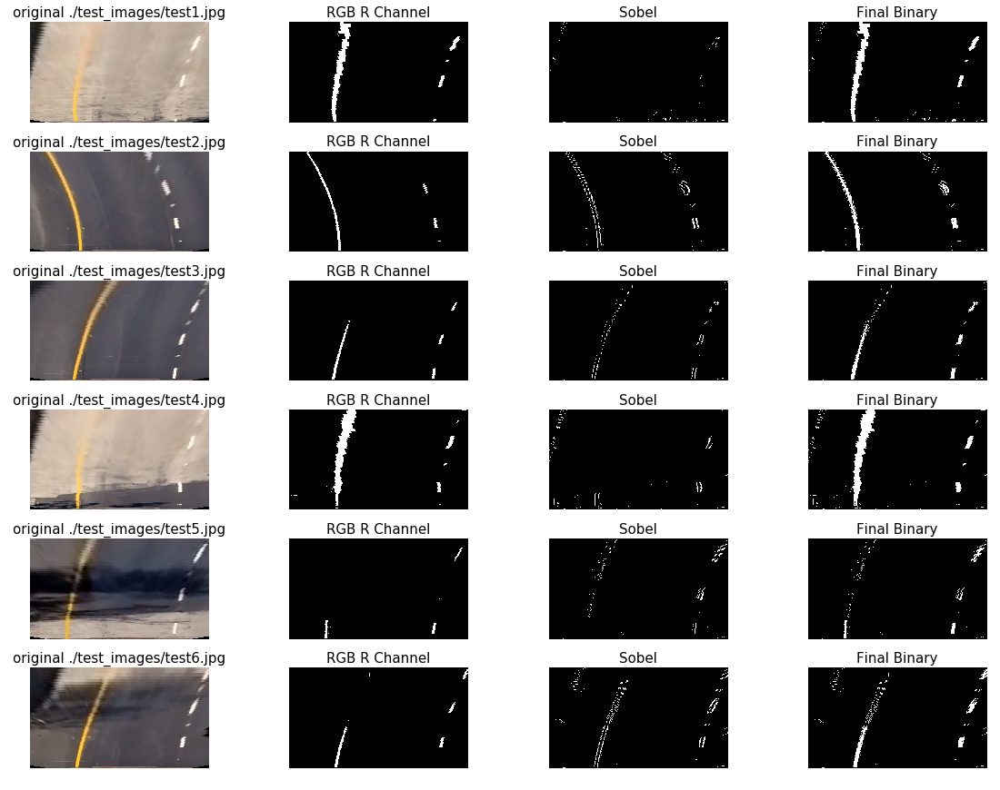

In [67]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 4, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)
    
    # Run this through our binary pipeline
    binary_img = binaryPipe(img)
    
    ### The below is just so we can see the makeup of the binary pipeline
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(150, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
#     axs[i].axis('off')
#     axs[i].imshow(S, cmap='gray')
#     axs[i].set_title('HLS S Channel', fontsize=15)
#     i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(binary_img, cmap='gray')
    axs[i].set_title('Final Binary', fontsize=15)
    i += 1

This seems pretty good. The shadows in the test5 image aren't perfect, but it's looks like it's going to probably be good enough (TM). 

## Finding and fitting the lane line pixels

To find the lane lines we'll use the histogram and window technique that was described in the lectures.

In [68]:
def calc_line_fits(img):

    ### Settings
    # Choose the number of sliding windows (for these images, the height is 450)
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Set the meters per pixel in both dimensions
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    return left_fit, right_fit, left_fit_m, right_fit_m, out_img


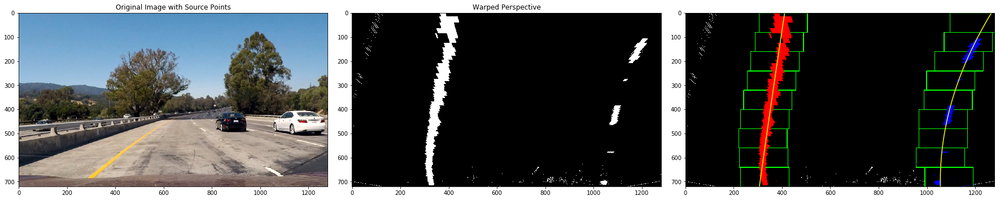

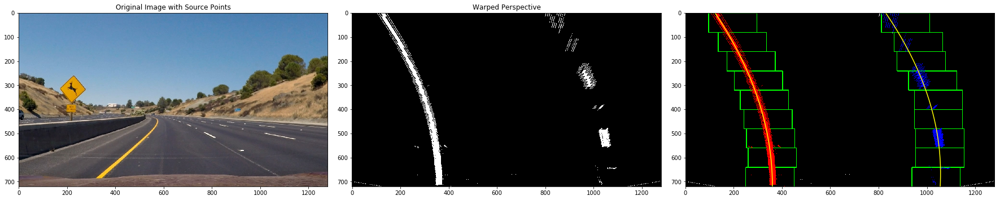

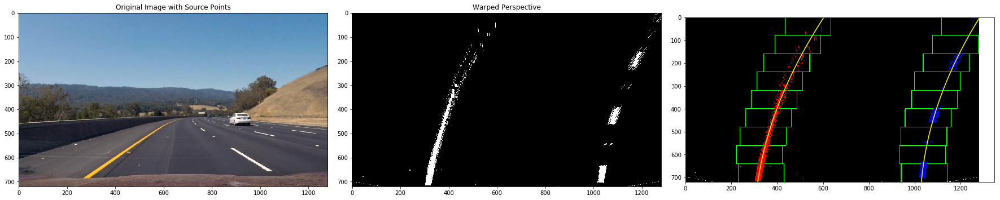

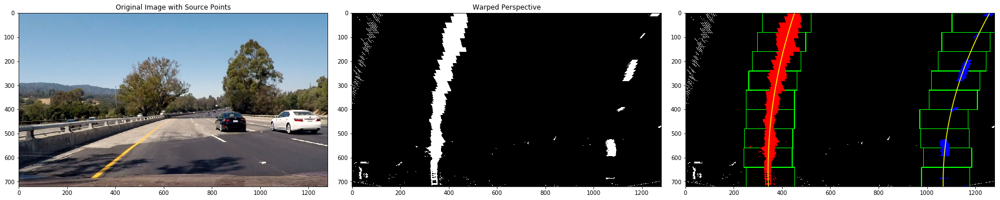

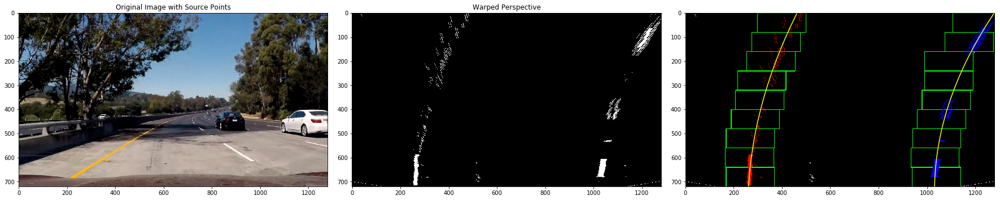

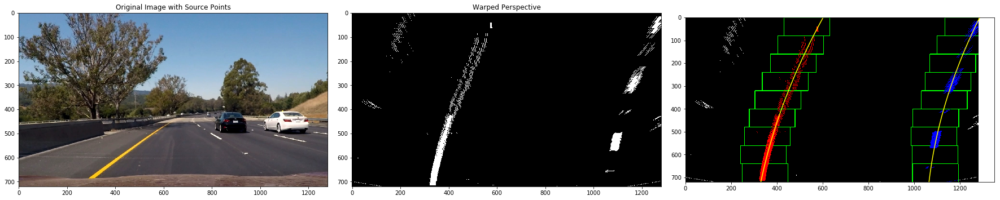

In [69]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')


### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)

    ### Plot the original image, the binary warped image, and the visualization from the fitter
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image with Source Points')
    
    ax2.imshow(binary_warped, cmap='gray')
    ax2.set_title('Warped Perspective')
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    ax3.imshow(out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



These plots and fits are looking pretty good!

### Calculate lines using previous lines

We can find lines faster if we know where to look, by using the fit from the last frame.

In [160]:

def calc_line_fits_from_prev(img, leftLine, rightLine):

    left_fit = leftLine.best_fit_px
    right_fit = rightLine.best_fit_px
    
    ### Settings
    margin = 100 # Width on either side of the fitted line to search
    # Set the meters per pixel in both dimensions
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin))) 
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each in meters
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return left_fit, right_fit, left_fit_m, right_fit_m, result

Looking at the test images, it looks like the test6 > test4 > test5 are taken roughly right after one another from a video, so let's use these to test our fits

AttributeError: 'numpy.ndarray' object has no attribute 'best_fit'

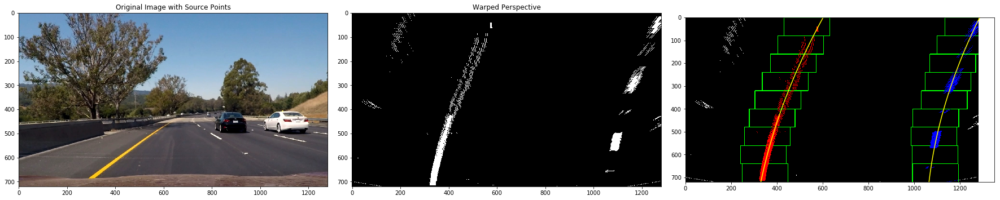

In [72]:


images = ['./test_images/test6.jpg', './test_images/test4.jpg', './test_images/test5.jpg']

left_fit = np.array([])
right_fit = np.array([])

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    ## I know that test 6 is the first image, so use the calc_line_fits on that image,
    ## otherwise use the calc_line_fits_from_prev function to test it.
    if fname == './test_images/test6.jpg':
    
        # Run the warped, binary image from the pipeline through the fitter
        left_fit, right_fit, left_fit_m, right_fit_m, result = calc_line_fits(binary_warped)

        ### Plot the original image, the binary warped image, and the visualization from the fitter
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image with Source Points')

        ax2.imshow(binary_warped, cmap='gray')
        ax2.set_title('Warped Perspective')

        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        ax3.imshow(out_img)
        ax3.plot(left_fitx, ploty, color='yellow')
        ax3.plot(right_fitx, ploty, color='yellow')

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    else:
    
        left_fit, right_fit, left_inds, right_inds, result = calc_line_fits_from_prev(binary_warped, left_fit, right_fit)
        
        
        
        ### Plot the original image, the binary warped image, and the visualization from the fitter
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image with Source Points')

        ax2.imshow(binary_warped, cmap='gray')
        ax2.set_title('Warped Perspective')

        ax3.imshow(result)
        ax3.plot(left_fitx, ploty, color='yellow')
        ax3.plot(right_fitx, ploty, color='yellow')

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        

Well that looks okay...we'll go with it!

## Calculating Curvature

We need to calculate the radius of curvature, in real units of distance, so we know how much to turn the steering wheel. Here are the calculations for that.

In [73]:
def calc_radius(y_eval, left_fit, right_fit_cr):
    """
    left_fit and right_fit are assumed to have already been converted to meters
    """

    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    return left_curverad, right_curverad

def calc_center_dist(y_eval, midpoint, left_fit, right_fit):
    
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Calculate the distance from the center
    x_left_line = left_fit[0]*(y_eval**2) + left_fit[1]*y_eval + left_fit[2]
    x_right_line = right_fit[0]*(y_eval**2) + right_fit[1]*y_eval + right_fit[2]
    
    position_from_center = ((x_left_line + x_right_line)/2 - midpoint) * xm_per_pix
    
    return position_from_center


In [74]:
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    left_curerad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)


### Drawing the lane area

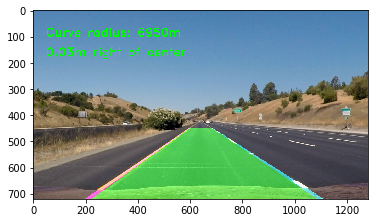

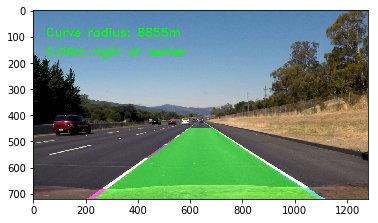

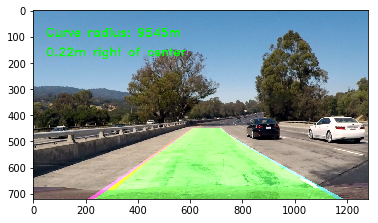

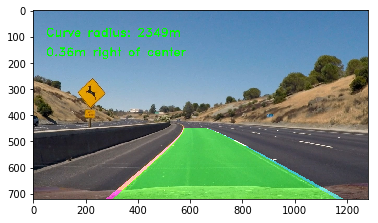

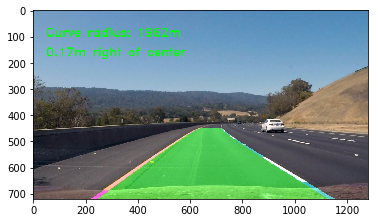

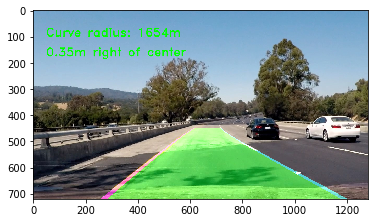

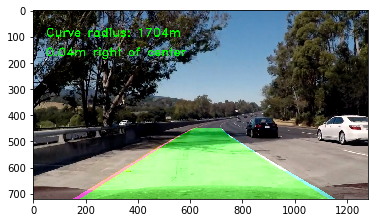

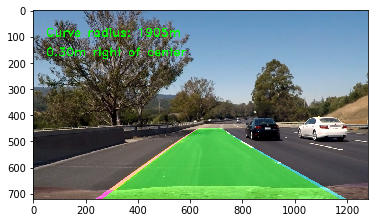

In [76]:

images = glob.glob('./test_images/*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    
    # calc the radius and center distance
    left_curverad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp)
    # Combine the result with the original image
    result = cv2.addWeighted(img_og, 1, newwarp, 0.5, 0)
    
    curve_rad = (left_curverad + right_curverad) / 2.
    
    # Add the radius and center
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.0f}'.format(curve_rad) + 'm'
    cv2.putText(result, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    if center < 0:
        dir = 'left'
    else:
        dir = 'right'
    text = '{:03.2f}'.format(center) + 'm '+ dir + ' of center'
    cv2.putText(result, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)

    plt.figure()
    plt.imshow(result)
    name = fname.split('/')[-1][:-4]
    plt.imsave('./output_images/' + name + '-output.jpg', result)
    

## Almost Final Image Pipeline

In [ ]:

def final_pipeline(img):

    img_og = np.copy(img)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    
    # calc the radius and center distance
    left_curverad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp) 
    # Combine the result with the original image
    result = cv2.addWeighted(img_og, 1, newwarp, 0.5, 0)
    
    curve_rad = (left_curverad + right_curverad) / 2.
    
    # Add the radius and center
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.0f}'.format(curve_rad) + 'm'
    cv2.putText(result, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    if center < 0:
        dir = 'left'
    else:
        dir = 'right'
    text = '{:03.2f}'.format(center) + 'm '+ dir + ' of center'
    cv2.putText(result, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)

    return result

## Line Class

Before we move forward, I'm going to create a line class to keep track of the current and past line data.

In [163]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        
        # was the line detected in the last iteration?
        self.detected = False  
        
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        
        # polynomial coefficients averaged over the last n iterations
        self.best_fit_px = None
        self.best_fit_m = None
        
        #polynomial coefficients for the most recent fit
        self.current_fit_px = None  
        self.current_fit_m = None
        
        #radius of curvature of the line in some units
        self.radius_of_curvature = None
        
        # center position of car
        self.lane_to_camera = None
        
        # Previous Fits
        self.previous_fits_px = []
        self.previous_fits_m = []
        
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        
        # y_eval is where we want to evaluate the fits for the line radius calcuation 
        # for us it's at the bottom of the image for us, and because we know 
        # the size of our video/images we can just hardcode it
        self.y_eval = 720.
        
        # camera position is where the camera is located relative to the image
        # we're assuming it's in the middle
        self.camera_position = 640.

    def run_line_pipe(self):
        self.calc_best_fit()
        self.calc_radius()
        self.calc_center_dist()
        
    def add_new_fit(self, new_fit_px, new_fit_m):
        """
        Add a new fit to the Line class
        """
        
        if new_fit_px != None and new_fit_m != None:
            # If this is our first line, then we will have to take it
            if self.current_fit_px == None and self.previous_fits_px == []:
                self.detected = True
                self.current_fit_px = new_fit_px
                self.current_fit_m = new_fit_m
                self.run_line_pipe()
                return
            else:
                # measure the diff to the old fit
                self.diffs = new_fit_px - self.current_fit_px
                print(self.diffs)
                self.detected = True
                self.current_fit_px = new_fit_px
                self.run_line_pipe()
                return
        else:
            self.detected = False


    def calc_best_fit(self):
        """
        calculate the average, if needed
        """
        # add the latest fit to the previous fit list
        self.previous_fits_px.append(self.current_fit_px)
        self.previous_fits_m.append(self.current_fit_m)
        
        # If we currently have 5 fits, throw the oldest out
        if len(self.previous_fits_px) > 5:
            self.previous_fits_px = self.previous_fits_px[1:]
        if len(self.previous_fits_m) > 5:
            self.previous_fits_m = self.previous_fits_m[1:]
        
        # Just average everything
        self.best_fit_px = np.average(self.previous_fits_px, axis=0)
        self.best_fit_m = np.average(self.previous_fits_m, axis=0)
        return
        
        
    def calc_radius(self):
        """
        left_fit and right_fit are assumed to have already been converted to meters
        """
        y_eval = self.y_eval
        fit = self.best_fit_m
        print("fit")
        print(fit)
        
        curve_rad = ((1 + (2*fit[0]*y_eval + fit[1])**2)**1.5) / np.absolute(2*fit[0])
        self.radius_of_curvature = curve_rad
        return
        
    def calc_center_dist(self):
        """
        calculate the distance of this line to the center of the image (where the camera is)
        """
        # meters per pixel in x dimension
        xm_per_pix = 3.7/700
        
        y = self.y_eval
        x0 = self.best_fit_px[0]*(y**2) + self.best_fit_px[1]*y + self.best_fit_px[2]
        lane_to_camera_px = abs(self.camera_position - x0)
        self.lane_to_camera = lane_to_camera_px * xm_per_pix
        return
        
        

In [164]:
def get_center_dist(leftLine, rightLine):
    
    x_left = leftLine.lane_to_camera
    x_right = rightLine.lane_to_camera
    
    return x_right - x_left

def combine_radii(leftLine, rightLine):
    
    left = leftLine.radius_of_curvature
    right = rightLine.radius_of_curvature
    
    return np.average([left, right])


In [165]:
def create_final_image(img, binary_warped, leftLine, rightLine):
    
    left_fit = leftLine.best_fit_px
    right_fit = rightLine.best_fit_px
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp)
    
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.5, 0)
    
    return result

def add_image_text(img, radius, center):
    
    # Add the radius and center position to the image
    font = cv2.FONT_HERSHEY_DUPLEX
    
    text = 'Radius of curvature: ' + '{:04.0f}'.format(radius) + 'm'
    cv2.putText(img, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    
    if center > 0:
        dir = 'left'
    else:
        dir = 'right'
    text = '{:03.2f}'.format(center) + 'm '+ dir + ' of center'
    cv2.putText(img, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    
    return img
    

## The Final, Final Pipeline


Now lets recreate the final pipeline function to use these Line classes to track the lane lines

In [166]:
def final_pipeline(img):

    img_og = np.copy(img)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # If we found lines previously, run the simplified line fitter
    if leftLine.detected == True and rightLine.detected == True:
        left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits_from_prev(binary_warped, leftLine, rightLine)
    else:
        # Run the warped, binary image from the pipeline through the complex fitter
        left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    
    # Add these fits to the line classes
    leftLine.add_new_fit(left_fit, left_fit_m)
    rightLine.add_new_fit(right_fit, left_fit_m)
    
    # get radius and center distance
    curve_rad = combine_radii(leftLine, rightLine)
    center_position = get_center_dist(leftLine, rightLine)

    # create the final image
    result = create_final_image(img, binary_warped, leftLine, rightLine)
    
    # add the text to the image 
    result = add_image_text(result, curve_rad, center_position)

    return result

Run the pipeline on the test images

fit
[ -8.63159857e-05   2.64009563e-03   1.56318881e+00]
fit
[ -8.63159857e-05   2.64009563e-03   1.56318881e+00]


fit
[  9.48842252e-05  -1.05446181e-03   1.54973840e+00]
fit
[  9.48842252e-05  -1.05446181e-03   1.54973840e+00]
fit
[  2.78905603e-05  -1.92435071e-02   2.17132225e+00]
fit
[  2.78905603e-05  -1.92435071e-02   2.17132225e+00]
fit
[-0.00141021  0.08408316  0.64987647]
fit
[-0.00141021  0.08408316  0.64987647]
fit
[  1.06012246e-03  -8.25901274e-02   3.19008315e+00]
fit
[  1.06012246e-03  -8.25901274e-02   3.19008315e+00]
fit
[  7.75427846e-04  -4.23375680e-02   2.38717741e+00]
fit
[  7.75427846e-04  -4.23375680e-02   2.38717741e+00]
fit
[  9.33447370e-04  -6.33817061e-02   2.44333655e+00]
fit
[  9.33447370e-04  -6.33817061e-02   2.44333655e+00]
fit
[  7.20911971e-04  -6.95403641e-02   3.17888764e+00]
fit
[  7.20911971e-04  -6.95403641e-02   3.17888764e+00]


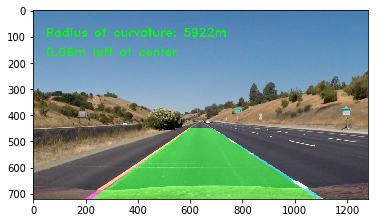

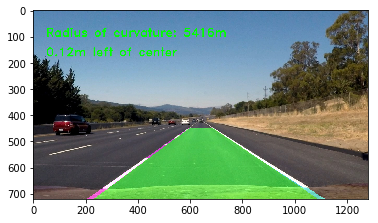

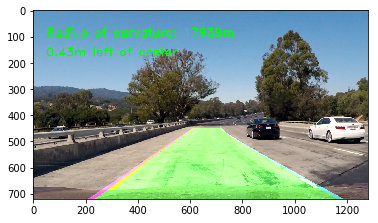

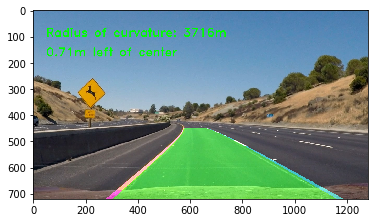

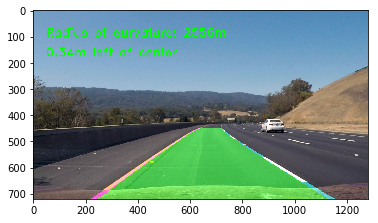

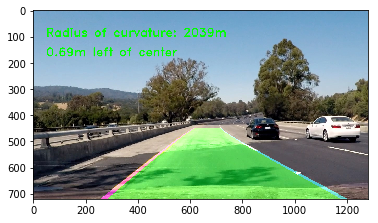

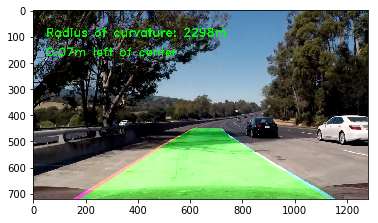

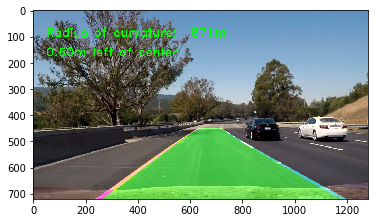

In [167]:
images = glob.glob('./test_images/*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    # Initialize two lines for left and right on every image since the images don't
    # come from a continous video
    rightLine = Line()
    leftLine = Line()
    
    # Read the image
    img = mpimg.imread(fname)
    
    # Run the image through the pipeline
    result = final_pipeline(img)

    # Let's plot the image
    plt.figure()
    plt.imshow(result)
    # name = fname.split('/')[-1][:-4]
    # plt.imsave('./output_images/' + name + '-output.jpg', result)

## Video!

In [168]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [169]:
leftLine = Line()
rightLine = Line()

output = 'output_video/project_video_output.mp4'
clip1 = VideoFileClip("test_videos/project_video.mp4")
clip = clip1.fl_image(final_pipeline)
%time clip.write_videofile(output, audio=False)
    

fit
[-0.00141217  0.08221952  0.66786608]
fit
[-0.00141217  0.08221952  0.66786608]
[MoviePy] >>>> Building video output_video/project_video_output.mp4
[MoviePy] Writing video output_video/project_video_output.mp4





  0%|          | 0/1261 [00:00<?, ?it/s]

[ -1.51788304e-18   3.33066907e-16  -5.68434189e-14]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.34974256e-05  -1.45327526e-02   1.47098523e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  0%|          | 1/1261 [00:00<04:18,  4.88it/s]


  0%|          | 2/1261 [00:00<04:21,  4.81it/s]

[ -3.20859517e-06   6.25510291e-03  -1.06058203e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.28347819e-05   4.96651649e-02  -1.72426487e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.64163367e-06   1.01991250e-03  -4.17951620e-01]




  0%|          | 3/1261 [00:00<04:19,  4.84it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  1.12473737e-05   2.85592335e-03  -7.98264855e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  0%|          | 4/1261 [00:00<04:24,  4.75it/s]

[  3.15284395e-06   1.61568145e-03  -1.31510618e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.29786405e-05   2.38631490e-02  -1.11616620e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.97856844e-05  -9.41976408e-03   6.46657132e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.80740207e-05   4.68712442e-02  -9.82441368e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  0%|          | 5/1261 [00:01<04:15,  4.92it/s]


  0%|          | 6/1261 [00:01<04:13,  4.95it/s]

[  8.60137770e-06  -1.94708316e-03  -8.64150178e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.01297097e-06   9.96876428e-03  -9.63509016e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.79399223e-05  -9.60887407e-03  -1.07946013e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.36849416e-05  -2.13778597e-02   6.27652480e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|          | 7/1261 [00:01<04:07,  5.07it/s]


  1%|          | 8/1261 [00:01<04:03,  5.15it/s]

[  5.51573212e-06   2.37925199e-03  -1.96220355e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.02219029e-04  -4.70029651e-02  -5.35848565e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.45441588e-05  -1.64194907e-02  -7.00763831e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.92180507e-06  -1.60201983e-02   9.85481104e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|          | 9/1261 [00:01<03:59,  5.23it/s]


  1%|          | 10/1261 [00:01<03:55,  5.32it/s]

[  4.78503883e-06   1.37046546e-03  -3.95156234e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.15536926e-05  -1.71165521e-02   1.83763147e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.26949044e-06   3.57638050e-03  -1.48372750e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.71017895e-05  -8.42692671e-03  -4.30745127e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|          | 11/1261 [00:02<03:53,  5.35it/s]


  1%|          | 12/1261 [00:02<03:52,  5.37it/s]

[  3.58011865e-05  -2.19034088e-02  -4.51618131e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.18294204e-06  -4.32824506e-02   3.01115583e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.70575080e-06   5.64435206e-03  -1.92261976e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.36731513e-05   5.45800577e-03  -1.02929801e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|          | 13/1261 [00:02<03:52,  5.37it/s]


  1%|          | 14/1261 [00:02<03:50,  5.41it/s]


  1%|          | 15/1261 [00:02<03:46,  5.50it/s]

[ -3.78490385e-07   7.64343923e-04  -7.96928496e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.27420460e-05   2.21398142e-02  -7.84147213e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.79786036e-05   2.12585372e-02  -1.60094389e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.39351887e-05   6.04187779e-02  -3.11571649e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|▏         | 16/1261 [00:03<03:45,  5.53it/s]


  1%|▏         | 17/1261 [00:03<03:42,  5.59it/s]

[ -3.05172272e-05   2.46799226e-02  -2.86557107e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.51602155e-05   7.52884524e-02  -2.79488042e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.83682321e-07   1.83834355e-03  -1.62903086e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.47868015e-05   3.43479364e-02  -9.72187334e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|▏         | 18/1261 [00:03<03:45,  5.50it/s]

[  3.43963652e-06  -1.83239127e-03  -1.85859961e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.93433358e-05   2.87895065e-02  -1.28501729e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.95432025e-05  -1.61352728e-02   9.31280485e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.97206353e-05  -3.82403481e-02   1.79252487e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 19/1261 [00:03<03:47,  5.45it/s]


  2%|▏         | 20/1261 [00:03<03:54,  5.29it/s]

[  8.23155708e-06  -4.70924772e-03  -2.09318871e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.63190147e-05  -2.98519156e-02   1.38725286e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.90061114e-05  -2.29016838e-02   6.26639065e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.91279441e-05   1.06932636e-02   1.03138953e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 21/1261 [00:03<03:53,  5.32it/s]


  2%|▏         | 22/1261 [00:04<03:56,  5.23it/s]

[  5.96075118e-06  -3.85184535e-03  -3.04102985e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.59780874e-05  -4.37859064e-02   2.02389171e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.86332720e-06  -4.01620004e-03  -1.39889119e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.59308743e-06  -8.05964845e-03   1.03528862e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 23/1261 [00:04<03:53,  5.30it/s]


  2%|▏         | 24/1261 [00:04<03:58,  5.18it/s]

[ -3.39588338e-05   2.01774730e-02  -1.31418787e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.48672779e-05  -1.38129163e-02  -5.58708920e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.82855377e-05   1.83472322e-02  -1.07481524e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.06734375e-05  -1.75710230e-02  -1.84567722e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 25/1261 [00:04<03:58,  5.18it/s]


  2%|▏         | 26/1261 [00:04<03:57,  5.20it/s]

[  4.99224366e-06  -6.39522071e-03  -8.02426620e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.06991117e-05  -1.60824400e-02   1.73965559e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.96824900e-05   1.24561814e-02  -1.70191040e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.57665988e-06   1.80071438e-03   1.58533367e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 27/1261 [00:05<03:54,  5.25it/s]


  2%|▏         | 28/1261 [00:05<03:55,  5.24it/s]

[  1.19321475e-05  -1.15745106e-02  -3.11423348e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.74054314e-06  -2.96128093e-02   2.16962673e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.64838814e-05   3.48703705e-02  -2.67518752e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.45104072e-05   3.82032301e-02  -1.57705384e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 29/1261 [00:05<03:52,  5.29it/s]


  2%|▏         | 30/1261 [00:05<03:52,  5.30it/s]

[ -4.38310043e-05   3.66770011e-02  -3.61629584e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.51949647e-06   2.70500956e-02  -1.64335569e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.61786899e-05   2.94607093e-02  -2.04049796e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.61972105e-05   1.14802652e-01  -3.42644867e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 31/1261 [00:05<03:52,  5.29it/s]


  3%|▎         | 32/1261 [00:06<03:49,  5.35it/s]

[ -4.02807266e-05   3.28910325e-02  -2.18649553e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.51700358e-06   2.15080409e-02  -2.02366888e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.81660200e-05  -1.40051584e-02   3.81467524e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.38022668e-05  -2.40805418e-02   1.39050344e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 33/1261 [00:06<03:46,  5.43it/s]


  3%|▎         | 34/1261 [00:06<03:45,  5.44it/s]

[ -2.40924444e-05   2.40253945e-02  -4.03564897e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.65029647e-05   2.08676867e-02  -9.12817539e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.61957206e-05   1.85982990e-02  -3.51385943e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.36494791e-05  -1.13129738e-02  -3.98233915e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 35/1261 [00:06<03:45,  5.44it/s]


  3%|▎         | 36/1261 [00:06<03:44,  5.45it/s]

[ -4.96485300e-06   8.09382834e-03  -1.08386031e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.64567193e-06   1.12454318e-02  -9.36906503e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.79800327e-06   1.12348913e-02  -2.42768617e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.17862791e-05   3.80289457e-02  -1.00332693e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 37/1261 [00:06<03:43,  5.47it/s]


  3%|▎         | 38/1261 [00:07<03:49,  5.33it/s]

[ -9.03327600e-06   1.28918626e-02  -2.74777474e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.59101529e-05   2.31434805e-02  -9.51763524e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32198033e-05   1.54323835e-02  -2.83036488e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.80668063e-05   6.47318116e-02  -2.14846011e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 39/1261 [00:07<03:47,  5.38it/s]


  3%|▎         | 40/1261 [00:07<03:51,  5.28it/s]

[  3.63113975e-06   2.16336681e-03  -3.08469601e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.79517672e-05  -2.22495783e-02   7.58407482e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.47452299e-06  -3.25420938e-04  -1.79767686e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.16249670e-05   2.75628126e-02  -8.53655041e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 41/1261 [00:07<03:48,  5.33it/s]


  3%|▎         | 42/1261 [00:07<03:44,  5.44it/s]

[  1.31618725e-05  -5.55466102e-03  -9.56825983e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.37883116e-06   3.84996420e-03   1.64710620e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.27199619e-05  -3.59920334e-02   3.23327772e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.06853836e-05  -2.87165885e-02   1.17993548e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 43/1261 [00:08<03:41,  5.49it/s]


  3%|▎         | 44/1261 [00:08<03:39,  5.53it/s]


  4%|▎         | 45/1261 [00:08<03:35,  5.64it/s]

[  2.12534966e-05  -1.53501240e-02   1.93074726e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.44667411e-05  -6.11594313e-02   2.31722813e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.02897133e-05  -2.05575815e-02   6.27508839e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.20239518e-05  -1.36791526e-02   6.61653255e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▎         | 46/1261 [00:08<03:36,  5.60it/s]

[  2.81488315e-05  -2.29030359e-02   2.84738184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.89474177e-06   6.22983234e-03  -1.34725443e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.72109747e-05  -2.05511907e-02   8.13348700e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.14651428e-05  -3.34796216e-02   9.94316066e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▎         | 47/1261 [00:08<03:37,  5.59it/s]


  4%|▍         | 48/1261 [00:08<03:36,  5.59it/s]

[  1.37452862e-05  -1.07906829e-02   1.50595157e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.46054814e-05  -1.44851560e-02  -5.23410413e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.60516315e-05  -1.92633308e-02  -2.75554719e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.16390249e-05  -3.76091042e-02   1.73403264e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▍         | 49/1261 [00:09<03:37,  5.57it/s]


  4%|▍         | 50/1261 [00:09<03:44,  5.39it/s]

[  9.92369115e-06  -5.84221094e-03  -2.24850054e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.11472621e-05  -1.53201418e-02  -2.78270590e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.08294986e-05  -9.06835060e-03   7.86282901e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.82489416e-06   8.38599827e-03  -2.00106378e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▍         | 51/1261 [00:09<03:46,  5.33it/s]


  4%|▍         | 52/1261 [00:09<03:50,  5.25it/s]

[ -1.30819985e-05   7.30912278e-03   8.26653850e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.55574090e-06   2.63813995e-02  -1.69138176e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.51253549e-06   3.48801863e-03  -1.73350614e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.33093287e-05   2.13917923e-02  -7.68575790e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▍         | 53/1261 [00:09<03:46,  5.33it/s]


  4%|▍         | 54/1261 [00:10<03:42,  5.42it/s]


  4%|▍         | 55/1261 [00:10<03:38,  5.51it/s]

[ -8.52855871e-06   3.37503882e-03   2.57782143e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.28191165e-05   3.72918907e-02  -1.22922233e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.97242187e-05  -2.21542162e-02   2.01038095e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.46031618e-05   8.32868802e-03   1.49619712e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▍         | 56/1261 [00:10<03:40,  5.47it/s]

[  4.72874048e-06  -6.85692740e-03   1.15684411e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.89870950e-05  -2.24141294e-02   7.30931707e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.05135292e-06  -5.57133954e-03   2.07573206e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.13177149e-05  -1.36151317e-02   7.80623794e-01]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▍         | 57/1261 [00:10<03:41,  5.44it/s]


  5%|▍         | 58/1261 [00:10<03:41,  5.42it/s]

[  1.54768362e-05  -1.61609149e-02   2.57923348e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.50886810e-05  -5.60581973e-02   9.23071712e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.03264044e-06  -2.29625379e-03   5.08348632e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.53009302e-05   1.45499874e-03  -1.82720810e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▍         | 59/1261 [00:11<03:39,  5.47it/s]


  5%|▍         | 60/1261 [00:11<03:42,  5.41it/s]


  5%|▍         | 61/1261 [00:11<03:37,  5.52it/s]

[ -1.18266527e-05   1.45234678e-03   4.00149380e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.74506422e-05   2.80889190e-02  -1.71640783e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.34686275e-05   2.65164010e-03   2.68310811e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.26957571e-05   4.08132907e-02  -9.23441895e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▍         | 62/1261 [00:11<03:35,  5.56it/s]

[ -1.13066768e-05   1.28253321e-03   3.32699716e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.17452127e-04   1.15607366e-01  -3.11248159e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.08028145e-05  -1.33349344e-02   2.30629279e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.36767307e-06  -2.64369582e-02   1.70908320e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▍         | 63/1261 [00:11<03:38,  5.48it/s]


  5%|▌         | 64/1261 [00:11<03:40,  5.42it/s]

[ -1.43408684e-05   4.04283860e-03   3.00382677e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.83147784e-05   2.51830096e-02  -1.02114079e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.32416003e-06  -8.72918932e-03   1.90803807e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.17805903e-05  -7.84610083e-02   2.54651566e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▌         | 65/1261 [00:12<03:37,  5.49it/s]


  5%|▌         | 66/1261 [00:12<03:37,  5.49it/s]

[ -1.78564691e-05   6.72961513e-03   2.65293432e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.52462091e-06   4.02932220e-04  -3.00367030e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.25349658e-06  -1.10005610e-02   2.47678554e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.47140832e-06  -4.51631554e-03   3.14277060e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▌         | 67/1261 [00:12<03:35,  5.53it/s]


  5%|▌         | 68/1261 [00:12<03:35,  5.53it/s]


  5%|▌         | 69/1261 [00:12<03:33,  5.59it/s]

[  1.60050152e-05  -1.42162334e-02   1.51048657e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.06914246e-05  -2.45278912e-02   1.09991727e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.99218784e-06   5.70411519e-04   2.23312967e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.12487946e-05   3.03651884e-04  -7.59375618e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▌         | 70/1261 [00:13<03:32,  5.62it/s]

[  3.61448843e-05  -2.91683835e-02   2.06415259e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.87022868e-06  -3.21715318e-02   1.85779766e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.80682281e-06  -4.19532176e-03   1.09851549e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.18275059e-05   1.90526117e-02  -4.19349593e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▌         | 71/1261 [00:13<03:33,  5.58it/s]


  6%|▌         | 72/1261 [00:13<03:41,  5.37it/s]

[  1.63823992e-05  -1.30219562e-02   1.28063342e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04311448e-06  -1.43500871e-02   9.02301888e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▌         | 73/1261 [00:13<03:46,  5.24it/s]

[  2.18378077e-06  -1.61867157e-03  -1.25546311e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.09944732e-06   4.87615315e-05   3.33309212e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.24277421e-05  -9.87067959e-03   7.94490857e-01]




  6%|▌         | 74/1261 [00:13<03:53,  5.08it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  2.41143433e-05  -1.70397744e-02   1.34056576e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.84929312e-05  -1.35377694e-02  -1.20200710e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.78377284e-05  -3.26099600e-02   1.54493121e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▌         | 75/1261 [00:14<03:52,  5.09it/s]


  6%|▌         | 76/1261 [00:14<03:59,  4.94it/s]

[ -1.25794843e-06  -2.70349034e-03   2.00525055e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.84172967e-05   6.47715256e-02  -1.55408416e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.19391890e-05  -2.32299455e-02  -2.02375579e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.37890766e-05  -1.11146573e-01   3.80796618e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▌         | 77/1261 [00:14<03:56,  5.01it/s]


  6%|▌         | 78/1261 [00:14<04:03,  4.85it/s]

[  7.66561066e-06  -8.43820021e-03   2.50380468e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.25197519e-05   1.95744395e-03   5.29262294e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.14621011e-06   1.31574832e-04  -1.42151754e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.82959164e-07  -1.12504526e-02   7.64560830e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▋         | 79/1261 [00:14<03:54,  5.04it/s]


  6%|▋         | 80/1261 [00:15<03:47,  5.19it/s]

[ -1.89793379e-05   9.57239356e-03  -1.72804634e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.09492581e-05   1.07243147e-02  -2.99549552e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.62506515e-08  -4.37024811e-03   2.94335722e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.29098327e-05   3.59597923e-02  -1.55250632e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▋         | 81/1261 [00:15<03:42,  5.30it/s]


  7%|▋         | 82/1261 [00:15<03:38,  5.39it/s]

[ -3.84732681e-07  -1.31891199e-03  -1.52557579e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.96312944e-06  -3.08653432e-03   4.53259956e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.28654799e-05   5.98995823e-03  -5.88680664e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.97354813e-06  -7.00501317e-03   1.18768721e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 83/1261 [00:15<03:37,  5.41it/s]


  7%|▋         | 84/1261 [00:15<03:37,  5.41it/s]

[  2.21045495e-05  -1.70837768e-02  -2.43682804e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96929887e-05  -5.59342414e-02   3.03658976e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.24217437e-05   1.30283933e-02   2.17919271e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.26636646e-05  -8.22667926e-03  -1.82264190e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 85/1261 [00:15<03:37,  5.41it/s]


  7%|▋         | 86/1261 [00:16<03:38,  5.39it/s]

[ -2.56493603e-05   1.68910076e-02  -5.95473058e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.86604881e-05  -2.08740348e-02   2.36083058e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.12374022e-05   2.86033845e-02   5.48184305e+00]




  7%|▋         | 87/1261 [00:16<03:40,  5.32it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  3.27736580e-05   4.20731507e-03  -1.90537757e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.58402194e-05   2.31239372e-02   2.16734880e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.45441370e-05   4.74332562e-02  -2.04102091e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 88/1261 [00:16<03:46,  5.18it/s]


  7%|▋         | 89/1261 [00:16<03:47,  5.16it/s]

[ -3.18520851e-05   2.17561989e-02   9.37125075e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.67019517e-05   4.40619922e-02  -1.56632236e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.65607744e-05   3.57781431e-02  -3.74728076e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.20422199e-05   6.17852355e-02  -2.63206028e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 90/1261 [00:16<03:43,  5.24it/s]


  7%|▋         | 91/1261 [00:17<03:41,  5.29it/s]

[  1.04277270e-05  -8.35480442e-03   1.13143772e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.62817748e-05  -1.65201743e-03   9.96087010e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.55296630e-05  -9.50149819e-03   9.88766133e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.17974002e-05  -2.64684136e-02   8.65500482e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 92/1261 [00:17<03:36,  5.39it/s]


  7%|▋         | 93/1261 [00:17<03:34,  5.45it/s]

[ -1.99688191e-05   1.77160300e-02  -1.53922328e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.77007952e-07   8.08499436e-03  -7.31011070e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.05007299e-05   1.12219359e-02  -1.07484243e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.69517542e-06  -6.66451141e-03  -3.59266023e-03]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 94/1261 [00:17<03:32,  5.50it/s]


  8%|▊         | 95/1261 [00:17<03:29,  5.56it/s]

[  1.53827933e-05  -1.00156837e-02  -5.83198473e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.89619046e-05  -3.86114969e-02   1.64049717e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.70149873e-05  -1.01680339e-02   7.93492894e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.82091498e-05   2.22169726e-02  -2.18535836e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 96/1261 [00:17<03:28,  5.58it/s]


  8%|▊         | 97/1261 [00:18<03:28,  5.57it/s]


  8%|▊         | 98/1261 [00:18<03:28,  5.58it/s]

[ -5.57240266e-06   7.67462103e-03  -1.76009603e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.08159349e-05  -7.06596767e-03   7.82259214e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.99911645e-05  -1.35483447e-02  -4.96784379e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.79231878e-05  -4.33156846e-02   1.87215929e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 99/1261 [00:18<03:34,  5.43it/s]

[ -1.86838596e-05   1.66288553e-02  -1.42650714e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.93014506e-05   5.10270312e-02  -1.48953798e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.40000096e-06  -5.74278063e-03  -3.23910365e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.61458520e-05  -5.16699496e-02   1.66099586e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 100/1261 [00:18<03:35,  5.38it/s]


  8%|▊         | 101/1261 [00:18<03:35,  5.40it/s]


  8%|▊         | 102/1261 [00:19<03:32,  5.46it/s]

[ -1.53908890e-05   1.48923480e-02  -1.76904353e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.63320846e-05   3.68680408e-02  -8.70905842e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.25635921e-05   1.81869899e-02  -1.26689411e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.27205453e-05   6.33377973e-02  -1.65438633e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 103/1261 [00:19<03:30,  5.49it/s]

[  1.09664454e-06   2.44364810e-04   1.14834973e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.74429226e-06  -1.25236247e-02   6.30316029e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.10493614e-06   8.01039682e-03  -3.39079767e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.71789311e-05   3.89655185e-02  -8.25136252e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 104/1261 [00:19<03:30,  5.50it/s]


  8%|▊         | 105/1261 [00:19<03:33,  5.42it/s]

[  2.11719060e-05  -1.62315999e-02   5.45790593e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04290853e-04  -1.23544705e-01   4.09945082e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11477292e-05  -1.27320608e-02   1.82059824e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.71950658e-05   1.62707159e-02   3.93438860e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 106/1261 [00:19<03:32,  5.42it/s]


  8%|▊         | 107/1261 [00:19<03:38,  5.28it/s]

[  1.60233190e-05  -1.02258820e-02  -1.91254582e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.68979775e-06  -1.04174899e-02   1.21587263e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.93314115e-05   2.46222928e-02  -6.67321074e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.43567157e-05   3.16928966e-02  -1.51607826e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▊         | 108/1261 [00:20<03:34,  5.38it/s]


  9%|▊         | 109/1261 [00:20<03:37,  5.30it/s]

[  8.92684172e-06  -7.32209716e-03   1.75313675e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.80645498e-05   4.81603702e-02  -4.71147388e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.34924445e-06   4.92523027e-03  -4.49140541e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.06722932e-05  -1.70206574e-02   2.87527378e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▊         | 110/1261 [00:20<03:34,  5.35it/s]


  9%|▉         | 111/1261 [00:20<03:37,  5.28it/s]

[ -7.60851265e-06   7.04508551e-03  -4.06500862e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.12612004e-05  -2.41600359e-02   1.12072312e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.22058653e-05  -1.66515408e-02  -5.25027213e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.68768265e-05  -4.90344436e-02   2.54531453e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▉         | 112/1261 [00:20<03:36,  5.30it/s]


  9%|▉         | 113/1261 [00:21<03:34,  5.36it/s]

[ -3.37374157e-05   2.74274338e-02  -1.40666749e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.07455835e-05   6.23700419e-02  -2.48713616e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.02938231e-05   8.40521283e-03   2.03577408e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.83425738e-07   3.60190776e-03  -1.30443131e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▉         | 114/1261 [00:21<03:32,  5.40it/s]


  9%|▉         | 115/1261 [00:21<03:32,  5.39it/s]

[ -3.78624575e-05   3.47864525e-02  -4.29005656e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.34384536e-05   5.62922328e-02  -2.33021881e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.22618762e-05   1.99492150e-02  -2.68949783e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.90741643e-05   4.39670936e-02  -1.27497713e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▉         | 116/1261 [00:21<03:35,  5.31it/s]


  9%|▉         | 117/1261 [00:21<03:41,  5.18it/s]

[  6.77031070e-06  -3.23098328e-03  -4.37643098e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.83356921e-05  -1.40767694e-02   3.05640080e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.48643218e-07   8.01030229e-03  -2.69624197e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.79620856e-06   8.55059354e-03  -4.15375520e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▉         | 118/1261 [00:22<03:37,  5.25it/s]


  9%|▉         | 119/1261 [00:22<03:40,  5.18it/s]

[  1.04351267e-05  -4.79581728e-03  -1.01244388e-03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.05212633e-05   1.39986151e-02  -3.59136171e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.23072204e-05   1.39676455e-02  -1.21490315e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.04979770e-06   2.61715727e-02  -1.70587192e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 10%|▉         | 120/1261 [00:22<03:37,  5.25it/s]


 10%|▉         | 121/1261 [00:22<03:42,  5.12it/s]

[  2.04167631e-05  -1.52223338e-02   1.37831508e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.84650525e-05  -5.25212942e-02   1.42387265e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.11663584e-05  -7.49359244e-03   1.48816096e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.08582699e-05  -8.63691034e-04  -5.80573157e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 10%|▉         | 122/1261 [00:22<03:37,  5.23it/s]


 10%|▉         | 123/1261 [00:23<03:39,  5.18it/s]

[ -1.36862429e-05   1.39810182e-02  -1.28398788e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.17625015e-05   5.05042234e-02  -1.88843103e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.22908636e-07   1.85466107e-03  -6.52953722e-02]




 10%|▉         | 124/1261 [00:23<03:42,  5.11it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  2.62452109e-05  -1.43394805e-02  -2.98757616e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 10%|▉         | 125/1261 [00:23<03:52,  4.88it/s]

[ -5.47795751e-06   5.44566989e-03  -4.51273091e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.54513634e-05   6.45257314e-02  -1.33297942e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.15244726e-05  -2.99451695e-02   1.19005271e+00]




 10%|▉         | 126/1261 [00:23<03:51,  4.90it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  8.10992157e-05  -9.31755802e-02   3.17229618e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.08690313e-06   2.47218727e-03   1.15299044e-01]




 10%|█         | 127/1261 [00:23<03:52,  4.88it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -1.97591739e-05   2.68872798e-02  -9.77990826e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.17453973e-05  -7.33048297e-03  -4.15526573e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.03548243e-06  -2.14918212e-02   1.25052314e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 10%|█         | 128/1261 [00:24<03:47,  4.97it/s]


 10%|█         | 129/1261 [00:24<03:51,  4.88it/s]

[ -1.48224901e-05   1.54261451e-02  -8.38982240e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.12468608e-05   5.82521263e-02  -3.11002168e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.47286539e-05  -1.18444326e-02   1.04887925e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.61548722e-05  -3.40008858e-02   1.09485820e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 10%|█         | 130/1261 [00:24<03:43,  5.06it/s]


 10%|█         | 131/1261 [00:24<03:37,  5.18it/s]


 10%|█         | 132/1261 [00:24<03:32,  5.30it/s]

[  1.21426448e-05  -6.67002495e-03   8.84795457e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24081784e-05  -2.87784502e-02   5.31330908e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.14536367e-05  -1.08875275e-02   4.19346145e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.87865406e-05  -1.56839068e-02  -2.14413673e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█         | 133/1261 [00:24<03:30,  5.36it/s]


 11%|█         | 134/1261 [00:25<03:26,  5.45it/s]

[  1.46431827e-05  -1.25949152e-02   2.12159113e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.00348584e-05  -1.89805821e-02   7.70748838e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11207509e-05  -1.76940305e-02   3.93337634e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.59169897e-05  -1.78374049e-02  -2.63145120e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█         | 135/1261 [00:25<03:26,  5.45it/s]

[  1.27965704e-05  -1.18220768e-02   2.72815723e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.65656333e-05  -3.71238006e-02   1.59922444e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.75623763e-05  -1.64551036e-02   2.85273189e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.08870166e-05   2.24289245e-03   7.83385179e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█         | 136/1261 [00:25<03:28,  5.38it/s]


 11%|█         | 137/1261 [00:25<03:29,  5.35it/s]

[  1.55531512e-05  -1.58003458e-02   2.75207146e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96187433e-05  -3.88380363e-02   1.77482765e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.52548002e-05  -1.48853838e-02   1.11660543e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29820723e-05  -3.18710002e-02   1.79946723e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█         | 138/1261 [00:25<03:27,  5.42it/s]


 11%|█         | 139/1261 [00:26<03:25,  5.46it/s]

[  1.48108621e-06  -5.86765409e-03   1.71032054e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.45635336e-05  -4.31212871e-02   1.06612615e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.20229114e-05  -1.85039049e-02   4.95129046e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.67545864e-05  -4.22831025e-02   2.18692586e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█         | 140/1261 [00:26<03:25,  5.46it/s]


 11%|█         | 141/1261 [00:26<03:35,  5.20it/s]

[ -4.38360456e-08  -4.56817599e-03   2.33008264e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.60213326e-05   2.82465744e-02  -9.10896241e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.42732148e-06   1.23945005e-03   1.77874656e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.15237687e-05   3.76419776e-02  -8.31049946e+00]
fit




 11%|█▏        | 142/1261 [00:26<03:37,  5.15it/s]


 11%|█▏        | 143/1261 [00:26<03:43,  4.99it/s]


[-0.00141217  0.08221952  0.66786608]
[ -1.81166038e-05   1.34946278e-02   8.70075409e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.19804052e-05   7.19179528e-02  -2.74488569e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.89242668e-07  -4.24436318e-03   1.70676084e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.69922125e-06   5.15941811e-04  -9.33886529e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█▏        | 144/1261 [00:27<03:39,  5.09it/s]


 11%|█▏        | 145/1261 [00:27<03:44,  4.97it/s]

[  4.02009484e-06  -5.00213275e-03   9.80972242e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.51701701e-05  -2.73092190e-02   8.35640941e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.36578442e-05   7.94858493e-03   1.38878670e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.29051850e-05  -2.39030833e-02  -9.39736426e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 146/1261 [00:27<03:38,  5.09it/s]


 12%|█▏        | 147/1261 [00:27<03:43,  4.99it/s]

[  1.67055973e-05  -1.43919827e-02   2.17468732e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.38556981e-05   3.14107068e-03   5.85313501e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.47383027e-05   3.23688173e-02   8.89175510e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.22094660e-05   3.08415684e-02  -3.01767173e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 148/1261 [00:27<03:38,  5.09it/s]


 12%|█▏        | 149/1261 [00:28<03:34,  5.17it/s]

[ -7.43181459e-06   4.06628082e-03   3.48227541e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.26958680e-05   4.42938699e-02  -5.34274252e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.45863118e-05  -1.06000980e-02  -4.24562965e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.17499825e-05  -6.07868061e-02   2.33875562e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 150/1261 [00:28<03:30,  5.28it/s]


 12%|█▏        | 151/1261 [00:28<03:37,  5.11it/s]

[  1.34474196e-05  -1.27593063e-02   9.72792816e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.55802530e-05   3.34293902e-02  -1.43694736e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.34608661e-06  -1.66445317e-03  -2.09630689e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.88362692e-06  -1.68723431e-02   8.08162717e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 152/1261 [00:28<03:31,  5.24it/s]


 12%|█▏        | 153/1261 [00:28<03:34,  5.18it/s]

[ -3.23128439e-05   2.57719984e-02  -2.83264612e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.39486666e-05   5.88551453e-02  -2.26453280e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.84904084e-05  -1.02126519e-02  -3.16993264e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.87447229e-05  -4.97105257e-02   2.33867445e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 154/1261 [00:29<03:30,  5.26it/s]


 12%|█▏        | 155/1261 [00:29<03:33,  5.17it/s]

[  1.69652320e-05  -8.07640748e-03  -3.07771667e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.24723230e-06  -1.29460890e-02   6.75073853e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.81091988e-06   6.80163048e-03  -2.62759946e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.14017046e-05   1.43487474e-02  -5.55219656e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 156/1261 [00:29<03:30,  5.24it/s]


 12%|█▏        | 157/1261 [00:29<03:35,  5.13it/s]

[ -4.69455577e-06   6.82302518e-03  -3.54421556e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.43902936e-05  -2.95467337e-02   4.26039578e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.70266057e-05   2.08584416e-02  -1.80808252e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.11959651e-06   3.81108325e-02  -2.50726241e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 158/1261 [00:29<03:30,  5.24it/s]


 13%|█▎        | 159/1261 [00:30<03:34,  5.14it/s]

[  9.32566879e-06  -6.09282292e-03  -3.05625312e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.27742508e-05  -2.82286684e-02   7.29675481e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.84632899e-05   2.74910505e-02  -6.53890126e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.71200026e-05   3.92650280e-02  -1.68830514e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 160/1261 [00:30<03:30,  5.22it/s]


 13%|█▎        | 161/1261 [00:30<03:27,  5.31it/s]

[  2.91018497e-05  -2.06243326e-02  -8.57491590e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.75285094e-05  -4.97643729e-02   1.91307430e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.17639745e-05   1.44540129e-02  -6.08903370e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.07367469e-05   2.82826172e-02  -2.98668083e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 162/1261 [00:30<03:24,  5.38it/s]


 13%|█▎        | 163/1261 [00:30<03:21,  5.45it/s]

[  1.85606327e-05  -1.16791662e-02  -1.98106987e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.03860031e-05  -2.47857579e-02   1.33257065e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.17170534e-05   2.83622225e-02  -4.34160171e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.67571032e-05   3.82736598e-02  -2.01030374e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 164/1261 [00:30<03:20,  5.47it/s]


 13%|█▎        | 165/1261 [00:31<03:18,  5.52it/s]


 13%|█▎        | 166/1261 [00:31<03:15,  5.60it/s]

[ -2.92709658e-05   2.41153699e-02  -2.39932304e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.42852892e-04   1.54741608e-01  -4.64202536e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.59218979e-06   1.48741610e-03  -3.25919797e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.68988609e-05  -1.86971025e-02   5.54475110e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 167/1261 [00:31<03:16,  5.56it/s]

[ -2.36204405e-05   2.06413692e-02  -2.50570280e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.88761163e-05   5.37925819e-02  -2.39835758e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.51018570e-05  -3.90110533e-02   1.28671830e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11629657e-05  -4.92799283e-02   2.63261925e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 168/1261 [00:31<03:16,  5.56it/s]


 13%|█▎        | 169/1261 [00:31<03:16,  5.57it/s]

[  3.78019537e-06   1.99136662e-03  -4.51257218e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.64687328e-06  -1.12673196e-02   6.95400671e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.36453945e-05  -1.63853640e-02  -2.28537370e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.32181060e-06  -1.81861364e-02   1.35430084e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 170/1261 [00:31<03:17,  5.52it/s]


 14%|█▎        | 171/1261 [00:32<03:23,  5.35it/s]

[  1.49395809e-05  -1.09512649e-02  -6.91884558e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.93224837e-05   5.88853728e-02  -6.54551140e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.08662355e-05   1.07879857e-02  -3.65254892e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.73299742e-05   3.80997415e-02  -9.79364057e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▎        | 172/1261 [00:32<03:24,  5.33it/s]


 14%|█▎        | 173/1261 [00:32<03:27,  5.25it/s]

[ -3.67770150e-05   2.84978764e-02  -4.45941673e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.47442192e-05   4.72864613e-02  -2.06321907e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.74095081e-05   3.90083455e-02  -4.74023526e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.78671757e-05   9.64323699e-02  -3.69254905e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▍        | 174/1261 [00:32<03:23,  5.34it/s]


 14%|█▍        | 175/1261 [00:32<03:22,  5.35it/s]

[ -1.91797200e-05   1.59508696e-02  -2.48653410e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.36131564e-05   4.66062665e-02  -2.00207982e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.57342814e-05   2.02102689e-02  -3.65397675e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.12217515e-05   4.03381409e-02  -1.25263848e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▍        | 176/1261 [00:33<03:21,  5.38it/s]


 14%|█▍        | 177/1261 [00:33<03:24,  5.30it/s]

[  3.78771224e-05  -3.03707186e-02   1.18817259e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.22734496e-05  -7.31980381e-02   2.98903033e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.03715371e-05   7.71210540e-03  -1.44389747e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.82882227e-05  -4.31310730e-02   1.23750056e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▍        | 178/1261 [00:33<03:25,  5.28it/s]


 14%|█▍        | 179/1261 [00:33<03:21,  5.36it/s]


 14%|█▍        | 180/1261 [00:33<03:18,  5.44it/s]

[ -2.27048190e-05   1.86486294e-02  -3.10973235e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.47694581e-07   4.56954504e-03   1.02521287e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.26099541e-05  -2.92643846e-02   5.45276959e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.90517510e-05  -4.62745908e-02   1.82723039e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▍        | 181/1261 [00:34<03:19,  5.42it/s]

[ -3.54420507e-05   2.45722430e-02  -1.76284572e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12040303e-05   3.86495767e-02  -2.01158315e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.35170161e-06  -6.73444640e-03   1.10953249e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.70861004e-05  -5.12931184e-02   2.11628989e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▍        | 182/1261 [00:34<03:17,  5.46it/s]


 15%|█▍        | 183/1261 [00:34<03:16,  5.49it/s]

[ -3.50403862e-05   2.26966896e-02   9.05029796e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.42257578e-05  -3.83762846e-02  -7.47923486e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.32879807e-05   1.64818892e-02   1.92459189e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.27843293e-05  -6.30025136e-03  -1.70464761e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▍        | 184/1261 [00:34<03:15,  5.51it/s]


 15%|█▍        | 185/1261 [00:34<03:14,  5.52it/s]

[ -2.79816560e-05   2.15555692e-02  -1.38435788e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.07577816e-04   1.00149620e-01  -2.66352881e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.02787057e-05   6.98227664e-02  -7.17132894e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.40501571e-05   4.23771727e-02  -3.62020987e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▍        | 186/1261 [00:34<03:13,  5.55it/s]


 15%|█▍        | 187/1261 [00:35<03:12,  5.57it/s]

[ -5.36693766e-07   1.27117177e-03   1.41300053e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.92919367e-05   2.03930126e-02  -3.00959075e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.92036623e-05   2.09949327e-02  -2.67552901e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.58939110e-05   3.23453878e-02  -1.64847034e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▍        | 188/1261 [00:35<03:13,  5.54it/s]


 15%|█▍        | 189/1261 [00:35<03:27,  5.17it/s]

[  1.87511648e-05  -1.38926837e-02   2.94436634e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.34131349e-05  -3.74322652e-02   1.00040590e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.95618074e-07   5.80762017e-03  -8.91988253e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.43472234e-05   4.77183419e-03   1.12435865e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▌        | 190/1261 [00:35<03:23,  5.26it/s]


 15%|█▌        | 191/1261 [00:35<03:22,  5.28it/s]

[ -1.40273068e-05   1.56836063e-02  -1.49923757e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.45152192e-05  -1.38707908e-02  -3.20300410e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.91373150e-05  -3.42674907e-02   4.03023283e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.98874356e-05  -4.06528810e-02   1.91131069e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▌        | 192/1261 [00:36<03:19,  5.37it/s]


 15%|█▌        | 193/1261 [00:36<03:16,  5.44it/s]


 15%|█▌        | 194/1261 [00:36<03:11,  5.58it/s]

[ -1.45439900e-05   1.86191702e-02  -2.74454349e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.23453131e-05   6.72449895e-02  -2.19928687e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.54039631e-05  -2.04938947e-02   4.10461148e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.88412080e-05  -5.19823500e-02   1.73452087e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▌        | 195/1261 [00:36<03:09,  5.62it/s]


 16%|█▌        | 196/1261 [00:36<03:07,  5.67it/s]

[  1.20194536e-05  -9.37002028e-03   1.10789782e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.53083676e-06  -1.07093306e-02   6.71402707e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.11902726e-04  -9.39426025e-02   9.62288866e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.05566913e-05  -1.40676059e-01   6.20838944e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▌        | 197/1261 [00:36<03:07,  5.67it/s]

[  6.79145266e-05  -5.60512489e-02   3.31369819e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.03970677e-04   2.85738604e-02   2.38424530e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.49063916e-05  -3.22496404e-02  -2.74610666e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.23947803e-06  -4.40547189e-02   3.53849104e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▌        | 198/1261 [00:37<03:09,  5.60it/s]


 16%|█▌        | 199/1261 [00:37<03:14,  5.45it/s]

[  4.66755545e-05  -3.40514331e-02  -1.76441184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.21951169e-05  -6.14480305e-02   3.23691048e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.11259499e-05   1.63288197e-02  -2.97209015e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.23860551e-04  -9.09422668e-02   9.39365215e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▌        | 200/1261 [00:37<03:13,  5.49it/s]


 16%|█▌        | 201/1261 [00:37<03:16,  5.40it/s]

[  8.54096622e-06  -8.28853652e-03  -1.12475568e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04440189e-04  -1.04306896e-01   2.58315047e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.73624700e-05   3.33388925e-02  -1.87859656e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.74789440e-06   3.77744812e-02  -2.40890384e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▌        | 202/1261 [00:37<03:16,  5.40it/s]


 16%|█▌        | 203/1261 [00:38<03:14,  5.44it/s]

[ -1.33022073e-05   6.05542874e-03   1.26614184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.65394397e-05   4.55502239e-02  -2.12119396e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.05098796e-06   6.80683228e-03  -1.99273394e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.82627170e-07   3.04047134e-03  -2.18089932e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▌        | 204/1261 [00:38<03:15,  5.42it/s]


 16%|█▋        | 205/1261 [00:38<03:18,  5.32it/s]

[ -2.67975768e-05   1.98222949e-02   5.84931040e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.31679782e-05   6.71168958e-02  -2.81732581e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.34317449e-06   8.19887035e-03  -2.77019391e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.26154067e-05   2.82111407e-02  -9.22835851e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▋        | 206/1261 [00:38<03:17,  5.34it/s]


 16%|█▋        | 207/1261 [00:38<03:21,  5.24it/s]

[ -5.38876702e-05   4.33308193e-02  -2.13584721e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.52360510e-05   3.59612141e-02  -3.22919800e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12854956e-05   9.01641678e-03  -9.08887958e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.99210738e-05  -2.81218898e-02  -1.05401632e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▋        | 208/1261 [00:39<03:21,  5.23it/s]


 17%|█▋        | 209/1261 [00:39<03:28,  5.05it/s]

[  2.63667037e-05  -2.00361828e-02   1.24427218e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.24372995e-05  -3.98030975e-02   2.06884989e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.79385846e-05  -1.43659761e-02   4.87431649e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.58278008e-05  -3.84349032e-02   1.83895832e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 17%|█▋        | 210/1261 [00:39<03:25,  5.11it/s]


 17%|█▋        | 211/1261 [00:39<03:27,  5.06it/s]

[  3.44012001e-05  -2.57007437e-02  -1.35967320e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.09435036e-05  -6.20552281e-02   3.40722997e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22825584e-05   1.16484940e-02  -1.60505822e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.24917166e-06   1.33579766e-02  -7.68937232e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 17%|█▋        | 212/1261 [00:39<03:22,  5.19it/s]


 17%|█▋        | 213/1261 [00:39<03:17,  5.32it/s]

[  1.30401725e-06  -1.51315071e-04  -1.04637133e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.40268118e-05  -1.45668102e-02   3.08038027e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.94112672e-05   1.78880000e-02  -3.61450339e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.31856404e-06   3.03292893e-03  -7.40254412e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 17%|█▋        | 214/1261 [00:40<03:14,  5.39it/s]


 17%|█▋        | 215/1261 [00:40<03:10,  5.49it/s]


 17%|█▋        | 216/1261 [00:40<03:08,  5.54it/s]

[ -2.02093374e-05   1.65966160e-02  -2.80074620e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.18947512e-05   1.99737261e-02  -8.03644906e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.13571569e-05  -6.90903830e-03  -1.07412390e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.75631795e-05   2.53926872e-02  -7.64158155e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 17%|█▋        | 217/1261 [00:40<03:07,  5.56it/s]


 17%|█▋        | 218/1261 [00:40<03:06,  5.59it/s]

[  1.54200096e-05  -7.81839576e-03  -3.02199566e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.42004839e-05   2.92173704e-02  -1.18849344e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.92065514e-05  -2.76304612e-02  -4.58243366e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.08044180e-06  -1.50907192e-02   1.38798006e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 17%|█▋        | 219/1261 [00:41<03:08,  5.53it/s]

[ -1.67090988e-05   1.52158634e-02  -1.52965738e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.66840317e-06   3.58457509e-02  -2.37063436e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.51948366e-05  -2.36281343e-02  -1.63173090e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.85711475e-05  -6.08361042e-02   2.45866244e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 17%|█▋        | 220/1261 [00:41<03:09,  5.49it/s]


 18%|█▊        | 221/1261 [00:41<03:09,  5.49it/s]

[  2.44070686e-05  -1.77727985e-02   1.18498114e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.24141664e-05  -1.35171508e-02   2.30870130e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04480969e-05  -8.79201396e-03   7.92028025e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63869472e-05   1.39847148e-03   2.05498677e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 222/1261 [00:41<03:10,  5.46it/s]


 18%|█▊        | 223/1261 [00:41<03:10,  5.46it/s]

[  1.07752787e-05  -7.95761639e-03   3.01242258e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.77268482e-05  -2.79193346e-02   7.79463092e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.92067303e-05   1.05419551e-02   3.05220439e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.14449943e-05   8.64007184e-02  -3.39018147e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 224/1261 [00:41<03:10,  5.45it/s]


 18%|█▊        | 225/1261 [00:42<03:08,  5.49it/s]

[  5.61595031e-06  -6.33408124e-03  -2.59181652e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.85172535e-05  -3.89557854e-02   1.37797346e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.36801647e-05   6.07826299e-03   2.03641736e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.53079676e-04   1.48609865e-01  -3.84670799e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 226/1261 [00:42<03:07,  5.51it/s]


 18%|█▊        | 227/1261 [00:42<03:06,  5.54it/s]


 18%|█▊        | 228/1261 [00:42<03:05,  5.57it/s]

[ -2.47677513e-06  -9.99492787e-04  -2.55486549e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.07560353e-05  -5.85428590e-02   1.37917734e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.83328972e-05  -1.52529424e-02   7.63610511e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.85582785e-05  -2.90645666e-02   1.13848746e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 229/1261 [00:42<03:04,  5.59it/s]

[  1.26900472e-05  -9.00321755e-03   4.93967181e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.48672743e-05   1.09192480e-02  -2.09715987e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.33375938e-05  -1.66760608e-02  -2.10052410e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.58376835e-05  -8.45007530e-02   2.72434853e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 230/1261 [00:43<03:03,  5.61it/s]


 18%|█▊        | 231/1261 [00:43<03:01,  5.66it/s]


 18%|█▊        | 232/1261 [00:43<03:00,  5.69it/s]

[ -1.87299334e-05   1.40581875e-02  -1.96353903e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.46511424e-05   6.29286147e-02  -2.01175298e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.61151574e-05  -1.14265484e-02  -2.79271186e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.77093850e-05   7.40945398e-03   8.44044953e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 233/1261 [00:43<03:01,  5.67it/s]

[  1.70671466e-05  -1.41911174e-02   2.37905553e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.31148693e-05   3.63730208e-02  -8.24380866e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.20312444e-05   7.10597024e-03  -1.74052256e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.22262404e-05  -1.55453941e-02  -2.09799844e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▊        | 234/1261 [00:43<03:01,  5.66it/s]


 19%|█▊        | 235/1261 [00:43<03:00,  5.69it/s]

[ -4.37727585e-06   1.65960645e-04  -4.60779104e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.67803474e-05   1.86320010e-02  -5.10736718e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▊        | 236/1261 [00:44<03:09,  5.41it/s]


 19%|█▉        | 237/1261 [00:44<03:03,  5.58it/s]

[ -4.40285020e-05   3.04598141e-02  -5.64944825e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.92483181e-05   1.19309475e-01  -4.39635723e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.02097586e-05   7.36337978e-03  -2.49575136e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.32153260e-06   6.35246719e-03  -1.71494718e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▉        | 238/1261 [00:44<03:02,  5.62it/s]


 19%|█▉        | 239/1261 [00:44<03:01,  5.63it/s]

[ -2.14628533e-05   1.51211747e-02  -1.00984544e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.12172207e-05   6.64250587e-02  -2.19425822e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.17589701e-05   1.24150809e-02   4.10952238e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.29921130e-05  -1.46325544e-02  -4.23484205e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▉        | 240/1261 [00:44<03:06,  5.46it/s]

[ -1.40024175e-06  -1.96469695e-05  -6.12703488e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.81672723e-05  -3.48105538e-02   8.94134752e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.26145377e-05  -1.84904495e-02   3.14768694e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.82907258e-05  -1.80625501e-02   3.52637998e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▉        | 241/1261 [00:45<03:09,  5.37it/s]


 19%|█▉        | 242/1261 [00:45<03:19,  5.10it/s]

[  1.75773228e-05  -1.51359415e-02  -8.50035123e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.22561874e-05  -5.29285755e-02   2.40673744e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.13614278e-05   2.06697147e-02   1.34830163e+00]




 19%|█▉        | 243/1261 [00:45<03:18,  5.13it/s]


 19%|█▉        | 244/1261 [00:45<03:12,  5.28it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -7.91616069e-06   3.21615809e-02  -1.95079540e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.84222510e-05  -1.61738507e-02   1.41758224e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.49320965e-05  -5.52874596e-02   1.71051537e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▉        | 245/1261 [00:45<03:09,  5.37it/s]

[ -1.09259140e-05   1.72761966e-04   3.76136886e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.25645895e-04   1.27394422e-01  -3.68716877e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|█▉        | 246/1261 [00:46<03:19,  5.08it/s]

[ -5.20464770e-06   1.08089539e-03   1.26481184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.80293974e-05   3.29802471e-02  -8.76136239e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.34251664e-07  -8.25422115e-04  -1.07760614e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.99736088e-05  -3.33698981e-02   1.06739928e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|█▉        | 247/1261 [00:46<03:17,  5.13it/s]


 20%|█▉        | 248/1261 [00:46<03:10,  5.30it/s]


 20%|█▉        | 249/1261 [00:46<03:07,  5.39it/s]

[ -2.51439974e-05   1.74221933e-02   1.26906282e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.12763814e-05   5.21529397e-02  -2.60419621e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.53999706e-05  -2.13632801e-02   1.44912723e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.36904151e-05  -6.46115565e-02   2.58803210e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|█▉        | 250/1261 [00:46<03:03,  5.51it/s]


 20%|█▉        | 251/1261 [00:46<03:00,  5.59it/s]

[ -5.09692340e-06   1.69243895e-03   1.64921597e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.73175150e-06  -3.09338248e-04  -1.80289097e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.62946799e-05  -1.47337933e-02   1.57665532e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.99662548e-05  -5.02069889e-02   1.83740954e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|█▉        | 252/1261 [00:47<03:00,  5.58it/s]


 20%|██        | 253/1261 [00:47<02:59,  5.63it/s]

[ -4.27384892e-07  -1.66552069e-03   7.14061729e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.57076501e-05  -4.90931745e-02   1.39547449e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22098782e-05  -1.15147502e-02   3.48949109e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.05498017e-05  -9.88004619e-03   1.64352364e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|██        | 254/1261 [00:47<02:59,  5.60it/s]

[  3.25037728e-05  -2.93804179e-02   4.53627691e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.12153604e-05  -3.16746774e-02   1.83118550e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|██        | 255/1261 [00:47<03:09,  5.32it/s]

[ -2.20682598e-05   1.10784133e-02   4.08361812e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.61965101e-05   1.83664430e-05  -7.67457339e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|██        | 256/1261 [00:47<03:18,  5.07it/s]

[  1.45055614e-05  -2.00474830e-02   6.62744849e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.83788785e-05   4.30859215e-03   4.82980964e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.40019143e-06   4.12454627e-03   2.04835077e+00]




 20%|██        | 257/1261 [00:48<03:18,  5.05it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -6.10088833e-05   4.07197212e-02  -8.52957312e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.45111057e-06  -2.60492055e-03   6.15121820e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.43972448e-05   2.27632446e-02  -5.27918674e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|██        | 258/1261 [00:48<03:14,  5.17it/s]


 21%|██        | 259/1261 [00:48<03:12,  5.20it/s]

[  7.39728347e-06  -8.81837601e-03   2.61510827e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.23726987e-05  -3.20461915e-02   1.43560598e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63039091e-05   6.87370807e-03   4.76263610e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.12906449e-05   4.13911270e-02  -1.31204161e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██        | 260/1261 [00:48<03:09,  5.29it/s]


 21%|██        | 261/1261 [00:48<03:08,  5.31it/s]

[  3.55384050e-05  -3.04151172e-02   3.54981605e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.99858758e-05  -1.14265959e-01   4.17415486e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.86129966e-06   9.87847121e-04   4.05916903e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.17288925e-05   5.82450597e-02  -1.15450799e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██        | 262/1261 [00:49<03:06,  5.36it/s]


 21%|██        | 263/1261 [00:49<03:05,  5.39it/s]

[  1.95087836e-06  -6.99737761e-03   3.81552707e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.93884485e-05  -3.21485697e-02   1.12648204e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.08173679e-06  -9.20516138e-03   3.92439747e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.18003840e-05  -2.87618266e-02   1.18120001e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██        | 264/1261 [00:49<03:03,  5.44it/s]


 21%|██        | 265/1261 [00:49<03:02,  5.46it/s]

[  1.57707062e-05  -1.15810345e-02   2.05864853e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.35061862e-05  -4.46846912e-02   1.21377667e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██        | 266/1261 [00:49<03:10,  5.23it/s]

[  2.25058551e-05  -1.68920093e-02  -5.54464701e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.61055329e-05  -5.79227214e-02   2.63629350e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██        | 267/1261 [00:49<03:19,  4.98it/s]

[ -1.60182465e-05   5.60959407e-03   4.68967100e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.36468478e-06   1.10905686e-02  -8.87031892e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.32361712e-05  -1.46623659e-02   3.28729391e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.84257530e-05  -3.98262212e-02   1.50915320e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██▏       | 268/1261 [00:50<03:17,  5.02it/s]


 21%|██▏       | 269/1261 [00:50<03:22,  4.91it/s]

[  1.17693420e-05  -8.64515990e-03  -9.53732737e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.77642286e-05  -4.06089454e-02   1.84796799e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.14086563e-06  -1.17848360e-02   4.29719347e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.11295385e-05  -2.27139183e-02  -1.37984312e-01]
fit
[-0.00141217  0.08221952  0.66786608]




 21%|██▏       | 270/1261 [00:50<03:19,  4.97it/s]


 21%|██▏       | 271/1261 [00:50<03:22,  4.90it/s]


[ -2.00214841e-06  -4.94872094e-03   5.57828865e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.68224473e-06   1.41402835e-02  -7.61793603e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.47559126e-06  -3.84941422e-03   9.33957391e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.47234024e-05   8.08879124e-02  -3.25118196e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 272/1261 [00:50<03:14,  5.08it/s]


 22%|██▏       | 273/1261 [00:51<03:11,  5.15it/s]

[  1.03987825e-05  -1.13920967e-02   4.44107623e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.35559919e-05  -1.89524536e-02   6.32728182e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.16800053e-05  -7.79537818e-04   8.21277378e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.26604155e-05   6.87201401e-02  -2.47822140e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 274/1261 [00:51<03:07,  5.26it/s]


 22%|██▏       | 275/1261 [00:51<03:07,  5.27it/s]

[  8.39270088e-06  -7.55274236e-03   1.42333026e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.28063843e-05  -4.61021726e-02   1.82939124e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.28151355e-05  -9.78018390e-03   5.43090302e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.86475794e-05  -4.72569318e-02   2.20569459e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 276/1261 [00:51<03:03,  5.37it/s]


 22%|██▏       | 277/1261 [00:51<03:02,  5.41it/s]

[  3.26003436e-05  -2.53400516e-02   4.35456922e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.33769632e-06  -1.31025402e-02   7.62632812e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.21152812e-05  -1.23094433e-02   2.53629711e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.40376158e-05  -4.92444308e-02   1.98927206e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 278/1261 [00:52<03:02,  5.38it/s]


 22%|██▏       | 279/1261 [00:52<03:01,  5.40it/s]

[  9.07303738e-06  -1.34186721e-02   7.76009873e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.99766852e-05  -2.66219592e-02  -1.19346081e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.46506968e-06  -3.10476088e-03   3.90871313e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.07682662e-05   1.75083187e-02  -2.41080032e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 280/1261 [00:52<03:01,  5.41it/s]


 22%|██▏       | 281/1261 [00:52<03:02,  5.36it/s]

[  1.96484905e-05  -1.84687223e-02   4.92438877e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.68985278e-05  -2.43463752e-02   6.94690488e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.57948297e-07  -7.70678466e-03   7.31295340e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.86336745e-06  -6.12715180e-04  -3.77174738e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 282/1261 [00:52<03:03,  5.34it/s]


 22%|██▏       | 283/1261 [00:53<03:03,  5.32it/s]

[  1.82047954e-05  -1.42469465e-02   1.65379908e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.34382919e-05  -3.75618302e-02   1.82843914e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.43232106e-06  -9.02021448e-03   7.07638367e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.61617184e-05   4.35958922e-02  -5.99829414e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 284/1261 [00:53<03:01,  5.39it/s]


 23%|██▎       | 285/1261 [00:53<03:05,  5.27it/s]

[  1.30587922e-05  -1.01636667e-02   1.73553608e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.43142914e-05  -6.92314389e-02   2.53863285e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.24388976e-05  -1.10450843e-02   1.26928335e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.34349071e-06  -2.57254991e-02   1.72277794e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 286/1261 [00:53<03:06,  5.21it/s]


 23%|██▎       | 287/1261 [00:53<03:10,  5.10it/s]

[ -8.41654096e-06  -1.53106461e-03   5.17565696e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.17297404e-05   3.86896313e-02  -3.98909544e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.97035772e-06  -1.17670837e-02   3.60148213e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.49161541e-05  -3.60118608e-02   1.65568576e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 288/1261 [00:53<03:05,  5.24it/s]


 23%|██▎       | 289/1261 [00:54<03:01,  5.35it/s]

[  7.77654171e-06  -1.54772970e-02   1.16679615e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.99763019e-05   4.44297838e-02  -1.79110235e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.12728746e-06  -4.06213635e-03   1.66797475e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.03419418e-05  -2.00739297e-02   1.09382890e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 290/1261 [00:54<02:58,  5.44it/s]


 23%|██▎       | 291/1261 [00:54<02:57,  5.45it/s]

[  1.14988657e-05  -2.23681333e-02   1.27779162e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.98565709e-05   2.91529952e-03  -1.15030116e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.38037929e-06  -1.22003896e-02   7.39017091e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.97366814e-05  -1.45366283e-02   7.38993739e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 292/1261 [00:54<02:56,  5.49it/s]


 23%|██▎       | 293/1261 [00:54<02:56,  5.49it/s]


 23%|██▎       | 294/1261 [00:55<02:54,  5.54it/s]

[  4.26010000e-06  -2.23383230e-03  -8.30941507e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.27337681e-05  -2.29686357e-02   7.75933295e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.03375226e-06  -6.39045060e-03   4.85668794e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.38588137e-06   7.13380936e-03  -5.61441777e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 295/1261 [00:55<02:54,  5.55it/s]

[  2.56383879e-06   1.67780911e-03  -2.64506572e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.44845452e-05  -3.62353744e-02   1.09303360e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.21515182e-06  -1.00683131e-02   4.84368865e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.72565165e-07   8.26402859e-03  -6.12890964e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 296/1261 [00:55<02:53,  5.56it/s]


 24%|██▎       | 297/1261 [00:55<02:58,  5.40it/s]

[ -3.69316387e-07   2.57700211e-03  -2.64302166e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.14843756e-06  -2.04798483e-02   1.06298437e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.94526015e-06  -5.99090749e-04  -2.06357758e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.51992352e-06   4.90370613e-03   3.54945610e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 24%|██▎       | 298/1261 [00:55<02:56,  5.46it/s]


 24%|██▎       | 299/1261 [00:55<02:58,  5.39it/s]

[  3.11380344e-06  -3.66614668e-03   3.68750385e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.41118396e-05   6.54914144e-03   7.60313605e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.10911490e-07   3.23358549e-03  -4.01471262e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.43053807e-05  -2.29729808e-02   1.08504516e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 24%|██▍       | 300/1261 [00:56<02:58,  5.38it/s]


 24%|██▍       | 301/1261 [00:56<03:01,  5.30it/s]

[  1.55445169e-05  -1.09597162e-02   1.69766913e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24302120e-05  -2.65016319e-02   2.31377672e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.78086121e-05  -5.00944644e-03  -6.15667233e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.97597321e-09  -2.13729732e-02   1.63285608e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 24%|██▍       | 302/1261 [00:56<03:03,  5.23it/s]


 24%|██▍       | 303/1261 [00:56<03:06,  5.15it/s]

[ -3.81393994e-06   1.28318286e-04   1.09244213e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.42987695e-05  -1.34380772e-02  -1.37396832e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25740339e-05  -1.48144671e-02   4.14486850e+00]




 24%|██▍       | 304/1261 [00:56<03:09,  5.06it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  5.22659637e-05  -4.15512483e-02   5.76215946e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.47083837e-05  -2.56748767e-02   1.14844455e+00]




 24%|██▍       | 305/1261 [00:57<03:08,  5.06it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  1.03789677e-04  -7.47043181e-02   1.68788344e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.07896906e-05  -2.83153421e-02   1.62051144e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.73554466e-05   3.75545497e-03  -1.39572205e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 24%|██▍       | 306/1261 [00:57<03:05,  5.15it/s]


 24%|██▍       | 307/1261 [00:57<03:01,  5.25it/s]

[ -1.48569356e-06   9.73348855e-03  -6.87094597e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.91662028e-06  -2.64763334e-02   1.92140374e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.63318730e-05  -4.07966187e-02   2.40481801e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.32112446e-05   5.86487093e-02  -2.54469301e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 24%|██▍       | 308/1261 [00:57<02:59,  5.32it/s]


 25%|██▍       | 309/1261 [00:57<02:56,  5.38it/s]

[  1.15398308e-05  -1.40581239e-02   4.62244027e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.78957249e-05  -5.99592158e-03   1.01882490e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.24157542e-06  -1.68491934e-02   9.88535940e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.60459158e-05   2.29306938e-02  -5.32904556e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▍       | 310/1261 [00:58<02:54,  5.45it/s]


 25%|██▍       | 311/1261 [00:58<02:54,  5.44it/s]

[  1.50493936e-05  -2.93218191e-02   1.50058383e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.92958166e-06  -3.03951600e-03  -4.92088152e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.32712811e-06  -1.31734759e-02   5.92885798e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.25734733e-06  -7.18297691e-03   6.29974721e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▍       | 312/1261 [00:58<02:56,  5.38it/s]


 25%|██▍       | 313/1261 [00:58<03:03,  5.15it/s]

[  5.29159684e-06  -2.58709233e-02   1.87261214e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.46529593e-06   7.63185771e-03  -1.26916511e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.55740574e-05  -2.02780371e-02   2.91996453e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32808761e-06  -1.99478305e-02   1.41819596e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▍       | 314/1261 [00:58<03:00,  5.26it/s]


 25%|██▍       | 315/1261 [00:59<02:59,  5.26it/s]

[ -1.81218594e-06  -8.02030232e-04   1.57152631e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.15785627e-05  -1.25859633e-03   5.82509155e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.11535674e-05  -1.03450170e-02   1.35126364e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.20575809e-05  -3.18737488e-02   1.72299300e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▌       | 316/1261 [00:59<02:58,  5.29it/s]


 25%|██▌       | 317/1261 [00:59<02:55,  5.37it/s]

[  5.53541681e-06   5.28567947e-04  -2.44586159e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.59567498e-05   5.11669631e-03   9.85211351e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96204546e-06  -2.11445206e-02   1.56318606e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.54242924e-05   8.66151241e-02  -2.74566548e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▌       | 318/1261 [00:59<02:52,  5.45it/s]


 25%|██▌       | 319/1261 [00:59<02:53,  5.43it/s]

[  8.02735407e-06  -7.42526708e-03   8.56545645e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.13845159e-06  -1.58423840e-02   1.39706175e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.16379092e-06  -2.01340765e-02   1.20033201e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.72778683e-05  -2.59167318e-03  -8.45934686e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▌       | 320/1261 [00:59<02:53,  5.44it/s]


 25%|██▌       | 321/1261 [01:00<02:52,  5.44it/s]

[ -1.37873272e-05   1.55912809e-02  -4.83953803e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.80718009e-07  -1.41728657e-02   1.17758211e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.70606865e-06  -7.42126695e-03   2.37753102e+00]
fit
[-0.00141217  0.08221952  0.66786608]




 26%|██▌       | 322/1261 [01:00<02:56,  5.32it/s]


 26%|██▌       | 323/1261 [01:00<02:59,  5.24it/s]


[  1.23733857e-05  -1.08014131e-02   3.29723809e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.27294058e-05   7.14628539e-03   1.22299403e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.42167662e-05  -2.33926860e-02   5.47545315e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.03470711e-05   2.19296752e-02  -1.24111174e+01]





 26%|██▌       | 324/1261 [01:00<03:00,  5.20it/s]

fit
[-0.00141217  0.08221952  0.66786608]
[ -5.18236894e-06  -2.07624941e-02   1.91015782e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▌       | 325/1261 [01:00<03:04,  5.06it/s]

[  1.72528178e-06  -9.45826897e-03   6.40399906e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.05884101e-05  -1.07967494e-03  -4.08688355e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▌       | 326/1261 [01:01<03:06,  5.01it/s]

[  7.54601335e-06  -7.14531082e-03   1.74596344e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.59881669e-06  -1.20979203e-02   4.38100313e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.06864178e-06  -3.70225815e-03  -2.73300466e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.89992504e-05  -2.91237669e-02   1.37222180e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▌       | 327/1261 [01:01<03:00,  5.17it/s]


 26%|██▌       | 328/1261 [01:01<02:59,  5.21it/s]

[  2.32462651e-06  -4.21270221e-03   9.06090487e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.27693904e-06  -1.97122552e-03   4.27175471e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.51392145e-05   1.28222082e-04  -9.94057506e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.26127300e-05  -6.32179085e-02   2.49131730e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▌       | 329/1261 [01:01<02:58,  5.24it/s]


 26%|██▌       | 330/1261 [01:01<02:55,  5.29it/s]


 26%|██▌       | 331/1261 [01:02<02:51,  5.43it/s]

[  5.43793480e-06  -1.70903268e-02   1.05871781e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.37202926e-07   1.28378240e-02  -1.18954557e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.10845404e-06  -1.40019189e-02   8.83646318e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.06559917e-06   1.20412074e-02  -6.98417295e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▋       | 332/1261 [01:02<02:48,  5.51it/s]

[  2.79820566e-06  -2.24765758e-02   1.66029985e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.83041081e-05   6.32886360e-02  -3.08420612e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.33062122e-05   1.69116036e-03   4.77241355e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.39835320e-05  -2.69929991e-02   9.67612059e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▋       | 333/1261 [01:02<02:47,  5.55it/s]


 26%|██▋       | 334/1261 [01:02<02:48,  5.50it/s]

[ -1.06055879e-06   3.96382720e-03  -2.30455272e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.97202907e-06  -1.26740825e-02   5.88289211e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.62188700e-05   1.49843129e-02  -2.46024857e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.69736789e-05  -1.57114527e-02   3.43284284e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 335/1261 [01:02<02:49,  5.45it/s]


 27%|██▋       | 336/1261 [01:02<02:55,  5.28it/s]

[  6.15919906e-06   1.60451940e-02  -1.55450439e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.59806401e-05  -1.68025241e-02   2.57578988e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.84330164e-06   4.69181694e-03  -5.52243792e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.06958509e-06  -8.09669423e-03   4.07002384e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 337/1261 [01:03<02:53,  5.32it/s]


 27%|██▋       | 338/1261 [01:03<02:55,  5.24it/s]

[  2.12076465e-05  -1.34171707e-02   1.24893796e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.72142927e-05  -2.20096324e-02   7.51716551e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.73036913e-06   3.80305753e-03   1.12551142e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.26847344e-06  -6.16227227e-03   4.32682921e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 339/1261 [01:03<02:53,  5.33it/s]


 27%|██▋       | 340/1261 [01:03<02:48,  5.48it/s]

[ -1.78288776e-05   3.23042828e-03   7.29672483e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.55295712e-06   1.52192605e-02  -1.25769216e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.70355119e-07   2.83127985e-03  -1.01378507e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.89036804e-05  -3.76466280e-02   7.64853469e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 341/1261 [01:03<02:49,  5.42it/s]


 27%|██▋       | 342/1261 [01:04<02:52,  5.34it/s]

[ -4.58213999e-06  -1.24148483e-02   1.29034340e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.33966866e-05   7.86612799e-02  -2.70729633e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.32449808e-06   8.19605609e-03  -7.48129485e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.97124399e-06  -1.45526626e-02   1.14822221e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 343/1261 [01:04<02:51,  5.34it/s]


 27%|██▋       | 344/1261 [01:04<02:55,  5.22it/s]

[ -5.03962274e-07   9.99363449e-03  -7.51285684e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.60228514e-06  -7.79304054e-03   8.51085021e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.66975614e-06   7.85800189e-03  -4.59755913e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.33697014e-06  -1.32482628e-02   6.93575480e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 345/1261 [01:04<02:55,  5.22it/s]


 27%|██▋       | 346/1261 [01:04<02:53,  5.28it/s]

[ -1.36264261e-05   2.07795007e-02  -9.59221843e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.16245905e-05  -2.65110498e-02   1.42093518e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.44450546e-05   2.59706179e-02  -5.03389866e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.44676314e-06   1.98914004e-02  -1.22723362e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 347/1261 [01:05<02:50,  5.35it/s]


 28%|██▊       | 348/1261 [01:05<02:50,  5.36it/s]

[  9.48699910e-06   3.27826787e-04  -5.91846294e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.20201839e-06  -1.17019154e-02   1.36724700e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.99473207e-05   2.04221911e-02   1.50754484e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.63213314e-06   2.17665893e-02  -1.17870769e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 349/1261 [01:05<02:48,  5.40it/s]


 28%|██▊       | 350/1261 [01:05<02:49,  5.37it/s]

[  2.05577448e-05  -8.88323445e-03  -3.55936613e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.85590142e-06  -2.06777889e-02   1.38792504e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.52939257e-05   1.08034270e-02  -7.14756201e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.30954070e-06  -2.36317677e-03  -8.71381737e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 351/1261 [01:05<02:49,  5.38it/s]


 28%|██▊       | 352/1261 [01:05<02:52,  5.26it/s]

[  2.42238801e-05  -2.26214889e-02   4.27424399e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.71556431e-06  -8.98230967e-03   1.71548983e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.38166090e-05   3.10135343e-02  -1.23046569e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.57978535e-06  -2.37150739e-02   1.55456437e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 353/1261 [01:06<02:50,  5.33it/s]


 28%|██▊       | 354/1261 [01:06<02:51,  5.29it/s]

[  3.71743444e-05  -3.97780881e-02   1.07970270e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11449489e-05  -6.64176351e-03  -4.69794293e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.54996728e-05  -1.33800513e-02   1.26282475e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.49426604e-05   2.04185171e-02   3.94320215e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 355/1261 [01:06<02:48,  5.39it/s]


 28%|██▊       | 356/1261 [01:06<02:46,  5.43it/s]

[  1.62110255e-05  -1.60790674e-02   4.25012754e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.00635098e-06   3.97641127e-03  -1.33777867e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.56293049e-06  -9.51561504e-03   9.27890498e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.45980203e-05   3.72229355e-02  -1.68529429e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 357/1261 [01:06<02:45,  5.45it/s]


 28%|██▊       | 358/1261 [01:07<02:49,  5.32it/s]

[  2.92128173e-05  -1.86838409e-02  -4.46623366e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.70998739e-06   6.71488807e-04   4.44729975e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.49007894e-05   5.47085563e-02  -6.25501349e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.32574503e-06   1.66173873e-02  -1.28597616e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 359/1261 [01:07<02:49,  5.31it/s]


 29%|██▊       | 360/1261 [01:07<02:57,  5.07it/s]

[  7.03513921e-05  -6.29891388e-02   1.12702997e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.29691025e-06  -1.23402504e-02   8.17147945e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24672029e-05  -2.83867725e-02   5.54827104e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.09553451e-07  -2.14069917e-03   1.26530133e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▊       | 361/1261 [01:07<02:54,  5.17it/s]


 29%|██▊       | 362/1261 [01:07<02:58,  5.03it/s]

[  4.42208499e-05  -4.69814944e-02   1.48564559e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.25708244e-05  -1.44224740e-02  -2.34141264e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.36791165e-05  -9.74177581e-03   1.11507440e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.52796998e-06  -9.61785632e-03   5.55701519e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▉       | 363/1261 [01:08<02:52,  5.19it/s]


 29%|██▉       | 364/1261 [01:08<02:54,  5.15it/s]

[  2.41197867e-05  -4.02861184e-02   1.92043447e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.42701757e-05   1.72986490e-02  -1.91476439e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.37807835e-05  -1.49019158e-02  -9.06895368e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.87103908e-05  -5.76702980e-02   1.53368973e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▉       | 365/1261 [01:08<02:51,  5.22it/s]


 29%|██▉       | 366/1261 [01:08<02:55,  5.09it/s]

[  1.18566978e-05  -1.54119832e-02   4.83230550e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.18906100e-06   2.50908679e-04   5.53790513e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.86850607e-06  -2.90409147e-03  -1.92396550e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.54373554e-05   7.17251572e-03   4.92130609e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▉       | 367/1261 [01:08<02:53,  5.16it/s]


 29%|██▉       | 368/1261 [01:09<02:59,  4.98it/s]

[  4.10062118e-06   1.73136704e-03  -4.70658038e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.02695269e-05  -1.99923867e-02   1.00231480e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.88847782e-05  -1.32222517e-03   9.08067707e+00]




 29%|██▉       | 369/1261 [01:09<02:57,  5.02it/s]


 29%|██▉       | 370/1261 [01:09<02:54,  5.11it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -3.19428288e-05   4.13784779e-02  -1.74694610e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.20527624e-05   1.40324323e-02  -7.00462235e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.44315157e-06  -1.45147358e-02   9.97588758e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.77622388e-05   1.95764763e-02  -2.54608222e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.96917090e-06  -3.60190256e-03  -2.03712124e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▉       | 371/1261 [01:09<02:52,  5.15it/s]


 30%|██▉       | 372/1261 [01:09<02:55,  5.07it/s]

[ -1.81527492e-05   1.89692011e-02  -8.07127035e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.02622719e-06  -1.21267667e-02   9.73175897e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.21829674e-05   1.79413109e-02  -4.82951006e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.45588178e-07  -2.03934116e-03   1.70532359e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|██▉       | 373/1261 [01:10<02:53,  5.12it/s]


 30%|██▉       | 374/1261 [01:10<02:54,  5.08it/s]

[  2.50003012e-05  -3.27575322e-02   1.13610446e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.66641104e-05  -8.21876095e-03  -4.53220103e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.15240979e-05   2.95804158e-02  -2.59409355e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.55162033e-05  -6.89108746e-03  -3.16245455e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|██▉       | 375/1261 [01:10<02:50,  5.21it/s]


 30%|██▉       | 376/1261 [01:10<02:50,  5.19it/s]

[ -6.33167688e-05   3.62458636e-02   4.25181183e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.16725777e-06   1.63785851e-02  -1.73788989e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.57505844e-05   1.68174023e-02  -5.40234823e+00]




 30%|██▉       | 377/1261 [01:10<02:50,  5.17it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  4.72115103e-05  -3.48473140e-02   7.18718433e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|██▉       | 378/1261 [01:11<02:54,  5.06it/s]

[ -3.34818327e-05   2.52925860e-02  -2.24840929e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.34205124e-05   1.73110958e-02  -4.48755270e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.18692596e-05   1.90205244e-02  -8.40842995e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.37197225e-05  -3.63677007e-02   1.57621180e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|███       | 379/1261 [01:11<02:53,  5.09it/s]


 30%|███       | 380/1261 [01:11<02:49,  5.18it/s]

[  2.80818477e-06   5.54264606e-03  -4.78287037e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.11854682e-05  -6.93024374e-04   6.52561156e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.51174036e-06   1.10961751e-02  -5.85698519e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.67576164e-06  -7.22918824e-03   6.57333884e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|███       | 381/1261 [01:11<02:47,  5.24it/s]


 30%|███       | 382/1261 [01:11<02:48,  5.20it/s]

[ -1.06432765e-05   1.52506290e-02  -5.27477938e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.44907505e-05   2.32891623e-03   3.07044447e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.29658672e-05   9.44305445e-03   9.53297188e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.99978035e-05   3.24000973e-02  -1.06163070e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|███       | 383/1261 [01:11<02:47,  5.25it/s]


 30%|███       | 384/1261 [01:12<02:50,  5.13it/s]

[ -9.17828993e-06   8.71959222e-03  -1.25805199e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.12307051e-06   4.15676333e-03  -1.96941503e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.36403585e-06   1.60948927e-02  -6.28295138e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.77777454e-06   5.44299483e-03   7.35546978e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███       | 385/1261 [01:12<02:48,  5.21it/s]


 31%|███       | 386/1261 [01:12<02:49,  5.15it/s]


 31%|███       | 387/1261 [01:12<02:45,  5.28it/s]

[  2.49290658e-05  -9.83255623e-03  -3.89165389e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.47609708e-06  -9.33754390e-03   4.91355336e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.14539314e-06   1.32083492e-02  -1.13681399e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.36018636e-06  -1.95913201e-02   1.30071811e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███       | 388/1261 [01:12<02:43,  5.34it/s]


 31%|███       | 389/1261 [01:13<02:39,  5.46it/s]

[  2.18171635e-06  -3.99908556e-03   3.07457440e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.18875055e-06   9.64533631e-03  -8.46153816e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.78438459e-07   1.21597029e-02  -8.81616689e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.87283131e-05  -3.07364822e-02   1.00985850e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███       | 390/1261 [01:13<02:39,  5.47it/s]

[  1.67959990e-05  -1.95581032e-03  -6.57273587e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12720872e-05   3.90129244e-03   1.71178584e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.05408345e-05  -5.98774034e-03  -1.04436300e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.84028632e-05  -2.18285021e-02   2.51481684e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███       | 391/1261 [01:13<02:38,  5.51it/s]


 31%|███       | 392/1261 [01:13<02:43,  5.33it/s]

[ -1.13926871e-05   1.98285744e-02  -9.50086332e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.55448930e-06   1.67985626e-03   2.02498457e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.38588640e-06  -9.57149573e-03   5.22246229e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.99601212e-05  -1.48665254e-02  -9.78770799e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███       | 393/1261 [01:13<02:40,  5.40it/s]


 31%|███       | 394/1261 [01:14<02:42,  5.33it/s]

[  1.47323048e-06   7.97101672e-03  -7.74739368e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.80742250e-05   8.19583123e-03   2.05866422e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.95601012e-07  -1.62559073e-03   6.12668290e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12430117e-06   4.82059222e-03  -4.81645026e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███▏      | 395/1261 [01:14<02:44,  5.27it/s]


 31%|███▏      | 396/1261 [01:14<02:43,  5.28it/s]

[  4.44678611e-06  -3.18934492e-03  -1.01193786e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.49082183e-06  -4.59312785e-04  -4.31234825e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.54091530e-05   2.06620501e-02  -8.95142049e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.65458193e-06  -8.79045845e-03   7.21005451e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███▏      | 397/1261 [01:14<02:41,  5.35it/s]


 32%|███▏      | 398/1261 [01:14<02:39,  5.42it/s]


 32%|███▏      | 399/1261 [01:14<02:36,  5.52it/s]

[  2.45579567e-05  -1.75662998e-02   1.58024523e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.05346413e-07  -1.74568656e-03   2.42357577e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.44658786e-05   1.76185567e-02  -7.12235255e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.39820895e-06  -1.06028546e-02   5.98869868e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 400/1261 [01:15<02:33,  5.61it/s]

[  7.10924637e-06  -1.02072783e-02   3.81185375e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.68770555e-05   2.84349559e-02  -8.04433500e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.33856168e-06   2.92516141e-03  -3.55505725e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.22810509e-05   3.08984578e-02  -2.57752295e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 401/1261 [01:15<02:33,  5.62it/s]


 32%|███▏      | 402/1261 [01:15<02:34,  5.57it/s]

[  2.44563688e-05  -1.88896300e-02   1.38070416e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.33015885e-05   3.79319453e-03   6.31221333e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.36227522e-06   1.21337002e-03   2.34682576e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.63430091e-05  -3.93834891e-03  -5.77066082e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 403/1261 [01:15<02:34,  5.57it/s]


 32%|███▏      | 404/1261 [01:15<02:33,  5.59it/s]


 32%|███▏      | 405/1261 [01:15<02:31,  5.65it/s]

[  1.06721641e-05  -4.22244162e-03  -3.49833367e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.93022567e-06  -8.57265754e-03   7.59667440e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96705975e-06  -7.79118816e-03   4.76820389e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.76611593e-05  -7.53810961e-03  -7.77326063e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 406/1261 [01:16<02:33,  5.56it/s]


 32%|███▏      | 407/1261 [01:16<02:32,  5.59it/s]

[  1.60957503e-07   7.67333086e-03  -6.95428857e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.36840431e-06  -9.51606198e-03   8.70402984e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.36939629e-06   2.42534580e-03  -2.65056509e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.02565428e-05  -1.44264689e-02   1.22287412e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 408/1261 [01:16<02:42,  5.24it/s]

[ -9.54112174e-06   6.36468533e-03  -8.22526889e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.81171391e-08   2.70059167e-04  -1.81596112e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.73014409e-06  -6.50799979e-03  -4.67651913e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.60874412e-06   7.55981666e-03  -1.94482965e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 409/1261 [01:16<02:41,  5.27it/s]


 33%|███▎      | 410/1261 [01:16<02:44,  5.19it/s]

[ -5.57541779e-06   1.01180917e-03   2.55118137e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.59514713e-05  -4.56267944e-03  -5.70608737e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.21492057e-06  -2.20391062e-04  -1.19698964e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.51414551e-05   1.07926339e-02  -7.45854638e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 411/1261 [01:17<02:42,  5.23it/s]


 33%|███▎      | 412/1261 [01:17<02:46,  5.10it/s]

[ -1.32840300e-05   1.12008364e-02  -2.38862066e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.08568145e-05   2.20463984e-02  -6.07758034e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.91873918e-06   3.33530457e-03  -6.77017205e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.33246818e-05   1.52279066e-02  -2.72782115e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 413/1261 [01:17<02:42,  5.22it/s]


 33%|███▎      | 414/1261 [01:17<02:45,  5.11it/s]

[ -9.62767855e-06   5.29718502e-03  -3.86679172e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.76749189e-06   1.15227217e-03  -7.62907287e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.45383653e-05  -3.15664425e-03   8.59535146e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.02846062e-05  -1.19952255e-02  -1.02934058e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 415/1261 [01:17<02:41,  5.24it/s]


 33%|███▎      | 416/1261 [01:18<02:44,  5.13it/s]

[ -2.40295295e-06   1.52644482e-02  -1.16421558e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.31955425e-05  -9.97081736e-03   1.31271674e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.74787869e-05   8.03967296e-03   2.16751962e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24208220e-05  -1.04828737e-02  -7.21853267e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 417/1261 [01:18<02:41,  5.22it/s]


 33%|███▎      | 418/1261 [01:18<02:45,  5.08it/s]

[ -1.99939983e-06   5.89613175e-03  -4.36562901e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.36058731e-05  -2.00920017e-02   7.55870977e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.86658007e-06   2.85408894e-03  -3.73673795e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.54398310e-05   9.89626692e-03   2.82113197e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 419/1261 [01:18<02:43,  5.16it/s]


 33%|███▎      | 420/1261 [01:18<02:41,  5.21it/s]

[ -5.56875637e-06  -2.83292274e-03   5.96528665e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.42815769e-06   4.75895078e-03  -7.98405881e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.21188120e-06   9.27861324e-03  -3.45419617e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.87814225e-06   3.26801322e-03   8.15198483e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 421/1261 [01:19<02:38,  5.30it/s]


 33%|███▎      | 422/1261 [01:19<02:35,  5.39it/s]


 34%|███▎      | 423/1261 [01:19<02:31,  5.52it/s]

[  9.88745278e-06  -1.59286531e-02   8.72240807e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.82745484e-05   4.37552098e-02  -1.93302087e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.60054145e-07   7.93538613e-03  -6.95520159e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.05746463e-05  -4.85366308e-03   7.84614413e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▎      | 424/1261 [01:19<02:30,  5.55it/s]

[ -3.32362252e-06   8.59530992e-03  -5.31121627e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.48599784e-05   1.24268676e-02  -2.84706315e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.14687775e-05  -3.32724827e-02   4.33899579e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.67729749e-05   9.76318743e-03  -1.35535941e-02]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▎      | 425/1261 [01:19<02:30,  5.57it/s]


 34%|███▍      | 426/1261 [01:19<02:32,  5.46it/s]

[ -2.91188321e-06   1.67881296e-02  -1.32044532e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.17667388e-06  -1.83462306e-02   1.49379119e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.62320678e-06  -7.52743160e-03   3.53648667e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.62031907e-06   1.23450766e-02  -7.67307469e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▍      | 427/1261 [01:20<02:32,  5.46it/s]


 34%|███▍      | 428/1261 [01:20<02:39,  5.24it/s]

[  1.75068427e-05  -1.73182017e-02   3.18647639e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11982831e-05  -1.51422007e-02   1.24482827e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.42783447e-05  -1.81259816e-02   5.84665509e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.59650601e-06   2.98975346e-03  -7.38925885e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▍      | 429/1261 [01:20<02:36,  5.30it/s]


 34%|███▍      | 430/1261 [01:20<02:34,  5.38it/s]

[  1.54881643e-05  -1.47073812e-02   1.99215578e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.32261729e-06   4.71429941e-03  -3.69277345e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.33968990e-05   2.62322991e-02  -1.46561216e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.26136064e-05  -2.94502433e-02   1.24122184e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▍      | 431/1261 [01:20<02:32,  5.44it/s]


 34%|███▍      | 432/1261 [01:21<02:29,  5.54it/s]


 34%|███▍      | 433/1261 [01:21<02:28,  5.56it/s]

[  5.94921472e-06  -1.03638180e-02   3.87201488e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.62864463e-06   8.57973438e-04  -3.44803862e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.31004633e-06   1.72279620e-02  -1.31941859e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.88079449e-06  -1.28688157e-02   1.39526963e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▍      | 434/1261 [01:21<02:27,  5.60it/s]

[  2.62371969e-05  -3.08179324e-02   1.01475214e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.13730466e-05   2.26131145e-02  -1.05731185e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04356552e-05  -1.35931211e-02   3.75401354e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.55626860e-05   1.25828987e-02  -1.76974943e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▍      | 435/1261 [01:21<02:27,  5.59it/s]


 35%|███▍      | 436/1261 [01:21<02:29,  5.52it/s]

[  4.05703017e-05  -5.23285974e-02   1.68917175e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.91305118e-05   3.45954502e-02  -1.11756316e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25258020e-05  -2.57243492e-02   1.36891231e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.68960418e-06   1.98258664e-02  -1.41970420e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▍      | 437/1261 [01:21<02:29,  5.52it/s]


 35%|███▍      | 438/1261 [01:22<02:34,  5.32it/s]

[  5.01391718e-06   4.32084391e-03  -7.51133132e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.85322645e-06  -2.14253608e-02   1.24257463e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.65831920e-05  -3.68025930e-02   1.86497498e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.23063452e-06   2.30690662e-02  -1.90255939e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▍      | 439/1261 [01:22<02:32,  5.37it/s]


 35%|███▍      | 440/1261 [01:22<02:33,  5.36it/s]

[  1.56790959e-06  -2.13728982e-02   1.44635357e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.05359789e-05  -1.76921058e-04  -1.00645884e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.30261826e-06   6.25354145e-03  -4.62201095e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.86232636e-06  -8.17846418e-03   6.20930451e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▍      | 441/1261 [01:22<02:31,  5.40it/s]


 35%|███▌      | 442/1261 [01:22<02:33,  5.32it/s]

[ -9.02280338e-06   7.04793254e-03  -1.97007720e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.46077648e-05   1.69883954e-02  -1.82199205e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.02016348e-06   3.11592249e-02  -2.28828090e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.40207037e-05  -4.56718579e-02   2.76375231e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▌      | 443/1261 [01:23<02:33,  5.32it/s]


 35%|███▌      | 444/1261 [01:23<02:38,  5.14it/s]

[ -1.00105075e-05  -8.10635193e-04   3.34818806e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.42751819e-06   1.38399819e-03  -3.46908678e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.36894461e-06  -2.81434198e-03  -2.27284579e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.13731805e-05   5.93145902e-03   1.93134277e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▌      | 445/1261 [01:23<02:36,  5.20it/s]


 35%|███▌      | 446/1261 [01:23<02:34,  5.29it/s]

[  9.28349863e-06  -1.46747361e-02   6.25857515e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.37296843e-05   2.97412450e-02  -1.02091713e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.40785234e-05  -3.49525976e-02   1.80998932e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.67509804e-06   2.44651828e-02  -1.61047199e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▌      | 447/1261 [01:23<02:38,  5.15it/s]


 36%|███▌      | 448/1261 [01:24<02:43,  4.98it/s]

[ -3.09142012e-05   2.91001312e-02  -7.52595349e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.92262357e-06  -9.50062680e-03   4.98468787e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.54131876e-06  -7.60988771e-03   7.72069518e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.03291137e-05  -1.85793290e-02  -3.02348705e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▌      | 449/1261 [01:24<02:40,  5.06it/s]


 36%|███▌      | 450/1261 [01:24<02:38,  5.12it/s]

[ -2.90210007e-05   2.40547627e-02  -4.86829275e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.90253076e-06  -8.08605154e-03   5.48799701e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.15625369e-06  -6.77144732e-03   3.03536240e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.91064019e-05   2.15921016e-02  -5.94110683e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▌      | 451/1261 [01:24<02:35,  5.22it/s]


 36%|███▌      | 452/1261 [01:24<02:34,  5.23it/s]

[ -2.77204229e-05   2.28114858e-02  -3.83617305e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.27898271e-05  -2.66161258e-02   6.04046365e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.33255398e-05   1.39918548e-02  -4.92589323e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.84947421e-05  -2.36859822e-02   9.77895518e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▌      | 453/1261 [01:25<02:32,  5.29it/s]


 36%|███▌      | 454/1261 [01:25<02:39,  5.07it/s]

[ -1.87406039e-05   1.11790685e-03   1.01469890e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.03398766e-05  -5.09568264e-03  -6.26189886e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.55119584e-05   2.04626635e-02  -2.16314593e+00]




 36%|███▌      | 455/1261 [01:25<02:38,  5.07it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -3.94714264e-06  -2.09477181e-03   3.15051277e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▌      | 456/1261 [01:25<02:47,  4.82it/s]

[  7.10671546e-06  -9.66681720e-03   4.18587152e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.29963674e-06   3.53187081e-03   1.09349867e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▌      | 457/1261 [01:25<02:44,  4.88it/s]

[ -1.08365191e-06  -4.94476431e-03   5.24894142e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22423145e-05  -1.44214507e-02   3.64351793e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.25024218e-06   1.20270285e-02  -3.52812400e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.42719343e-06  -1.04684123e-03   4.69557895e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▋      | 458/1261 [01:26<02:40,  4.99it/s]


 36%|███▋      | 459/1261 [01:26<02:36,  5.14it/s]


 36%|███▋      | 460/1261 [01:26<02:31,  5.29it/s]

[ -6.20708285e-06  -1.04531685e-02   1.24611099e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.17766846e-05  -1.64141716e-02  -4.34291173e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.39187120e-07   6.75330850e-03  -4.68139953e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.57243544e-05  -2.39003656e-02   1.02555963e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 461/1261 [01:26<02:34,  5.17it/s]

[ -1.54732312e-05   2.10315815e-02  -6.34697286e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.07160237e-05  -4.54049246e-02   8.79652578e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.47089313e-06   1.60239966e-02  -8.51265828e+00]




 37%|███▋      | 462/1261 [01:26<02:35,  5.15it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -3.51248763e-05   7.84130707e-03   8.80537777e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.64385045e-06   1.68455213e-02  -1.04250592e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.59410818e-05  -3.23463263e-02   1.38045615e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 463/1261 [01:27<02:34,  5.16it/s]


 37%|███▋      | 464/1261 [01:27<02:32,  5.21it/s]

[ -7.94629501e-06  -4.78168141e-03   9.64927467e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.32447764e-05  -1.21289452e-02  -5.32006177e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.19618412e-06  -1.44954301e-03  -1.09027184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.12909260e-06  -4.74753800e-03   4.16727412e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 465/1261 [01:27<02:30,  5.30it/s]


 37%|███▋      | 466/1261 [01:27<02:30,  5.29it/s]

[ -1.70169663e-06  -6.83251863e-03   7.24609364e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.12578908e-05   2.32013668e-03  -7.43097222e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.73966108e-06   1.70522165e-03  -2.69193927e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.41506454e-06  -1.29061587e-02   6.18367325e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 467/1261 [01:27<02:30,  5.28it/s]


 37%|███▋      | 468/1261 [01:27<02:33,  5.16it/s]

[  1.12245042e-05  -7.10201892e-03   7.45300888e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.88063895e-07  -6.18240915e-03   2.95534008e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.59426486e-06  -1.81397704e-03   5.40488946e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.59388249e-05   2.98198406e-02  -5.55921559e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 469/1261 [01:28<02:33,  5.17it/s]


 37%|███▋      | 470/1261 [01:28<02:41,  4.91it/s]

[  1.09075560e-05   1.47037073e-02  -1.52825563e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.03762728e-05  -4.16196360e-02   2.04078256e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 471/1261 [01:28<02:51,  4.62it/s]

[  1.42843916e-05  -2.29125575e-02   1.08667362e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.21300569e-05   7.04975174e-02  -2.19817349e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 472/1261 [01:28<02:49,  4.66it/s]

[  4.95101113e-06   3.78945670e-03  -4.75841465e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.25485099e-05   7.60304823e-03   3.34217593e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11803954e-05  -1.02494357e-02  -6.50641005e-01]




 38%|███▊      | 473/1261 [01:29<02:47,  4.71it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -4.73696406e-05   2.26018370e-02  -2.88964564e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 474/1261 [01:29<02:52,  4.57it/s]

[  7.02563667e-06  -8.85069849e-03   4.27433611e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.69692777e-06   5.49316722e-03  -5.68119214e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.03178866e-06   9.62125810e-03  -1.27300800e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.61064745e-06  -2.66590203e-02   1.81866756e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 475/1261 [01:29<02:45,  4.76it/s]


 38%|███▊      | 476/1261 [01:29<02:39,  4.92it/s]

[  6.39791672e-06  -8.95377599e-03   4.08456292e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.49239259e-06  -6.26995546e-04  -1.59313079e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.35117000e-06   1.75499300e-02  -9.97784264e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.21618828e-06  -1.93853243e-02   1.22481385e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 477/1261 [01:29<02:33,  5.10it/s]


 38%|███▊      | 478/1261 [01:30<02:32,  5.13it/s]

[  1.18657650e-05  -5.58557764e-03  -1.96016507e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.05932360e-06   2.75931922e-03   3.91282029e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.65461146e-06  -2.76524068e-03  -5.26249570e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.21618300e-06  -1.17257722e-03   3.99881569e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 479/1261 [01:30<02:30,  5.21it/s]


 38%|███▊      | 480/1261 [01:30<02:33,  5.09it/s]

[  5.62586396e-06   1.24866999e-03  -5.45161610e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.47992976e-06  -1.22611802e-02   9.68896835e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.51361230e-06  -1.53085009e-02   8.57567779e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.03302883e-07   8.61537964e-03  -5.78845202e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 481/1261 [01:30<02:32,  5.13it/s]


 38%|███▊      | 482/1261 [01:30<02:30,  5.16it/s]

[  1.70766722e-05  -3.62338530e-03  -6.74810667e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.96716804e-06  -3.35309516e-03   8.54756475e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.31770674e-06   8.18179293e-03  -4.14037517e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.09649975e-06  -1.14137577e-02   5.47359728e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 483/1261 [01:31<02:27,  5.29it/s]


 38%|███▊      | 484/1261 [01:31<02:24,  5.39it/s]

[  3.13192676e-06  -1.61223684e-02   1.00849370e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.72117176e-06   9.28683220e-03  -8.37051270e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.27679491e-05   1.81854886e-02  -3.55864210e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.09029666e-04   8.29889173e-02  -1.33466149e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 485/1261 [01:31<02:21,  5.47it/s]


 39%|███▊      | 486/1261 [01:31<02:21,  5.48it/s]

[ -1.50330667e-06  -1.51108971e-02   1.24519797e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.23460631e-05   1.54818405e-02  -1.50993783e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.09444449e-05   3.59159227e-03   2.40149687e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.42800081e-05  -4.89573134e-03  -8.39767227e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▊      | 487/1261 [01:31<02:20,  5.50it/s]


 39%|███▊      | 488/1261 [01:31<02:20,  5.52it/s]


 39%|███▉      | 489/1261 [01:32<02:17,  5.63it/s]

[  7.60803544e-07  -1.83189158e-02   1.37173895e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.66865683e-05  -7.47222786e-03  -1.00037830e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.89968355e-06  -4.45534241e-03   7.67816969e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.20805449e-05   1.75822450e-03  -6.85270633e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▉      | 490/1261 [01:32<02:16,  5.66it/s]


 39%|███▉      | 491/1261 [01:32<02:15,  5.67it/s]

[ -1.34543863e-05   1.39282991e-02  -3.50071627e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.02904287e-07  -1.92748648e-03   1.52833220e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.01700720e-06   2.11235648e-03   2.02466020e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.66694330e-05  -9.60458650e-03  -1.29557318e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▉      | 492/1261 [01:32<02:16,  5.65it/s]

[  1.25624955e-05  -1.83720537e-03  -5.40369138e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.21548304e-06  -8.19064268e-03   9.10054630e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.38728182e-06   6.45073975e-03  -1.96075134e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.18041920e-05   1.41920213e-02  -4.21740344e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▉      | 493/1261 [01:32<02:16,  5.61it/s]


 39%|███▉      | 494/1261 [01:32<02:18,  5.53it/s]

[  1.80308196e-06   1.60168440e-02  -1.22567949e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.41611678e-06  -5.63195027e-03   9.70900581e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.80373825e-06  -1.68064194e-03  -3.05971536e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.06537614e-06  -1.09704005e-02   4.82919385e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▉      | 495/1261 [01:33<02:18,  5.53it/s]


 39%|███▉      | 496/1261 [01:33<02:19,  5.47it/s]

[ -4.27354712e-06   2.12023380e-04   2.04264920e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.74148615e-05   2.15486354e-02  -7.79061961e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.28356575e-06   1.21052265e-02  -4.48978894e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.21232226e-06   3.45888472e-03  -1.54622772e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▉      | 497/1261 [01:33<02:21,  5.38it/s]


 39%|███▉      | 498/1261 [01:33<02:22,  5.34it/s]


 40%|███▉      | 499/1261 [01:33<02:20,  5.44it/s]

[ -9.44312900e-06   1.65085008e-04   5.33107630e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.90188947e-05  -1.37539444e-02  -6.57762511e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.76241247e-06   2.37135738e-03  -7.02664487e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.82202458e-06  -9.67816000e-03   8.18759466e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|███▉      | 500/1261 [01:34<02:23,  5.31it/s]

[ -1.47744110e-05   2.75080605e-02  -1.42597823e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.29102801e-05  -4.75122211e-03   1.05801979e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22431956e-05   2.30809527e-02  -1.11574371e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.12662619e-05  -3.48872598e-02   1.34344724e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|███▉      | 501/1261 [01:34<02:20,  5.40it/s]


 40%|███▉      | 502/1261 [01:34<02:19,  5.45it/s]

[  1.33747148e-05   4.41291468e-03  -9.59588882e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.62125665e-06  -1.50267383e-02   1.46508470e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.70409376e-06  -1.20493255e-02   1.22591417e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.35782116e-05   6.66584488e-03  -1.14264527e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|███▉      | 503/1261 [01:34<02:18,  5.47it/s]


 40%|███▉      | 504/1261 [01:34<02:20,  5.40it/s]

[  1.82199103e-06  -2.03266379e-03   5.28843971e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.69332387e-07  -3.56312601e-03   2.89878621e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.31163910e-06  -6.38523305e-03   8.84157255e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.56584333e-06   1.12794649e-03  -9.74908548e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|████      | 505/1261 [01:35<02:18,  5.44it/s]


 40%|████      | 506/1261 [01:35<02:27,  5.12it/s]

[  1.45858921e-05  -1.28049396e-02   3.54052723e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.94996816e-06  -2.29512585e-03  -8.35585447e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.03974575e-05   2.68138744e-02  -1.05100733e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.00956519e-06  -1.02413941e-02   4.69533242e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|████      | 507/1261 [01:35<02:25,  5.20it/s]


 40%|████      | 508/1261 [01:35<02:41,  4.66it/s]

[  9.26059761e-06  -9.86880532e-03   3.09333065e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.65212683e-05  -4.11667403e-03  -4.92391197e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|████      | 509/1261 [01:35<02:36,  4.82it/s]

[  1.24854453e-06   8.12247071e-03  -7.53775377e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.78052238e-05   1.54734522e-02   2.92834629e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.98276255e-06   2.40600726e-03   9.54668353e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.10897425e-04   9.36136790e-02  -2.11403309e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|████      | 510/1261 [01:36<02:31,  4.95it/s]


 41%|████      | 511/1261 [01:36<02:29,  5.02it/s]

[  8.94946711e-06  -6.21530760e-03  -1.17014910e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.85745528e-06   1.21877140e-02  -5.49002441e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.40923621e-05  -1.67726711e-02   5.79003668e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.50131124e-05  -1.57305188e-02  -3.73896166e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████      | 512/1261 [01:36<02:26,  5.13it/s]


 41%|████      | 513/1261 [01:36<02:30,  4.98it/s]

[  1.15916123e-05  -2.64841832e-02   1.48777592e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.98137623e-06   1.85723915e-02  -1.78962078e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████      | 514/1261 [01:36<02:29,  4.99it/s]

[ -1.77151371e-06   9.24810975e-03  -6.55536126e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29368224e-05  -1.70807120e-02   6.51179933e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.85698556e-06  -9.35208335e-03   4.27783868e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.06421040e-05   1.82486441e-02  -7.53422481e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████      | 515/1261 [01:37<02:27,  5.05it/s]


 41%|████      | 516/1261 [01:37<02:25,  5.11it/s]

[  1.45710810e-06   4.93640686e-03  -5.22688138e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.97386935e-05  -2.85304376e-02   1.15791389e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.50724101e-06   4.60398778e-03  -4.68120546e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.19371791e-06  -8.03439979e-04   5.49230778e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████      | 517/1261 [01:37<02:22,  5.21it/s]


 41%|████      | 518/1261 [01:37<02:25,  5.09it/s]

[  1.96292014e-05  -1.82190786e-02   5.00045273e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.34680435e-06   2.66854038e-03  -1.67480904e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.83840325e-06   6.44086551e-03  -4.19644946e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.58634807e-06  -9.52534732e-03   1.04449783e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████      | 519/1261 [01:37<02:22,  5.21it/s]


 41%|████      | 520/1261 [01:37<02:20,  5.26it/s]

[ -1.72006634e-05   6.05551103e-04   8.79057142e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63517540e-05   2.75560336e-02  -1.18234880e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.48947570e-06   3.83971940e-03   7.79956703e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.12730112e-06  -9.86117721e-03   6.01602877e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████▏     | 521/1261 [01:38<02:19,  5.31it/s]


 41%|████▏     | 522/1261 [01:38<02:21,  5.23it/s]

[ -9.01641345e-06   3.04644536e-03   2.12783920e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.93540449e-05  -2.29834733e-02   3.08192997e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.08914045e-06  -6.27468122e-03   6.35146964e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.68414200e-05   1.89563702e-02  -3.01708879e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████▏     | 523/1261 [01:38<02:21,  5.21it/s]


 42%|████▏     | 524/1261 [01:38<02:29,  4.92it/s]

[ -9.88877962e-06  -2.78910921e-03   6.59031583e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.25945463e-07   6.07611302e-03  -5.34209977e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.77441280e-05  -3.31220606e-02   1.55047317e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.57754057e-05   3.55094255e-02  -1.37707556e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 525/1261 [01:38<02:25,  5.05it/s]


 42%|████▏     | 526/1261 [01:39<02:23,  5.11it/s]

[ -3.54686475e-05   5.36647054e-02  -2.33989433e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.35532642e-06  -3.29288398e-02   2.14529691e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.21779501e-06  -4.27331678e-03  -2.23226482e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.80989289e-05  -2.95544398e-02   8.95813519e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 527/1261 [01:39<02:19,  5.25it/s]


 42%|████▏     | 528/1261 [01:39<02:17,  5.33it/s]

[ -2.07254446e-05   3.56807142e-02  -1.70374528e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.52763542e-05   1.63582555e-03   1.17692379e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.95865943e-05   1.04718606e-02   3.04528802e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.77443574e-06   2.43125408e-02  -1.28147060e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 529/1261 [01:39<02:14,  5.45it/s]


 42%|████▏     | 530/1261 [01:39<02:13,  5.47it/s]

[  6.03639338e-05  -7.63387813e-02   2.91248953e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.66482760e-05  -5.83553807e-02  -2.84775741e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.99842673e-05   4.17053816e-02  -3.63538428e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.57965223e-05  -1.14555187e-02  -4.89412701e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 531/1261 [01:40<02:12,  5.52it/s]


 42%|████▏     | 532/1261 [01:40<02:15,  5.36it/s]

[  2.91667679e-05  -5.40408907e-02   2.67953262e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.24409447e-05   1.66681409e-02  -1.95432208e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.70190334e-06   2.93421529e-03  -3.75532078e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.33745835e-05  -3.19228150e-02   6.29244557e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 533/1261 [01:40<02:14,  5.42it/s]


 42%|████▏     | 534/1261 [01:40<02:17,  5.31it/s]

[ -6.95856096e-05   7.58737110e-02  -1.94289243e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.49180270e-08  -4.63197007e-03   3.20610678e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.70350708e-05   1.58541307e-03  -9.00895885e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.77477627e-05   9.34990266e-04   8.36608696e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 535/1261 [01:40<02:15,  5.37it/s]


 43%|████▎     | 536/1261 [01:41<02:16,  5.32it/s]

[  2.23658084e-05  -8.89195299e-04  -9.63037272e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.17484498e-05  -1.91814345e-02   2.00069660e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 537/1261 [01:41<02:22,  5.09it/s]

[ -5.61970340e-06   7.65134050e-03  -1.82956948e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.13466569e-05  -5.15331329e-02   9.15604170e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 538/1261 [01:41<02:28,  4.87it/s]

[  1.27854712e-05  -1.56865580e-03  -6.13063372e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.10754450e-06  -2.28983300e-02   1.72152003e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 539/1261 [01:41<02:29,  4.82it/s]

[  2.10596204e-05  -2.26676703e-02   7.03424008e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.46486343e-07   5.99742457e-03  -5.82825008e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.77854918e-06  -9.57796796e-03   1.49805779e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.85309670e-06   6.82963930e-04   2.07377300e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 540/1261 [01:41<02:26,  4.94it/s]


 43%|████▎     | 541/1261 [01:42<02:23,  5.00it/s]

[ -3.09012554e-05   1.67789402e-02   2.40205718e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.34710011e-05   7.06932129e-02  -1.69698619e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.25358353e-06  -8.19483203e-03   3.95560665e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22042759e-05  -1.07478653e-02  -5.08403627e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 542/1261 [01:42<02:20,  5.11it/s]


 43%|████▎     | 543/1261 [01:42<02:19,  5.13it/s]

[  2.29087545e-05  -1.79354435e-02   1.65689382e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.23196635e-06  -1.18213548e-02   5.58879853e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.69435108e-05   2.04387169e-02  -6.30615294e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.15323662e-06  -3.51362443e-04  -5.42375970e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 544/1261 [01:42<02:18,  5.18it/s]


 43%|████▎     | 545/1261 [01:42<02:22,  5.01it/s]

[  1.46169046e-05  -1.81016497e-03  -5.39888321e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.71783856e-06  -2.82777820e-03   6.42757681e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22016110e-05  -6.40932206e-03   2.53490644e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.82350684e-05  -1.04188395e-02  -5.26760429e-02]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 546/1261 [01:43<02:19,  5.12it/s]


 43%|████▎     | 547/1261 [01:43<02:18,  5.14it/s]

[  6.15256704e-06   7.56529318e-03  -8.21519396e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.12997107e-05  -3.63837933e-02   1.25341406e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.05445535e-05  -2.39360639e-02   2.26601662e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.45875912e-06  -3.26801800e-04   3.77996172e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 548/1261 [01:43<02:17,  5.18it/s]


 44%|████▎     | 549/1261 [01:43<02:19,  5.09it/s]

[  8.94974060e-06  -1.36320355e-03  -2.93317250e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.95046334e-05   1.24839712e-02   1.23192302e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.16932056e-05   7.14801214e-02  -3.01229501e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.14851493e-05  -2.25499122e-02   2.48542951e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▎     | 550/1261 [01:43<02:17,  5.16it/s]


 44%|████▎     | 551/1261 [01:44<02:23,  4.95it/s]

[ -2.12187665e-05   1.00220952e-02   9.97381151e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.24668521e-05  -1.29345941e-02   3.83284225e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.49363167e-05   1.48740834e-02  -6.16208165e+00]




 44%|████▍     | 552/1261 [01:44<02:22,  4.97it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -2.39199217e-06  -1.18467721e-02   1.12764322e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 553/1261 [01:44<02:28,  4.76it/s]

[ -4.09767401e-05   4.22392917e-02  -9.23728117e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.00342556e-05  -3.54681108e-02   5.38525029e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 554/1261 [01:44<02:28,  4.77it/s]

[  3.74118488e-05  -2.58305396e-02   6.22354456e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.39631414e-05   1.45372289e-02   1.77318600e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 555/1261 [01:44<02:31,  4.66it/s]

[ -1.71944511e-05   1.38446564e-02  -5.11808816e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.42616720e-05  -2.77272159e-02   2.29845554e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 556/1261 [01:45<02:31,  4.66it/s]

[ -2.81086899e-05   1.71367189e-02   4.05094618e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.15142430e-04   1.17922858e-01  -3.19519690e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 557/1261 [01:45<02:35,  4.53it/s]

[  3.48466079e-05  -4.37361605e-02   1.42095989e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.58953281e-07   4.63945421e-03  -6.11797510e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.53340627e-05  -3.94625605e-02  -8.00544986e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.08342237e-05   6.01203841e-03   9.43318681e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 558/1261 [01:45<02:29,  4.69it/s]


 44%|████▍     | 559/1261 [01:45<02:28,  4.72it/s]

[  8.56103842e-05  -4.09750889e-02  -1.49364097e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.01858508e-05  -4.29930316e-03   3.53970533e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.00022459e-04   1.57535678e-01  -7.56198563e+01]




 44%|████▍     | 560/1261 [01:45<02:26,  4.78it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -1.97439950e-04   1.18090747e-01   2.73413599e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 561/1261 [01:46<02:30,  4.64it/s]

[ -3.01438313e-05   3.00594773e-02  -1.51375107e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.16531047e-04  -2.14511691e-01   5.60597167e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▍     | 562/1261 [01:46<02:27,  4.75it/s]

[ -2.09239046e-05   4.42316116e-02  -2.46316055e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.30285305e-04  -1.42568383e-01   4.73495966e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▍     | 563/1261 [01:46<02:39,  4.37it/s]

[ -7.41110108e-05  -1.52443730e-03   3.79279614e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.40715480e-06   9.29216240e-02  -7.25028284e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▍     | 564/1261 [01:46<02:42,  4.29it/s]

[  7.20616465e-05  -1.44003158e-01   7.05905232e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.42598132e-05   3.51502052e-02  -5.44375623e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.62093410e-04   2.84440279e-01  -6.86867460e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.36950100e-04  -2.07482888e-01   5.74347520e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▍     | 565/1261 [01:47<02:32,  4.57it/s]


 45%|████▍     | 566/1261 [01:47<02:25,  4.78it/s]

[  1.71536731e-05  -5.34269186e-02   3.37065536e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.40516909e-05   8.63624484e-04  -1.97144013e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11605847e-04  -2.50646823e-01   7.70067590e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.85596907e-04   1.54700987e-01  -3.73021709e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▍     | 567/1261 [01:47<02:18,  5.00it/s]


 45%|████▌     | 568/1261 [01:47<02:18,  5.02it/s]

[ -8.49067025e-05   1.21457561e-01  -4.03832946e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.59969119e-04   3.45950956e-01  -7.81637538e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.67604519e-04  -1.78225525e-01   4.19632805e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.44961036e-05   1.97368986e-02   1.32118328e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▌     | 569/1261 [01:47<02:14,  5.15it/s]


 45%|████▌     | 570/1261 [01:48<02:19,  4.97it/s]

[ -1.37861369e-05   2.82979925e-02  -1.29973243e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.86076772e-06  -2.32710577e-02   1.50334999e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.17088970e-04  -1.35281843e-01   3.51529044e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.79148862e-07  -4.18499583e-02   3.21517487e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▌     | 571/1261 [01:48<02:14,  5.13it/s]


 45%|████▌     | 572/1261 [01:48<02:13,  5.17it/s]


 45%|████▌     | 573/1261 [01:48<02:09,  5.31it/s]

[ -1.16799188e-04   1.30262738e-01  -3.43998037e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.78852026e-06   8.86602393e-03  -4.17454045e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.67268209e-05  -5.31238892e-02   1.19872523e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.02493152e-05  -1.69157790e-02   9.81065383e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▌     | 574/1261 [01:48<02:07,  5.40it/s]

[ -1.65617789e-04   2.06135130e-01  -6.07106419e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63020764e-05   3.15286974e-02  -1.14615848e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.56927769e-04   1.97466130e-01  -6.06222988e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.12694283e-05   2.95416982e-02  -1.00696332e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▌     | 575/1261 [01:48<02:05,  5.45it/s]


 46%|████▌     | 576/1261 [01:49<02:06,  5.42it/s]

[  1.13442264e-04  -1.49032798e-01   5.07383866e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.85852957e-05  -2.43715569e-02  -4.29236332e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.94807470e-05  -6.36599285e-02   2.13732726e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.70631432e-04  -1.14592289e-01   8.16499735e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▌     | 577/1261 [01:49<02:05,  5.46it/s]


 46%|████▌     | 578/1261 [01:49<02:07,  5.35it/s]

[  2.03877042e-04  -2.73125940e-01   9.23923853e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.51434825e-05  -2.15644904e-02  -4.69063142e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.96573094e-06  -4.55510180e-03   7.50517666e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.66605717e-05  -2.88603881e-04  -8.98604632e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▌     | 579/1261 [01:49<02:08,  5.33it/s]


 46%|████▌     | 580/1261 [01:49<02:13,  5.12it/s]

[ -9.23826611e-05   1.39627101e-01  -5.08266026e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.75661653e-05   1.20144366e-02   2.67793522e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▌     | 581/1261 [01:50<02:23,  4.73it/s]


 46%|████▌     | 582/1261 [01:50<02:20,  4.84it/s]


 46%|████▌     | 583/1261 [01:50<02:11,  5.16it/s]

[  2.90944428e-04  -3.75734291e-01   1.20864865e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.06880021e-05  -6.15950154e-02   8.12994550e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.88804447e-04   2.42944277e-01  -7.90362940e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22693941e-05  -2.25276147e-03   3.50774707e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.50264574e-04  -3.33719960e-01   1.10281835e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.09170975e-06   4.76489095e-03  -5.79451917e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▋     | 584/1261 [01:50<02:10,  5.20it/s]

[ -2.09427766e-04   2.45598292e-01  -6.87506700e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.45917434e-05  -2.25533028e-02  -5.82337516e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.98034615e-04  -7.46973274e-01   2.27850239e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.83051266e-06  -2.60453285e-02   1.84193451e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▋     | 585/1261 [01:50<02:06,  5.35it/s]


 46%|████▋     | 586/1261 [01:51<02:06,  5.35it/s]

[ -6.11974322e-04   7.99051702e-01  -2.56421250e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.53231722e-06   1.09894631e-02  -1.09654550e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29815504e-04  -1.68296662e-01   5.18254935e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.94253167e-06  -1.21719447e-02   9.93404459e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 587/1261 [01:51<02:03,  5.45it/s]


 47%|████▋     | 588/1261 [01:51<02:04,  5.42it/s]


 47%|████▋     | 589/1261 [01:51<02:02,  5.50it/s]

[ -1.65556487e-04   2.06709435e-01  -6.19084702e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.93026190e-05  -2.32375918e-02  -1.99738605e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.86865192e-05   2.18966674e-02  -7.43661662e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.46760395e-04  -1.03362783e-01   1.80377698e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 590/1261 [01:51<02:00,  5.58it/s]


 47%|████▋     | 591/1261 [01:51<01:57,  5.72it/s]

[ -8.25042907e-07   1.47670460e-02  -1.37339006e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.43684790e-05   2.19618082e-02   1.90303556e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.51980122e-05  -1.88321035e-02  -1.06635489e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.98267910e-05   1.54046970e-02   5.54122636e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 592/1261 [01:52<01:56,  5.74it/s]


 47%|████▋     | 593/1261 [01:52<01:55,  5.76it/s]

[ -7.36449395e-05   5.60562591e-02  -5.07418582e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.07852125e-05   1.48482980e-02  -1.62640874e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.17200642e-06   6.25854831e-03  -4.37856787e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.71290287e-05  -3.18714629e-02   7.42932793e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 594/1261 [01:52<01:56,  5.73it/s]

[ -1.05062776e-04   8.60671695e-02  -1.46218014e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.71158849e-05   3.27622319e-02   5.13877366e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.63916568e-05  -4.49906191e-02   1.42749793e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.66983419e-05   3.42481773e-02  -1.35946583e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 595/1261 [01:52<01:56,  5.70it/s]


 47%|████▋     | 596/1261 [01:52<01:59,  5.57it/s]

[ -1.15828011e-05   1.89182975e-02  -9.03542399e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.20784160e-05  -1.39186866e-02   1.62871627e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.06731651e-05  -4.81441235e-03  -7.20577035e+00]




 47%|████▋     | 597/1261 [01:53<02:07,  5.22it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  1.05144812e-05  -1.78714650e-02   8.30684778e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 598/1261 [01:53<02:22,  4.66it/s]

[  5.36995387e-05  -3.72050438e-02  -1.28626685e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.64632137e-05  -2.53914970e-02   8.94728619e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 599/1261 [01:53<02:20,  4.70it/s]

[  8.20915524e-05  -7.64573648e-02   1.16185441e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.04531549e-05  -3.40395205e-02   8.75508974e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.66913976e-04  -2.22095295e-01   2.97752215e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.27155064e-05  -2.52760982e-02   2.61209984e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 600/1261 [01:53<02:17,  4.80it/s]


 48%|████▊     | 601/1261 [01:53<02:12,  4.99it/s]


 48%|████▊     | 602/1261 [01:54<02:06,  5.22it/s]

[ -1.73706281e-04   1.46951453e-01  -2.64957979e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.14163402e-05  -3.97823097e-02   1.94109599e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.35205239e-04  -1.06960778e-01   9.41724568e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.05672901e-05  -3.29069712e-03   1.26558810e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 603/1261 [01:54<02:04,  5.30it/s]


 48%|████▊     | 604/1261 [01:54<01:59,  5.48it/s]

[ -5.10138291e-05   2.04635748e-02   6.12076665e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.46845496e-05  -5.44401027e-02   9.98366341e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.38459024e-05  -4.56897198e-02   1.62745976e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.61371117e-06  -1.49874438e-02   3.98336222e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 605/1261 [01:54<01:58,  5.52it/s]


 48%|████▊     | 606/1261 [01:54<01:56,  5.60it/s]

[  1.27911777e-04  -1.52971660e-01   4.66611711e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.55866196e-04  -1.10738618e-01   3.36895132e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.40678332e-05  -8.75716418e-02   4.83094102e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.78566054e-05   3.89212752e-02  -2.02779335e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 607/1261 [01:54<01:55,  5.68it/s]


 48%|████▊     | 608/1261 [01:55<01:53,  5.75it/s]

[  3.19050808e-05  -7.33400847e-02   3.44668519e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.72455756e-05  -4.83352967e-02   4.11184904e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.75203717e-05  -7.30304724e-02   2.51676041e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.06560043e-05   6.67077187e-03   7.09607515e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 609/1261 [01:55<01:54,  5.71it/s]

[ -7.26412616e-05   6.08549615e-02  -1.08258793e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.59446381e-05   1.04770663e-02   2.08521191e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.95253598e-05  -1.52916014e-02  -5.72535859e-01]




 48%|████▊     | 610/1261 [01:55<01:59,  5.46it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63824387e-05   3.51612172e-04   4.95141894e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 611/1261 [01:55<02:06,  5.12it/s]

[ -4.52853037e-05   3.37038213e-02  -4.46669030e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11433337e-05  -2.63774874e-02   5.97289309e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.45651384e-04  -1.56568993e-01   4.32467966e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.06180343e-05  -1.35508515e-02  -2.64486913e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▊     | 612/1261 [01:55<02:03,  5.27it/s]


 49%|████▊     | 613/1261 [01:56<01:59,  5.41it/s]


 49%|████▊     | 614/1261 [01:56<01:55,  5.60it/s]

[ -1.21441128e-05  -6.79881553e-03   8.24106804e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.21708687e-06   6.93620440e-03  -3.53036491e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.89534756e-05   1.20576803e-02   9.70613747e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.66151517e-05   4.26275887e-03  -1.35200805e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▉     | 615/1261 [01:56<01:54,  5.64it/s]


 49%|████▉     | 616/1261 [01:56<01:53,  5.66it/s]

[ -4.11535991e-05   2.65220415e-02  -2.99290203e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.35897061e-05  -2.08139636e-02   7.99674502e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.05952163e-05  -1.21726718e-02   2.01900421e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.33473374e-05   3.55757062e-02  -3.92152742e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▉     | 617/1261 [01:56<02:02,  5.26it/s]

[  5.03371024e-05  -7.98196819e-02   3.40563709e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.11835634e-04   6.06782834e-02  -6.37714032e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.65073558e-05   1.60848393e-02   1.67960062e+00]




 49%|████▉     | 618/1261 [01:57<02:03,  5.20it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  4.63027998e-05  -3.35654213e-02   7.74467125e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.56862506e-05  -7.50555028e-02   4.68742979e+01]




 49%|████▉     | 619/1261 [01:57<02:06,  5.09it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  6.32260911e-05  -4.40309881e-02   1.36901876e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.71573187e-06   1.50082751e-03   1.62703120e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.96409887e-05   1.52630610e-02   7.63116191e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▉     | 620/1261 [01:57<02:05,  5.11it/s]


 49%|████▉     | 621/1261 [01:57<02:03,  5.19it/s]


 49%|████▉     | 622/1261 [01:57<01:59,  5.37it/s]

[  8.78993945e-06  -3.59722237e-02   2.29588806e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.53875780e-05  -2.82183166e-02   5.13383600e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.40914546e-05   3.84024406e-02  -1.34464377e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.07270357e-05   2.10330982e-02   1.19105341e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▉     | 623/1261 [01:57<01:59,  5.34it/s]

[ -5.85474892e-05   5.46828556e-02  -6.62385728e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.95608025e-05   3.53589355e-02   1.80517307e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.24077313e-05  -7.48824369e-02   2.47778641e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.67180275e-05  -5.05483651e-02   1.94855886e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▉     | 624/1261 [01:58<01:56,  5.45it/s]


 50%|████▉     | 625/1261 [01:58<01:58,  5.36it/s]


 50%|████▉     | 626/1261 [01:58<01:55,  5.50it/s]

[  7.88390038e-05  -1.62387367e-01   8.47688073e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.53285909e-05  -6.47886579e-02  -2.06819876e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.31407969e-05  -6.76154854e-02   2.18642956e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.02370333e-05   1.56227572e-02   4.94894606e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 50%|████▉     | 627/1261 [01:58<01:55,  5.47it/s]

[ -2.24707026e-05   2.51400314e-02  -4.81521379e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.39684279e-05  -2.11263305e-02   1.07005563e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.87110309e-04   1.45313541e-01  -6.74754518e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.99039167e-05  -5.18776402e-02   3.88213247e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 50%|████▉     | 628/1261 [01:58<01:56,  5.43it/s]


 50%|████▉     | 629/1261 [01:59<01:56,  5.41it/s]

[  2.98849047e-05  -1.75813023e-02  -3.56618040e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.40361956e-05  -2.61540837e-02   9.95781369e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.55866067e-06   9.61107292e-02  -6.59904358e+01]




 50%|████▉     | 630/1261 [01:59<01:59,  5.30it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -1.39413835e-04   8.27657658e-02   1.09483107e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.93236765e-05   7.58426073e-02  -4.10923327e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22316905e-04   7.71605766e-02   4.29182758e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 50%|█████     | 631/1261 [01:59<02:00,  5.25it/s]


 50%|█████     | 632/1261 [01:59<02:03,  5.10it/s]

[ -3.82699019e-05   6.69227481e-02  -3.15000402e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.02596885e-05   2.21098646e-02   5.92285122e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.78886723e-05   4.78958342e-02  -1.21653068e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.19175458e-06   5.85969170e-03  -3.67077648e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 50%|█████     | 633/1261 [01:59<02:00,  5.22it/s]


 50%|█████     | 634/1261 [02:00<02:04,  5.04it/s]

[ -7.91797147e-05   5.40091713e-02   1.88925950e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.10362706e-04  -7.50463019e-02   3.50014669e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.68647676e-05  -9.20023726e-02   5.23121367e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.53741200e-05  -4.55465773e-02  -1.34189680e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 50%|█████     | 635/1261 [02:00<02:01,  5.17it/s]


 50%|█████     | 636/1261 [02:00<02:01,  5.15it/s]

[ -2.92690660e-05  -2.54868459e-02   3.79478801e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.28446733e-05  -4.51580179e-02  -7.62863251e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.04275039e-05  -6.88462647e-02   4.74459193e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.84134698e-05  -6.14160629e-02  -3.59871999e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 637/1261 [02:00<01:59,  5.22it/s]


 51%|█████     | 638/1261 [02:00<02:00,  5.17it/s]

[  7.96907406e-05  -8.04373374e-02   2.21021632e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.94925411e-06  -1.57661103e-06   4.32769490e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.49910921e-05   6.29556147e-02  -3.12528395e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.97991779e-05   4.51756338e-02   1.26619615e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 639/1261 [02:00<01:57,  5.31it/s]


 51%|█████     | 640/1261 [02:01<01:54,  5.42it/s]


 51%|█████     | 641/1261 [02:01<01:51,  5.54it/s]

[ -3.28632717e-05   9.55726167e-02  -5.23223733e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.15177854e-05   4.23476916e-02   1.14022182e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.25574602e-06   5.59540129e-02  -4.23934601e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.06230954e-04   7.21059996e-02   6.25333351e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 642/1261 [02:01<01:54,  5.43it/s]

[  1.78423710e-05   1.71204408e-02  -1.72983520e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.69542511e-05   5.26895067e-03   7.17464929e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.69712268e-05   3.75423587e-02  -3.72643169e-01]




 51%|█████     | 643/1261 [02:01<01:56,  5.29it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -1.84582448e-05   2.22325619e-02  -8.17419854e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 644/1261 [02:01<02:04,  4.96it/s]

[ -1.23416958e-05  -1.06295259e-02   1.68510832e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.84668922e-05  -4.88233052e-02   1.57021393e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 645/1261 [02:02<02:05,  4.91it/s]

[  1.88961610e-05  -2.46059282e-02   1.11648357e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.02715296e-05  -2.32370121e-02   1.93213152e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.28916686e-05  -3.05355629e-02   1.89210038e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.21148872e-05  -1.37691866e-02  -6.27553720e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 646/1261 [02:02<02:02,  5.02it/s]


 51%|█████▏    | 647/1261 [02:02<02:25,  4.21it/s]

[  8.27467332e-07   5.58421920e-03  -3.41969916e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.07406063e-05   1.64519178e-02  -1.79089727e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████▏    | 648/1261 [02:02<02:33,  4.01it/s]

[  4.50288291e-05  -3.02959726e-02   2.22642327e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.89248714e-06   8.33654312e-03  -2.29014378e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████▏    | 649/1261 [02:03<02:27,  4.16it/s]

[  1.72811608e-05  -1.22381441e-02   1.93322422e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.01173299e-05   2.03879915e-02  -6.22033079e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.31788604e-05   4.20628610e-02  -1.90977121e+01]




 52%|█████▏    | 650/1261 [02:03<02:19,  4.37it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -3.23718240e-06   5.47970182e-04   3.18421526e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.91332276e-06   4.90574973e-03  -8.94941710e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.30711768e-07   6.01579569e-03  -4.09475388e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 651/1261 [02:03<02:11,  4.65it/s]


 52%|█████▏    | 652/1261 [02:03<02:15,  4.50it/s]

[  4.89358135e-05  -4.49099267e-02   9.04421338e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.38901666e-05   1.29447425e-02  -2.50585035e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 653/1261 [02:04<02:18,  4.38it/s]

[ -7.19936357e-06   4.64377910e-03   2.37581959e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.35417245e-05  -5.46018532e-03  -3.08485210e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 654/1261 [02:04<02:23,  4.23it/s]

[  3.17829749e-05  -9.08232734e-03  -3.61849070e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.76533137e-05   1.48921962e-02  -1.22947029e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 655/1261 [02:04<02:24,  4.19it/s]

[  2.73565687e-05  -2.77547735e-02   8.46791257e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.16531849e-07   2.94156907e-03  -1.64847130e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 656/1261 [02:04<02:20,  4.30it/s]

[  7.80576540e-06  -3.85564191e-03  -1.55728339e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.53746294e-05   1.48488400e-02  -1.84710233e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.68105938e-05  -1.38616943e-02   3.25634745e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.30461456e-06   4.16137098e-04  -7.30413588e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 657/1261 [02:04<02:12,  4.56it/s]


 52%|█████▏    | 658/1261 [02:05<02:09,  4.65it/s]

[ -1.54552639e-05   2.56903746e-03   5.99216488e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.36596422e-06   8.09477079e-03  -5.93869812e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.49543936e-06   6.13007939e-03  -6.85706923e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.75709715e-06   8.87051760e-04   4.25243046e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 659/1261 [02:05<02:02,  4.90it/s]


 52%|█████▏    | 660/1261 [02:05<02:07,  4.72it/s]

[ -1.41392924e-05   8.04094931e-03   8.86069326e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.08276789e-06   4.97392406e-03  -4.66017136e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 661/1261 [02:05<02:10,  4.60it/s]

[ -1.61695095e-05   2.95674566e-02  -1.40607386e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.41991762e-05   9.15677053e-03   1.98664269e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 662/1261 [02:06<02:18,  4.33it/s]

[ -1.67195442e-05   2.48817148e-02  -1.08191265e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.79644162e-06   9.80142998e-03  -1.51261481e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.20909347e-05  -1.49229419e-02   3.70911249e+00]




 53%|█████▎    | 663/1261 [02:06<02:11,  4.53it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  4.43799924e-06  -1.54867184e-03  -1.99579171e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 664/1261 [02:06<02:20,  4.25it/s]

[  2.15136806e-05  -2.67782185e-02   7.48819473e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.65310034e-06   5.91698766e-03  -1.45862530e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 665/1261 [02:06<02:14,  4.44it/s]

[ -3.96027658e-05   3.68870880e-02  -6.47718908e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.66261225e-06   6.41932523e-03  -6.45348963e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 666/1261 [02:06<02:14,  4.43it/s]

[  1.84147094e-05  -2.75317875e-02   1.18624519e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.85631221e-05  -1.29452013e-02  -3.44938061e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 667/1261 [02:07<02:13,  4.46it/s]

[ -5.37355028e-05   4.66855030e-02  -7.12311235e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.27103268e-05  -8.04252838e-03  -2.27368778e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 668/1261 [02:07<02:11,  4.50it/s]

[ -2.28470037e-05   3.47561250e-02  -1.39542172e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.51202891e-06  -2.13748439e-03   5.82610395e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.62841597e-05   1.90059906e-02  -6.00673784e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.34860895e-05   9.78247825e-03   8.22235948e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 669/1261 [02:07<02:06,  4.67it/s]


 53%|█████▎    | 670/1261 [02:07<02:04,  4.75it/s]

[ -2.23098093e-05   2.42839985e-02  -6.40330240e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.21382161e-05   1.32044458e-02   2.24373425e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.50122695e-05   1.73262085e-02  -5.47481176e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.44075885e-06  -4.61595102e-05   2.07093057e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 671/1261 [02:07<01:58,  4.98it/s]


 53%|█████▎    | 672/1261 [02:08<01:55,  5.12it/s]


 53%|█████▎    | 673/1261 [02:08<01:50,  5.30it/s]

[  2.79762655e-05  -4.23743915e-02   1.77930429e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.45675719e-05  -2.88165183e-02  -1.15292448e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.10213366e-05   2.26878652e-02  -6.47367764e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.86895625e-06   2.57923539e-03   7.76379216e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 674/1261 [02:08<01:48,  5.41it/s]

[  2.09969861e-06  -6.01150616e-03   4.04837689e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.16458887e-05   1.42041945e-02  -5.03650185e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.57656822e-05   2.16715559e-02  -2.92515763e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.23042126e-06   1.28504470e-03  -9.45597238e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▎    | 675/1261 [02:08<01:48,  5.42it/s]


 54%|█████▎    | 676/1261 [02:08<01:50,  5.29it/s]

[  3.45775046e-05  -3.89615371e-02   1.23985353e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.15044112e-05  -2.55859317e-03  -3.93254072e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.01511341e-06  -1.29576104e-02   7.01880138e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.40515029e-05  -1.11332231e-02   1.70285298e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▎    | 677/1261 [02:09<01:50,  5.29it/s]


 54%|█████▍    | 678/1261 [02:09<01:52,  5.19it/s]

[ -7.26777033e-05   9.13296082e-02  -2.77438144e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.92190128e-05   1.48000791e-02   4.35770270e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.53812037e-05  -4.00464148e-02   8.77509320e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.72345080e-05  -1.54394314e-02  -9.06451904e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▍    | 679/1261 [02:09<01:49,  5.30it/s]


 54%|█████▍    | 680/1261 [02:09<01:50,  5.25it/s]

[  3.37972577e-05  -2.59833449e-02   3.27969659e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.90719482e-06  -2.59173831e-04   7.60359785e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.11080416e-05   1.19783076e-02  -2.52801813e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.30426055e-06  -5.73281495e-04  -1.31006206e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▍    | 681/1261 [02:09<01:49,  5.31it/s]


 54%|█████▍    | 682/1261 [02:10<01:49,  5.28it/s]

[  6.41446545e-06   2.85310920e-04  -2.62321189e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.51790329e-06  -3.95216858e-03   1.44496485e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.35451908e-05  -1.86763402e-02   2.69184766e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.08141695e-07   2.25754053e-03  -1.06970460e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▍    | 683/1261 [02:10<01:48,  5.34it/s]


 54%|█████▍    | 684/1261 [02:10<01:47,  5.38it/s]

[  2.36558788e-05  -1.10286630e-02  -3.17208403e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.68902869e-06   3.01754718e-04   2.62800208e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.34319978e-05   1.31391079e-02  -2.23924131e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.80501432e-06   4.24819394e-03  -1.51479330e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▍    | 685/1261 [02:10<01:46,  5.42it/s]


 54%|█████▍    | 686/1261 [02:10<01:47,  5.36it/s]

[  3.60683504e-05  -4.27970046e-02   1.38080236e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.38982494e-06   1.12683988e-02  -6.14698566e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.17889260e-06  -7.46377319e-03   2.72285955e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.48372126e-06  -6.69201671e-03   7.15086779e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▍    | 687/1261 [02:10<01:46,  5.37it/s]


 55%|█████▍    | 688/1261 [02:11<01:47,  5.31it/s]

[ -2.15980695e-05   2.99615696e-02  -1.14223187e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.29942783e-06   6.15155312e-03   7.19985004e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.65821391e-05   3.36529117e-02  -1.73353820e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.99506431e-05   6.20638496e-03   6.55908121e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▍    | 689/1261 [02:11<01:47,  5.34it/s]


 55%|█████▍    | 690/1261 [02:11<01:49,  5.23it/s]

[ -2.92262055e-06  -2.82972000e-03   3.01672406e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.04125273e-06  -6.98536397e-04  -2.62606979e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▍    | 691/1261 [02:11<02:02,  4.66it/s]

[  6.12437709e-05  -5.22025933e-02   9.91592443e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.85716506e-06  -7.55470570e-03   1.64751467e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▍    | 692/1261 [02:12<02:12,  4.31it/s]

[  5.32761870e-05  -5.78944583e-02   1.70294852e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04338621e-05  -1.04643433e-03  -4.48154214e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▍    | 693/1261 [02:12<02:06,  4.47it/s]

[ -1.18153554e-05   1.53626172e-02  -5.34707249e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.48807407e-05   2.20525942e-02  -3.00177870e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▌    | 694/1261 [02:12<02:05,  4.53it/s]

[  1.85916312e-05  -1.68387533e-02   2.58260397e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.11265856e-05  -1.09181508e-02   2.78275891e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.71418529e-05   7.18965171e-03   1.43183315e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.51961326e-05  -8.12776505e-03  -6.11349859e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▌    | 695/1261 [02:12<01:59,  4.72it/s]


 55%|█████▌    | 696/1261 [02:12<01:58,  4.76it/s]

[  9.78579706e-06  -3.01156626e-03  -2.95022981e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.38811367e-06  -8.44004357e-03   2.74201120e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04193358e-05  -2.70683122e-02   1.32305977e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.17361435e-06  -3.69678430e-04  -4.09729237e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▌    | 697/1261 [02:13<01:53,  4.95it/s]


 55%|█████▌    | 698/1261 [02:13<01:57,  4.79it/s]

[  4.09553511e-05  -5.12664289e-02   1.64510505e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.56807281e-05  -1.29843387e-02   3.05179101e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.23450031e-05   3.50424333e-02  -4.81143524e+00]




 55%|█████▌    | 699/1261 [02:13<01:55,  4.86it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  2.64451552e-06  -3.72764955e-03   9.57868587e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▌    | 700/1261 [02:13<01:57,  4.76it/s]

[  4.17713199e-07  -1.89759263e-02   1.24510139e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.47873276e-05  -1.90150401e-02  -3.05906921e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.61884407e-05  -3.76669692e-02   1.32315518e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96444201e-06  -3.40833795e-03   5.06129287e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▌    | 701/1261 [02:13<01:54,  4.89it/s]


 56%|█████▌    | 702/1261 [02:14<01:54,  4.87it/s]

[ -7.38521060e-05   7.96451197e-02  -2.24978202e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.33083161e-06   7.26856007e-04   2.90728301e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.33159657e-05   3.61261551e-02  -9.02728742e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.25996551e-05  -1.56782701e-02   2.46666146e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▌    | 703/1261 [02:14<01:51,  4.98it/s]


 56%|█████▌    | 704/1261 [02:14<02:02,  4.54it/s]

[  2.85412657e-05  -2.76213631e-02   5.81463553e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.14534874e-05  -3.23480114e-02   3.23139157e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▌    | 705/1261 [02:14<02:02,  4.52it/s]

[  3.24007972e-05  -4.23459041e-02   1.36441433e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.39885534e-07  -1.68845742e-03  -9.59266811e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▌    | 706/1261 [02:15<02:06,  4.38it/s]

[ -2.68853943e-05   2.93061702e-02  -8.97057214e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.96216513e-06   1.08680495e-03   2.40639048e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.09752635e-05   2.34291631e-02  -7.47051980e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.25010135e-05   1.34387779e-02  -3.27958351e-01]
fit
[-0.00141217  0.08221952  0.66786608]




 56%|█████▌    | 707/1261 [02:15<02:01,  4.56it/s]


 56%|█████▌    | 708/1261 [02:15<01:58,  4.68it/s]


[ -4.71886525e-05   4.44492323e-02  -9.95502972e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.80777901e-06   3.69009746e-03  -3.11638035e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.38499477e-05  -3.77490276e-02   1.08558519e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.90277523e-05  -1.46503902e-02  -7.27124846e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▌    | 709/1261 [02:15<01:52,  4.90it/s]


 56%|█████▋    | 710/1261 [02:15<01:52,  4.89it/s]

[ -1.52562634e-05   8.72450690e-03   7.30597799e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.00523343e-06   3.43466939e-03  -5.47798907e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.16143741e-05  -1.79706870e-02   2.80754248e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.05101329e-05   1.33081163e-02  -3.09930705e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▋    | 711/1261 [02:15<01:49,  5.03it/s]


 56%|█████▋    | 712/1261 [02:16<01:52,  4.87it/s]

[ -1.13505545e-06   7.74042163e-03  -5.92516568e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.74868234e-06   2.73076274e-03   2.49234290e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.01808048e-05   6.59923171e-02  -1.82258810e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.65981110e-05   7.10390220e-03   2.08037876e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 713/1261 [02:16<01:47,  5.09it/s]


 57%|█████▋    | 714/1261 [02:16<01:44,  5.22it/s]


 57%|█████▋    | 715/1261 [02:16<01:40,  5.41it/s]

[  4.12328741e-05  -5.04006319e-02   1.74106177e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.34265419e-06  -3.64199132e-03  -2.77955658e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.15979796e-05  -5.02515015e-02   1.75922681e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.23859411e-06  -9.97061408e-03   1.26342961e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 716/1261 [02:16<01:39,  5.48it/s]


 57%|█████▋    | 717/1261 [02:17<01:37,  5.56it/s]

[  3.09210566e-05  -2.24031377e-02   2.90044113e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.12987868e-06  -9.09078875e-03   3.55997559e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.99463233e-05   5.79774923e-02  -1.77834708e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.76023482e-05   1.85651317e-02   4.27494848e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 718/1261 [02:17<01:36,  5.63it/s]


 57%|█████▋    | 719/1261 [02:17<01:36,  5.64it/s]

[ -2.43011439e-05   3.23456013e-02  -1.14112215e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.85879263e-05   1.30811384e-02   2.58048583e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.55117608e-05   1.28666418e-02  -8.20805700e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.29409770e-06  -5.70720763e-03   6.22319049e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 720/1261 [02:17<01:36,  5.61it/s]

[  2.15896694e-05  -1.97105390e-02   3.53032295e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.45768022e-06  -1.27141637e-02   6.78899868e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.21678122e-05  -1.11479174e-02   2.64730540e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.04671077e-05   6.90124653e-03   1.75291950e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 721/1261 [02:17<01:36,  5.59it/s]


 57%|█████▋    | 722/1261 [02:17<01:38,  5.49it/s]

[ -2.08188056e-05   2.03899811e-02  -4.46576740e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.01186957e-05  -2.97096747e-03   7.03084517e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.18756903e-05  -4.36478284e-02   1.16325423e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.47691397e-06   7.20150634e-03   3.25774132e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 723/1261 [02:18<01:39,  5.40it/s]


 57%|█████▋    | 724/1261 [02:18<01:46,  5.05it/s]

[ -1.65269318e-05   1.64648138e-02  -3.76940958e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.45724458e-05   7.79794030e-03   1.83556700e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.19765472e-05   2.88533414e-02  -1.07162118e+01]





 57%|█████▋    | 725/1261 [02:18<01:45,  5.09it/s]


 58%|█████▊    | 726/1261 [02:18<01:43,  5.15it/s]

fit
[-0.00141217  0.08221952  0.66786608]
[ -2.16139159e-05   8.33238655e-03   6.66698916e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.97229990e-05  -3.12676812e-02   1.35631198e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.00224039e-05   1.31271377e-02  -4.35022813e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.68952663e-05  -1.73007455e-02   5.85808202e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.90897600e-06  -6.08235980e-03   2.75183242e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 727/1261 [02:18<01:41,  5.28it/s]


 58%|█████▊    | 728/1261 [02:19<01:38,  5.39it/s]

[ -8.53085752e-06   6.86842776e-03   1.67560626e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.96475949e-05   1.01595637e-02  -2.08604731e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.00522886e-07  -7.87663004e-03   5.59228314e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.46762485e-05  -2.76416919e-02   6.11764254e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 729/1261 [02:19<01:40,  5.32it/s]


 58%|█████▊    | 730/1261 [02:19<01:45,  5.05it/s]

[  1.41045309e-05  -1.05937141e-02   2.56485422e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.29656986e-06   6.39929545e-03   1.35165429e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.31535605e-05  -3.27143442e-02   1.35609246e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.50520777e-05  -2.74365360e-02   3.65116588e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 731/1261 [02:19<01:43,  5.14it/s]


 58%|█████▊    | 732/1261 [02:19<01:43,  5.12it/s]

[ -7.01655409e-06  -9.25008516e-03   1.09783443e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.70812398e-05  -1.76623262e-02  -1.14032286e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.37980946e-05  -5.88917156e-02   2.20208961e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.95155011e-05  -2.49123137e-02  -2.14136816e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 733/1261 [02:20<01:42,  5.17it/s]


 58%|█████▊    | 734/1261 [02:20<01:40,  5.23it/s]

[ -2.54432119e-05   2.42571049e-02  -5.02800226e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.86488792e-06  -9.99614113e-03   4.29969167e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.17853535e-05   1.22060310e-02  -2.86976229e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.44509721e-05   2.89234162e-02  -3.40682554e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 735/1261 [02:20<01:40,  5.25it/s]


 58%|█████▊    | 736/1261 [02:20<01:41,  5.15it/s]

[  3.44820830e-05  -3.70662787e-02   1.05886408e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.91900770e-06   1.69908694e-03   1.09868231e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.63863619e-05   5.74793048e-02  -1.36375647e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.36111699e-05   1.94302512e-02  -1.77248265e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 737/1261 [02:20<01:40,  5.20it/s]


 59%|█████▊    | 738/1261 [02:21<01:41,  5.17it/s]

[  4.73457849e-05  -6.24142957e-02   2.15374934e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.19304843e-05  -2.34999949e-02   2.28409815e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.88890717e-05   2.69512694e-02  -9.48826184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.65602197e-07  -6.84546146e-03   6.67696597e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▊    | 739/1261 [02:21<01:38,  5.31it/s]


 59%|█████▊    | 740/1261 [02:21<01:35,  5.44it/s]


 59%|█████▉    | 741/1261 [02:21<01:34,  5.48it/s]

[ -9.82032945e-06   8.79635956e-03   2.62363197e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.10001063e-05  -3.87382093e-02   1.38523323e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.14618878e-05   1.65740180e-02  -1.47407835e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.67164292e-05  -1.88946940e-02   5.28552527e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▉    | 742/1261 [02:21<01:34,  5.46it/s]


 59%|█████▉    | 743/1261 [02:21<01:33,  5.53it/s]

[ -2.33902551e-05   1.79652459e-02   1.05934725e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.43364676e-05  -1.66435397e-02   8.14081665e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.85032129e-06   4.26717850e-04   1.78997760e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.25162308e-07  -5.07666534e-03   2.19518194e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▉    | 744/1261 [02:22<01:34,  5.46it/s]

[  2.01580770e-05  -2.33067438e-02   8.14672191e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.55886537e-07  -2.69528774e-03   4.91045177e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.62367609e-05   7.03007431e-02  -1.79636897e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.85847625e-05   1.26275653e-02   7.50421072e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▉    | 745/1261 [02:22<01:33,  5.50it/s]


 59%|█████▉    | 746/1261 [02:22<01:33,  5.49it/s]

[  3.91142905e-05  -3.24330586e-02   5.22718537e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.91034909e-06  -1.41979727e-02   8.59936939e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.91200384e-06   5.59005854e-04  -1.22385502e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.92931466e-05   2.07619530e-02   8.60835020e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▉    | 747/1261 [02:22<01:32,  5.53it/s]


 59%|█████▉    | 748/1261 [02:22<01:33,  5.51it/s]


 59%|█████▉    | 749/1261 [02:23<01:31,  5.57it/s]

[ -4.11122460e-05   4.90559065e-02  -1.42546897e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.34103475e-06  -1.33200563e-02   8.16310392e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.17640289e-05   2.70074380e-02  -7.96662310e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.75606890e-06  -5.34812618e-03   8.98231035e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▉    | 750/1261 [02:23<01:31,  5.58it/s]

[  2.09444798e-06  -7.62510558e-03   5.69537132e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.45947542e-06   8.90149622e-03  -7.39050675e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.69199918e-05  -4.58734365e-02   1.19857070e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.46873366e-05  -2.06192358e-02   8.67740347e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|█████▉    | 751/1261 [02:23<01:32,  5.52it/s]


 60%|█████▉    | 752/1261 [02:23<01:36,  5.27it/s]

[ -1.16717750e-05   2.25974083e-02  -7.61434583e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.86509875e-05   1.11556953e-02   3.76524973e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.69771451e-06  -1.08797455e-02   7.19254497e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.59477483e-05   7.06363328e-02  -1.18316617e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|█████▉    | 753/1261 [02:23<01:35,  5.31it/s]


 60%|█████▉    | 754/1261 [02:24<01:38,  5.17it/s]

[  3.75550737e-05  -5.24573134e-02   2.17491585e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.65188455e-06   1.56089156e-03  -2.86951988e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.63383592e-05  -2.76197721e-02   9.48852912e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.02390162e-05   1.69509935e-02  -1.15474700e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|█████▉    | 755/1261 [02:24<01:36,  5.23it/s]


 60%|█████▉    | 756/1261 [02:24<01:39,  5.09it/s]

[ -2.32657084e-05   3.36462421e-02  -1.13723327e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.69307726e-05   1.62805456e-02   4.54617782e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.60336408e-06   1.53234863e-02  -6.02039295e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.24524728e-06   5.74017523e-03   2.63749350e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|██████    | 757/1261 [02:24<01:36,  5.20it/s]


 60%|██████    | 758/1261 [02:24<01:35,  5.26it/s]


 60%|██████    | 759/1261 [02:24<01:33,  5.38it/s]

[ -2.15053576e-06   8.77431929e-03  -4.58958520e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.97679277e-06  -8.49702113e-03   4.31358230e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.89690909e-05   2.73017698e-02  -8.82006910e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.27031992e-05  -1.89672999e-02   5.05255609e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|██████    | 760/1261 [02:25<01:32,  5.41it/s]

[  1.55135954e-05  -1.42435690e-02   3.25923565e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.02305086e-06  -5.97086560e-03   2.11895360e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.34568605e-05  -3.17150281e-02   6.96347459e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.41733248e-06  -2.94109189e-03  -9.44842117e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|██████    | 761/1261 [02:25<01:31,  5.47it/s]


 60%|██████    | 762/1261 [02:25<01:30,  5.50it/s]


 61%|██████    | 763/1261 [02:25<01:30,  5.53it/s]

[ -4.20515886e-05   5.50160022e-02  -1.90897346e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.13095019e-06   6.13367912e-03   1.71531889e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.30232782e-05  -2.05441278e-02   3.82487917e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.03953601e-05  -8.72179820e-03  -8.67631192e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████    | 764/1261 [02:25<01:32,  5.38it/s]

[  2.45144623e-05  -5.10895763e-03  -5.01705217e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.39797929e-05  -5.49224476e-02   9.30569850e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.23371304e-06   4.92712726e-03  -2.36630193e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.73321874e-05   2.18704778e-02  -3.86231679e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████    | 765/1261 [02:26<01:32,  5.35it/s]


 61%|██████    | 766/1261 [02:26<01:36,  5.12it/s]

[  1.28774483e-05  -2.19044763e-02   9.22023714e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.21818817e-04   1.12754049e-01  -2.71805080e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.19064230e-06   1.82381806e-03  -2.66972487e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.24082376e-05   3.30433428e-02  -6.80371447e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████    | 767/1261 [02:26<01:34,  5.22it/s]


 61%|██████    | 768/1261 [02:26<01:37,  5.08it/s]

[ -4.69709979e-06   1.27432407e-04   2.67246011e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.52595939e-05  -1.78062372e-02   6.01908539e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.86009074e-06  -1.66070406e-02   9.78405100e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.35107379e-05  -1.14350852e-02  -2.83687347e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████    | 769/1261 [02:26<01:33,  5.24it/s]


 61%|██████    | 770/1261 [02:27<01:32,  5.32it/s]

[  2.29479493e-05  -2.68276818e-02   8.48552219e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.09298343e-05  -1.17812856e-02  -5.93832912e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.25312617e-05   3.13065000e-02  -7.40834914e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.42321363e-05   1.96773652e-02  -7.96996929e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████    | 771/1261 [02:27<01:30,  5.40it/s]


 61%|██████    | 772/1261 [02:27<01:29,  5.44it/s]

[ -1.50578120e-05   2.49952164e-02  -1.14327806e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.05971162e-05   2.28681708e-02   1.02494041e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.28859736e-05   2.11691541e-02  -6.15175014e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.17143161e-05   7.62506101e-03   7.73607624e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████▏   | 773/1261 [02:27<01:28,  5.49it/s]


 61%|██████▏   | 774/1261 [02:27<01:30,  5.39it/s]

[ -2.80427561e-05   2.47306733e-02  -4.55502735e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.78788142e-05  -2.62136328e-03  -4.11206476e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.09151505e-05  -8.32860337e-03   3.51549234e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.34772904e-05  -3.41190444e-02   5.94697735e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████▏   | 775/1261 [02:27<01:29,  5.45it/s]


 62%|██████▏   | 776/1261 [02:28<01:30,  5.34it/s]


 62%|██████▏   | 777/1261 [02:28<01:29,  5.43it/s]

[  1.15153372e-05  -1.55994268e-02   7.67683583e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.71482195e-05   3.51562776e-04  -1.09371137e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.33805239e-05   5.48597404e-03   2.04310860e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.13430519e-07   8.76208093e-03  -6.53185394e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 778/1261 [02:28<01:29,  5.37it/s]

[  7.79165874e-06  -1.91639604e-02   1.01114978e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.15748940e-05  -4.14285811e-02   7.00164102e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.13421713e-05  -1.04802157e-02   2.49305024e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.85626221e-06  -3.18815244e-03  -1.36128837e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 779/1261 [02:28<01:29,  5.37it/s]


 62%|██████▏   | 780/1261 [02:28<01:32,  5.21it/s]

[ -4.06302857e-05   4.66167258e-02  -1.36878618e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.58763516e-05  -2.19294392e-02   4.08092546e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.28140443e-05   3.25254596e-02  -1.23363867e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.96649406e-05   2.44957722e-02  -2.98046352e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 781/1261 [02:29<01:31,  5.24it/s]


 62%|██████▏   | 782/1261 [02:29<01:33,  5.10it/s]

[ -3.94180645e-05   5.93496261e-02  -2.43714690e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.79993864e-05   1.20027203e-02   4.18017128e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.24924112e-05   1.06019719e-02  -1.73369820e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.24471331e-05   3.02178044e-02  -9.49089112e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 783/1261 [02:29<01:31,  5.20it/s]


 62%|██████▏   | 784/1261 [02:29<01:30,  5.28it/s]

[ -6.66174107e-06   1.52704434e-02  -7.73341933e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.27192503e-06  -3.36928286e-03   3.62526319e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.88066168e-05   4.07353408e-02  -1.55072147e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.68896122e-06   5.05437209e-03   1.09288966e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 785/1261 [02:29<01:28,  5.38it/s]


 62%|██████▏   | 786/1261 [02:30<01:27,  5.45it/s]

[ -2.61495087e-06  -2.57590092e-03   3.84600062e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.21337610e-05   5.02048408e-02  -1.52929535e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.46101405e-06   8.26758965e-03  -3.35143487e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.23847310e-06   1.39729702e-02  -5.46822364e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 787/1261 [02:30<01:26,  5.48it/s]


 62%|██████▏   | 788/1261 [02:30<01:26,  5.45it/s]

[  1.94837664e-05  -1.69384585e-02   5.15395609e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.98645633e-06   7.71314088e-03  -5.94497533e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.56660628e-08  -6.59585396e-03   5.66565412e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.47346613e-05  -3.20407652e-02  -2.24490922e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 789/1261 [02:30<01:25,  5.50it/s]


 63%|██████▎   | 790/1261 [02:30<01:26,  5.46it/s]

[  1.47795284e-06  -2.43817234e-04   6.66650017e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.98633720e-05   1.82831946e-02  -3.49396708e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.24507980e-06   5.57129524e-03  -3.68026444e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.43200883e-06   3.50289208e-03   1.54298236e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 791/1261 [02:30<01:26,  5.44it/s]


 63%|██████▎   | 792/1261 [02:31<01:29,  5.26it/s]

[ -3.90369497e-05   4.48475324e-02  -1.38001191e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.42216490e-05   2.34799088e-02  -1.59939929e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.06152687e-05  -1.36344547e-02   5.18464972e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.52985101e-06   1.18852211e-02  -8.04048715e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 793/1261 [02:31<01:29,  5.22it/s]


 63%|██████▎   | 794/1261 [02:31<01:29,  5.19it/s]

[  2.46069283e-06   5.96302621e-04  -1.56890005e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.02953566e-05   2.38817646e-02  -8.42387157e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 795/1261 [02:31<01:31,  5.07it/s]

[ -5.16511198e-07  -2.48808011e-03   2.47123278e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.17007648e-05   3.37305589e-02  -1.21508889e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.10395272e-05  -1.24907581e-02   4.66762420e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.53647667e-05   2.33883993e-03  -9.32896761e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 796/1261 [02:31<01:31,  5.07it/s]


 63%|██████▎   | 797/1261 [02:32<01:31,  5.08it/s]

[ -4.27319361e-05   5.22841965e-02  -1.69792583e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.06037713e-05   1.95395545e-02  -3.48903770e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.05343235e-05  -4.47027589e-02   7.80477634e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.31358445e-06   1.55428698e-03  -2.31008150e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 798/1261 [02:32<01:30,  5.14it/s]


 63%|██████▎   | 799/1261 [02:32<01:31,  5.05it/s]

[ -2.58490032e-05   4.62701358e-02  -2.04576513e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.19348828e-06   4.37458125e-03   4.14275637e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.07316615e-06   1.63867916e-02  -1.28707766e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.34171517e-06  -6.64819213e-03   3.10169711e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 800/1261 [02:32<01:29,  5.16it/s]


 64%|██████▎   | 801/1261 [02:32<01:28,  5.18it/s]

[  1.92234662e-05  -5.67083268e-03  -5.34971936e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.91241328e-05   2.43568106e-02  -3.78279741e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.08247183e-05   2.30399056e-02  -1.16529547e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.65435113e-06   5.62812847e-03  -8.54798651e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▎   | 802/1261 [02:33<01:26,  5.28it/s]


 64%|██████▎   | 803/1261 [02:33<01:26,  5.32it/s]

[  1.63806169e-05  -1.31987926e-02   7.93922502e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.66606003e-05  -4.81999884e-03  -3.78566555e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.06768668e-05  -5.39945063e-02   1.96330754e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.95780749e-05  -1.31999980e-02  -1.43474316e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▍   | 804/1261 [02:33<01:25,  5.37it/s]


 64%|██████▍   | 805/1261 [02:33<01:24,  5.40it/s]

[  3.16627313e-05  -4.30785253e-02   1.57208840e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.51738240e-05  -1.37078448e-02  -9.58409587e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.33102021e-05  -1.60736086e-02   2.52246264e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.80567998e-07   2.56859571e-03  -3.59919249e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▍   | 806/1261 [02:33<01:23,  5.47it/s]


 64%|██████▍   | 807/1261 [02:33<01:22,  5.50it/s]

[ -1.36494324e-06   1.13799743e-02  -7.91615159e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.28997032e-06  -2.11743800e-03  -2.41429315e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.30627717e-05  -4.72651632e-02   1.25212337e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.57985102e-06  -2.90234722e-03  -3.01307503e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▍   | 808/1261 [02:34<01:21,  5.53it/s]


 64%|██████▍   | 809/1261 [02:34<01:22,  5.49it/s]


 64%|██████▍   | 810/1261 [02:34<01:21,  5.55it/s]

[ -7.37876728e-06   2.88386024e-02  -1.77344674e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.03157504e-06  -2.28110145e-03   6.54534419e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.88624001e-06   1.92734835e-02  -1.11618131e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.17021802e-05  -2.22956608e-02   8.12731946e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▍   | 811/1261 [02:34<01:21,  5.53it/s]

[  1.69277351e-05  -1.37987178e-03  -6.97053976e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.55990734e-05  -2.71737649e-02   1.92384796e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.45333645e-05   6.21575213e-02  -2.53449821e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.74475071e-05  -2.13840398e-02   1.02549373e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▍   | 812/1261 [02:34<01:21,  5.51it/s]


 64%|██████▍   | 813/1261 [02:35<01:23,  5.34it/s]

[  5.94700951e-06  -4.10336614e-03  -2.88835411e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.14430690e-05  -1.29990916e-02   2.26201721e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.44042074e-05   1.49693979e-02  -7.01641742e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.98056763e-06  -1.09310601e-02   2.09811277e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▍   | 814/1261 [02:35<01:24,  5.30it/s]


 65%|██████▍   | 815/1261 [02:35<01:24,  5.25it/s]


 65%|██████▍   | 816/1261 [02:35<01:22,  5.38it/s]

[ -2.93070373e-06  -5.06273636e-03   1.57941637e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.83734503e-05  -2.06214274e-02   1.20794837e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.99719740e-06  -2.03481755e-02   1.41107629e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.49659145e-05  -2.29665859e-02  -9.59388231e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▍   | 817/1261 [02:35<01:22,  5.40it/s]

[  3.54821184e-05  -6.44856726e-02   2.68547195e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.80231484e-05  -2.72603175e-02  -6.50830389e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.13316012e-05   6.99193899e-03  -8.14925935e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.49577503e-06  -1.42701613e-04  -1.25202132e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▍   | 818/1261 [02:36<01:20,  5.48it/s]


 65%|██████▍   | 819/1261 [02:36<01:19,  5.53it/s]


 65%|██████▌   | 820/1261 [02:36<01:18,  5.62it/s]

[ -1.96674364e-05   2.63910645e-02  -1.10703212e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.95669050e-05   2.09081988e-02   1.57511778e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.19161262e-06  -1.27581729e-03  -1.10343346e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.93327524e-06  -9.17956687e-03   5.48465823e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▌   | 821/1261 [02:36<01:18,  5.59it/s]

[ -2.22787064e-05   2.86392616e-02  -1.19126187e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63218013e-05   3.52366439e-03   4.28786086e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.82192989e-05   5.21301966e-02  -2.19942212e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.33328802e-05   3.81175400e-03   8.26380987e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▌   | 822/1261 [02:36<01:18,  5.61it/s]


 65%|██████▌   | 823/1261 [02:36<01:19,  5.54it/s]


 65%|██████▌   | 824/1261 [02:37<01:18,  5.58it/s]

[  1.07894430e-05  -7.02850552e-03  -9.06928436e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.60484670e-06  -1.18591122e-02   4.11647671e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.60956390e-05   1.22070962e-02  -2.92753430e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.44769746e-05  -1.65255029e-02   2.50049328e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▌   | 825/1261 [02:37<01:21,  5.35it/s]

[  8.50820255e-06  -1.53128244e-02   5.12318019e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.84608524e-06  -9.97322824e-03   1.03167335e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.03946785e-05  -4.93703241e-02   1.54622115e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.25281884e-06  -6.46601069e-03  -2.18193275e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▌   | 826/1261 [02:37<01:21,  5.36it/s]


 66%|██████▌   | 827/1261 [02:37<01:24,  5.16it/s]

[  6.92139553e-06  -1.34606018e-02   5.10502147e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.38980195e-05  -1.53959620e-02   1.29020985e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.21387224e-06  -3.33256002e-04   6.99642734e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.77253160e-06  -1.72285645e-03   1.15539868e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▌   | 828/1261 [02:37<01:22,  5.25it/s]


 66%|██████▌   | 829/1261 [02:38<01:22,  5.22it/s]

[  3.24164155e-05  -3.52712254e-02   9.20670598e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32372381e-06  -4.25379425e-03   3.85992150e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63305527e-05   2.24033517e-02  -9.36825175e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.50299586e-05   1.41744535e-03   3.29678000e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▌   | 830/1261 [02:38<01:22,  5.23it/s]


 66%|██████▌   | 831/1261 [02:38<01:23,  5.17it/s]

[  4.34313968e-05  -4.11625294e-02   7.59701730e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.81745969e-07  -8.92126792e-03   4.35589431e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.54632962e-05   2.90397761e-02  -9.91680078e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.41447141e-05   2.30495730e-02  -1.55378214e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▌   | 832/1261 [02:38<01:21,  5.29it/s]


 66%|██████▌   | 833/1261 [02:38<01:22,  5.20it/s]

[  3.36270156e-05  -3.19423050e-02   5.57556119e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.52318225e-08  -6.95452933e-03   2.92098458e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.98315448e-05   4.03711722e-02  -2.04308393e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.36358756e-05   5.18487664e-03   3.72715504e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▌   | 834/1261 [02:39<01:20,  5.27it/s]


 66%|██████▌   | 835/1261 [02:39<01:22,  5.18it/s]

[  2.42038785e-05  -1.04754020e-02  -4.04514225e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.89868979e-05   7.30403929e-03   5.95015182e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.09155677e-06   2.28343726e-02  -1.43475197e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.37329498e-05   2.54081383e-02   1.34972197e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▋   | 836/1261 [02:39<01:21,  5.20it/s]


 66%|██████▋   | 837/1261 [02:39<01:25,  4.97it/s]

[  1.59956942e-06   8.84216312e-03  -1.02991860e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.05713689e-05   7.07250031e-03   4.15316993e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.20508551e-05  -1.44942458e-03   3.84678366e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.28531452e-06   7.29720105e-04  -3.78557675e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▋   | 838/1261 [02:39<01:23,  5.06it/s]


 67%|██████▋   | 839/1261 [02:40<01:25,  4.96it/s]


 67%|██████▋   | 840/1261 [02:40<01:21,  5.15it/s]

[  3.33498021e-05  -4.08918659e-02   1.10182438e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.60571059e-05  -6.95614739e-03  -3.57872652e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.63259557e-06  -7.50513376e-03   4.23848148e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.73751276e-05  -1.30989614e-02  -1.35283925e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 841/1261 [02:40<01:20,  5.25it/s]


 67%|██████▋   | 842/1261 [02:40<01:17,  5.38it/s]

[  1.20577047e-05  -7.76779438e-03  -2.72664781e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.16031922e-05   1.47575413e-02  -3.98429643e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.44420888e-05   6.96865141e-02  -2.75632854e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.58987345e-06  -4.12819099e-03   6.86723513e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 843/1261 [02:40<01:16,  5.45it/s]

[  1.59442354e-05  -1.81624482e-02   2.24088816e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.59709486e-07  -3.44954235e-03   7.25661198e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.33473432e-05   4.05872838e-02  -1.60170226e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.27669376e-06   6.73860095e-05   3.18170466e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 844/1261 [02:40<01:16,  5.45it/s]


 67%|██████▋   | 845/1261 [02:41<01:16,  5.46it/s]

[  1.68699693e-05  -2.97804774e-02   9.46147086e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.35091358e-07  -1.41948922e-03  -1.13422501e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.75539789e-06  -1.63072151e-02   1.28403809e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.13497730e-05  -5.00911653e-03  -3.94830649e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 846/1261 [02:41<01:15,  5.48it/s]


 67%|██████▋   | 847/1261 [02:41<01:17,  5.36it/s]

[ -1.95188142e-05   1.40325091e-02  -2.85313569e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.22329952e-05   4.86750624e-02  -5.66102290e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.55143936e-05   3.23252027e-02  -1.33790671e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 848/1261 [02:41<01:18,  5.27it/s]


 67%|██████▋   | 849/1261 [02:41<01:20,  5.10it/s]

[ -1.15227246e-05  -2.61256240e-03   8.72337717e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32940148e-05   5.97734490e-03   1.49871399e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.94620609e-05   1.43972447e-02  -4.56668864e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.40977178e-05  -1.63222634e-03   6.40218179e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.15570196e-06  -3.63254892e-03   9.67000436e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 850/1261 [02:42<01:18,  5.21it/s]


 67%|██████▋   | 851/1261 [02:42<01:20,  5.10it/s]

[ -2.97929643e-05   1.80791077e-02   1.16458868e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.99317305e-06  -7.76259507e-03   3.56201184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.02121347e-05   2.82617044e-02  -6.62618741e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.83306730e-06  -8.21682391e-03   5.61128429e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 852/1261 [02:42<01:19,  5.15it/s]


 68%|██████▊   | 853/1261 [02:42<01:21,  4.99it/s]

[  8.20076492e-05  -9.48290758e-02   2.82615521e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.97306969e-05  -2.14884724e-02   1.30607817e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.36665718e-05   4.30729224e-02  -1.46806416e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.93945279e-06  -1.95974669e-03   6.72064588e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 854/1261 [02:42<01:18,  5.17it/s]


 68%|██████▊   | 855/1261 [02:43<01:17,  5.26it/s]

[  2.01107250e-06  -3.78965271e-03   3.47709424e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.46980894e-07  -4.48087238e-03   4.73204184e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.32067053e-05   3.02077504e-02  -4.55746941e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.08251831e-05  -7.98595019e-03   6.94400273e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 856/1261 [02:43<01:15,  5.35it/s]


 68%|██████▊   | 857/1261 [02:43<01:17,  5.24it/s]

[ -4.42506785e-05   4.18883123e-02  -8.92381140e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.09365181e-06   7.96608171e-03  -2.79152640e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.49730749e-05  -3.31462059e-02   1.25352619e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.69271706e-05  -3.48564142e-02   1.66487001e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 858/1261 [02:43<01:17,  5.21it/s]


 68%|██████▊   | 859/1261 [02:43<01:16,  5.28it/s]

[  1.07646308e-05  -1.42329694e-02   6.67939085e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.27014049e-05  -7.71921406e-03  -4.39744191e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 860/1261 [02:44<01:22,  4.86it/s]

[  4.95350522e-06   1.13183275e-03  -2.98593931e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.05416023e-05   2.76387624e-02  -4.33816819e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.94389820e-06  -3.63840387e-05   2.10555016e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.53473897e-05  -8.92958411e-03  -9.97707681e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 861/1261 [02:44<01:20,  4.99it/s]


 68%|██████▊   | 862/1261 [02:44<01:19,  5.05it/s]

[  4.58663655e-06   7.00210371e-03  -6.73225027e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.07283392e-06   4.60533186e-03   1.12936123e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 863/1261 [02:44<01:19,  5.02it/s]

[ -1.39589926e-06   7.72437409e-03  -4.68775524e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.07096647e-06  -6.08621734e-03   3.73857742e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▊   | 864/1261 [02:44<01:21,  4.86it/s]

[ -1.78037143e-06   1.79348897e-02  -1.15421083e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.20015613e-07  -3.82760873e-03   4.55316237e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.32187742e-05  -7.40091118e-03  -6.83717376e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.35906162e-05   3.42796195e-03   5.12816295e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▊   | 865/1261 [02:45<01:19,  4.97it/s]


 69%|██████▊   | 866/1261 [02:45<01:21,  4.86it/s]

[ -4.84120532e-06  -7.36755025e-03   8.06272444e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.36128149e-05  -3.01896869e-02   4.16465239e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▉   | 867/1261 [02:45<01:21,  4.83it/s]

[  1.36362038e-06   1.80239191e-02  -1.42311199e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.86979043e-05   4.69611521e-03   6.92492361e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.71234821e-06  -1.81618606e-02   7.81878161e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.92477276e-05  -2.09769562e-02   4.52667953e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▉   | 868/1261 [02:45<01:18,  5.04it/s]


 69%|██████▉   | 869/1261 [02:45<01:16,  5.09it/s]

[ -2.32730295e-06  -1.02012935e-02   8.83328753e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.16526048e-05  -6.55822533e-03  -1.59650373e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.11449590e-05  -2.18050706e-02   1.50997732e+00]
fit





 69%|██████▉   | 870/1261 [02:46<01:17,  5.02it/s]


 69%|██████▉   | 871/1261 [02:46<01:19,  4.94it/s]


 69%|██████▉   | 872/1261 [02:46<01:15,  5.16it/s]

[-0.00141217  0.08221952  0.66786608]
[ -2.04273032e-05   6.69350332e-03   3.79694610e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.04733608e-05   3.20713716e-02  -2.58499302e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.42469124e-05   1.19154394e-02  -1.26810169e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.83925480e-05  -9.52094607e-04  -8.80422711e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.25009384e-05   3.29730855e-02   2.53667352e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▉   | 873/1261 [02:46<01:13,  5.26it/s]


 69%|██████▉   | 874/1261 [02:46<01:10,  5.45it/s]

[  4.99139720e-06  -6.38293688e-03   1.83322244e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.51985646e-05  -1.52294913e-02   3.94397386e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.01075611e-05   2.51068018e-02  -1.33553947e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.28098966e-05   2.39627147e-02   9.13123267e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▉   | 875/1261 [02:46<01:09,  5.55it/s]

[  3.22696349e-05  -3.57515139e-02   9.87566113e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.07566593e-05   7.79967661e-02  -1.43504724e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.54080400e-07  -2.00611255e-02   1.47244039e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.90642950e-06   1.24503419e-02  -1.09834669e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▉   | 876/1261 [02:47<01:09,  5.56it/s]


 70%|██████▉   | 877/1261 [02:47<01:08,  5.57it/s]

[  1.90786958e-06   9.09910025e-03  -7.63987189e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.61769773e-05  -1.58423549e-02   6.82780534e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.16792331e-06   4.54838197e-03  -1.87859349e+00]





 70%|██████▉   | 878/1261 [02:47<01:11,  5.38it/s]

fit
[-0.00141217  0.08221952  0.66786608]
[  8.03602182e-06  -6.69349162e-03   3.15396099e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.56501655e-05   3.97360327e-03   4.79480332e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 70%|██████▉   | 879/1261 [02:47<01:12,  5.23it/s]


 70%|██████▉   | 880/1261 [02:47<01:11,  5.34it/s]


 70%|██████▉   | 881/1261 [02:48<01:10,  5.43it/s]

[  3.29354729e-05  -2.23769568e-02   8.19117949e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.61884902e-05   1.06393090e-02  -7.86890602e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.62921560e-05  -1.05623587e-02   6.40076638e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.25363943e-05  -3.08715389e-02   1.06561953e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.23481312e-05  -7.75907241e-03   3.99742733e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 70%|██████▉   | 882/1261 [02:48<01:09,  5.43it/s]

[ -3.23760503e-05   4.85253213e-02  -2.02464622e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.13346378e-05  -2.44209030e-02   7.93727679e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.12801697e-06  -9.17102050e-03   8.81550471e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.64670603e-05   7.55872593e-02  -1.61370962e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 70%|███████   | 883/1261 [02:48<01:10,  5.37it/s]


 70%|███████   | 884/1261 [02:48<01:11,  5.25it/s]

[ -1.32813592e-05  -6.35643235e-04   7.14719772e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.52287239e-05  -3.73292008e-02  -1.00446845e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.59594006e-05   5.88384948e-03   3.80961407e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.36288649e-05   4.50194867e-02  -1.30412295e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 70%|███████   | 885/1261 [02:48<01:12,  5.22it/s]


 70%|███████   | 886/1261 [02:49<01:14,  5.05it/s]

[ -2.38356057e-05  -1.66774804e-03   1.39769335e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.47902577e-05   7.77312688e-04  -1.29672317e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.64211658e-06   1.05184862e-02  -5.17890291e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.00821636e-06   2.89868608e-03   7.84672402e-01]
fit




 70%|███████   | 887/1261 [02:49<01:14,  5.05it/s]


 70%|███████   | 888/1261 [02:49<01:15,  4.94it/s]


 70%|███████   | 889/1261 [02:49<01:11,  5.17it/s]


[-0.00141217  0.08221952  0.66786608]
[ -8.64653542e-06  -5.32871251e-03   8.10918549e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.95343752e-05  -3.11668015e-02  -1.66948419e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.61008376e-05   2.29097857e-02  -2.54078209e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.45887100e-07   6.24425658e-03  -4.27035160e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 890/1261 [02:49<01:10,  5.30it/s]


 71%|███████   | 891/1261 [02:49<01:07,  5.45it/s]

[ -1.93770741e-05   3.50449136e-02  -1.60767830e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.59327117e-06  -9.73271759e-04   6.22112896e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.60011779e-06  -2.92456831e-03  -1.35336046e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.66074227e-07  -3.17621372e-03   3.09108611e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 892/1261 [02:50<01:08,  5.38it/s]

[ -4.17016276e-05   5.06931682e-02  -1.57582148e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.46663347e-06   3.61817895e-03   2.50267885e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.31990479e-07   3.53551541e-04   1.84158799e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.67972003e-06  -2.45606217e-03  -7.47721833e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 893/1261 [02:50<01:07,  5.42it/s]


 71%|███████   | 894/1261 [02:50<01:11,  5.15it/s]

[  3.67034673e-05  -2.81152100e-02   6.39580306e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.98173663e-05   3.42490166e-02  -5.26988708e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.74828854e-06  -1.31398071e-02   1.01717132e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.49910371e-06  -2.01055266e-03  -2.70624746e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 895/1261 [02:50<01:10,  5.18it/s]


 71%|███████   | 896/1261 [02:50<01:10,  5.19it/s]

[  3.93085926e-06  -7.40110004e-03   5.99210911e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.31267057e-05  -3.33469211e-02   5.60020152e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.05597336e-06   1.96983630e-02  -8.81519635e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.77589089e-05   7.33597442e-03   4.46258429e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 897/1261 [02:51<01:09,  5.27it/s]


 71%|███████   | 898/1261 [02:51<01:07,  5.34it/s]

[ -9.32942845e-06   1.31648108e-02  -3.04748843e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.98386942e-06  -2.91782385e-03   2.57256524e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.23710213e-05  -3.06532549e-03  -2.57328116e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.31347430e-05  -1.17394629e-02   3.40536035e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████▏  | 899/1261 [02:51<01:07,  5.39it/s]


 71%|███████▏  | 900/1261 [02:51<01:09,  5.19it/s]

[  6.03915547e-05  -6.48358228e-02   1.88923233e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.41839145e-05  -2.44938493e-02   1.36077115e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.28193939e-05   1.72189920e-02   7.79612842e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.72440642e-05  -2.52434182e-02  -7.99373143e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████▏  | 901/1261 [02:51<01:09,  5.20it/s]


 72%|███████▏  | 902/1261 [02:52<01:11,  5.02it/s]

[ -1.61247062e-06   1.43046294e-02  -1.01163149e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.02185993e-05   3.44052582e-03   3.82270398e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.83249521e-05  -1.90422841e-02   6.07353245e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.44693215e-07  -1.94910106e-03   1.89711806e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 903/1261 [02:52<01:08,  5.23it/s]


 72%|███████▏  | 904/1261 [02:52<01:06,  5.33it/s]

[ -3.14324986e-05   4.64916262e-02  -1.82791522e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.32166187e-07  -1.94580179e-03   3.91837880e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.86233505e-05  -1.63154667e-02  -2.09228715e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.46913588e-05  -2.42303100e-02   6.72464393e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 905/1261 [02:52<01:05,  5.43it/s]


 72%|███████▏  | 906/1261 [02:52<01:04,  5.49it/s]


 72%|███████▏  | 907/1261 [02:52<01:03,  5.57it/s]

[  3.20108599e-05  -2.66053046e-02   5.74222129e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.88054788e-06   5.18082609e-03  -2.98256041e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.13864286e-05  -6.48011981e-04  -6.06972866e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.35573734e-05  -2.19999053e-02   5.99241578e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 908/1261 [02:53<01:04,  5.45it/s]

[  2.85406261e-05  -3.94958349e-02   1.44285732e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.98251403e-05   3.97722239e-02  -1.13180354e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.26966243e-06  -9.48050809e-03   2.16823605e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.47219902e-06  -5.49853649e-04  -3.47190357e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 909/1261 [02:53<01:04,  5.44it/s]


 72%|███████▏  | 910/1261 [02:53<01:07,  5.17it/s]

[  1.66841574e-05  -3.33573141e-02   1.48028862e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.33886272e-05  -1.76465244e-02  -8.87924853e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 911/1261 [02:53<01:07,  5.15it/s]

[  4.20930710e-05  -3.53645755e-02   5.65472414e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.83841893e-06  -1.00764819e-02   2.07462546e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.97160745e-06   9.17211875e-03  -7.34446521e+00]




 72%|███████▏  | 912/1261 [02:53<01:08,  5.07it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[  8.79678302e-06  -1.02696274e-02   5.11053310e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 913/1261 [02:54<01:10,  4.96it/s]

[ -2.27229965e-06  -1.14085627e-02   9.21379433e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.41424234e-05  -1.11734740e-02  -1.89805646e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 914/1261 [02:54<01:10,  4.94it/s]

[ -8.11706021e-06   7.65934536e-03  -2.78082558e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.43330743e-06  -1.13250570e-03   9.45507666e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 915/1261 [02:54<01:11,  4.86it/s]

[ -2.34005174e-05   3.01858967e-02  -1.19233053e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29451685e-06  -1.02863129e-02   6.74691377e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.38445933e-05  -3.84810777e-02   1.13076873e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.26896860e-06   4.70683135e-03  -2.13022441e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 916/1261 [02:54<01:10,  4.92it/s]


 73%|███████▎  | 917/1261 [02:55<01:11,  4.81it/s]

[ -1.91896576e-05   3.00770546e-02  -1.31434379e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.10083962e-05   1.72841372e-02   2.13166958e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.35409879e-05  -4.31620560e-02   1.33695951e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.42690710e-05   6.56311387e-02  -1.07337294e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 918/1261 [02:55<01:08,  4.98it/s]


 73%|███████▎  | 919/1261 [02:55<01:08,  4.96it/s]

[ -3.22706628e-05   3.28805927e-02  -9.96950810e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.52634052e-05   1.74842608e-02   4.43916473e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.10379245e-05  -4.02565416e-02   1.67398084e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.25595840e-05   4.18549632e-02  -1.16781663e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 920/1261 [02:55<01:06,  5.11it/s]


 73%|███████▎  | 921/1261 [02:55<01:06,  5.10it/s]

[ -5.49146497e-06  -1.06850724e-02   9.05063275e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.07366805e-05  -2.01535326e-02  -1.74604249e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.74252640e-05   2.32443078e-02  -6.23918475e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.42752041e-05  -1.51426876e-02   1.61088493e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 922/1261 [02:55<01:04,  5.24it/s]


 73%|███████▎  | 923/1261 [02:56<01:03,  5.33it/s]


 73%|███████▎  | 924/1261 [02:56<01:01,  5.47it/s]

[ -1.91845351e-05   1.12577361e-02  -5.36088161e-03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.34736040e-05  -4.29262559e-03  -2.01494164e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.25436695e-06  -1.19653225e-02   3.11611419e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.17469949e-06  -1.97002073e-03   3.20281457e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 925/1261 [02:56<01:01,  5.48it/s]

[ -4.12995157e-05   1.67612191e-02   7.04100775e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.69320408e-05  -9.03087808e-03  -7.32750577e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.18198409e-05  -3.81061779e-02   1.20646065e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.80245794e-05  -8.17137472e-03  -2.06962218e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 926/1261 [02:56<01:00,  5.53it/s]


 74%|███████▎  | 927/1261 [02:56<01:00,  5.56it/s]

[ -5.10256202e-05   5.74983826e-02  -1.81474870e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.23414491e-05   1.64306429e-02   7.64153169e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.10381771e-05  -1.33898316e-02   3.54352486e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.01491793e-05  -2.59046897e-02   5.68361526e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▎  | 928/1261 [02:57<01:00,  5.52it/s]


 74%|███████▎  | 929/1261 [02:57<01:01,  5.38it/s]

[ -3.01577074e-05   4.20563674e-02  -1.44859244e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.77378925e-05  -1.84527369e-02   7.17106996e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.59968661e-06  -7.42385990e-03   6.26838141e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.56848707e-06  -3.10759449e-03  -1.76361348e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▍  | 930/1261 [02:57<01:01,  5.34it/s]


 74%|███████▍  | 931/1261 [02:57<01:02,  5.24it/s]

[  1.14594189e-05  -1.68582437e-02   7.50615595e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.60770697e-05  -2.09350607e-02   2.95088588e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.68264685e-06   8.96587788e-03  -1.21512017e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.34857814e-05  -2.00466598e-02   4.83127201e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▍  | 932/1261 [02:57<01:02,  5.28it/s]


 74%|███████▍  | 933/1261 [02:58<01:02,  5.28it/s]

[ -2.00052253e-06  -6.60890493e-03   7.62547584e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.32345941e-06  -8.67739948e-03   1.31794012e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.36672961e-05  -2.17438048e-02   1.21872393e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.82598023e-06  -5.61862769e-03   6.25990287e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▍  | 934/1261 [02:58<01:01,  5.30it/s]


 74%|███████▍  | 935/1261 [02:58<01:02,  5.21it/s]

[ -1.60911981e-05   5.54337494e-03   4.73169946e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.29612790e-05  -3.73135844e-02   4.88307269e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.18437742e-05  -7.06124682e-02   1.84742681e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.32765408e-05  -1.66869971e-02   4.51145885e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▍  | 936/1261 [02:58<01:02,  5.22it/s]


 74%|███████▍  | 937/1261 [02:58<01:00,  5.36it/s]


 74%|███████▍  | 938/1261 [02:58<00:58,  5.49it/s]

[ -2.10869866e-05   2.67364704e-02  -7.93926923e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.04941864e-05   1.21292386e-03   4.06835263e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.20193950e-05  -4.74233617e-02   1.47225460e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.32066081e-05  -2.44932228e-02   5.39361888e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▍  | 939/1261 [02:59<00:58,  5.51it/s]

[ -3.70358001e-05   4.28094966e-02  -1.23057679e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.79615637e-06  -4.31829600e-03   4.04987831e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.63420323e-05  -4.05913361e-02   1.14391316e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.03695955e-06  -8.12103001e-03   1.89392818e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▍  | 940/1261 [02:59<00:58,  5.53it/s]


 75%|███████▍  | 941/1261 [02:59<00:58,  5.50it/s]

[  2.18975011e-05  -7.98780927e-03  -1.49453243e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22836698e-04   8.73022781e-02  -1.17412794e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.45409016e-07   3.06666569e-03  -3.80783231e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.69710764e-06   2.03256311e-03   2.46739243e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▍  | 942/1261 [02:59<00:57,  5.54it/s]


 75%|███████▍  | 943/1261 [02:59<00:57,  5.54it/s]

[  2.95638494e-05  -3.39049959e-02   1.09671839e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.05044107e-05   4.53050802e-02  -1.04984940e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.15118252e-05   4.30937392e-02  -2.24181118e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.25084190e-05   4.08862298e-04   9.39803901e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▍  | 944/1261 [03:00<00:56,  5.57it/s]


 75%|███████▍  | 945/1261 [03:00<00:56,  5.57it/s]


 75%|███████▌  | 946/1261 [03:00<00:55,  5.64it/s]

[ -1.36336989e-05  -9.39114756e-03   1.23886294e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.03887836e-05  -2.97311823e-03  -3.95086377e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.50204915e-06  -4.57328172e-03   2.86188278e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.49065081e-06   7.20851048e-03   5.03183032e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▌  | 947/1261 [03:00<00:55,  5.66it/s]

[  1.24595487e-06   3.59314779e-03  -4.69820030e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.18123364e-06  -1.16199204e-02   7.32211633e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.43954219e-05   2.88676666e-02   1.23757770e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.58832202e-05  -2.17246643e-02  -1.04015374e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▌  | 948/1261 [03:00<00:55,  5.67it/s]


 75%|███████▌  | 949/1261 [03:00<00:56,  5.55it/s]


 75%|███████▌  | 950/1261 [03:01<00:55,  5.57it/s]

[  4.39720305e-06   1.09683252e-03  -3.99697555e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.26655552e-05   6.07418549e-03   4.22114087e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.85722437e-06  -1.01225389e-02   4.69917655e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.91990843e-06  -8.13930442e-03   2.22499762e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▌  | 951/1261 [03:01<00:56,  5.53it/s]


 75%|███████▌  | 952/1261 [03:01<00:55,  5.57it/s]

[ -4.72529315e-05   4.87945552e-02  -1.33517192e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.85654543e-05   1.35575279e-02   4.15648458e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.71255392e-05   7.38284510e-02  -2.73581710e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.12069587e-05   9.27791369e-03   7.20153649e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▌  | 953/1261 [03:01<00:55,  5.52it/s]

[  4.18418997e-05  -5.49809714e-02   2.21615851e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.69664523e-05   4.19713751e-02  -1.25388225e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.21581891e-05   2.33887807e-02  -1.14792445e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.01292979e-05   1.64969434e-02   4.80162130e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▌  | 954/1261 [03:01<00:55,  5.53it/s]


 76%|███████▌  | 955/1261 [03:02<00:55,  5.48it/s]

[  2.48943304e-05  -3.79088831e-02   1.55551234e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.01659332e-04   9.27130299e-02  -2.01638918e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.71652053e-06  -2.05196596e-02   1.38377835e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.15814422e-05  -1.85321839e-02  -3.03957848e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▌  | 956/1261 [03:02<00:55,  5.53it/s]


 76%|███████▌  | 957/1261 [03:02<00:55,  5.48it/s]


 76%|███████▌  | 958/1261 [03:02<00:54,  5.57it/s]

[ -2.31563652e-06   8.51902059e-03  -4.86443825e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.73555582e-05   1.66128367e-02   2.86970849e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.93530228e-05  -3.59388967e-02   1.83254429e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.07715326e-05  -4.39345407e-02   1.65359304e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▌  | 959/1261 [03:02<00:54,  5.59it/s]


 76%|███████▌  | 960/1261 [03:02<00:53,  5.64it/s]

[ -3.94184317e-06   1.41258668e-02  -7.10946355e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.51607841e-05   8.27565476e-03   5.23119170e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.81818126e-06  -2.85256168e-02   1.90170251e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.46882452e-05  -2.49081921e-02  -2.59804531e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▌  | 961/1261 [03:03<00:53,  5.60it/s]

[  3.84605122e-06  -3.68143961e-03   3.16956199e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.05326696e-06  -2.73427915e-04   1.63909284e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.85348406e-05   3.97660887e-02  -8.87032295e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24282935e-06  -3.59275408e-03   4.30046267e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▋  | 962/1261 [03:03<00:53,  5.59it/s]


 76%|███████▋  | 963/1261 [03:03<00:55,  5.39it/s]

[ -1.34578284e-05  -3.29070518e-03   1.04675848e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.54244445e-06   1.52335091e-02  -6.95419653e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.00007093e-05   6.61055163e-02  -1.69640818e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.29781279e-06  -8.21181617e-03   7.45791581e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▋  | 964/1261 [03:03<00:55,  5.38it/s]


 77%|███████▋  | 965/1261 [03:03<00:54,  5.42it/s]


 77%|███████▋  | 966/1261 [03:03<00:53,  5.48it/s]

[ -2.03178799e-05   1.12949649e-02   4.19613601e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.20996576e-05   7.56021922e-02  -1.92488703e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.01806643e-05  -2.44974229e-02   1.06734371e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.55336693e-05  -5.07001398e-03  -5.70467222e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 967/1261 [03:04<00:54,  5.39it/s]

[  5.51057485e-07   7.51949029e-03  -4.49682380e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.39199690e-05  -1.62346134e-02   2.89820969e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.39317757e-05   9.71732040e-03   2.50995322e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.96902119e-05  -1.10200997e-02  -4.05232377e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 968/1261 [03:04<00:54,  5.40it/s]


 77%|███████▋  | 969/1261 [03:04<00:55,  5.28it/s]

[ -4.08799399e-05   5.68481416e-02  -1.90568167e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.35660844e-05   1.35976059e-02  -1.80156063e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.42646474e-05   2.74074998e-02  -1.24514327e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.64159873e-05  -1.63123898e-02   6.51585824e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 970/1261 [03:04<00:54,  5.36it/s]


 77%|███████▋  | 971/1261 [03:04<00:54,  5.35it/s]

[ -3.06347264e-06   6.49494154e-03  -1.88758177e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.87218064e-06   2.08323684e-02  -8.32734027e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.59840958e-05   4.10695483e-02  -1.17568938e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.16282349e-07   1.53257294e-03  -3.89599998e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 972/1261 [03:05<00:53,  5.42it/s]


 77%|███████▋  | 973/1261 [03:05<00:52,  5.53it/s]


 77%|███████▋  | 974/1261 [03:05<00:51,  5.60it/s]

[  2.26346118e-05  -2.65999763e-02   9.60492249e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.91278137e-07   1.25124406e-02  -9.76686543e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.62482883e-05   4.35171665e-02  -1.70261223e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.25573723e-05   2.71896629e-02  -1.59487726e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 975/1261 [03:05<00:50,  5.65it/s]

[ -7.41942094e-05   7.55202885e-02  -1.74784115e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.17343281e-05  -7.30942426e-03  -5.02460159e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.22493332e-05   3.54605794e-02  -1.05917065e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.38342037e-05  -3.27930583e-02  -3.14863608e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 976/1261 [03:05<00:50,  5.61it/s]


 77%|███████▋  | 977/1261 [03:06<00:53,  5.35it/s]

[  6.87045261e-05  -4.13852580e-02   5.21780757e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.07152477e-05  -4.45167168e-02   7.32202503e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.27588719e-05  -4.05976293e-02   1.52140580e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.96961894e-05  -3.88196732e-02  -1.90906433e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 978/1261 [03:06<00:52,  5.44it/s]


 78%|███████▊  | 979/1261 [03:06<00:52,  5.37it/s]

[  5.73151338e-05  -5.50208192e-02   1.19934552e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.71411450e-06  -6.20939195e-03  -6.14525782e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.97472728e-05  -5.80900463e-02   1.31423299e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.31307323e-06  -6.57270437e-03  -1.32284365e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 980/1261 [03:06<00:51,  5.43it/s]


 78%|███████▊  | 981/1261 [03:06<00:52,  5.34it/s]

[ -1.07949399e-04   1.23629578e-01  -3.30264451e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.83303924e-05  -1.48334232e-02   7.37915718e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.92190011e-05  -7.15410692e-02   6.84454995e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.31752615e-05   1.24386016e-02   7.66082900e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 982/1261 [03:06<00:51,  5.37it/s]


 78%|███████▊  | 983/1261 [03:07<00:52,  5.28it/s]


 78%|███████▊  | 984/1261 [03:07<00:51,  5.43it/s]

[  2.04113338e-05  -1.19169852e-02  -3.10732872e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.11720359e-05   1.40182653e-02  -1.93946899e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.70678272e-05   7.68690155e-02  -3.28827252e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.00692180e-05  -4.98283375e-03   8.30065435e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 985/1261 [03:07<00:50,  5.50it/s]

[  2.36416016e-06  -6.38203240e-03   2.40958385e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.34776761e-05  -1.83663499e-02   1.03039078e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.91473727e-06   1.11704063e-02  -1.07411900e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.07351427e-06   6.78736425e-03  -5.00431548e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 986/1261 [03:07<00:49,  5.55it/s]


 78%|███████▊  | 987/1261 [03:07<00:49,  5.58it/s]


 78%|███████▊  | 988/1261 [03:08<00:48,  5.65it/s]

[  7.80185690e-05  -7.48364187e-02   1.38540705e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.90988061e-05  -1.63193741e-02   3.99509948e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.57769678e-05  -8.16006018e-02   2.04456373e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.50714013e-04  -9.25819181e-02   2.69129021e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 989/1261 [03:08<00:48,  5.56it/s]

[ -3.93674006e-05   5.75785180e-02  -2.51588364e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.90698543e-05  -7.36000481e-02   1.70838899e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.05961145e-05   4.70669128e-02  -1.81277951e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.93472125e-05   3.14609878e-03   3.96674182e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▊  | 990/1261 [03:08<00:48,  5.55it/s]


 79%|███████▊  | 991/1261 [03:08<00:50,  5.32it/s]

[  1.51873008e-05  -1.07285222e-02  -7.63803510e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25857010e-06  -9.97092109e-03   1.23218561e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.40870924e-05   7.35070413e-02  -2.55052425e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.36360408e-05  -2.30866356e-02   8.55955170e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▊  | 992/1261 [03:08<00:50,  5.32it/s]


 79%|███████▊  | 993/1261 [03:08<00:51,  5.17it/s]

[  7.94323073e-05  -7.76480797e-02   1.82802462e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.48469026e-04   2.10767181e-01  -4.58024546e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.69236655e-05   5.85662069e-02  -1.23184387e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.93697219e-05  -2.41972232e-02   5.49825635e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▉  | 994/1261 [03:09<00:50,  5.30it/s]


 79%|███████▉  | 995/1261 [03:09<00:49,  5.34it/s]

[  7.77221003e-05  -1.04734869e-01   3.32662199e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.75581380e-05  -1.36891679e-02  -4.05560693e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.01600947e-05   3.63438465e-02  -1.21806152e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.20803641e-05   1.23023241e-02  -2.43748321e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▉  | 996/1261 [03:09<00:49,  5.40it/s]


 79%|███████▉  | 997/1261 [03:09<00:49,  5.36it/s]

[ -9.94410869e-06   2.96854141e-02  -1.90865325e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.26361513e-05   2.00712699e-04   6.71000171e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.87224875e-06  -8.87241830e-03   3.09429161e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.29150349e-06   1.31016937e-03  -3.18356198e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▉  | 998/1261 [03:09<00:48,  5.41it/s]


 79%|███████▉  | 999/1261 [03:10<00:49,  5.26it/s]

[ -4.02373371e-05   5.12484776e-02  -2.30587433e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.35582059e-05   1.86314464e-02   6.22838850e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.70199599e-05   6.01856835e-02  -1.43103074e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.59624429e-05  -2.70066327e-02   2.28457234e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▉  | 1000/1261 [03:10<00:49,  5.29it/s]


 79%|███████▉  | 1001/1261 [03:10<00:50,  5.13it/s]

[ -7.65314972e-05   7.99269119e-02  -2.64244670e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.25927434e-06  -1.37279518e-02   8.22697029e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.09702119e-05   4.96346178e-02  -3.49712618e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.76700467e-05  -3.57832232e-03   2.08874816e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▉  | 1002/1261 [03:10<00:50,  5.13it/s]


 80%|███████▉  | 1003/1261 [03:10<00:51,  4.98it/s]

[  2.21106362e-06   3.18789217e-02  -3.01380703e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.78862137e-05   2.63471326e-02   1.00414346e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.75747532e-06   5.64405509e-02  -4.15262125e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.09617724e-04   5.68846756e-02   9.65517611e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|███████▉  | 1004/1261 [03:11<00:50,  5.11it/s]


 80%|███████▉  | 1005/1261 [03:11<00:49,  5.21it/s]

[ -9.87337815e-05   8.26453713e-02  -1.24798488e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.42220043e-04  -1.58724808e-01   1.87205354e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22895312e-04   2.51607625e-02   5.47183870e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.02026028e-05   9.70832976e-02  -6.03429025e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|███████▉  | 1006/1261 [03:11<00:47,  5.32it/s]


 80%|███████▉  | 1007/1261 [03:11<00:48,  5.25it/s]


 80%|███████▉  | 1008/1261 [03:11<00:46,  5.40it/s]

[  1.27752805e-05   3.81502145e-03  -7.70810635e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.28645504e-05   1.29138858e-02   6.76190239e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.22471081e-04   2.18597154e-01  -4.23027897e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.15944560e-04  -6.99882021e-02  -1.15981179e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|████████  | 1009/1261 [03:12<00:47,  5.35it/s]

[  4.83733918e-05  -5.31193052e-02   1.10026367e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.61099680e-05   1.05265441e-02   4.56600930e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.58071913e-04  -3.89291858e-01   9.29994204e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.27704145e-05   5.85916560e-03   3.84915777e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|████████  | 1010/1261 [03:12<00:47,  5.31it/s]


 80%|████████  | 1011/1261 [03:12<00:48,  5.13it/s]

[  9.27088222e-05  -1.06051252e-01   2.96692146e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.74414533e-05  -2.31595979e-02  -2.76495345e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.03096616e-04   5.45096820e-01  -1.93213337e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.59957841e-05   4.43733121e-02   1.13735395e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|████████  | 1012/1261 [03:12<00:47,  5.21it/s]


 80%|████████  | 1013/1261 [03:12<00:46,  5.33it/s]


 80%|████████  | 1014/1261 [03:12<00:45,  5.48it/s]

[  6.88817561e-05  -7.38949730e-02   1.44579698e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.09085878e-05  -1.80218976e-02  -2.40547624e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.68895674e-04  -2.01815303e-01   6.04860904e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.41624945e-06  -6.28320369e-05  -3.18891948e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|████████  | 1015/1261 [03:13<00:44,  5.51it/s]

[  2.70875559e-04  -2.94854313e-01   7.43442112e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.49012257e-05  -2.11135479e-02   7.14602511e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.24737113e-05  -3.32556366e-02   5.32109480e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.99275154e-05   2.39372948e-02  -5.17515309e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████  | 1016/1261 [03:13<00:43,  5.59it/s]


 81%|████████  | 1017/1261 [03:13<00:44,  5.49it/s]


 81%|████████  | 1018/1261 [03:13<00:43,  5.58it/s]

[  3.94809009e-05  -4.44504526e-02   1.00068860e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.10221932e-05  -2.23566116e-02   7.68767880e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.93528938e-07  -2.66790809e-02   1.73948235e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.82677009e-04   1.54449702e-01  -3.19263646e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████  | 1019/1261 [03:13<00:42,  5.72it/s]


 81%|████████  | 1020/1261 [03:13<00:41,  5.78it/s]

[ -1.46266111e-05  -1.36466551e-03   6.22048032e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.24524513e-06  -9.30464934e-04   1.49307913e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.77733486e-05   2.16667003e-02  -8.45866206e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.28719219e-05   6.57257519e-03   5.44375376e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████  | 1021/1261 [03:14<00:41,  5.76it/s]


 81%|████████  | 1022/1261 [03:14<00:41,  5.80it/s]

[  8.99090170e-05  -1.25384299e-01   4.80659369e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.61092265e-05  -2.40260341e-02  -9.72386986e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.66592494e-05   3.55172496e-02  -2.00990550e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.19512755e-05   1.26862208e-03   7.04247321e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████  | 1023/1261 [03:14<00:41,  5.76it/s]

[  6.31208067e-05  -4.20421194e-02  -5.24633484e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.09209976e-06  -2.74813112e-03   7.95296386e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.78135637e-05   2.74180352e-02  -1.24905962e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.72981186e-06   9.86161145e-03  -5.91082834e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████  | 1024/1261 [03:14<00:41,  5.71it/s]


 81%|████████▏ | 1025/1261 [03:14<00:41,  5.74it/s]


 81%|████████▏ | 1026/1261 [03:15<00:40,  5.75it/s]

[ -5.46320518e-06   1.37206400e-02  -1.20004444e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.26489020e-06  -7.22121908e-03   5.00612793e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.94347335e-05  -3.60658416e-02   3.96439514e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.83531361e-05  -1.88198132e-02  -1.80289866e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████▏ | 1027/1261 [03:15<00:42,  5.57it/s]

[ -3.03421957e-05  -1.35163458e-02   2.27633765e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.11528226e-04  -6.54457561e-02  -2.31504435e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.51833564e-05  -6.01322969e-02   2.80143325e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.67525083e-05  -1.79257318e-02  -7.39728876e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 1028/1261 [03:15<00:42,  5.50it/s]


 82%|████████▏ | 1029/1261 [03:15<00:43,  5.33it/s]

[ -1.20158144e-05  -3.17433484e-03   8.69949828e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.09827715e-05  -3.77969609e-02   1.74353836e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.92002038e-06   1.54848778e-02  -1.00537365e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.62296205e-05   6.67169980e-03   5.81267036e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 1030/1261 [03:15<00:43,  5.29it/s]


 82%|████████▏ | 1031/1261 [03:15<00:42,  5.37it/s]

[  3.22871818e-05  -5.52940369e-02   2.37764777e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.13815593e-05  -3.14691001e-02  -1.71787861e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.96416727e-05   6.35937516e-02  -1.88192472e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.35331817e-06  -1.38930170e-02   6.78265475e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 1032/1261 [03:16<00:42,  5.39it/s]


 82%|████████▏ | 1033/1261 [03:16<00:41,  5.45it/s]


 82%|████████▏ | 1034/1261 [03:16<00:40,  5.54it/s]

[ -4.78888868e-05   6.74349364e-02  -2.72627722e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.83472317e-05   8.75389894e-03   9.36987984e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.26375936e-05  -7.73598820e-02   3.32809892e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.93884134e-06  -8.68355672e-03  -1.32321373e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 1035/1261 [03:16<00:40,  5.52it/s]

[  1.03286145e-04  -1.14660621e-01   3.51046952e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.09199778e-05  -4.53756598e-02   7.16034459e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.42484491e-05  -1.05117287e-01   4.65968918e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.21050691e-05  -9.26469305e-03  -5.98764807e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 1036/1261 [03:16<00:40,  5.58it/s]


 82%|████████▏ | 1037/1261 [03:17<00:42,  5.32it/s]

[ -1.14765386e-05   1.72849882e-02  -4.81258390e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.81520923e-05   2.36501600e-02   4.33869221e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.56521912e-06   7.15904284e-03  -3.96528391e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.16264447e-05   1.41167661e-02   4.61185000e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 1038/1261 [03:17<00:41,  5.35it/s]


 82%|████████▏ | 1039/1261 [03:17<00:42,  5.19it/s]

[  4.70547215e-05  -7.97642037e-02   3.48352082e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.42661795e-05  -4.14664671e-02   6.37502492e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.13701679e-05   6.60489515e-02  -3.08059173e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.67915791e-05   4.90857607e-02   2.98757337e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 1040/1261 [03:17<00:41,  5.27it/s]


 83%|████████▎ | 1041/1261 [03:17<00:42,  5.18it/s]

[ -5.58386691e-05   6.00872268e-02  -1.77235261e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.88316403e-05   2.73285270e-02   4.79813239e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.45001434e-05  -1.46489389e-02   1.83008813e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.32559118e-05  -2.80864288e-02   6.76427596e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 83%|████████▎ | 1042/1261 [03:18<00:41,  5.27it/s]


 83%|████████▎ | 1043/1261 [03:18<00:42,  5.19it/s]

[ -5.85726088e-05   6.59359976e-02  -2.18978783e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.25667637e-05   8.78796827e-03   6.17940622e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.90738286e-05   2.49413901e-02   1.04388568e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.45126770e-06  -8.84970005e-03   3.22138098e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 83%|████████▎ | 1044/1261 [03:18<00:41,  5.25it/s]


 83%|████████▎ | 1045/1261 [03:18<00:40,  5.30it/s]


 83%|████████▎ | 1046/1261 [03:18<00:39,  5.41it/s]

[ -1.25645473e-05   6.55930360e-02  -4.40140027e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.51823239e-05   5.24412548e-02   1.15318782e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.66175218e-05  -1.66154485e-01   6.77251700e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.84582957e-05  -1.05651419e-02  -1.56445098e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 83%|████████▎ | 1047/1261 [03:18<00:39,  5.40it/s]

[ -7.27711216e-05   8.60779250e-02  -2.51873853e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.35515635e-05   3.14170380e-02  -1.89336100e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.30865717e-06   5.51888178e-02  -5.10491085e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.94511396e-06  -2.68603707e-02   2.57394619e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 83%|████████▎ | 1048/1261 [03:19<00:39,  5.34it/s]


 83%|████████▎ | 1049/1261 [03:19<00:41,  5.14it/s]

[  4.73892345e-06   1.05526480e-02  -9.99155159e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.39491182e-04   9.61889167e-02  -1.06958879e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.80895031e-05   4.74949378e-02  -2.38692731e+01]




 83%|████████▎ | 1050/1261 [03:19<00:41,  5.10it/s]


 83%|████████▎ | 1051/1261 [03:19<00:41,  5.05it/s]


 83%|████████▎ | 1052/1261 [03:19<00:39,  5.24it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -1.80189115e-06   6.34202133e-03   2.61568921e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.14209563e-05   8.18548163e-03   2.58678963e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.10602828e-05   7.16840742e-02  -2.77166097e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.04574868e-06  -1.07788448e-02   5.92178396e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96373321e-05  -5.55602649e-03  -4.76214792e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▎ | 1053/1261 [03:20<00:38,  5.33it/s]


 84%|████████▎ | 1054/1261 [03:20<00:38,  5.44it/s]

[ -6.20769272e-05   6.55367216e-02  -1.89822771e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.05752124e-05   2.34106532e-02   3.05532451e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.17068954e-05  -1.17834596e-01   7.24820104e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.69752037e-04  -1.02479655e-01  -5.48572832e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▎ | 1055/1261 [03:20<00:37,  5.45it/s]

[ -1.01149265e-05  -2.27917778e-02   2.79300989e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.11848931e-05  -2.10630118e-02  -3.91484178e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.40205193e-05  -6.21465388e-02   3.17573034e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.94454792e-05  -1.68762913e-02  -1.94763095e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▎ | 1056/1261 [03:20<00:37,  5.43it/s]


 84%|████████▍ | 1057/1261 [03:20<00:40,  5.04it/s]

[ -4.31965203e-05   2.96894721e-02   5.69609619e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.48825806e-05  -1.93061068e-02  -4.53272949e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 1058/1261 [03:21<00:42,  4.77it/s]

[  5.94420912e-05  -5.54758233e-02   1.59256006e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.50142632e-05  -5.70616367e-03  -1.89045915e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 1059/1261 [03:21<00:43,  4.64it/s]

[ -3.86226605e-06  -1.33670897e-02   1.92204856e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.18152169e-05  -3.53850188e-02  -4.61348200e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 1060/1261 [03:21<00:45,  4.43it/s]

[  2.80950644e-05  -2.71106585e-02   1.52379739e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.56706645e-05  -5.70421991e-02   2.39023079e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 1061/1261 [03:21<00:45,  4.42it/s]

[  3.01751457e-05  -4.43226786e-02   2.49155438e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.13612229e-05  -3.56991910e-02  -3.20390747e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 1062/1261 [03:22<00:44,  4.47it/s]

[ -2.11211450e-05   4.20471818e-02  -1.43456338e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.99395509e-05   2.01302249e-02  -3.09663750e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 1063/1261 [03:22<00:43,  4.55it/s]

[ -3.69157259e-05   1.15650247e-01  -6.38767594e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.09366901e-04   6.45894364e-02   1.15686953e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.20486855e-06   4.54725109e-02  -2.82463956e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.74812805e-05   1.77170786e-02   8.68865785e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 1064/1261 [03:22<00:41,  4.75it/s]


 84%|████████▍ | 1065/1261 [03:22<00:42,  4.63it/s]

[  2.13323166e-05   2.84868638e-02  -3.19978801e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.14877429e-05   4.52091409e-02   9.90376934e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12498128e-05   3.76537356e-02  -2.25867024e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.98655321e-05   1.02703809e-02   9.67304368e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▍ | 1066/1261 [03:22<00:40,  4.83it/s]


 85%|████████▍ | 1067/1261 [03:23<00:39,  4.96it/s]

[ -8.94078543e-05   8.38644994e-02  -1.49458922e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.12872410e-05  -2.26300105e-02   7.38477553e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.55821708e-05   3.41460578e-02  -1.13073456e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.13271037e-07  -4.69250113e-03   4.68880310e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▍ | 1068/1261 [03:23<00:37,  5.13it/s]


 85%|████████▍ | 1069/1261 [03:23<00:37,  5.17it/s]

[  3.26886824e-06  -2.23596265e-02   1.66511602e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.68654864e-05  -3.39766383e-02   6.96524220e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.36546468e-05   1.13375251e-02   3.97597157e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25344585e-05  -1.39784490e-02   3.61287362e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▍ | 1070/1261 [03:23<00:35,  5.32it/s]


 85%|████████▍ | 1071/1261 [03:23<00:35,  5.33it/s]

[  4.47925694e-05  -2.04086696e-02  -7.00643771e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.77195529e-06  -4.02768629e-03   1.01791362e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29997034e-05  -2.19249599e-02   1.17774540e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.05740903e-04   7.47143873e-02  -1.30079633e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▌ | 1072/1261 [03:23<00:35,  5.36it/s]


 85%|████████▌ | 1073/1261 [03:24<00:35,  5.30it/s]

[ -9.83376766e-06   2.20839213e-02  -9.70945380e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.06009779e-06   2.58142696e-03   4.78018474e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.28577505e-05  -1.84388021e-02   8.30544090e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.07507090e-05   3.77622525e-02  -7.68723271e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▌ | 1074/1261 [03:24<00:34,  5.34it/s]


 85%|████████▌ | 1075/1261 [03:24<00:34,  5.32it/s]

[  1.02498935e-05  -1.72625781e-02   9.87269380e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.14100333e-05   2.61168152e-02  -7.31247999e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.30591261e-06   7.90542203e-03  -6.44261969e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.65210381e-05   2.64092084e-02   6.89654051e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▌ | 1076/1261 [03:24<00:34,  5.42it/s]


 85%|████████▌ | 1077/1261 [03:24<00:35,  5.22it/s]

[  5.73578406e-05  -9.26865992e-02   4.28233218e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.02980185e-04  -6.91649686e-02   7.38810581e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.72308457e-06  -8.53635509e-03   6.28376046e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29665538e-05  -9.03242391e-03   2.46527786e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▌ | 1078/1261 [03:25<00:34,  5.27it/s]


 86%|████████▌ | 1079/1261 [03:25<00:35,  5.12it/s]

[ -2.80042632e-05   3.43417188e-02  -1.03406852e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.22470630e-06   1.06685743e-03   5.34231792e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.55975509e-05  -9.42742052e-03   7.09856412e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.00045772e-05  -2.36340874e-02   1.00269377e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▌ | 1080/1261 [03:25<00:34,  5.27it/s]


 86%|████████▌ | 1081/1261 [03:25<00:33,  5.33it/s]


 86%|████████▌ | 1082/1261 [03:25<00:32,  5.43it/s]

[ -2.47975095e-05   6.32857620e-02  -3.24857891e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.95350184e-05   3.32684284e-02   9.86755336e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.69064956e-05  -3.33999039e-02   1.23213518e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.33480030e-05  -2.55162799e-02   2.50997013e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▌ | 1083/1261 [03:26<00:32,  5.53it/s]


 86%|████████▌ | 1084/1261 [03:26<00:31,  5.57it/s]

[ -7.92578643e-06   1.17148847e-02  -3.89425488e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.36812578e-05  -3.35571812e-02   7.43739985e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.52536043e-06   1.67237886e-03  -3.59867571e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.03850628e-04  -7.92058300e-02   1.64858248e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▌ | 1085/1261 [03:26<00:31,  5.53it/s]

[  6.66304170e-07  -6.48696128e-03   5.17725606e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.90153593e-05   4.54799128e-02  -9.11732428e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.88460097e-05   3.99199385e-02  -2.12710026e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.79603533e-06  -8.57776871e-03   1.20927871e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▌ | 1086/1261 [03:26<00:31,  5.55it/s]


 86%|████████▌ | 1087/1261 [03:26<00:31,  5.55it/s]

[ -6.93018733e-07  -1.76633423e-02   1.26950806e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.54777601e-05   3.85494897e-02  -1.70867645e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.05358638e-05   1.36244482e-03   5.31601021e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.45865704e-05  -2.25152352e-02  -1.27356528e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▋ | 1088/1261 [03:26<00:31,  5.54it/s]


 86%|████████▋ | 1089/1261 [03:27<00:31,  5.50it/s]

[ -3.85717273e-05   3.17301452e-02  -4.37919538e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.41456354e-05   7.76746094e-02  -2.04884383e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.13713260e-07  -1.67634467e-02   1.37371686e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.43468919e-05  -3.49703636e-02  -3.88787821e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▋ | 1090/1261 [03:27<00:30,  5.55it/s]


 87%|████████▋ | 1091/1261 [03:27<00:31,  5.34it/s]

[ -2.44228085e-05   4.60842079e-02  -2.15508251e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.08085857e-05   8.78057220e-03   3.45712965e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.85842476e-06   1.58030744e-02  -7.05584135e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.32664329e-05  -1.70478600e-02   2.16755909e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 1092/1261 [03:27<00:31,  5.42it/s]


 87%|████████▋ | 1093/1261 [03:27<00:31,  5.29it/s]

[  2.07696001e-05  -4.62464168e-03  -4.15264253e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.03730002e-06  -3.07243563e-03   7.49563957e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.18096408e-06   1.46837449e-02  -1.14606103e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.25878659e-06  -2.11452767e-03   3.52083788e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 1094/1261 [03:28<00:31,  5.38it/s]


 87%|████████▋ | 1095/1261 [03:28<00:32,  5.18it/s]

[ -2.91173415e-05   7.84825818e-03   9.73009114e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.12225007e-05   7.51943932e-02  -2.49588079e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.03795289e-05   8.42733303e-03  -2.03017176e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.18696959e-05   3.97870636e-02  -8.22901855e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 1096/1261 [03:28<00:31,  5.24it/s]


 87%|████████▋ | 1097/1261 [03:28<00:32,  4.98it/s]

[  1.64367399e-05  -1.99172179e-02   7.36242481e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.48990180e-05   6.42892917e-02  -1.59645056e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.95880052e-07  -5.53747151e-03   4.48253502e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.96069655e-05  -1.36910102e-02  -1.76350407e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 1098/1261 [03:28<00:31,  5.13it/s]


 87%|████████▋ | 1099/1261 [03:29<00:31,  5.10it/s]

[ -6.42139947e-06   1.40917549e-02  -6.24229908e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.32823221e-05   1.56199112e-02   1.43913552e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.99750264e-05  -2.90717979e-02   9.23615762e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.03216061e-05  -2.45162773e-02   1.25201327e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 1100/1261 [03:29<00:31,  5.16it/s]


 87%|████████▋ | 1101/1261 [03:29<00:31,  5.01it/s]

[  4.32456204e-08  -5.55716192e-03   5.31815588e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.10124960e-05  -9.55413581e-03  -3.14017630e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.31438288e-05   9.22892496e-02  -4.15660053e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.95042779e-05   3.46788276e-02   1.56233339e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 1102/1261 [03:29<00:30,  5.15it/s]


 87%|████████▋ | 1103/1261 [03:29<00:30,  5.25it/s]


 88%|████████▊ | 1104/1261 [03:30<00:29,  5.37it/s]

[  3.95332352e-05  -4.72010332e-02   1.74684376e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.71947806e-05  -1.97763611e-02  -1.56901476e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.13569428e-07   1.75205098e-02  -9.32314646e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.73602246e-06   1.03072459e-04   6.86027860e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 1105/1261 [03:30<00:28,  5.43it/s]

[  2.39905301e-05  -1.67738563e-02   2.57260494e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.51165932e-05  -1.34341853e-02   1.60041355e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.35500283e-05  -4.48909946e-02   2.27864566e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.46105389e-05  -4.27306194e-02  -9.41153783e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 1106/1261 [03:30<00:28,  5.47it/s]


 88%|████████▊ | 1107/1261 [03:30<00:28,  5.33it/s]

[  7.39086687e-07   3.28852688e-02  -2.36128898e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22051899e-04  -1.02059529e-01   2.84112749e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24255102e-06  -2.02557412e-02   1.35756939e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.47115683e-05  -3.62211388e-02  -3.01468542e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 1108/1261 [03:30<00:28,  5.33it/s]


 88%|████████▊ | 1109/1261 [03:30<00:29,  5.18it/s]

[ -1.29759227e-05   2.63183909e-02  -1.30400040e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.28968997e-05   4.08243524e-02  -7.12367136e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.04522268e-06  -8.16053356e-03   3.64077930e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.51549327e-06  -4.00363787e-03  -4.50247615e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 1110/1261 [03:31<00:29,  5.18it/s]


 88%|████████▊ | 1111/1261 [03:31<00:30,  4.99it/s]

[ -5.58132525e-06  -1.37056376e-02   1.25858775e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.35066956e-05   2.80478814e-04  -1.26922519e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 1112/1261 [03:31<00:30,  4.91it/s]

[ -4.64592067e-06   1.75413402e-02  -1.26244019e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.26099665e-06  -7.57119022e-03   5.54993002e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 1113/1261 [03:31<00:30,  4.91it/s]

[ -2.63319596e-05   1.52213722e-02   1.85240254e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.86972914e-05  -4.93209020e-02   1.53978658e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.46319265e-05   1.93557865e-02  -8.49957059e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.58502318e-06  -7.79465520e-03   2.93805620e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 1114/1261 [03:31<00:29,  4.97it/s]


 88%|████████▊ | 1115/1261 [03:32<00:29,  4.93it/s]

[ -1.05101205e-05   2.69458204e-02  -1.58442652e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.90461361e-06  -2.01269044e-03   4.78687330e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▊ | 1116/1261 [03:32<00:29,  4.88it/s]

[  3.18930922e-05  -5.27049913e-02   2.57066041e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.39212368e-05  -1.68080795e-02  -9.67904903e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▊ | 1117/1261 [03:32<00:31,  4.63it/s]

[  1.60119150e-05  -1.90441286e-02   6.91438664e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.36442243e-05  -3.26861529e-02   3.86809262e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▊ | 1118/1261 [03:32<00:30,  4.67it/s]

[ -1.93262477e-05   2.19736048e-02  -7.01449585e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.58477920e-04   1.16042963e-01  -1.82325350e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▊ | 1119/1261 [03:33<00:30,  4.68it/s]

[ -7.66489689e-06   1.79278229e-02  -9.61522132e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.68554755e-05   1.72441529e-02   2.48904122e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 1120/1261 [03:33<00:30,  4.59it/s]

[  6.06043911e-06   9.34437011e-03  -1.11865327e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.76063770e-06  -4.85250237e-03   1.04840145e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 1121/1261 [03:33<00:29,  4.67it/s]

[ -5.00346855e-06   2.05015506e-02  -1.29196837e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.65296305e-05   6.61019926e-02  -5.93769866e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 1122/1261 [03:33<00:29,  4.72it/s]

[ -1.42087183e-06   2.02109720e-02  -1.44897162e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.57380794e-05  -2.04762496e-03   1.04241099e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.00415371e-06   2.23506352e-02  -1.67697760e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.09647047e-05  -2.28721795e-02   1.54683395e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 1123/1261 [03:33<00:27,  4.94it/s]


 89%|████████▉ | 1124/1261 [03:34<00:26,  5.13it/s]


 89%|████████▉ | 1125/1261 [03:34<00:25,  5.32it/s]

[  4.19694998e-05  -6.08693994e-02   2.45253988e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.66287061e-05   4.76232376e-02  -2.08696784e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.85172654e-06   2.71730635e-02  -1.65750220e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.30296224e-05   1.02101733e-02   7.87295308e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 1126/1261 [03:34<00:24,  5.47it/s]


 89%|████████▉ | 1127/1261 [03:34<00:24,  5.52it/s]

[  2.51340623e-05  -3.35667909e-02   1.10332412e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.14301334e-05  -2.28168186e-02   2.78793157e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.81170248e-05  -5.77631401e-02   1.94463794e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.04501940e-05  -2.48035578e-02   1.35988281e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 1128/1261 [03:34<00:25,  5.31it/s]

[  4.99444380e-06   5.73785995e-03  -7.82867462e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.06796635e-06  -1.24994263e-03   6.74488305e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.14320714e-05  -4.08713974e-02   2.38115079e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.53997767e-05  -1.60115010e-02  -8.62593849e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|████████▉ | 1129/1261 [03:34<00:24,  5.35it/s]


 90%|████████▉ | 1130/1261 [03:35<00:25,  5.11it/s]

[ -1.56858146e-05   4.08254155e-03   3.98560564e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.92008601e-05   1.81625073e-02  -6.60024355e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.13839310e-07  -7.29041117e-03   2.56746867e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.75616218e-05  -1.06947198e-02   1.72039009e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|████████▉ | 1131/1261 [03:35<00:24,  5.28it/s]


 90%|████████▉ | 1132/1261 [03:35<00:23,  5.39it/s]


 90%|████████▉ | 1133/1261 [03:35<00:23,  5.53it/s]

[  4.26717245e-07  -3.20876685e-02   2.23373142e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.68455467e-05   5.54761979e-02  -2.61792182e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.18158689e-05   6.13822113e-02  -2.72978085e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.40690076e-05   2.11691505e-02   7.53720461e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|████████▉ | 1134/1261 [03:35<00:22,  5.59it/s]


 90%|█████████ | 1135/1261 [03:36<00:22,  5.63it/s]

[ -2.39532178e-05   1.21338946e-02   1.03176862e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.91206451e-05  -1.48192724e-02  -4.00525400e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.66958506e-05   1.22595162e-02  -2.25492410e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.81533622e-05  -1.90994441e-02   4.15969067e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|█████████ | 1136/1261 [03:36<00:22,  5.64it/s]


 90%|█████████ | 1137/1261 [03:36<00:21,  5.70it/s]

[ -8.76806455e-06   7.16289183e-04   2.76451074e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.08927448e-05  -8.62227160e-03  -3.43014915e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.86529809e-06  -1.01674041e-02   1.16139753e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.24546249e-05  -4.19318526e-03  -8.48417568e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|█████████ | 1138/1261 [03:36<00:21,  5.65it/s]

[  2.22006163e-06   5.26090402e-03  -5.03948305e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.37838035e-06  -4.35146451e-03   3.86753138e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.81408570e-05  -2.02739698e-02   6.53768459e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11544590e-05  -1.08651200e-02  -1.68420760e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|█████████ | 1139/1261 [03:36<00:21,  5.64it/s]


 90%|█████████ | 1140/1261 [03:36<00:22,  5.39it/s]

[ -1.14927774e-05   1.14216521e-02  -1.51966715e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.92392488e-05  -3.29423707e-02   2.15070266e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.05705881e-05   4.59540294e-02  -2.34886424e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.16604569e-05   1.74914470e-03   7.95048131e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|█████████ | 1141/1261 [03:37<00:22,  5.35it/s]


 91%|█████████ | 1142/1261 [03:37<00:22,  5.27it/s]


 91%|█████████ | 1143/1261 [03:37<00:21,  5.39it/s]

[ -1.36763899e-06   1.70663955e-03   4.26706080e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.18026378e-05   4.47328811e-02  -1.11736834e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.47794018e-06  -2.85662499e-03   5.93551441e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.82375627e-06   4.71258277e-03  -2.58635710e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████ | 1144/1261 [03:37<00:21,  5.45it/s]


 91%|█████████ | 1145/1261 [03:37<00:20,  5.54it/s]

[  7.61591697e-06  -7.87019448e-03   2.11446786e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.90100950e-06   1.09293361e-02  -3.49969973e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.03142981e-05  -6.11483942e-03   1.18009921e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.56343952e-05  -4.10676341e-02  -3.25264488e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████ | 1146/1261 [03:38<00:20,  5.55it/s]


 91%|█████████ | 1147/1261 [03:38<00:20,  5.62it/s]

[ -8.30815530e-06   2.60868077e-02  -1.46201407e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.52180581e-05   1.78340443e-02   5.46147565e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.46813192e-06   6.84423189e-03  -1.41917541e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.10806102e-05  -1.43686833e-02  -2.67022875e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████ | 1148/1261 [03:38<00:20,  5.39it/s]

[  2.69536429e-05  -3.15166704e-02   9.83922297e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.63344898e-05  -2.31608722e-02   1.66117106e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.81832153e-06   2.45528003e-02  -1.92257388e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.87780888e-05   1.92806484e-02   8.27746516e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████ | 1149/1261 [03:38<00:20,  5.39it/s]


 91%|█████████ | 1150/1261 [03:38<00:20,  5.48it/s]


 91%|█████████▏| 1151/1261 [03:38<00:19,  5.60it/s]

[  6.15467349e-06  -1.13956896e-02   6.72342226e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.51114296e-05  -1.49497941e-02  -2.96129569e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.58712867e-05  -2.88350949e-02   3.58180625e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.07570240e-05  -1.68753869e-02   5.51213496e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████▏| 1152/1261 [03:39<00:19,  5.62it/s]

[  3.13682890e-05  -2.67753724e-02   3.34082488e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.25087566e-05  -2.53159586e-02   3.91498837e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.17333758e-05  -1.60323797e-02   5.68576366e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.93307892e-05   3.51600897e-02  -6.72464561e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████▏| 1153/1261 [03:39<00:19,  5.61it/s]


 92%|█████████▏| 1154/1261 [03:39<00:19,  5.54it/s]


 92%|█████████▏| 1155/1261 [03:39<00:18,  5.69it/s]

[ -1.66125336e-05   4.33002237e-02  -2.49559859e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.57813341e-05  -6.47837015e-02   2.57010487e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.51756282e-06  -2.42431208e-02   1.17300801e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.25213785e-04   1.07624875e-01  -2.30501230e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 1156/1261 [03:39<00:18,  5.56it/s]

[  1.60058564e-05  -1.62639233e-02   2.48052087e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.30174888e-05   4.81228935e-03   2.14317758e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.27748188e-05   3.33755071e-02  -2.04494420e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.44401092e-05   1.27800133e-02   1.10282264e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 1157/1261 [03:40<00:19,  5.46it/s]


 92%|█████████▏| 1158/1261 [03:40<00:19,  5.29it/s]

[  2.59009715e-05  -4.75719152e-02   2.07432920e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.47095061e-05  -3.65850973e-02   8.66987342e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.01971898e-05  -1.61887096e-02   5.00567625e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.86118260e-05  -2.35512065e-02   8.58051391e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 1159/1261 [03:40<00:18,  5.43it/s]


 92%|█████████▏| 1160/1261 [03:40<00:18,  5.51it/s]


 92%|█████████▏| 1161/1261 [03:40<00:17,  5.60it/s]

[  2.85891768e-05  -5.12051975e-02   2.18971616e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.63715689e-05  -2.87859412e-02   1.81546023e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.56235354e-05  -6.51783776e-02   2.92117667e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.20783785e-05  -5.08515469e-02   3.48926298e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 1162/1261 [03:40<00:17,  5.69it/s]


 92%|█████████▏| 1163/1261 [03:41<00:17,  5.68it/s]

[ -1.70731693e-05   3.20065630e-02  -1.49656552e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.73177528e-05   3.49266389e-03   7.07597394e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.52443849e-05  -5.72033045e-03   1.11998898e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.51158441e-05  -3.90119031e-02   8.06032560e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 1164/1261 [03:41<00:17,  5.67it/s]


 92%|█████████▏| 1165/1261 [03:41<00:16,  5.70it/s]

[ -2.05086727e-05   1.49415280e-02  -1.85686341e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.37970840e-05   2.64210317e-02  -2.44193841e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.47386336e-05   3.60902504e-02  -2.10799519e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.47787105e-05   2.06234363e-02   7.80240191e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 1166/1261 [03:41<00:16,  5.65it/s]

[ -1.18732803e-05   2.41258123e-04   5.11874505e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.57904214e-05  -4.00771413e-02   6.72534734e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.66658261e-05   1.26933200e-02  -2.75943524e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.58729014e-05   7.66703785e-02  -1.11178160e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 1167/1261 [03:41<00:16,  5.59it/s]


 93%|█████████▎| 1168/1261 [03:42<00:17,  5.23it/s]

[ -2.73007354e-05   1.87469527e-02  -1.78264814e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.46399393e-05   3.98706651e-02  -7.42360516e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.39817838e-05  -1.36835013e-02   1.61293989e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.87605846e-05  -3.19335320e-02  -1.41162236e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 1169/1261 [03:42<00:17,  5.27it/s]


 93%|█████████▎| 1170/1261 [03:42<00:17,  5.34it/s]


 93%|█████████▎| 1171/1261 [03:42<00:16,  5.47it/s]

[ -4.09054358e-05   3.82836492e-02  -7.91568579e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.07967970e-05  -1.24344697e-02   5.45481925e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.85863991e-06  -1.45202198e-02   1.43373424e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.81576537e-05  -4.42629566e-02   2.93352768e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 1172/1261 [03:42<00:16,  5.37it/s]

[ -8.21996986e-06   7.36750695e-03  -5.02219501e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.36309341e-07  -5.77990859e-03   3.38363088e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32023238e-05   2.32431576e-02  -8.91594981e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.57844531e-05   7.65119734e-03   3.83582336e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 1173/1261 [03:42<00:16,  5.49it/s]


 93%|█████████▎| 1174/1261 [03:43<00:16,  5.43it/s]

[  1.42682078e-05  -2.96555959e-02   1.72275471e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.25321009e-05   2.96434955e-02  -1.01322779e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.16147417e-05   2.26277887e-02  -8.67686514e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.05654155e-05   5.80637875e-02  -2.50923070e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 1175/1261 [03:43<00:16,  5.35it/s]


 93%|█████████▎| 1176/1261 [03:43<00:16,  5.19it/s]


 93%|█████████▎| 1177/1261 [03:43<00:15,  5.36it/s]

[ -1.59449099e-05   2.44676602e-02  -8.39828218e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.60363117e-05  -1.48257897e-02   7.39475933e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.38057845e-06  -1.12998885e-02   8.39534088e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.41669767e-05   3.95235761e-02  -1.11979871e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 1178/1261 [03:43<00:15,  5.19it/s]

[ -1.96643746e-06   2.13381736e-02  -1.35174793e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.27181446e-05   2.08098362e-02   5.34414862e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.73725004e-06  -3.32293852e-03   6.62365676e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.01241191e-05  -2.37954930e-03  -1.80903160e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 1179/1261 [03:44<00:15,  5.26it/s]


 94%|█████████▎| 1180/1261 [03:44<00:16,  5.03it/s]

[  1.37542546e-05  -1.32670939e-02   4.66736517e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.36003880e-05  -4.53424341e-02   9.49539912e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.09713346e-05   2.12671565e-02  -9.25806364e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.29679061e-05   8.27227153e-03   4.61528999e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▎| 1181/1261 [03:44<00:15,  5.11it/s]


 94%|█████████▎| 1182/1261 [03:44<00:15,  5.24it/s]

[  1.54444847e-05  -2.07742826e-02   1.01461177e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.88917206e-05  -4.02115374e-02   7.02202609e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.70627468e-05  -7.49516216e-03  -1.40632148e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.29005979e-06   3.14125429e-04   6.56637914e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 1183/1261 [03:44<00:14,  5.34it/s]


 94%|█████████▍| 1184/1261 [03:45<00:14,  5.37it/s]

[  2.09196162e-05  -1.47237649e-02   4.66960411e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.81769690e-05  -3.09591667e-02   6.19035591e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 1185/1261 [03:45<00:14,  5.10it/s]

[  2.49571181e-05  -4.11239891e-02   2.01621370e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.73341738e-05  -4.37776076e-02   1.12887545e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 1186/1261 [03:45<00:14,  5.11it/s]

[  1.45716907e-05   7.04075444e-03  -1.06492750e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.16328311e-05  -6.81051705e-02   1.91044606e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.99536410e-05  -2.71544427e-02   6.54223196e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.51062379e-05   5.88078546e-02  -1.03042609e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 1187/1261 [03:45<00:14,  5.07it/s]


 94%|█████████▍| 1188/1261 [03:45<00:15,  4.85it/s]

[  1.26092044e-05  -1.16015201e-02   3.21601883e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32984884e-05   1.02718926e-02  -2.58908116e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 1189/1261 [03:46<00:15,  4.56it/s]

[ -8.76279206e-06   2.41047066e-02  -1.43110173e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.59360383e-05   5.16420799e-02  -4.29283389e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 1190/1261 [03:46<00:15,  4.47it/s]

[  2.49744718e-05  -3.49339721e-02   1.36426501e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.60930724e-05   6.26326970e-02  -2.03326537e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 1191/1261 [03:46<00:15,  4.55it/s]

[  9.52580110e-06  -1.13532989e-02   3.34489622e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.75811777e-06   3.07814782e-03  -5.94507293e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▍| 1192/1261 [03:46<00:15,  4.51it/s]

[ -1.22850991e-05   3.15967645e-04   5.58915205e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.17430599e-05  -3.56055664e-02  -6.24520424e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▍| 1193/1261 [03:47<00:14,  4.62it/s]

[  8.53964994e-06  -1.63784959e-02   8.93161392e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.15114140e-05  -2.43880483e-02  -3.11006243e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▍| 1194/1261 [03:47<00:14,  4.60it/s]

[ -3.15466971e-05   4.44852467e-02  -1.80961755e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.48843230e-06  -1.09571429e-03   6.83709350e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▍| 1195/1261 [03:47<00:14,  4.61it/s]

[  3.32492523e-05  -4.81029514e-02   1.95555884e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.58991516e-06   1.10915141e-02  -1.11782630e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▍| 1196/1261 [03:47<00:14,  4.53it/s]

[  2.86756834e-05  -3.30606788e-02   1.10184533e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.22398185e-05  -2.37839848e-02   6.17352467e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.83872790e-06   1.98800359e-02  -1.19746896e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.62807535e-05  -3.15438934e-02   1.08747016e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▍| 1197/1261 [03:47<00:13,  4.74it/s]


 95%|█████████▌| 1198/1261 [03:48<00:12,  4.96it/s]

[ -1.33090087e-05   2.83371436e-02  -1.38855901e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.18635347e-05   3.48260476e-04   7.66383888e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.65934521e-05   8.06086883e-02  -3.74028459e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▌| 1199/1261 [03:48<00:12,  4.88it/s]


 95%|█████████▌| 1200/1261 [03:48<00:13,  4.60it/s]

[ -1.76510394e-05  -1.10008973e-02   2.17066665e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.26325253e-05   3.44998819e-02  -2.04878373e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.69995530e-05  -3.37121526e-02   2.07887583e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▌| 1201/1261 [03:48<00:12,  4.76it/s]

[ -4.03277607e-06  -1.91379562e-02   1.61449395e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.99960593e-06   7.97578891e-03  -1.03654087e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▌| 1202/1261 [03:48<00:12,  4.70it/s]

[ -7.35104911e-06   7.58232201e-03  -2.65524590e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.08358206e-05   1.84286704e-02   2.80777199e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▌| 1203/1261 [03:49<00:13,  4.40it/s]

[  1.25948520e-05  -3.09987524e-02   1.70079184e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.00597350e-05  -7.99823584e-02   1.40314603e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▌| 1204/1261 [03:49<00:14,  3.83it/s]

[  3.08320987e-05  -5.19340282e-02   2.38320667e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.37880187e-04   1.41711605e-01  -3.65481312e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1205/1261 [03:49<00:15,  3.65it/s]

[  2.72798801e-05  -4.28035380e-02   1.90930162e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.56188385e-05  -6.62387601e-02   1.48756150e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1206/1261 [03:50<00:14,  3.79it/s]

[ -7.52601996e-07  -3.09034184e-02   2.49136082e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.73311360e-05  -7.24383164e-02   7.30871004e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1207/1261 [03:50<00:13,  3.86it/s]

[  2.19003232e-05  -3.44641935e-02   1.75105099e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.84657685e-05  -5.36942171e-02   8.35292272e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1208/1261 [03:50<00:14,  3.61it/s]

[ -4.02480868e-07   4.84024551e-03  -2.82613101e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96801313e-04  -1.56804345e-01   3.21950063e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1209/1261 [03:50<00:14,  3.61it/s]

[ -2.47202283e-06  -2.39198231e-02   1.98362623e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.96928156e-05   5.71358969e-02  -1.42440020e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1210/1261 [03:51<00:13,  3.68it/s]

[ -9.55619707e-06   2.34683356e-02  -1.09452410e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.73607909e-06  -2.40978845e-02   1.55908448e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1211/1261 [03:51<00:13,  3.73it/s]

[  9.86650203e-07  -2.16061209e-03   1.74030213e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.62418157e-05   1.83521462e-03   3.51402385e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 1212/1261 [03:51<00:12,  3.94it/s]

[ -2.69865723e-05   2.64948003e-02  -6.51116643e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.54270499e-05   1.62090865e-02   3.10091485e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.01455680e-06   3.79015532e-02  -2.33164582e+01]




 96%|█████████▌| 1213/1261 [03:51<00:11,  4.17it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -1.58386386e-05  -1.17260184e-02   1.88752572e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.11135543e-06  -6.00477513e-03   6.12681492e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.52700458e-04   1.42449822e-01  -3.07199990e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▋| 1214/1261 [03:52<00:10,  4.42it/s]


 96%|█████████▋| 1215/1261 [03:52<00:10,  4.52it/s]

[ -2.85683865e-05   1.93313472e-02  -7.76700633e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.77306297e-04   1.83115347e-01  -4.51218002e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▋| 1216/1261 [03:52<00:09,  4.65it/s]

[ -3.00158273e-05   4.27974622e-02  -1.69305479e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.91807514e-06   3.25712153e-04   7.32946602e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1217/1261 [03:52<00:09,  4.54it/s]

[ -1.15722459e-05  -3.23499294e-03   8.35346797e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.65490569e-05  -3.47899894e-02   3.22176829e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1218/1261 [03:52<00:09,  4.39it/s]

[  2.27351934e-07   8.60651113e-03  -4.90198621e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.16879385e-05  -1.71708174e-02   8.00553166e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1219/1261 [03:53<00:09,  4.48it/s]

[ -1.16981363e-05   1.46163977e-02  -4.09069899e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.75854664e-05  -3.83815078e-02   9.67987156e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1220/1261 [03:53<00:09,  4.55it/s]

[  9.18620401e-06  -1.83593508e-02   1.06796620e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.15989021e-04  -9.56321230e-02   1.47444176e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1221/1261 [03:53<00:09,  4.43it/s]

[  1.02563332e-06   1.31999204e-02  -8.88692329e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.46993908e-06  -2.41324812e-03   8.32053303e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1222/1261 [03:53<00:08,  4.54it/s]

[  7.59526679e-06  -1.75089953e-02   1.09343655e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.91888372e-05  -7.79621936e-02   1.22516799e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.06113900e-06  -2.57264289e-02   1.61171771e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.03313864e-05  -6.07550240e-03  -4.95820669e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1223/1261 [03:54<00:08,  4.70it/s]


 97%|█████████▋| 1224/1261 [03:54<00:07,  4.84it/s]


 97%|█████████▋| 1225/1261 [03:54<00:07,  5.09it/s]

[ -1.78360119e-05   2.73252081e-02  -9.92090859e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.65812119e-05  -9.00562796e-02   2.42057682e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.39826351e-05   1.53341308e-02   2.62257087e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.85401002e-04   2.89806238e-01  -7.24872735e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1226/1261 [03:54<00:06,  5.25it/s]


 97%|█████████▋| 1227/1261 [03:54<00:06,  5.41it/s]

[ -2.43690238e-05   4.73726421e-02  -2.25226647e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.20967035e-05  -5.04662692e-03   1.09877276e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.18660756e-05   4.84099231e-02  -2.50581249e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.66080798e-05  -1.01297398e-01   3.68907241e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1228/1261 [03:54<00:06,  5.50it/s]

[  1.41591267e-06   7.34491047e-03  -6.20782683e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.44951130e-04   1.63897518e-01  -4.34688946e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.75424737e-05   4.52913858e-02  -2.33792638e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.29652669e-06  -1.02734015e-02   7.38251975e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 1229/1261 [03:55<00:05,  5.50it/s]


 98%|█████████▊| 1230/1261 [03:55<00:05,  5.46it/s]

[ -1.01106675e-05   1.33894390e-02  -4.11376157e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.48425517e-05  -3.71050638e-02   5.38311489e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.94363338e-06  -1.19999598e-03   3.94590634e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.79632464e-05  -4.98926380e-02   4.79075955e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 1231/1261 [03:55<00:05,  5.42it/s]


 98%|█████████▊| 1232/1261 [03:55<00:05,  5.47it/s]

[ -9.57801714e-07   8.75263678e-03  -4.51120719e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.00798500e-04  -7.99600254e-02   1.38371942e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.89698516e-06  -1.96932698e-02   1.27519323e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.48503957e-04   2.23621154e-01  -5.23629709e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 1233/1261 [03:55<00:05,  5.50it/s]


 98%|█████████▊| 1234/1261 [03:56<00:04,  5.43it/s]

[ -1.19276831e-05   1.43664433e-02  -4.38932281e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.04215819e-04   9.61642966e-02  -1.97650693e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.76523216e-05   3.00265080e-02  -1.27593215e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.23075347e-04   1.13919226e-01  -2.04578170e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 1235/1261 [03:56<00:04,  5.41it/s]


 98%|█████████▊| 1236/1261 [03:56<00:04,  5.32it/s]

[ -6.68973688e-06   1.09998727e-02  -3.80132892e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.29307923e-06   5.79749191e-03  -4.54450567e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.90174314e-05   4.46048911e-02  -1.83906068e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.50930213e-05   8.15202009e-03   5.82298958e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 1237/1261 [03:56<00:04,  5.32it/s]


 98%|█████████▊| 1238/1261 [03:56<00:04,  5.24it/s]


 98%|█████████▊| 1239/1261 [03:56<00:04,  5.36it/s]

[ -6.26214123e-06   1.16572002e-02  -4.73977557e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.25527105e-06   7.69702803e-03  -4.08080281e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.88217851e-06   2.22446559e-03   4.31267507e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.69862972e-05  -3.83209829e-02  -5.50163179e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 1240/1261 [03:57<00:03,  5.38it/s]

[ -1.00157137e-06   1.61451506e-02  -8.80528474e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.03429870e-05   4.64340699e-04  -1.53072906e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.51303242e-05  -1.23847235e-02   3.56707329e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.96865283e-05  -4.06820526e-03  -1.11496869e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 1241/1261 [03:57<00:03,  5.41it/s]


 98%|█████████▊| 1242/1261 [03:57<00:03,  5.34it/s]

[  1.51969593e-05  -9.46638773e-03   4.72963175e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.41765343e-05   2.97091149e-02  -1.23778806e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.21285823e-07   2.28214859e-02  -1.67433421e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.77940053e-05   2.27712153e-02   2.56473279e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▊| 1243/1261 [03:57<00:03,  5.39it/s]


 99%|█████████▊| 1244/1261 [03:57<00:03,  5.28it/s]

[  1.41873593e-05  -1.26842749e-02   4.32901967e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.46261394e-05   7.48536529e-02  -2.83780045e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63844073e-05   3.06302772e-02  -1.35041750e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.75326941e-05   1.05262137e-02   6.53532364e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▊| 1245/1261 [03:58<00:02,  5.36it/s]


 99%|█████████▉| 1246/1261 [03:58<00:02,  5.31it/s]

[  1.06968676e-05   4.93805547e-05  -4.44199347e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.49298419e-05   4.99612668e-03  -6.44376020e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.04667803e-06  -1.89974051e-02   1.47685806e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.22846687e-05   2.77860568e-02  -3.19184857e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▉| 1247/1261 [03:58<00:02,  5.35it/s]


 99%|█████████▉| 1248/1261 [03:58<00:02,  5.16it/s]

[ -8.86942584e-06   2.21366584e-02  -1.14771439e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.26607398e-06  -3.12649819e-03   5.13068216e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.09101506e-06   6.25798554e-03  -1.00691964e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.56199320e-06   2.32931442e-02  -1.35312410e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▉| 1249/1261 [03:58<00:02,  5.28it/s]


 99%|█████████▉| 1250/1261 [03:59<00:02,  5.29it/s]

[ -1.83037145e-05   1.07749173e-02   6.68732352e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.97279687e-06   1.06935380e-02  -1.26594824e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.30642225e-06   2.85710911e-02  -1.80905776e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.70715434e-06  -1.97364260e-02   1.51090342e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▉| 1251/1261 [03:59<00:01,  5.33it/s]


 99%|█████████▉| 1252/1261 [03:59<00:01,  5.17it/s]

[ -6.40320331e-06   1.40750143e-02  -7.50676678e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.83718572e-05  -1.50468179e-02  -3.77205443e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.08870489e-06   8.22947573e-03  -6.47819231e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.17825237e-06   2.42384299e-02  -1.16046375e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▉| 1253/1261 [03:59<00:01,  5.28it/s]


 99%|█████████▉| 1254/1261 [03:59<00:01,  5.26it/s]


100%|█████████▉| 1255/1261 [03:59<00:01,  5.39it/s]

[ -8.06881580e-06   2.41125839e-02  -1.52285988e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.78763601e-05   8.92854118e-03   1.17769595e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.52511152e-06   5.44505381e-03  -6.97585549e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.72881986e-05   5.73845598e-02  -2.60413675e+01]
fit
[-0.00141217  0.08221952  0.66786608]





100%|█████████▉| 1256/1261 [04:00<00:00,  5.52it/s]


100%|█████████▉| 1257/1261 [04:00<00:00,  5.61it/s]

[ -2.82938496e-06   1.30695777e-02  -9.99190067e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.52251762e-05  -8.01154426e-03  -2.50194812e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.00223514e-05   1.49621789e-02  -7.77991318e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.33818167e-05   6.13935064e-03  -1.08024053e+01]
fit
[-0.00141217  0.08221952  0.66786608]





100%|█████████▉| 1258/1261 [04:00<00:00,  5.66it/s]

[ -7.63698116e-06   7.73610100e-03  -1.82181107e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.34436534e-05   4.45753204e-03  -1.78621805e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.02422727e-05   2.74228327e-02  -1.76080811e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.58446795e-05   7.67296650e-04   6.04397102e+00]
fit
[-0.00141217  0.08221952  0.66786608]





100%|█████████▉| 1259/1261 [04:00<00:00,  5.65it/s]


100%|█████████▉| 1260/1261 [04:00<00:00,  5.67it/s]




[ -1.20440217e-06   1.14199413e-02  -9.06659860e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.38036066e-06   1.19338085e-02  -8.30470679e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/project_video_output.mp4 

CPU times: user 4min 39s, sys: 51.2 s, total: 5min 30s
Wall time: 4min 1s


In [170]:
output = 'output_video/challenge_video_output.mp4'
clip1 = VideoFileClip("test_videos/challenge_video.mp4")
clip = clip1.fl_image(final_pipeline)
%time clip.write_videofile(output, audio=False)

[ -1.60277651e-03   1.58369534e+00  -3.11483221e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.13254514e-04  -6.69834607e-01   9.73896585e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[MoviePy] >>>> Building video output_video/challenge_video_output.mp4
[MoviePy] Writing video output_video/challenge_video_output.mp4





  0%|          | 0/485 [00:00<?, ?it/s]

[ -2.09106578e-04   2.16607724e-01  -5.09361207e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.53562069e-05   3.46285206e-02  -3.51727377e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  0%|          | 1/485 [00:00<01:29,  5.40it/s]


  0%|          | 2/485 [00:00<01:32,  5.23it/s]

[ -1.65115225e-03   1.98787010e+00  -5.89404045e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.00384928e-04  -4.47497367e-01   1.17896525e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.23930836e-04  -6.17012968e-01   1.78796754e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.68653475e-04   4.86489833e-01  -1.18986215e+02]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|          | 3/485 [00:00<01:30,  5.31it/s]


  1%|          | 4/485 [00:00<01:27,  5.50it/s]


  1%|          | 5/485 [00:00<01:25,  5.63it/s]

[ -9.09351334e-04   1.05776845e+00  -3.01860192e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.07209412e-05  -8.37829183e-02   2.47923473e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.79555790e-04  -5.09935478e-01   1.26725656e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.87100925e-06  -1.84716237e-02   5.63913768e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  1%|          | 6/485 [00:01<01:21,  5.87it/s]


  1%|▏         | 7/485 [00:01<01:20,  5.95it/s]

[ -9.65070512e-04   1.24544630e+00  -3.98276389e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.06878115e-04   2.41060068e-01  -6.83568965e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.67024388e-04   4.80680447e-01  -1.10550824e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22316545e-04  -1.51906725e-01   4.59226825e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 8/485 [00:01<01:21,  5.85it/s]

[  3.87488204e-04  -5.23203356e-01   1.75087321e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.89233552e-04   2.11287907e-01  -5.54486311e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 9/485 [00:01<01:27,  5.46it/s]

[  1.37885771e-03  -1.77580846e+00   5.71775956e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.87979496e-05   3.92128307e-02  -1.22069372e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 10/485 [00:01<01:31,  5.21it/s]

[  1.12060262e-04  -1.59545864e-01   5.79616157e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.42557934e-05  -3.42555981e-02   1.02089076e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.60778509e-05  -1.11028373e-01   3.18307896e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29018243e-04  -1.57541338e-01   4.94566163e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  2%|▏         | 11/485 [00:01<01:28,  5.38it/s]


  2%|▏         | 12/485 [00:02<01:23,  5.66it/s]


  3%|▎         | 13/485 [00:02<01:20,  5.86it/s]

[  4.19937757e-04  -5.37371293e-01   1.71130970e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.42847797e-05   1.03641149e-01  -2.43445916e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.17524297e-04   1.31055263e-01  -3.40925635e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.58679411e-04  -1.83955987e-01   5.32120457e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 14/485 [00:02<01:18,  5.97it/s]


  3%|▎         | 15/485 [00:02<01:17,  6.08it/s]

[  1.83032094e-04  -2.07214058e-01   5.68142508e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.04922371e-04   3.51267150e-01  -9.68522516e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.50235440e-04  -3.05146095e-01   9.21115715e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.00566318e-05   1.58069186e-02  -5.17496688e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  3%|▎         | 16/485 [00:02<01:16,  6.10it/s]


  4%|▎         | 17/485 [00:02<01:15,  6.17it/s]

[  1.90834696e-04  -2.51015157e-01   8.39675131e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.35225255e-05   1.07624562e-01  -3.82156637e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.70835582e-04   2.08559501e-01  -6.23963236e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.11786022e-04   1.05429653e-01  -2.00462298e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▎         | 18/485 [00:03<01:17,  6.06it/s]

[ -2.65435614e-05  -1.40890047e-02   2.36255324e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.29582093e-05   1.27417690e-01  -5.33339646e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.22266087e-04   4.43734470e-01  -1.96007179e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.23359651e-04   2.78805957e-01  -8.52004118e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  4%|▍         | 19/485 [00:03<01:18,  5.96it/s]


  4%|▍         | 20/485 [00:03<01:18,  5.91it/s]


  4%|▍         | 21/485 [00:03<01:17,  6.01it/s]

[ -1.18330670e-04   1.40144477e-01  -3.91549715e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.55209938e-06   2.16736729e-02  -1.56824008e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.43864652e-04  -5.47415813e-01   2.11268170e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.62959586e-04  -2.97004979e-01   8.68586359e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▍         | 22/485 [00:03<01:17,  6.00it/s]


  5%|▍         | 23/485 [00:03<01:15,  6.13it/s]

[  2.52459151e-05  -3.75525650e-03  -7.08981731e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.02279136e-05   2.68288117e-02  -9.76483328e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.31656839e-05  -9.26299125e-02   1.99663468e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.17747571e-05   5.42045592e-02  -1.06954063e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▍         | 24/485 [00:04<01:13,  6.25it/s]


  5%|▌         | 25/485 [00:04<01:13,  6.29it/s]

[  2.79083985e-05  -6.07407202e-02   3.12207001e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.01901296e-05   1.08307907e-01  -4.61434797e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.86537472e-04   3.53061971e-01  -1.05917447e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.72328124e-04  -3.09760033e-01   8.60143736e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  5%|▌         | 26/485 [00:04<01:11,  6.41it/s]


  6%|▌         | 27/485 [00:04<01:11,  6.39it/s]

[  4.62347615e-04  -5.68285867e-01   1.75807491e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.36704515e-05  -8.54043558e-02   1.26617452e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.83139042e-04  -3.49703536e-01   1.08217797e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.90178703e-05   7.93982071e-02  -1.34033083e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▌         | 28/485 [00:04<01:11,  6.39it/s]


  6%|▌         | 29/485 [00:04<01:12,  6.25it/s]

[ -5.46633093e-04   5.56078431e-01  -1.24117728e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.48113175e-04   1.52549695e-01  -3.92191056e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12856449e-05   6.48001246e-02  -3.80879680e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.19151741e-04   2.59930508e-01  -7.64186242e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  6%|▌         | 30/485 [00:05<01:13,  6.16it/s]


  6%|▋         | 31/485 [00:05<01:12,  6.22it/s]

[  1.03254332e-04  -3.48989559e-02  -1.99799597e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.28529811e-06  -3.48994033e-02   2.36976151e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.21100666e-05  -6.22085832e-02   4.65297380e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.28310575e-04  -3.21298110e-01   6.89911263e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 32/485 [00:05<01:13,  6.18it/s]


  7%|▋         | 33/485 [00:05<01:13,  6.12it/s]

[  5.27398327e-04  -5.71741991e-01   1.47730617e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.14794757e-04   1.41387051e-01  -4.16053011e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.16324261e-03   7.00848920e+00  -2.36723783e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.07655284e-04   2.47977765e-01  -7.40892086e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 34/485 [00:05<01:13,  6.16it/s]


  7%|▋         | 35/485 [00:05<01:11,  6.26it/s]

[  4.24242420e-03  -5.76743040e+00   1.95232786e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.18990592e-04  -1.94992229e-01   3.99830316e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.28426404e-03   1.70353876e+00  -5.60931927e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.74385231e-04  -1.37916370e-01   2.20816484e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  7%|▋         | 36/485 [00:06<01:10,  6.37it/s]


  8%|▊         | 37/485 [00:06<01:10,  6.35it/s]

[ -1.13628495e-03   1.27013738e+00  -3.39563858e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.77590737e-05  -3.89967045e-02   1.00713370e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63967516e-06   9.49530347e-03  -5.35744424e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.99154132e-05  -4.00908804e-02  -5.72429201e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 38/485 [00:06<01:10,  6.34it/s]


  8%|▊         | 39/485 [00:06<01:09,  6.41it/s]

[ -3.11702624e-04   4.88788836e-01  -1.85231183e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.09729664e-05   4.73281188e-02   5.61752874e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.41328024e-05   7.04343170e-02  -2.45666797e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.57896108e-05  -1.18768506e-02   1.42964930e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  8%|▊         | 40/485 [00:06<01:09,  6.41it/s]


  8%|▊         | 41/485 [00:06<01:09,  6.38it/s]

[  2.47968960e-04  -3.97655871e-01   1.51131508e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.29263667e-06   1.26201294e-03   2.46957803e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.41355039e-04   9.53960100e-01  -3.08151825e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.52896263e-05   4.65651199e-02  -5.58822064e+00]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▊         | 42/485 [00:06<01:09,  6.38it/s]

[  1.20252696e-03  -1.54900192e+00   4.95796000e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12271140e-04   8.05449157e-02  -9.80310190e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.05894964e-04   4.66778276e-01  -1.24969185e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.12343078e-05  -7.48000296e-02   1.44708742e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▉         | 43/485 [00:07<01:12,  6.13it/s]


  9%|▉         | 44/485 [00:07<01:11,  6.15it/s]


  9%|▉         | 45/485 [00:07<01:10,  6.21it/s]

[  1.75361131e-04  -1.77136708e-01   4.06312638e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.52585286e-04   1.15766306e-01  -1.44402910e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.88683141e-04   2.47845326e-01  -7.77357197e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.31146112e-05   2.72982607e-02  -1.89414575e+01]
fit
[-0.00141217  0.08221952  0.66786608]





  9%|▉         | 46/485 [00:07<01:11,  6.17it/s]


 10%|▉         | 47/485 [00:07<01:11,  6.10it/s]

[  6.55572070e-04  -9.92422236e-01   3.86027264e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.61652594e-04  -6.54550811e-01   1.73587905e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.00020000e-03  -5.28441058e+00   1.74146745e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.60128501e-06   2.80559290e-02  -9.16090544e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 10%|▉         | 48/485 [00:07<01:10,  6.22it/s]


 10%|█         | 49/485 [00:08<01:10,  6.19it/s]

[ -3.47391592e-03   4.49873818e+00  -1.44999310e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.33820345e-04  -8.99171091e-02   2.11772463e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.31546961e-03   1.36726241e+00  -3.26317682e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.09303483e-04   3.07383905e-02  -5.02264924e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 10%|█         | 50/485 [00:08<01:09,  6.23it/s]


 11%|█         | 51/485 [00:08<01:11,  6.11it/s]

[ -9.15964001e-05   5.11324755e-02   1.17524936e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.48779685e-04  -5.05843919e-01   1.06811360e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.62012690e-04  -1.07231006e+00   3.38298738e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.70317889e-04  -2.39726761e-01   4.08510178e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█         | 52/485 [00:08<01:12,  6.01it/s]


 11%|█         | 53/485 [00:08<01:12,  5.94it/s]

[  1.00010003e-03  -9.82684952e-01   2.26616301e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.87889652e-05  -7.75090520e-02   9.72890553e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.09781093e-04   6.13755408e-01  -1.73059934e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.44271056e-05  -9.07718414e-02   2.57988493e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 11%|█         | 54/485 [00:08<01:13,  5.84it/s]


 11%|█▏        | 55/485 [00:09<01:12,  5.91it/s]

[ -5.39873091e-04   5.15834260e-01  -1.09937428e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.78298624e-04   1.61639177e-01  -1.72799532e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.00706596e-04  -5.18387177e-01   1.36427715e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.82285950e-03  -1.99745439e+00   5.26357756e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 56/485 [00:09<01:10,  6.05it/s]


 12%|█▏        | 57/485 [00:09<01:10,  6.08it/s]

[  3.89136577e-04  -4.28471399e-01   1.21735527e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.74644520e-04   3.21177696e-01  -8.11289334e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.22174489e-04  -3.97910658e-01   9.17646959e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.84675878e-05  -7.01390684e-02   2.93233134e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 58/485 [00:09<01:11,  5.98it/s]

[  2.43501459e-04  -2.04796159e-01   3.77562018e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.04393940e-05  -2.83365006e-02   4.75428334e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.24638087e-05   1.25453569e-01  -5.06399529e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.80888237e-04  -1.87785481e-01   4.50777500e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 12%|█▏        | 59/485 [00:09<01:13,  5.81it/s]


 12%|█▏        | 60/485 [00:09<01:13,  5.78it/s]


 13%|█▎        | 61/485 [00:10<01:11,  5.91it/s]

[  1.29787321e-04  -1.40817812e-01   3.97227411e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.27131117e-04  -2.56892065e-01   6.91174302e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.03975935e-04  -2.32113570e-01   6.58841570e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.44687919e-05   6.28371373e-02  -1.35391127e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 62/485 [00:10<01:11,  5.88it/s]


 13%|█▎        | 63/485 [00:10<01:12,  5.84it/s]

[  1.60155802e-04  -1.66080433e-01   4.11068998e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.38182176e-04   1.27009087e-01  -2.66832448e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.44878331e-04   6.10838631e-01  -1.61954042e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.87513131e-04  -2.98825221e-01   7.00065934e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 13%|█▎        | 64/485 [00:10<01:11,  5.92it/s]


 13%|█▎        | 65/485 [00:10<01:11,  5.87it/s]

[  3.35313296e-04  -3.56703542e-01   9.12280742e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.64218781e-04  -3.19095152e-01   6.04964463e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.68493393e-04  -1.61222376e-01   4.50814976e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.24151894e-04  -4.81893350e-01   1.28168680e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▎        | 66/485 [00:10<01:12,  5.82it/s]


 14%|█▍        | 67/485 [00:11<01:11,  5.81it/s]

[  1.78044721e-04  -1.64147731e-01   3.66761662e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.29191019e-04  -3.38628870e-01   8.06893900e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.04818967e-04   4.25015473e-01  -5.70910380e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.30659262e-04  -8.57696859e-01   2.39865414e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▍        | 68/485 [00:11<01:09,  5.96it/s]


 14%|█▍        | 69/485 [00:11<01:08,  6.07it/s]

[  9.61125678e-05   1.00767107e-02  -4.67932593e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.19570439e-03   1.29992032e+00  -3.30937276e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.67671928e-04   2.94331368e-01  -3.29747778e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.16720207e-04   1.49616983e-01  -2.98695634e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 14%|█▍        | 70/485 [00:11<01:07,  6.12it/s]


 15%|█▍        | 71/485 [00:11<01:07,  6.14it/s]

[ -1.96795164e-04   2.33547956e-01  -6.11181626e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.89074600e-04   3.07256187e-01  -6.36769333e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.95096872e-04  -4.91133855e-01   1.18365224e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.31904418e-04  -9.51333409e-02   1.32065470e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▍        | 72/485 [00:11<01:07,  6.15it/s]


 15%|█▌        | 73/485 [00:12<01:07,  6.11it/s]

[ -5.96818770e-04   5.95958912e-01  -1.29967446e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.61063832e-04  -1.61259114e-01   4.16956987e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.26054032e-04  -4.36952165e-01   1.08558595e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.21465878e-05  -6.81417823e-02   1.85946522e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 15%|█▌        | 74/485 [00:12<01:06,  6.17it/s]


 15%|█▌        | 75/485 [00:12<01:05,  6.23it/s]

[  6.22552767e-05  -6.56441120e-02   1.91521452e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.40648061e-05   9.65679103e-02  -1.96804395e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.29224321e-05   7.06802518e-02  -1.53477989e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.36503430e-04  -4.35555906e-01   9.99605728e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▌        | 76/485 [00:12<01:07,  6.04it/s]

[  3.05975956e-04  -3.28342048e-01   8.68172829e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.77062770e-05  -1.10999430e-01   3.03780704e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.02848964e-04   2.92316046e-01  -5.75430408e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.11899358e-04  -9.31312352e-02   1.28655414e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▌        | 77/485 [00:12<01:08,  5.92it/s]


 16%|█▌        | 78/485 [00:12<01:08,  5.93it/s]


 16%|█▋        | 79/485 [00:13<01:06,  6.12it/s]

[ -8.84780385e-05   9.77220158e-02  -2.16590338e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.30131251e-04  -3.30678604e-01   7.76975528e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.34484935e-06   2.44955952e-02  -1.50893037e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.84451987e-05  -8.54150114e-02   2.41843097e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 16%|█▋        | 80/485 [00:13<01:06,  6.11it/s]

[  2.88807405e-04  -2.89507467e-01   6.85554338e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.78402615e-05   6.44573781e-02  -4.25047465e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.33950952e-04  -1.42172820e-01   3.82292510e+01]




 17%|█▋        | 81/485 [00:13<01:10,  5.76it/s]


fit
[-0.00141217  0.08221952  0.66786608]
[ -2.07363690e-04   1.86723976e-01  -3.12654915e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.18793575e-04   6.29561182e-01  -1.87206921e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.64260483e-05   8.10373275e-02  -1.61525670e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 17%|█▋        | 82/485 [00:13<01:10,  5.69it/s]


 17%|█▋        | 83/485 [00:13<01:12,  5.54it/s]


 17%|█▋        | 84/485 [00:13<01:09,  5.77it/s]

[  6.45148183e-04  -7.35886237e-01   2.07733348e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.07702193e-03   1.17515025e+00  -2.74266040e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.26379258e-04  -1.89645086e-01   3.00461326e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.71082149e-04   5.91475116e-01  -1.30493349e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 85/485 [00:14<01:10,  5.67it/s]

[ -1.50214043e-04   1.50767028e-01  -2.87435804e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.49004457e-04  -4.22121631e-01   8.15197685e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.90641515e-04  -3.83510585e-01   8.54373871e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.28044731e-04   3.40841332e-01  -8.31783101e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 86/485 [00:14<01:10,  5.63it/s]


 18%|█▊        | 87/485 [00:14<01:11,  5.53it/s]


 18%|█▊        | 88/485 [00:14<01:09,  5.67it/s]

[  7.41009783e-06  -1.35481067e-02   6.89432535e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.11874132e-05  -7.02351447e-02   1.02032473e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.37150541e-04  -1.60774518e-01   4.73607185e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.80477895e-05   2.73555819e-02   5.01706035e-01]
fit
[-0.00141217  0.08221952  0.66786608]





 18%|█▊        | 89/485 [00:14<01:08,  5.82it/s]


 19%|█▊        | 90/485 [00:15<01:06,  5.97it/s]

[ -1.44621116e-04   1.92146419e-01  -6.19136340e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.13431533e-04  -2.27318961e-01   4.98473236e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.27168705e-04  -1.37411062e-01   3.88773294e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.64444521e-04  -2.90722600e-01   4.81777242e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▉        | 91/485 [00:15<01:06,  5.96it/s]


 19%|█▉        | 92/485 [00:15<01:06,  5.90it/s]

[ -1.18554287e-04   1.04709432e-01  -1.62908834e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.66978354e-04  -1.65399115e-01   3.83744693e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.20563195e-04  -4.24707051e-01   9.85845115e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.83586676e-04  -2.58300589e-01   5.60675622e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▉        | 93/485 [00:15<01:05,  5.96it/s]

[ -2.61266374e-05   4.66432727e-02  -2.04238702e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.54634027e-04   2.51125439e-01  -5.39062989e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 19%|█▉        | 94/485 [00:15<01:13,  5.34it/s]

[ -3.67278466e-04   3.71611553e-01  -8.20147925e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.25081125e-04   2.39701928e-01  -4.94744643e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|█▉        | 95/485 [00:16<01:29,  4.35it/s]

[ -4.90141581e-04   5.16532082e-01  -1.26265969e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.65560930e-04   3.46567931e-01  -6.90714383e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|█▉        | 96/485 [00:16<01:33,  4.15it/s]

[  1.13937250e-04  -1.45073896e-01   4.82238528e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.78061523e-04  -3.91725467e-01   8.32373458e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|██        | 97/485 [00:16<01:34,  4.10it/s]

[  1.36739972e-04  -1.11765625e-01   1.50349063e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.40398235e-04  -7.12501485e-01   1.70288427e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|██        | 98/485 [00:16<01:47,  3.59it/s]

[  4.17886199e-05   4.44260316e-03  -1.59320584e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.40461073e-04  -4.71879927e-01   1.12995848e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 20%|██        | 99/485 [00:17<01:41,  3.81it/s]

[  2.12592664e-06   2.07561703e-02  -1.22007854e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.22453917e-04  -4.15990860e-01   1.12543028e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██        | 100/485 [00:17<01:37,  3.96it/s]

[ -1.09959447e-04   1.02237437e-01  -2.16853790e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.84754744e-05  -2.94831749e-03   6.97668655e+00]
fit
[-0.00141217  0.08221952  0.66786608]





 21%|██        | 101/485 [00:17<01:33,  4.09it/s]

[ -2.83929957e-04   2.53608862e-01  -4.77051569e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.00952653e-04   1.91009637e-01  -4.32554850e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.55907144e-03   1.65326015e+00  -4.16785663e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.54338102e-04   2.36986730e-01  -5.38664523e+01]
fit





 21%|██        | 102/485 [00:17<01:26,  4.42it/s]


 21%|██        | 103/485 [00:18<01:21,  4.67it/s]


 21%|██▏       | 104/485 [00:18<01:16,  5.01it/s]

[-0.00141217  0.08221952  0.66786608]
[ -3.22723038e-06   1.80254360e-02  -1.05036641e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.21068465e-04  -1.60655893e-01   4.57570504e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.97348761e-05   1.24137506e-02   3.16732887e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.36533182e-04   1.31517674e-01  -3.02256795e+01]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 105/485 [00:18<01:12,  5.26it/s]


 22%|██▏       | 106/485 [00:18<01:08,  5.53it/s]

[ -4.88357546e-04   5.71990048e-01  -1.64553406e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.21821950e-04  -2.68586593e-01   7.09359119e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.14482645e-06   1.02671232e-02  -9.61968895e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.85930810e-04  -6.29445532e-01   1.59742828e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 107/485 [00:18<01:05,  5.74it/s]


 22%|██▏       | 108/485 [00:18<01:03,  5.94it/s]

[  3.48560741e-04  -3.98812463e-01   1.11450438e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.95821742e-04  -5.12116670e-01   1.48262442e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.55012378e-06   9.88990752e-03  -9.80449644e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.71180846e-04  -9.03538572e-01   2.47787312e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 22%|██▏       | 109/485 [00:18<01:01,  6.10it/s]


 23%|██▎       | 110/485 [00:19<01:01,  6.10it/s]

[  2.01157341e-03  -2.42633298e+00   7.21679114e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.31379541e-03  -1.52158714e+00   4.18952011e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.46758164e-03  -2.94406577e+00   8.66946977e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.23405344e-03  -1.51023331e+00   4.40304507e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 111/485 [00:19<01:00,  6.16it/s]


 23%|██▎       | 112/485 [00:19<00:59,  6.22it/s]

[ -7.91605466e-05   1.06064676e-01  -3.43703865e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.38623577e-03  -1.66365888e+00   4.80269154e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.44987244e-04   1.88193375e-01  -5.98516806e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.11194855e-04  -9.31498468e-01   2.91833390e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 23%|██▎       | 113/485 [00:19<00:59,  6.27it/s]


 24%|██▎       | 114/485 [00:19<00:58,  6.38it/s]

[ -9.68181764e-04   1.23542481e+00  -3.88696668e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.26816881e-03  -2.79878818e+00   8.40361051e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24087984e-04  -4.04807728e-01   1.25539585e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.63845672e-04   8.54513737e-01  -2.01768277e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 24%|██▎       | 115/485 [00:19<00:57,  6.38it/s]


 24%|██▍       | 116/485 [00:20<00:58,  6.26it/s]

[  4.23001369e-04  -4.98919757e-01   1.45816788e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.26239611e-04  -8.80281235e-01   3.03226864e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.43239701e-04  -4.05632743e-01   1.18944989e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.66231836e-03   1.80082523e+00  -4.68753646e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 24%|██▍       | 117/485 [00:20<00:58,  6.26it/s]


 24%|██▍       | 118/485 [00:20<00:58,  6.31it/s]

[ -6.45761478e-04   7.97775276e-01  -2.43874775e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.01570456e-03   2.36956775e+00  -6.58414430e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.18259187e-05   5.56854579e-02  -3.02944984e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.14154024e-03   2.77017439e+00  -8.53160175e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▍       | 119/485 [00:20<00:58,  6.21it/s]


 25%|██▍       | 120/485 [00:20<00:59,  6.16it/s]

[  9.63507223e-05  -8.50277325e-02   1.50631135e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.20250968e-03  -1.48165936e+00   4.47267547e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.61212666e-05  -6.11980048e-02   3.22420161e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.39120916e-03  -4.21556608e+00   1.29399921e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▍       | 121/485 [00:20<00:57,  6.28it/s]


 25%|██▌       | 122/485 [00:21<00:56,  6.39it/s]

[  2.34398110e-04  -1.22274559e-01  -1.94199460e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.51906083e-03  -3.24904447e+00   1.03493253e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.42025990e-04  -4.92943399e-01   5.20730100e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.86820003e-03  -3.72951317e+00   1.20210808e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 25%|██▌       | 123/485 [00:21<00:56,  6.42it/s]


 26%|██▌       | 124/485 [00:21<00:56,  6.38it/s]

[  2.90715907e-04  -2.29928041e-01   2.27829902e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.28825580e-04  -1.96800450e-01   3.93623226e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.69965007e-05   6.76632287e-02  -1.31571124e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.05746806e-03  -6.61922188e+00   2.15265110e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▌       | 125/485 [00:21<00:57,  6.29it/s]


 26%|██▌       | 126/485 [00:21<00:58,  6.18it/s]

[  4.16343028e-04  -3.19464427e-01   2.65060183e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.97375745e-03  -1.05847292e+01   3.49248871e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.51321503e-04  -8.73516555e-02  -1.58620934e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.79322398e-03  -1.32080848e+01   4.43458920e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 26%|██▌       | 127/485 [00:21<00:58,  6.13it/s]


 26%|██▋       | 128/485 [00:22<00:57,  6.23it/s]

[  1.27764950e-04  -1.11782421e-01   1.20438664e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.86644247e-02  -2.54436676e+01   8.64128099e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.48238851e-04  -1.17875355e-01   6.13481200e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.16550982e-02  -2.97396530e+01   1.01910964e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 129/485 [00:22<00:57,  6.19it/s]


 27%|██▋       | 130/485 [00:22<00:57,  6.21it/s]

[  8.41886977e-05  -6.81010606e-02   9.38042391e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24392827e-02  -4.49032848e+01   1.55180047e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.09897050e-05  -3.19983733e-02  -3.27625221e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.62379614e-02  -7.83505680e+01   2.72655076e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 131/485 [00:22<00:56,  6.27it/s]


 27%|██▋       | 132/485 [00:22<00:55,  6.40it/s]

[ -1.98805493e-05  -7.83476200e-03   5.13388764e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.69988932e-02  -9.34293171e+01   3.25551215e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.85232244e-05  -3.96067457e-02   7.09486686e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32290804e+00   1.87346488e+03  -6.63230225e+05]
fit
[-0.00141217  0.08221952  0.66786608]





 27%|██▋       | 133/485 [00:22<00:54,  6.46it/s]


 28%|██▊       | 134/485 [00:22<00:54,  6.46it/s]

[  1.97535438e-04  -1.57352891e-01   3.56518045e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.03147720e+00  -1.46189631e+03   5.17932419e+05]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.97689414e-05  -2.79690807e-02  -2.60442002e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.64712141e-03  -6.38810965e-01  -3.77468504e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 135/485 [00:23<00:54,  6.43it/s]


 28%|██▊       | 136/485 [00:23<00:53,  6.50it/s]

[ -4.06269706e-06  -1.67355940e-02   8.42129250e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.05645183e-01   1.47823115e+02  -5.16857482e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.11755943e-06  -2.08516963e-02  -6.03261661e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.92701569e-03  -8.64649494e+00   2.12878218e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 28%|██▊       | 137/485 [00:23<00:53,  6.51it/s]


 28%|██▊       | 138/485 [00:23<00:53,  6.48it/s]

[  3.94881758e-05  -2.41068463e-02  -2.45308603e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.21429308e-01   4.50736221e+02  -1.57962420e+05]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.23277730e-05   6.48849201e-03   2.97249130e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.07397434e-01  -5.72273327e+02   2.00889010e+05]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▊       | 139/485 [00:23<00:53,  6.50it/s]


 29%|██▉       | 140/485 [00:23<00:53,  6.46it/s]

[  1.00818601e-05  -1.08729385e-02   1.47201865e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.51101029e-01   2.11508995e+02  -7.39594542e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.52751820e-04   7.95778932e-02  -1.87592704e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.06268998e-01   5.67806293e+02  -1.98290144e+05]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▉       | 141/485 [00:24<00:53,  6.49it/s]


 29%|██▉       | 142/485 [00:24<00:52,  6.47it/s]

[  1.96749056e-05  -3.92056711e-02   1.25282842e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.83503745e-02  -1.37222109e+02   4.78262643e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.69201238e-04  -1.38713475e-01   3.30937958e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.05828492e-02  -7.10809295e+01   2.49626182e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 29%|██▉       | 143/485 [00:24<00:53,  6.40it/s]

[ -8.67906492e-05   5.80136544e-03   1.75097032e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.19731897e-02   1.66293847e+01  -5.77176847e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.84763110e-05   6.03727122e-02  -1.68869280e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.32386508e-02   1.78314470e+01  -5.98792275e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|██▉       | 144/485 [00:24<00:55,  6.16it/s]


 30%|██▉       | 145/485 [00:24<00:56,  6.06it/s]


 30%|███       | 146/485 [00:24<00:54,  6.20it/s]

[ -6.87285291e-06  -7.17756035e-03  -4.22937180e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.04273576e-01   1.46041735e+02  -5.11066067e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.77892615e-05   1.30069798e-01  -5.73393451e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.06944797e-01   1.48456720e+02  -5.14610408e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 30%|███       | 147/485 [00:25<00:55,  6.12it/s]


 31%|███       | 148/485 [00:25<00:54,  6.21it/s]

[  2.99693652e-06   8.57651496e-03  -6.55849137e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.70540350e-02   3.84546709e+01  -1.36630871e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.40407426e-05   4.47173955e-02  -5.48202265e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.01355838e-01   1.41763156e+02  -4.95529963e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███       | 149/485 [00:25<00:54,  6.12it/s]


 31%|███       | 150/485 [00:25<00:54,  6.11it/s]

[  7.14477626e-05  -6.64078372e-02   1.31869369e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.98372406e-02  -4.27405800e+01   1.53082344e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.84197026e-05   2.54820372e-02  -4.46665925e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.76239822e-02   1.36169939e+02  -4.74661344e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 31%|███       | 151/485 [00:25<00:54,  6.13it/s]


 31%|███▏      | 152/485 [00:25<00:53,  6.19it/s]

[ -7.32497479e-05  -3.36020614e-02   3.03105842e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.82690072e-02   4.02267449e+01  -1.43137410e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.75583672e-05  -3.28327009e-02   1.68767313e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.87508685e-02   3.90993108e+01  -1.32607984e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 153/485 [00:25<00:52,  6.26it/s]


 32%|███▏      | 154/485 [00:26<00:52,  6.31it/s]

[ -1.03421421e-04  -1.08830864e-02   1.82546204e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.93495076e-02  -9.84328229e+01   3.49306454e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.68904384e-04   1.44340426e-01  -2.18322571e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.71724700e-03  -9.55531251e+00   3.39689715e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 155/485 [00:26<00:51,  6.35it/s]


 32%|███▏      | 156/485 [00:26<00:52,  6.26it/s]

[ -2.52800909e-04   1.47378993e-01  -2.62071802e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.42918757e-02   6.25735936e+01  -2.20967754e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.80730409e-04   7.08725582e-02  -2.89199157e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.59160983e-03   1.17280489e+01  -3.99544376e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 32%|███▏      | 157/485 [00:26<00:52,  6.24it/s]


 33%|███▎      | 158/485 [00:26<00:53,  6.16it/s]

[ -3.68674005e-05   3.08739367e-02  -1.05756237e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.92295923e-02  -5.44329502e+01   1.88598486e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.65937112e-06  -5.09359599e-02   2.27238723e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.04071377e-02  -1.46197795e+01   5.14131449e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 159/485 [00:26<00:53,  6.07it/s]

[ -9.03054947e-06   1.18222137e-03  -4.82548652e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.51636206e-03  -7.55786794e+00   2.58392637e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.86810114e-06  -3.34003633e-02   1.20350189e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.81109998e-02   3.89057357e+01  -1.34505944e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 33%|███▎      | 160/485 [00:27<00:55,  5.90it/s]


 33%|███▎      | 161/485 [00:27<00:53,  6.00it/s]


 33%|███▎      | 162/485 [00:27<00:52,  6.16it/s]

[ -8.75066985e-05   6.02481592e-02  -1.30798732e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.47814311e-03  -1.03061111e+01   3.54814177e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.94462319e-06  -3.35927362e-02   1.57808075e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.57796616e-02  -2.19723109e+01   7.64772550e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▎      | 163/485 [00:27<00:51,  6.24it/s]


 34%|███▍      | 164/485 [00:27<00:51,  6.29it/s]

[ -2.25230167e-05  -4.87618613e-03   6.44669429e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.40072020e-02   3.30190270e+01  -1.13465464e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.76128438e-05   5.33844037e-02  -1.78015984e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.39653748e-02   4.72500431e+01  -1.64149457e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▍      | 165/485 [00:27<00:50,  6.35it/s]


 34%|███▍      | 166/485 [00:28<00:50,  6.36it/s]

[  2.89006335e-05  -5.10575496e-02   1.87660238e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.26331517e-02  -7.28090730e+01   2.51558334e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.10109067e-05  -3.06409866e-02   1.25984241e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.12594122e-03   1.11846774e+01  -3.84499714e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 34%|███▍      | 167/485 [00:28<00:49,  6.38it/s]


 35%|███▍      | 168/485 [00:28<00:49,  6.45it/s]

[ -5.33331738e-05   4.05423562e-02  -8.78424957e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.29368279e-02  -1.78411493e+01   6.14721269e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.95307699e-05   1.78698228e-02   2.74952222e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.21699646e-03  -4.36559330e+00   1.47934515e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▍      | 169/485 [00:28<00:49,  6.43it/s]


 35%|███▌      | 170/485 [00:28<00:49,  6.37it/s]

[ -3.24321030e-05   8.43896437e-03   7.27697305e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.96690232e-02  -4.18587800e+01   1.47571965e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.10697453e-04  -1.39192851e-01   4.84311387e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.99924667e-02  -2.77193047e+01   9.60134854e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 35%|███▌      | 171/485 [00:28<00:50,  6.27it/s]


 35%|███▌      | 172/485 [00:29<00:51,  6.13it/s]

[ -5.27360485e-07  -5.93248121e-03   2.12000449e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.23040118e-02  -3.07983783e+01   1.06217755e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.42707040e-05   1.21983580e-02  -1.51273327e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.02357375e-03  -4.56511648e+00   1.71708376e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▌      | 173/485 [00:29<00:50,  6.16it/s]


 36%|███▌      | 174/485 [00:29<00:49,  6.34it/s]

[  6.03634048e-05  -5.05054177e-02   1.13262911e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.49134560e-02   4.86733328e+01  -1.69520632e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.57212037e-05   3.37577431e-03  -1.01887388e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.78598813e-03   3.59315428e+00  -1.14611568e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▌      | 175/485 [00:29<00:48,  6.34it/s]


 36%|███▋      | 176/485 [00:29<00:48,  6.39it/s]

[ -1.23479732e-05   1.42446218e-03  -1.02301443e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.31514271e-02   1.82703450e+01  -6.34475781e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.64104044e-06   5.71183661e-03  -7.91850445e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.07001870e-02  -2.88387790e+01   1.00382563e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 36%|███▋      | 177/485 [00:29<00:48,  6.35it/s]


 37%|███▋      | 178/485 [00:29<00:48,  6.38it/s]

[  5.87808521e-05  -3.82345212e-02  -5.47836862e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.85553185e-03   9.44829927e+00  -3.25019269e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.69706847e-05   2.20316829e-02   1.55621610e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.12283891e-02  -4.31704297e+01   1.49055386e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 179/485 [00:30<00:48,  6.36it/s]


 37%|███▋      | 180/485 [00:30<00:47,  6.43it/s]

[  7.62176198e-05  -4.76960024e-02   3.63189564e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.69523427e-02   3.71900651e+01  -1.28163141e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.57437526e-06   1.00230475e-03  -1.12583795e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.09308185e-02   4.29877625e+01  -1.49288470e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 37%|███▋      | 181/485 [00:30<00:47,  6.45it/s]


 38%|███▊      | 182/485 [00:30<00:46,  6.47it/s]

[ -1.44137075e-04   1.50431433e-01  -4.36512025e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.67604398e-02  -5.09326320e+01   1.76331345e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.34548758e-04  -1.65509803e-01   5.13263645e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.73672572e-02   2.40504082e+01  -8.32165885e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 183/485 [00:30<00:46,  6.48it/s]


 38%|███▊      | 184/485 [00:30<00:46,  6.50it/s]

[  1.04014208e-04  -1.06201997e-01   2.71341119e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.78157026e-02  -6.70046537e+01   2.34588231e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.45896798e-05   5.23948219e-02  -2.40035955e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.24193746e-02   3.13012129e+01  -1.09162104e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 38%|███▊      | 185/485 [00:31<00:46,  6.46it/s]


 38%|███▊      | 186/485 [00:31<00:47,  6.35it/s]

[  4.26186454e-05  -3.92971773e-02   1.31944792e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.52150638e-02  -3.53098468e+01   1.23513125e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.01038775e-06  -2.44781049e-02   1.10841308e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.17434100e-03   1.30347170e+01  -4.62672263e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▊      | 187/485 [00:31<00:47,  6.23it/s]


 39%|███▉      | 188/485 [00:31<00:48,  6.10it/s]

[  4.08824396e-05  -4.61284592e-02   1.57707548e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.80305654e-02   5.29123125e+01  -1.83895121e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.89305644e-05  -5.35180964e-02   2.04596521e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.22561156e-02   3.04990386e+01  -1.04356579e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▉      | 189/485 [00:31<00:49,  6.01it/s]


 39%|███▉      | 190/485 [00:31<00:48,  6.10it/s]

[  6.81847337e-05  -7.04495323e-02   2.26651962e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.01207403e-03   4.25793572e+00  -1.50495472e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.52523000e-05  -5.16913457e-02   2.14725967e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.42613060e-02  -1.95185908e+01   6.67391175e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 39%|███▉      | 191/485 [00:32<00:47,  6.21it/s]


 40%|███▉      | 192/485 [00:32<00:47,  6.19it/s]

[ -2.24921278e-05   1.87505360e-02  -1.07405311e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.43494754e-02  -3.33103113e+01   1.13760012e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.49702792e-05  -4.85586702e-02   7.30661576e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.55745658e-03   1.15598083e+01  -3.89077482e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|███▉      | 193/485 [00:32<00:47,  6.15it/s]


 40%|████      | 194/485 [00:32<00:48,  6.03it/s]

[ -3.88962842e-05   3.49963177e-02  -1.63998880e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.24008167e-02   1.70823671e+01  -5.88192820e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.54601409e-05  -2.33840120e-02   2.04105347e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.45512661e-02  -2.02021921e+01   7.01068439e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 40%|████      | 195/485 [00:32<00:48,  6.00it/s]


 40%|████      | 196/485 [00:32<00:48,  6.02it/s]

[  3.73888023e-05  -7.54947524e-02   3.20445782e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.08123122e-03  -4.07720482e+00   1.34441133e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.50852760e-05  -2.65794914e-02   7.71282395e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.60193193e-02   4.97158872e+01  -1.71363601e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████      | 197/485 [00:33<00:46,  6.15it/s]


 41%|████      | 198/485 [00:33<00:45,  6.27it/s]

[  1.78836489e-05  -2.36665808e-02   9.59896055e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.97961736e-02  -1.24394253e+02   4.30429229e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.56704983e-05   6.42972659e-02  -2.37305736e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.59728976e-03  -1.35608577e+01   4.79343653e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████      | 199/485 [00:33<00:44,  6.36it/s]


 41%|████      | 200/485 [00:33<00:44,  6.41it/s]

[ -2.32291036e-05   4.37670511e-02  -1.45116505e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.00271966e-02   2.79154046e+01  -9.72350262e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.01580181e-05  -1.84319762e-02   2.91005180e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.19796275e-02  -3.06125727e+01   1.06385924e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 41%|████▏     | 201/485 [00:33<00:44,  6.37it/s]


 42%|████▏     | 202/485 [00:33<00:45,  6.23it/s]

[ -6.70402140e-05   4.08676657e-02  -9.18694307e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.90775948e-02   4.04159126e+01  -1.40169884e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.73345107e-05  -5.87122721e-02   1.61872572e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.78357096e-02   2.39467526e+01  -8.01957993e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 203/485 [00:33<00:45,  6.25it/s]


 42%|████▏     | 204/485 [00:34<00:44,  6.34it/s]

[  3.96965687e-05  -5.44133826e-02   1.89501517e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.68343478e-02  -3.70683345e+01   1.27933663e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.78008153e-05  -4.23044712e-02   1.75966229e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.00806297e-02  -1.38973780e+01   4.78647703e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 42%|████▏     | 205/485 [00:34<00:43,  6.38it/s]


 42%|████▏     | 206/485 [00:34<00:43,  6.42it/s]

[  7.27821229e-05  -8.90252910e-02   2.96528653e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.62579931e-03   7.67707953e+00  -2.61738231e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.85176345e-05   5.17671471e-02  -7.35530322e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.36076558e-02  -1.86305859e+01   6.37562729e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 207/485 [00:34<00:43,  6.45it/s]


 43%|████▎     | 208/485 [00:34<00:42,  6.48it/s]

[  7.50283715e-05  -5.41349287e-02   9.11129433e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.02294438e-02   1.41634669e+01  -4.90550872e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.11392380e-06   3.41496078e-02  -2.10579958e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.18837435e-02   1.65189865e+01  -5.73547663e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 43%|████▎     | 209/485 [00:34<00:42,  6.51it/s]


 43%|████▎     | 210/485 [00:35<00:42,  6.49it/s]

[ -1.22620324e-04   1.41429257e-01  -4.91962289e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.50641256e-02  -2.10871632e+01   7.37305869e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.96131712e-05  -1.94487147e-02  -6.65284382e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.58865137e-03   7.68448211e+00  -2.63309300e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▎     | 211/485 [00:35<00:42,  6.51it/s]


 44%|████▎     | 212/485 [00:35<00:41,  6.54it/s]

[  2.12274555e-05  -4.34231668e-02   2.27360676e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.23986029e-02  -1.71094346e+01   5.89325233e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.83503428e-05  -1.17933875e-01   5.06703816e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.55596089e-02   2.16030673e+01  -7.49216341e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 213/485 [00:35<00:42,  6.46it/s]


 44%|████▍     | 214/485 [00:35<00:43,  6.30it/s]

[  6.38850825e-05  -6.39777647e-02   1.70798052e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.93262333e-03   2.52502003e+00  -8.18440583e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.14856001e-05   4.86344905e-02  -2.36498210e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.58060262e-02  -2.17935664e+01   7.50927148e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 44%|████▍     | 215/485 [00:35<00:42,  6.29it/s]


 45%|████▍     | 216/485 [00:35<00:42,  6.31it/s]

[  1.49499747e-05   1.01924113e-02  -8.11181067e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25450944e-02  -1.73599886e+01   5.99746946e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.16377450e-04   1.24387439e-01  -3.49062558e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22453415e-02   1.68462637e+01  -5.78700822e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▍     | 217/485 [00:36<00:43,  6.23it/s]


 45%|████▍     | 218/485 [00:36<00:42,  6.22it/s]

[  1.76858521e-05  -1.81227483e-02   9.31812391e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.77004312e-03  -1.04247350e+01   3.48492340e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.59685180e-05   3.01455434e-02  -6.51120145e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.69150708e-02   3.70761660e+01  -1.27537157e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 45%|████▌     | 219/485 [00:36<00:42,  6.30it/s]


 45%|████▌     | 220/485 [00:36<00:41,  6.39it/s]

[  4.42595061e-05  -9.37679690e-02   4.04308892e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.91015931e-02  -5.39827463e+01   1.86085225e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.23461736e-06   3.42492578e-02  -2.09080846e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.14061378e-02   5.74489647e+01  -1.99070756e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▌     | 221/485 [00:36<00:41,  6.43it/s]


 46%|████▌     | 222/485 [00:36<00:40,  6.44it/s]

[ -8.64881706e-05   9.34313021e-02  -2.45935586e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.75409245e-03   1.33914075e+01  -4.59335337e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.87875148e-05   1.06439139e-02  -1.67678143e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.99856399e-03  -1.38492341e+01   4.79492624e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▌     | 223/485 [00:37<00:41,  6.31it/s]


 46%|████▌     | 224/485 [00:37<00:41,  6.31it/s]

[ -7.91118688e-05   6.69325300e-02  -1.46020588e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.30366105e-03   5.99302010e+00  -2.08615026e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.69568058e-05  -2.76630641e-02   1.80429284e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.73340105e-02  -6.55294611e+01   2.26616973e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 46%|████▋     | 225/485 [00:37<00:41,  6.30it/s]


 47%|████▋     | 226/485 [00:37<00:41,  6.26it/s]

[  2.01437948e-04  -2.38816142e-01   7.20500849e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.00735096e-02  -1.41183064e+01   4.94403293e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.47248603e-05   4.76937303e-02   1.73736149e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.30514664e-02   1.82008103e+01  -6.34312059e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 227/485 [00:37<00:41,  6.17it/s]


 47%|████▋     | 228/485 [00:37<00:42,  6.11it/s]

[  8.87672716e-05  -1.02153167e-01   3.10590787e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.73932392e-02   3.78899603e+01  -1.30944928e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.68362267e-05   5.59217143e-02  -8.32847589e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.90249483e-03  -3.75079222e+00   1.20508549e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 47%|████▋     | 229/485 [00:38<00:41,  6.14it/s]


 47%|████▋     | 230/485 [00:38<00:40,  6.24it/s]

[  5.07092228e-05  -5.89640519e-02   1.98639333e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.40091531e-02   4.68388120e+01  -1.61170330e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.37128260e-05   6.70196640e-02  -1.44922428e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.35156924e-02  -1.84707034e+01   6.30800566e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 231/485 [00:38<00:40,  6.29it/s]


 48%|████▊     | 232/485 [00:38<00:39,  6.34it/s]

[  7.76282545e-05  -1.55051747e-02  -1.12052878e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.16921646e-03  -1.01851600e+01   3.61100357e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.84644353e-05   9.02990661e-02  -3.99753823e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.27145483e-02   1.75846999e+01  -6.07216077e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 233/485 [00:38<00:39,  6.39it/s]


 48%|████▊     | 234/485 [00:38<00:38,  6.44it/s]

[  1.11744304e-04  -1.73666654e-01   5.74385633e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.79931254e-02  -5.26521028e+01   1.82328888e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.62504971e-05   1.53925323e-01  -5.74879081e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.77592371e-02   5.23577762e+01  -1.81416883e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 48%|████▊     | 235/485 [00:38<00:38,  6.46it/s]


 49%|████▊     | 236/485 [00:39<00:38,  6.47it/s]

[  1.15178888e-04  -1.07360346e-01   2.75960343e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.15156478e-02   2.98016656e+01  -1.03166338e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.97180847e-05   1.34208364e-01  -4.65552824e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.86273364e-02  -2.56504995e+01   8.82380071e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▉     | 237/485 [00:39<00:38,  6.48it/s]


 49%|████▉     | 238/485 [00:39<00:38,  6.39it/s]

[  1.53166174e-04  -2.45583472e-01   9.28721763e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.47802633e-02   2.02673534e+01  -6.94135568e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.37138701e-05   3.82690979e-02  -8.78931154e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.50760070e-02  -3.47500681e+01   1.20331214e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 49%|████▉     | 239/485 [00:39<00:38,  6.37it/s]


 49%|████▉     | 240/485 [00:39<00:37,  6.45it/s]

[  4.67290545e-05  -9.03411028e-02   3.89561182e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.39838592e-03   6.09571813e+00  -2.11162976e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.74090851e-05  -2.46410438e-02   1.91325792e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.32934728e-02  -1.83977529e+01   6.36125590e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 50%|████▉     | 241/485 [00:39<00:38,  6.36it/s]


 50%|████▉     | 242/485 [00:40<00:38,  6.28it/s]

[  7.72718811e-05  -4.05738723e-02   7.49221484e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.41915343e-02  -8.87450975e+01   3.06453108e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.53215993e-05   1.39688007e-01  -5.59938684e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.70664632e-02   9.25987817e+01  -3.19307597e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 50%|█████     | 243/485 [00:40<00:39,  6.19it/s]


 50%|█████     | 244/485 [00:40<00:39,  6.09it/s]

[ -1.10488642e-04   7.09759368e-02  -8.60301772e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.12464929e-03   4.68405542e+00  -1.74845589e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.86977827e-05   2.66583367e-02  -2.22527457e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.16802554e-02   1.59463792e+01  -5.43731953e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 245/485 [00:40<00:38,  6.18it/s]


 51%|█████     | 246/485 [00:40<00:38,  6.23it/s]

[ -1.41017943e-04   1.39462672e-01  -3.45500643e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.71493320e-02  -2.35443139e+01   8.07325083e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.82688184e-05   3.87418420e-02  -1.44259085e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.35334950e-02   3.25568478e+01  -1.12469070e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████     | 247/485 [00:40<00:38,  6.15it/s]


 51%|█████     | 248/485 [00:41<00:39,  6.05it/s]

[  5.03264036e-05  -5.25395991e-02   1.75909436e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.10814614e-02  -4.33025911e+01   1.50746528e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.85254697e-05   2.77156425e-02  -2.66179792e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.17867841e-03  -1.28508631e+01   4.49565048e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 51%|█████▏    | 249/485 [00:41<00:39,  5.95it/s]


 52%|█████▏    | 250/485 [00:41<00:38,  6.10it/s]

[  1.39334170e-04  -1.32034294e-01   3.77780022e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.00291539e-02   1.38680091e+01  -4.78937391e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.59949041e-05   4.14470958e-02  -1.76746671e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22986837e-02   1.68487792e+01  -5.76977965e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 251/485 [00:41<00:37,  6.18it/s]


 52%|█████▏    | 252/485 [00:41<00:37,  6.27it/s]

[  1.11894590e-04  -1.58908075e-01   5.93876594e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.21936491e-02   1.68856410e+01  -5.83559178e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.24120631e-05   8.32164229e-02  -2.49835166e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.38071581e-02  -6.07022523e+01   2.10142710e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 52%|█████▏    | 253/485 [00:41<00:36,  6.43it/s]


 52%|█████▏    | 254/485 [00:42<00:35,  6.57it/s]

[  4.07880123e-05  -5.47955122e-02   1.96229780e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.68415599e-03   4.93514483e+00  -1.65070513e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.68351063e-06   5.34649955e-02  -3.00271095e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.95177584e-03   1.13317506e+01  -4.03253203e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 255/485 [00:42<00:34,  6.63it/s]


 53%|█████▎    | 256/485 [00:42<00:34,  6.71it/s]

[ -2.94422747e-05   5.36775192e-02  -2.26695107e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.56713931e-03  -1.05196796e+01   3.64980900e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.96041760e-05   5.76052909e-02  -2.56294632e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.41576755e-02   3.34524093e+01  -1.15695184e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 257/485 [00:42<00:34,  6.70it/s]


 53%|█████▎    | 258/485 [00:42<00:34,  6.49it/s]

[ -3.51961837e-05   3.29727092e-02  -8.64386569e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.74545618e-03  -6.61111416e+00   2.30223019e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.87696223e-07  -2.49809313e-02   1.19659498e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.66438664e-04  -7.93364552e-01   2.27698704e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 53%|█████▎    | 259/485 [00:42<00:35,  6.35it/s]


 54%|█████▎    | 260/485 [00:42<00:35,  6.36it/s]

[ -1.51090842e-05  -3.72729617e-03   2.45709898e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.70914730e-02  -2.35666387e+01   8.11837547e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.09446185e-05  -3.92802292e-02   1.08764351e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.12130459e-03  -1.23356558e+01   4.15588373e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▍    | 261/485 [00:43<00:37,  6.01it/s]


 54%|█████▍    | 262/485 [00:43<00:36,  6.12it/s]

[  5.75006361e-05  -1.22549252e-01   4.97453768e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.40850969e-02   3.31310713e+01  -1.13735427e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.46811189e-05   5.98398388e-02  -1.31008083e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.84913076e-03   1.22729147e+01  -4.26289126e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 54%|█████▍    | 263/485 [00:43<00:35,  6.33it/s]


 54%|█████▍    | 264/485 [00:43<00:34,  6.47it/s]

[  7.33689946e-06  -5.53178234e-02   3.07698924e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.34091187e-03  -8.88768958e+00   3.11905886e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.10061687e-05  -5.19444822e-02   1.73309770e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.70955921e-03  -1.06905275e+01   3.70182092e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▍    | 265/485 [00:43<00:33,  6.56it/s]


 55%|█████▍    | 266/485 [00:43<00:34,  6.27it/s]

[  2.99466006e-05  -2.70631677e-02   5.74805712e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.08687412e-03   2.85432246e+00  -9.69442396e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.24834832e-04   1.53292093e-01  -4.58162159e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25636524e-02  -1.75807378e+01   6.14215189e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▌    | 267/485 [00:44<00:34,  6.36it/s]


 55%|█████▌    | 268/485 [00:44<00:34,  6.31it/s]

[ -4.89672522e-05   2.93954404e-02  -3.33883104e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.89852706e-02  -2.63874679e+01   9.16486366e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.10235461e-04  -4.61810867e-01   1.17101544e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.20230259e-03   1.02123584e+01  -3.61730813e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 55%|█████▌    | 269/485 [00:44<00:33,  6.45it/s]


 56%|█████▌    | 270/485 [00:44<00:33,  6.42it/s]

[ -4.11828083e-04   4.88970754e-01  -1.44342730e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.58067767e-02   2.16373340e+01  -7.39110400e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.80978211e-05   1.85448693e-02  -2.04031529e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.36612888e-04   1.01031723e+00  -3.45002498e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▌    | 271/485 [00:44<00:32,  6.58it/s]


 56%|█████▌    | 272/485 [00:44<00:32,  6.65it/s]

[ -2.17363319e-04   1.65959629e-01  -8.86673685e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.06445174e-03   5.62949455e+00  -1.95471372e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.96385187e-05  -7.22663854e-02   2.72954067e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.86909541e-03  -5.30547324e+00   1.81905038e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 56%|█████▋    | 273/485 [00:44<00:31,  6.65it/s]


 56%|█████▋    | 274/485 [00:45<00:31,  6.67it/s]

[  2.39993470e-05  -4.17992089e-02   1.60753869e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.11554662e-02   1.53338477e+01  -5.26158792e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.13917378e-05  -1.62180375e-03   1.39691911e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.23953203e-02  -3.12490726e+01   1.08905588e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 275/485 [00:45<00:30,  6.79it/s]


 57%|█████▋    | 276/485 [00:45<00:30,  6.83it/s]

[  1.40906551e-05  -4.06769591e-02   1.90209214e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.44533623e-02  -1.96936405e+01   6.70329731e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.73048606e-06  -1.42574496e-03   6.36551112e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.05680475e-02   1.46191991e+01  -5.05156689e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 57%|█████▋    | 277/485 [00:45<00:31,  6.71it/s]


 57%|█████▋    | 278/485 [00:45<00:31,  6.65it/s]

[ -7.27560554e-05   6.34183301e-02  -1.12954079e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.59555954e-03   6.38675770e+00  -2.21735258e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.66074369e-04  -1.98103477e-01   5.49973119e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.47588032e-02   2.03120214e+01  -6.98305940e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 279/485 [00:45<00:30,  6.68it/s]


 58%|█████▊    | 280/485 [00:45<00:30,  6.71it/s]

[ -2.12015666e-05   5.18769449e-03   8.66680200e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.98814561e-02  -2.76507569e+01   9.60763148e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.21297533e-05   3.63476237e-02  -9.06789683e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.50001301e-03  -9.06774969e+00   3.16234423e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 281/485 [00:46<00:30,  6.74it/s]


 58%|█████▊    | 282/485 [00:46<00:29,  6.77it/s]

[ -6.59754054e-05   9.68650422e-02  -3.05462065e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.74464254e-02  -2.41705310e+01   8.36551689e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.29159191e-06   2.94250477e-02  -2.66102162e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.51306974e-03  -1.31414664e+01   4.53420882e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 58%|█████▊    | 283/485 [00:46<00:30,  6.71it/s]


 59%|█████▊    | 284/485 [00:46<00:30,  6.60it/s]

[  2.91912187e-05  -1.95493202e-02  -5.87398785e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.22394036e-02   5.84582649e+01  -2.02102701e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.24463946e-04   2.50152518e-01  -6.66766035e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.25231166e-02   1.75828132e+01  -6.17229390e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▉    | 285/485 [00:46<00:31,  6.45it/s]


 59%|█████▉    | 286/485 [00:46<00:30,  6.49it/s]

[ -4.73403506e-05   1.01352534e-01  -4.06566054e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.45353177e-02  -4.80078284e+01   1.66771805e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.19958225e-05   6.64937416e-02  -2.97971389e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.76300348e-03   7.86012137e+00  -2.67860913e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 59%|█████▉    | 287/485 [00:47<00:30,  6.48it/s]


 59%|█████▉    | 288/485 [00:47<00:30,  6.49it/s]

[ -1.79964966e-05   4.92299368e-02  -2.20338858e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.17194549e-02   1.60175289e+01  -5.46857412e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22332564e-04   9.83833139e-02  -1.95443058e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.25947893e-02  -4.52087407e+01   1.56667562e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|█████▉    | 289/485 [00:47<00:30,  6.45it/s]


 60%|█████▉    | 290/485 [00:47<00:30,  6.33it/s]

[ -3.30529783e-05   3.67664958e-02  -9.11768671e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.90130387e-03   5.47014413e+00  -1.91388772e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.59429378e-05  -1.10930461e-01   3.52384426e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.87013293e-02   2.60012197e+01  -9.03213119e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|██████    | 291/485 [00:47<00:30,  6.36it/s]


 60%|██████    | 292/485 [00:47<00:30,  6.37it/s]

[ -5.68453942e-05   6.48293873e-02  -1.96302636e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.55648119e-03  -1.17713771e+01   4.04624151e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.82088534e-04   1.39661500e-01  -9.29824143e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.99713837e-02  -4.19212470e+01   1.46556613e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 60%|██████    | 293/485 [00:48<00:30,  6.31it/s]


 61%|██████    | 294/485 [00:48<00:30,  6.20it/s]

[  3.84291880e-05  -2.83957034e-02   9.36918075e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.75626776e-02  -2.44562091e+01   8.50668217e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.54887121e-07   2.35681762e-02  -1.63615930e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.59865142e-02   2.21892059e+01  -7.69529062e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████    | 295/485 [00:48<00:30,  6.15it/s]


 61%|██████    | 296/485 [00:48<00:31,  6.09it/s]

[ -3.66338451e-05   4.54557888e-02  -1.63413297e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.02629657e-02   1.42299073e+01  -4.93165464e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.63665607e-05   5.41029732e-02  -3.00819827e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25658610e-02  -1.71594276e+01   5.85305210e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 61%|██████    | 297/485 [00:48<00:30,  6.23it/s]


 61%|██████▏   | 298/485 [00:48<00:29,  6.37it/s]

[ -1.55748979e-05   2.94325312e-02  -1.33973059e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.41702362e-02   3.34136436e+01  -1.15365706e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.26916045e-06   2.18273746e-02  -1.44263322e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.57392819e-03   7.67613040e+00  -2.64117228e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 299/485 [00:48<00:28,  6.49it/s]


 62%|██████▏   | 300/485 [00:49<00:28,  6.46it/s]

[ -4.65392559e-05   6.21155351e-02  -2.49106472e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.03998780e-03   8.28620802e+00  -2.83786075e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.05644221e-06  -5.43184018e-03   1.61635899e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.64526717e-03  -9.08558826e+00   3.10157273e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 301/485 [00:49<00:28,  6.44it/s]


 62%|██████▏   | 302/485 [00:49<00:28,  6.45it/s]

[ -5.67630671e-05   6.34172152e-02  -1.82976091e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.06241404e-02   2.83190521e+01  -9.70874342e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.80087114e-05  -4.05452480e-02   1.59826813e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.63260373e-03  -1.05167661e+01   3.61758133e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 62%|██████▏   | 303/485 [00:49<00:28,  6.46it/s]


 63%|██████▎   | 304/485 [00:49<00:27,  6.51it/s]

[  4.26102431e-05  -2.23809476e-03  -1.05036491e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.80744795e-04  -8.03671393e-01   3.24621944e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.70533107e-05   2.59033052e-03   1.83163766e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.11211387e-02   1.50632161e+01  -5.09401649e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 305/485 [00:49<00:27,  6.52it/s]


 63%|██████▎   | 306/485 [00:50<00:27,  6.50it/s]

[ -2.98270561e-05   4.05910308e-03   3.34408224e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.02662547e-02  -2.77674559e+01   9.50746384e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.57446957e-05   2.90749953e-02   3.88645946e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.34094759e-03   4.62769099e+00  -1.60190479e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 63%|██████▎   | 307/485 [00:50<00:27,  6.51it/s]


 64%|██████▎   | 308/485 [00:50<00:27,  6.50it/s]

[ -3.16986384e-05   3.23171403e-02  -1.47743670e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.34765179e-02  -1.88797188e+01   6.60786441e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.24704106e-06   1.47014879e-02  -6.20330095e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.01047686e-03   1.70272878e+00  -6.97200644e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▎   | 309/485 [00:50<00:27,  6.44it/s]


 64%|██████▍   | 310/485 [00:50<00:27,  6.46it/s]

[ -4.42065324e-05   4.56695882e-02  -1.25103577e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.93302968e-03  -9.62813293e+00   3.34166356e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.08089271e-05  -5.06133204e-03  -9.48177209e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.01363910e-02  -8.32595586e+01   2.87884513e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 64%|██████▍   | 311/485 [00:50<00:27,  6.42it/s]


 64%|██████▍   | 312/485 [00:50<00:27,  6.32it/s]

[  1.41255431e-05  -2.18899816e-03  -3.16710590e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.22841675e-02   1.13905474e+02  -3.93791864e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.89894816e-05   4.76471999e-02  -2.60533662e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.20727969e-02  -1.67058767e+01   5.77361082e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▍   | 313/485 [00:51<00:27,  6.19it/s]


 65%|██████▍   | 314/485 [00:51<00:27,  6.28it/s]

[ -1.08190221e-05   3.32375415e-02  -1.35655522e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.24134856e-03  -4.56807512e+00   1.60483864e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.79460019e-05   2.78762731e-02  -1.23975774e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.46754082e-03   6.14225740e+00  -2.10709363e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▍   | 315/485 [00:51<00:26,  6.32it/s]


 65%|██████▌   | 316/485 [00:51<00:26,  6.34it/s]

[ -2.69627782e-05   2.51991871e-02  -3.50309792e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.98754873e-02  -5.48871885e+01   1.88634619e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22605270e-05  -1.22437628e-02   9.44042427e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.71460343e-02   6.54570307e+01  -2.27000137e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 65%|██████▌   | 317/485 [00:51<00:26,  6.25it/s]


 66%|██████▌   | 318/485 [00:51<00:27,  6.17it/s]

[ -8.41896402e-06   2.01863230e-02   1.37073806e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.33824552e-02   1.83636533e+01  -6.29667414e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.75595386e-05   3.71239894e-02  -1.54026252e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.06735855e-02   1.45491071e+01  -4.95391843e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▌   | 319/485 [00:52<00:27,  6.09it/s]


 66%|██████▌   | 320/485 [00:52<00:26,  6.17it/s]

[  2.22595371e-05   3.23533045e-03  -9.87230177e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.11751324e-02   2.91085186e+01  -9.98938523e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.92559500e-06   2.55033519e-02  -1.66449340e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.72078626e-02  -2.33374520e+01   7.89539666e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 66%|██████▌   | 321/485 [00:52<00:26,  6.22it/s]


 66%|██████▋   | 322/485 [00:52<00:26,  6.23it/s]

[ -1.69163242e-05   1.75921780e-02  -9.30009647e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.07395521e-02  -2.91262143e+01   1.02186452e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.82084329e-05   2.65212360e-02   1.37069941e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.42440739e-03  -1.13899585e+01   3.84788163e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 323/485 [00:52<00:25,  6.29it/s]


 67%|██████▋   | 324/485 [00:52<00:25,  6.38it/s]

[  4.32496727e-05  -3.54195273e-02   4.52006861e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.42354706e-02  -1.97407528e+01   6.84017615e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.36716348e-05   2.59324843e-02  -1.45287788e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.13624305e-02  -1.53993567e+01   5.19786529e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 325/485 [00:53<00:25,  6.39it/s]


 67%|██████▋   | 326/485 [00:53<00:24,  6.44it/s]

[ -1.58515085e-05   1.40859488e-02   1.98411997e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.89098606e-02   6.77725982e+01  -2.34488495e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.64201228e-05   9.61747350e-03   3.59537174e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.51702553e-02  -3.50960028e+01   1.22236686e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 67%|██████▋   | 327/485 [00:53<00:24,  6.47it/s]


 68%|██████▊   | 328/485 [00:53<00:24,  6.48it/s]

[  4.31367824e-05  -4.07074473e-03  -1.02386341e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.40531632e-02   1.94212005e+01  -6.70750181e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.46340469e-05   2.83758672e-02  -6.48514899e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.78187797e-03  -3.90254769e+00   1.36871559e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 329/485 [00:53<00:24,  6.45it/s]


 68%|██████▊   | 330/485 [00:53<00:23,  6.46it/s]

[  1.86941000e-05  -2.14692983e-03  -1.16639268e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.80184348e-03   6.62667297e+00  -2.28306316e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.28467218e-05   1.25904228e-02  -1.63821468e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.20110171e-03   1.70737661e+00  -6.07487348e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 331/485 [00:54<00:24,  6.28it/s]

[ -1.61861356e-05   5.35404935e-03   7.60895015e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.33138617e-03  -1.19140090e+01   4.25869470e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 68%|██████▊   | 332/485 [00:54<00:25,  5.89it/s]


 69%|██████▊   | 333/485 [00:54<00:25,  6.00it/s]

[  3.45407673e-05  -2.10509358e-02  -5.19134450e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.34526464e-03  -1.01955518e+01   3.53851268e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.72612061e-05  -1.05079670e-02  -2.39556152e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.84686796e-03  -2.75544973e+00   1.02319782e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▉   | 334/485 [00:54<00:24,  6.15it/s]


 69%|██████▉   | 335/485 [00:54<00:23,  6.28it/s]

[  1.70081715e-05   1.39120813e-02  -1.77177787e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.62964207e-02   3.66011425e+01  -1.27274735e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.67229219e-05  -6.04553994e-02   1.56042086e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.74843176e-02  -7.98485833e+01   2.77124220e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 69%|██████▉   | 336/485 [00:54<00:23,  6.36it/s]


 69%|██████▉   | 337/485 [00:54<00:23,  6.36it/s]

[  9.85130315e-05  -8.25631147e-02   7.02356152e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.31637465e-03   1.30075124e+01  -4.53707681e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.30234736e-05   3.60802946e-02  -1.27877303e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.41485766e-02  -1.97430053e+01   6.88387400e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 70%|██████▉   | 338/485 [00:55<00:23,  6.36it/s]


 70%|██████▉   | 339/485 [00:55<00:22,  6.40it/s]

[  1.67603702e-04  -1.53673444e-01   3.06303824e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.88249985e-02  -2.59412558e+01   8.92714486e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.51158555e-04   1.66037855e-01  -4.56531529e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96039326e-02  -2.74076886e+01   9.57575799e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 70%|███████   | 340/485 [00:55<00:22,  6.44it/s]


 70%|███████   | 341/485 [00:55<00:22,  6.47it/s]

[  3.64462724e-05  -3.91451961e-02   7.23385058e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.24070963e-03  -9.82161503e+00   3.32310442e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.07852307e-04   2.16378050e-01  -5.81250051e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.99618860e-02   2.78503964e+01  -9.70831061e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 342/485 [00:55<00:22,  6.46it/s]


 71%|███████   | 343/485 [00:55<00:22,  6.43it/s]

[  1.90528329e-04  -1.72346140e-01   3.36936235e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.55946255e-02   3.49207379e+01  -1.18894737e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.35513382e-07   1.82770396e-02  -9.22303313e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.28603755e-02   1.80130462e+01  -6.31101223e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 344/485 [00:56<00:22,  6.26it/s]

[ -1.00931667e-04   1.25242495e-01  -4.00472842e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.26307942e-03  -3.50789630e+00   1.34803422e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.33282660e-05   1.23521724e-01  -5.55981354e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96090025e-02  -2.69324187e+01   9.23368596e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 71%|███████   | 345/485 [00:56<00:23,  6.06it/s]


 71%|███████▏  | 346/485 [00:56<00:22,  6.05it/s]


 72%|███████▏  | 347/485 [00:56<00:23,  5.97it/s]

[ -7.08587613e-06  -1.21319681e-02   1.18305043e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.23859058e-02   5.83881315e+01  -2.00912862e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.74570353e-05  -5.58441616e-02   2.14358338e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.02612759e-02  -1.40962986e+01   4.83847383e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 348/485 [00:56<00:22,  6.02it/s]


 72%|███████▏  | 349/485 [00:56<00:22,  6.05it/s]

[ -5.88692365e-05   2.03048253e-02   8.14028606e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.74936742e-02  -5.18688535e+01   1.79288918e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.62125772e-05   6.70456351e-02  -3.23148969e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.28917003e-02   1.77775003e+01  -6.12107564e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 72%|███████▏  | 350/485 [00:57<00:22,  6.05it/s]


 72%|███████▏  | 351/485 [00:57<00:21,  6.13it/s]

[  1.70548869e-05  -3.76714065e-02   1.77054849e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.20893340e-02  -3.05461748e+01   1.05531707e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.30849592e-07   2.81004074e-02  -1.49145703e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.02490597e-02   5.56655157e+01  -1.92352394e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 352/485 [00:57<00:21,  6.13it/s]


 73%|███████▎  | 353/485 [00:57<00:21,  6.12it/s]

[ -2.02334893e-06  -6.78573014e-03   6.34817427e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.14746025e-02  -1.58416789e+01   5.46547089e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.03146293e-05   2.86583324e-02  -1.02991870e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.10485767e-03  -9.77149116e+00   3.35639892e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 354/485 [00:57<00:21,  6.13it/s]


 73%|███████▎  | 355/485 [00:57<00:20,  6.20it/s]

[ -7.17022569e-06  -1.17981770e-02   4.87280603e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.73281193e-02   2.39848913e+01  -8.29174981e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.11831467e-05   6.26906120e-02  -1.86089524e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.70247023e-03  -9.34063789e+00   3.25103112e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 73%|███████▎  | 356/485 [00:58<00:20,  6.25it/s]


 74%|███████▎  | 357/485 [00:58<00:20,  6.30it/s]

[ -8.24535706e-06  -1.57114489e-02   1.40565716e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.61907795e-02   2.21719921e+01  -7.58353548e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.07896348e-05   2.74924256e-02  -1.50300866e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.69574842e-04   8.36243894e-01  -4.06509617e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▍  | 358/485 [00:58<00:20,  6.33it/s]


 74%|███████▍  | 359/485 [00:58<00:19,  6.30it/s]

[ -1.56133397e-05   1.45769515e-03   4.40394191e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.81558704e-02  -6.66586821e+01   2.30488526e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.17494077e-05   1.87591986e-03  -5.63028618e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.76399717e-02   6.56129037e+01  -2.25658085e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 74%|███████▍  | 360/485 [00:58<00:19,  6.40it/s]


 74%|███████▍  | 361/485 [00:58<00:19,  6.36it/s]

[ -9.05377715e-06  -1.93202200e-02   1.62284435e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.08487082e-03  -9.70438958e+00   3.31824528e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.20467080e-05   3.97274820e-02  -1.86868825e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.45784154e-02   3.41194724e+01  -1.18368557e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▍  | 362/485 [00:58<00:19,  6.26it/s]


 75%|███████▍  | 363/485 [00:59<00:19,  6.41it/s]

[ -9.28352231e-06  -1.60331551e-02   1.24797446e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.13938408e-03  -1.02120867e+01   3.64988910e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.47986285e-06   3.09222686e-02  -2.16058716e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.59898928e-02  -2.20653674e+01   7.60695763e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▌  | 364/485 [00:59<00:19,  6.29it/s]

[  7.91652252e-06  -1.94473977e-02   4.92148124e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22387215e-02  -1.68538314e+01   5.79711508e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.14484153e-05  -1.78901457e-02   2.49994253e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.57422152e-03   3.39328399e+00  -1.11575530e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 75%|███████▌  | 365/485 [00:59<00:19,  6.06it/s]


 75%|███████▌  | 366/485 [00:59<00:19,  6.01it/s]


 76%|███████▌  | 367/485 [00:59<00:19,  6.18it/s]

[ -3.82319118e-06  -2.94316998e-02   1.78677889e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.67704863e-03   8.16029105e+00  -2.92476371e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.80693941e-07  -4.18738249e-03   3.41794372e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.21659006e-02  -1.69006455e+01   5.86667237e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▌  | 368/485 [00:59<00:19,  6.05it/s]


 76%|███████▌  | 369/485 [01:00<00:19,  6.09it/s]

[  3.67832157e-05  -2.72851480e-02   4.27750765e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.96355174e-02   2.71031245e+01  -9.34586404e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.32195738e-05  -2.67235750e-02  -5.43226873e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.08572579e-03  -1.10647264e+01   3.78036604e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 76%|███████▋  | 370/485 [01:00<00:18,  6.07it/s]


 76%|███████▋  | 371/485 [01:00<00:18,  6.07it/s]

[  2.82944862e-06   7.39839244e-02  -4.44478602e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.65726295e-02  -2.27596237e+01   7.80621841e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.70331782e-05   4.43001926e-02  -2.00442450e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.96252993e-02   2.70263962e+01  -9.29336615e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 372/485 [01:00<00:18,  6.18it/s]


 77%|███████▋  | 373/485 [01:00<00:17,  6.31it/s]

[ -1.85326744e-05   2.58191009e-02  -1.16778179e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.33769263e-03   8.88124050e+00  -3.10907782e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.57181251e-05  -1.52645734e-02  -7.06257342e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.51912023e-02  -2.07486936e+01   7.07077005e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 77%|███████▋  | 374/485 [01:00<00:17,  6.40it/s]


 77%|███████▋  | 375/485 [01:01<00:16,  6.48it/s]

[ -2.01994986e-05   1.55488288e-02  -5.16599930e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.25324072e-03   8.46532866e+00  -2.86032817e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.64565172e-06   1.29870261e-02  -1.15754913e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.49590948e-03   7.71450356e+00  -2.70870518e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 376/485 [01:01<00:17,  6.39it/s]


 78%|███████▊  | 377/485 [01:01<00:16,  6.42it/s]

[  1.50233185e-05  -1.53478351e-02   1.68746465e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.00674525e-02  -2.79335089e+01   9.71655997e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.85228991e-05   1.02764454e-02  -6.78925708e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.88527601e-03  -1.22404515e+01   4.21716590e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 378/485 [01:01<00:16,  6.40it/s]


 78%|███████▊  | 379/485 [01:01<00:16,  6.46it/s]

[ -2.40645111e-05  -1.59451983e-02   9.96399030e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.74043011e-04  -1.00185529e+00   4.20789238e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.97984234e-05  -2.16583808e-02  -3.95878653e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.27582123e-02  -1.77600277e+01   6.17750032e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 78%|███████▊  | 380/485 [01:01<00:16,  6.45it/s]


 79%|███████▊  | 381/485 [01:01<00:15,  6.60it/s]

[ -1.50546331e-05   2.24851622e-02  -1.91390664e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.87013724e-02   4.02536262e+01  -1.41078063e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.41837116e-05   5.68432614e-02  -1.58944993e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.19222164e-02   1.61770052e+01  -5.47746029e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▉  | 382/485 [01:02<00:15,  6.56it/s]


 79%|███████▉  | 383/485 [01:02<00:15,  6.40it/s]

[  1.32185303e-04  -4.93726040e-02  -7.59410400e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.71051310e-03  -8.17890849e+00   2.92413672e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.79542914e-06  -8.31792291e-03   4.50992774e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.69862242e-02  -2.35657566e+01   8.17011617e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 79%|███████▉  | 384/485 [01:02<00:15,  6.33it/s]


 79%|███████▉  | 385/485 [01:02<00:15,  6.47it/s]

[ -1.53693078e-05   1.91679388e-02  -1.58509008e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.60738806e-03   5.12523258e+00  -1.81712158e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.98944098e-06  -2.80508642e-02   1.67122856e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.47160091e-02  -3.41737162e+01   1.18029034e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|███████▉  | 386/485 [01:02<00:15,  6.41it/s]


 80%|███████▉  | 387/485 [01:02<00:15,  6.37it/s]

[  4.52582396e-05  -4.52044863e-02   1.58864902e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.15161842e-02   8.47218556e+01  -2.91437387e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.12753466e-05  -2.93907434e-03   4.49017150e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.66794929e-02  -2.31750462e+01   8.04248926e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|████████  | 388/485 [01:03<00:15,  6.31it/s]


 80%|████████  | 389/485 [01:03<00:14,  6.40it/s]

[  1.36369331e-05   5.87748429e-03  -1.12331497e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.35778942e-02   4.64354347e+01  -1.60395188e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.16920635e-05   1.62726337e-02  -1.12468913e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.85595520e-02  -6.67821373e+01   2.29384934e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 80%|████████  | 390/485 [01:03<00:14,  6.40it/s]


 81%|████████  | 391/485 [01:03<00:14,  6.49it/s]

[ -3.75889034e-05   3.24974264e-02  -1.48007458e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.56423609e-02  -2.16570486e+01   7.49004797e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.31597694e-05   3.81173503e-03   1.96407119e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.25099571e-02  -1.74797879e+01   6.10552366e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████  | 392/485 [01:03<00:14,  6.42it/s]


 81%|████████  | 393/485 [01:03<00:14,  6.51it/s]

[ -3.53421049e-05   2.43716912e-03   7.79420447e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.37177399e-02   1.87861877e+01  -6.42203250e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -7.46658790e-06  -1.25872241e-02   9.39738547e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.41989504e-02  -1.96773660e+01   6.81111493e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 81%|████████  | 394/485 [01:04<00:14,  6.46it/s]


 81%|████████▏ | 395/485 [01:04<00:13,  6.48it/s]

[ -1.98739742e-05   3.50777804e-02  -1.96116265e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.18482793e-02   3.02657941e+01  -1.04751802e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.30976749e-05  -4.44535480e-02   1.59286459e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.75961731e-03  -1.35378285e+01   4.68752613e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 396/485 [01:04<00:13,  6.52it/s]


 82%|████████▏ | 397/485 [01:04<00:13,  6.50it/s]

[  4.11148559e-05  -8.92092080e-03  -9.56333897e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.39022874e-02  -3.32821233e+01   1.15727693e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.17502607e-05  -5.49867391e-02   1.82402974e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.11412946e-03   5.40588845e+00  -1.76711458e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 398/485 [01:04<00:13,  6.55it/s]


 82%|████████▏ | 399/485 [01:04<00:13,  6.61it/s]

[ -2.87682606e-05   4.69469824e-03   8.21419185e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.35357849e-02   4.62974073e+01  -1.59631308e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.72936252e-06  -5.11174948e-02   3.35957548e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.11381785e-02   1.53212715e+01  -5.26342520e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 82%|████████▏ | 400/485 [01:04<00:12,  6.64it/s]


 83%|████████▎ | 401/485 [01:05<00:12,  6.69it/s]

[ -1.77972551e-05   1.61343541e-02  -5.48160315e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.73197978e-02   3.76288287e+01  -1.29457831e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.27958675e-05   2.48890437e-02  -1.60799502e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.02013939e-03   3.84322898e+00  -1.21188295e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 83%|████████▎ | 402/485 [01:05<00:12,  6.71it/s]


 83%|████████▎ | 403/485 [01:05<00:12,  6.73it/s]

[  4.11331179e-05   9.75380102e-03  -2.41729156e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.61179628e-02   2.22093794e+01  -7.64153394e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.32085854e-05   2.08907293e-02  -1.35384099e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.33483595e-02  -1.85375428e+01   6.43395476e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 83%|████████▎ | 404/485 [01:05<00:12,  6.69it/s]


 84%|████████▎ | 405/485 [01:05<00:11,  6.70it/s]

[ -5.45680582e-05   2.53572708e-02  -1.96127414e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.02154568e-03  -5.74762358e+00   2.05068128e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.61143941e-05  -4.24946781e-02   3.43939467e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.47008519e-03   8.45044850e+00  -2.74281459e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▎ | 406/485 [01:05<00:12,  6.36it/s]


 84%|████████▍ | 407/485 [01:06<00:12,  6.34it/s]

[ -9.11914584e-06  -6.99770666e-03   1.26378753e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.22052623e-03  -5.95757199e+00   2.10041523e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.20676435e-06  -4.35575456e-02   2.60440922e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.06753119e-02  -1.48102498e+01   5.12808288e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 84%|████████▍ | 408/485 [01:06<00:12,  6.25it/s]


 84%|████████▍ | 409/485 [01:06<00:11,  6.34it/s]

[ -7.71375973e-05   4.28952111e-02   1.27923004e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.49328944e-02  -3.51997424e+01   1.24243797e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.05022014e-05   1.49944499e-02  -3.67955679e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.76965899e-02   2.44399456e+01  -8.43696359e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▍ | 410/485 [01:06<00:11,  6.42it/s]


 85%|████████▍ | 411/485 [01:06<00:11,  6.52it/s]

[  1.95538489e-05  -4.69670789e-03  -9.32661517e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.83265813e-03   5.57155338e+00  -2.02201674e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.65597311e-05   6.52416531e-02  -4.17822622e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.80579775e-04  -1.07228134e+00   4.66455238e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▍ | 412/485 [01:06<00:11,  6.56it/s]


 85%|████████▌ | 413/485 [01:06<00:10,  6.64it/s]

[  1.26371611e-05  -1.94522887e-02   2.64946491e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.77251130e-03  -2.63293052e+00   9.73292174e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.38207892e-05   2.51966172e-02  -5.00017474e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.31966806e-02  -1.87693690e+01   6.66611479e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 85%|████████▌ | 414/485 [01:07<00:10,  6.64it/s]


 86%|████████▌ | 415/485 [01:07<00:10,  6.70it/s]

[  2.64270044e-05  -4.64239819e-02   1.86220694e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.75298832e-04   4.88080727e-01  -5.86149686e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.33890380e-05  -1.11076434e-02   1.88925119e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.53135874e-02   2.11315442e+01  -7.29131060e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▌ | 416/485 [01:07<00:10,  6.70it/s]


 86%|████████▌ | 417/485 [01:07<00:10,  6.66it/s]

[ -1.14594888e-05   1.35516206e-02  -6.99193486e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.66871910e-02   2.25980752e+01  -7.64312640e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.64784684e-05  -9.93129386e-03  -3.22740017e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.07002949e-02   1.41775725e+01  -4.68137240e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 86%|████████▌ | 418/485 [01:07<00:10,  6.65it/s]


 86%|████████▋ | 419/485 [01:07<00:09,  6.69it/s]

[ -4.42759455e-05   4.41804106e-02  -1.17762219e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.37197329e-02  -1.92452574e+01   6.74299830e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.43750091e-07  -1.24394856e-02   7.56034391e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.27520484e-03   1.68653789e+00  -5.59255825e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 420/485 [01:07<00:09,  6.70it/s]


 87%|████████▋ | 421/485 [01:08<00:09,  6.71it/s]

[ -4.72059841e-05   4.93864968e-02  -1.63071601e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.92011425e-02  -2.72885030e+01   9.68267921e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.29948241e-05   3.67512172e-02  -1.59940457e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.56761746e-02   3.55036539e+01  -1.22703707e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 422/485 [01:08<00:09,  6.69it/s]


 87%|████████▋ | 423/485 [01:08<00:09,  6.73it/s]

[  2.46609934e-05   2.94245760e-02  -3.67010987e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.09086195e-02  -1.58171332e+01   5.71969902e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.06102953e-05  -1.69680151e-02  -1.52851066e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.53611262e-03  -2.27502970e+00   8.46074158e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 87%|████████▋ | 424/485 [01:08<00:09,  6.66it/s]


 88%|████████▊ | 425/485 [01:08<00:09,  6.57it/s]

[  3.42440464e-05  -2.34087044e-02  -1.04809603e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.28361808e-03   1.15006171e+01  -3.98984381e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.63393402e-05  -3.62768750e-02   1.55086632e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.31885863e-04  -1.52629597e+00   6.11615653e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 426/485 [01:08<00:09,  6.48it/s]


 88%|████████▊ | 427/485 [01:09<00:08,  6.49it/s]

[  4.65394045e-06  -2.15124746e-02   1.17688424e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.68444235e-03  -1.02369167e+01   3.40475027e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.73426831e-05  -4.02266589e-02   1.87241792e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.64968397e-02   2.21759729e+01  -7.44672561e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 88%|████████▊ | 428/485 [01:09<00:08,  6.41it/s]


 88%|████████▊ | 429/485 [01:09<00:08,  6.40it/s]

[ -2.43835483e-05   9.73811082e-03   6.13029034e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.69717291e-02   2.33459503e+01  -8.01690901e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.52332873e-05  -1.71169296e-02  -5.42297758e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.16843793e-03  -1.10217497e+01   3.71647636e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▊ | 430/485 [01:09<00:08,  6.29it/s]


 89%|████████▉ | 431/485 [01:09<00:08,  6.40it/s]

[ -1.90181213e-05   7.66594029e-02  -5.12821103e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.45147558e-03   1.30505597e+01  -4.49667032e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.59882631e-06   3.07826706e-02  -2.52306604e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.02324427e-02  -1.43153444e+01   5.00831921e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 432/485 [01:09<00:08,  6.38it/s]


 89%|████████▉ | 433/485 [01:09<00:08,  6.45it/s]

[ -2.21468747e-06   1.24489233e-02  -1.42509815e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.64679287e-02  -5.03951384e+01   1.73954284e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.71046205e-06   2.36264726e-02  -2.13356932e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -3.07597628e-02   4.27394651e+01  -1.48287649e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 89%|████████▉ | 434/485 [01:10<00:07,  6.52it/s]


 90%|████████▉ | 435/485 [01:10<00:07,  6.51it/s]

[  3.18230979e-05  -2.26584824e-02  -7.03209204e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.06983185e-02   2.81245860e+01  -9.54827959e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.09642227e-05  -3.14901717e-02  -9.68480087e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.27184698e-02   3.14116312e+01  -1.08484758e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|████████▉ | 436/485 [01:10<00:07,  6.52it/s]


 90%|█████████ | 437/485 [01:10<00:07,  6.57it/s]

[  6.15590521e-05  -9.17196698e-02   3.02161796e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.53986121e-02  -2.12831377e+01   7.34649339e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.76742467e-04   1.32708352e-01  -1.49128434e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.84784236e-02  -3.86406365e+01   1.31057118e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 90%|█████████ | 438/485 [01:10<00:07,  6.59it/s]


 91%|█████████ | 439/485 [01:10<00:06,  6.61it/s]

[ -1.32393306e-05  -1.54755996e-04   3.61074548e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.28952262e-02   3.12700209e+01  -1.06641914e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.86694959e-05   1.51616305e-02  -2.66604707e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.47412274e-02  -3.37575545e+01   1.15069144e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████ | 440/485 [01:11<00:06,  6.63it/s]


 91%|█████████ | 441/485 [01:11<00:06,  6.67it/s]

[  8.50321152e-06  -3.83319933e-02   2.23300101e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -6.29168427e-03   8.72763646e+00  -3.01985740e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.82361721e-05   2.66848502e-02  -3.35565788e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.16876516e-02  -1.62873418e+01   5.67646283e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 91%|█████████ | 442/485 [01:11<00:06,  6.63it/s]


 91%|█████████▏| 443/485 [01:11<00:06,  6.56it/s]

[  1.66290905e-05  -1.85152369e-02  -2.17958733e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.85446438e-03  -9.59563326e+00   3.35347665e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  5.39151757e-06   4.56632343e-03  -7.84757690e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.18067363e-02   1.63074713e+01  -5.62288596e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 444/485 [01:11<00:06,  6.57it/s]


 92%|█████████▏| 445/485 [01:11<00:06,  6.64it/s]

[ -3.01480316e-06  -2.81903216e-02   1.85255566e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.17842703e-02  -4.38447012e+01   1.51114216e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.52840245e-06  -8.26545060e-03   4.41463125e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.80510298e-03  -2.39267380e+00   7.90317731e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 446/485 [01:11<00:05,  6.63it/s]


 92%|█████████▏| 447/485 [01:12<00:05,  6.67it/s]

[  3.98636983e-05  -5.71526542e-02   2.46291377e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.50161395e-02  -2.09210865e+01   7.28681329e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.71128159e-06  -1.86350377e-02   1.24136058e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.46138125e-03  -6.42722066e+00   2.30794638e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 92%|█████████▏| 448/485 [01:12<00:05,  6.68it/s]


 93%|█████████▎| 449/485 [01:12<00:05,  6.67it/s]

[  2.92765907e-05  -1.42735611e-02  -2.00504021e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.60542777e-03   2.08935358e+00  -6.75104394e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -8.50540931e-06   1.57897392e-02  -1.00618056e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.02491693e-04   5.50862322e-01  -1.88255093e+02]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 450/485 [01:12<00:05,  6.67it/s]


 93%|█████████▎| 451/485 [01:12<00:05,  6.71it/s]

[ -1.73175286e-06   1.33783177e-02  -9.08840478e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.22094600e-02  -1.69735976e+01   5.89971293e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.35456346e-06   1.78041385e-02  -1.41761955e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.65429839e-03  -3.46256583e+00   1.13018793e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 93%|█████████▎| 452/485 [01:12<00:04,  6.63it/s]


 93%|█████████▎| 453/485 [01:12<00:04,  6.64it/s]

[  2.54673574e-06   3.38446399e-03  -5.16960602e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.56654764e-04   1.49045923e+00  -5.71310651e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.31621581e-05   3.48710017e-02  -8.67320558e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.89682642e-03  -1.39879148e+01   4.94165962e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▎| 454/485 [01:13<00:04,  6.50it/s]


 94%|█████████▍| 455/485 [01:13<00:04,  6.49it/s]

[  1.94009437e-06   1.35657157e-02  -1.46845007e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.12877161e-02   1.55449891e+01  -5.34990173e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.19902514e-05  -6.42010726e-03  -1.76303635e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.13400069e-03  -1.02890298e+01   3.70783475e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 456/485 [01:13<00:04,  6.42it/s]


 94%|█████████▍| 457/485 [01:13<00:04,  6.49it/s]

[ -1.70703799e-05   1.52430666e-02  -7.28593344e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.08703989e-02   2.89083553e+01  -1.00055166e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.20816150e-05  -4.99536167e-02   1.24978880e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.95465408e-02  -2.69843259e+01   9.31356563e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 94%|█████████▍| 458/485 [01:13<00:04,  6.54it/s]


 95%|█████████▍| 459/485 [01:13<00:03,  6.59it/s]

[  6.05430101e-06  -2.70569304e-02   1.47840150e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -9.58605092e-03   1.33801900e+01  -4.66720108e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.82997712e-05  -4.83436389e-02   2.38292210e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.51558851e-03  -1.07871984e+01   3.87125093e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▍| 460/485 [01:14<00:03,  6.50it/s]


 95%|█████████▌| 461/485 [01:14<00:03,  6.41it/s]

[ -7.41118091e-06  -2.04503216e-04   2.81780854e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.33703474e-02  -1.86751915e+01   6.51243138e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.16920546e-04  -1.59788845e-01   9.89202736e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.95117613e-02   2.69332101e+01  -9.29181056e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 95%|█████████▌| 462/485 [01:14<00:03,  6.45it/s]


 95%|█████████▌| 463/485 [01:14<00:03,  6.54it/s]

[  3.62603723e-04  -3.26481294e-01   5.78672779e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.50907359e-02  -2.10517950e+01   7.33815838e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  4.01824606e-05  -8.43854930e-04  -1.62337157e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.15892036e-02   1.58457123e+01  -5.40736791e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 464/485 [01:14<00:03,  6.47it/s]


 96%|█████████▌| 465/485 [01:14<00:03,  6.43it/s]

[ -5.32773924e-05   7.64312260e-02  -3.24835288e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.94566946e-03   8.10786598e+00  -2.75705327e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.41926834e-04   3.66013034e-01  -6.45127045e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.82532244e-02  -2.54724142e+01   8.88494508e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▌| 466/485 [01:15<00:02,  6.39it/s]


 96%|█████████▋| 467/485 [01:15<00:02,  6.52it/s]

[  4.18232252e-05  -1.75266806e-02  -9.15493913e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.07624047e-02  -1.46891735e+01   5.00564923e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.98595549e-06  -5.50383854e-02   3.18977839e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.96556176e-02  -2.73489343e+01   9.50872977e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 96%|█████████▋| 468/485 [01:15<00:02,  6.55it/s]


 97%|█████████▋| 469/485 [01:15<00:02,  6.60it/s]

[  1.08582804e-04  -1.23799478e-01   3.82809440e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  9.20638575e-03  -1.26908227e+01   4.37303779e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.29787430e-04   9.31456422e-02  -1.14734519e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.70531692e-03   6.19390627e+00  -2.03264662e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 470/485 [01:15<00:02,  6.59it/s]


 97%|█████████▋| 471/485 [01:15<00:02,  6.57it/s]

[ -5.42061278e-06   6.82083556e-03  -4.36395510e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.05915584e-03  -8.49549318e+00   2.97547348e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.71211611e-05  -3.17440162e-02   8.96946865e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  8.71117900e-03  -1.18330449e+01   4.01342252e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 97%|█████████▋| 472/485 [01:15<00:02,  6.49it/s]


 98%|█████████▊| 473/485 [01:16<00:01,  6.44it/s]

[  2.04281426e-05  -4.13310163e-02   1.57644340e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.92867285e-03  -2.90708768e+00   1.09140856e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.13913881e-05   1.78486593e-02  -2.26330248e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  6.95689168e-03  -9.75725969e+00   3.42031628e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 474/485 [01:16<00:01,  6.33it/s]


 98%|█████████▊| 475/485 [01:16<00:01,  6.47it/s]

[  1.73567915e-05   8.29612801e-03  -1.57533639e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.20972692e-02  -4.43678882e+01   1.53259141e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.23180765e-05  -1.20889769e-02   1.80260432e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.09503327e-02   1.51573610e+01  -5.24538752e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 98%|█████████▊| 476/485 [01:16<00:01,  6.41it/s]


 98%|█████████▊| 477/485 [01:16<00:01,  6.46it/s]

[  6.30295236e-04  -6.00512993e-01   1.31974292e+02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.32002773e-02  -1.84427650e+01   6.43638984e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.42167164e-04   4.26190688e-01  -8.77163028e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.32439418e-03  -4.49204966e+00   1.51739728e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▊| 478/485 [01:16<00:01,  6.42it/s]


 99%|█████████▉| 479/485 [01:17<00:00,  6.56it/s]

[  2.01037405e-06  -1.74982177e-02   1.53526407e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.22348770e-02   1.66056750e+01  -5.62565978e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.87801439e-04  -1.31210835e-01   8.87105132e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.18420244e-02  -4.35972222e+01   1.49102166e+04]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▉| 480/485 [01:17<00:00,  6.59it/s]


 99%|█████████▉| 481/485 [01:17<00:00,  6.63it/s]

[ -3.97797086e-04   2.37829409e-01   9.60609117e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[  7.04055706e-03  -9.57908718e+00   3.25186315e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -4.94336633e-05   4.97141095e-02  -1.40121045e+01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -1.44595627e-02   1.90132067e+01  -6.21991742e+03]
fit
[-0.00141217  0.08221952  0.66786608]





 99%|█████████▉| 482/485 [01:17<00:00,  6.58it/s]


100%|█████████▉| 483/485 [01:17<00:00,  6.70it/s]

[ -4.97776748e-05   2.74215352e-02   6.32086787e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[  2.58961608e-02  -3.54606315e+01   1.21292354e+04]
fit
[-0.00141217  0.08221952  0.66786608]
[  3.92406923e-05  -2.75679211e-02  -6.72345050e-02]
fit
[-0.00141217  0.08221952  0.66786608]
[  1.00888069e-02  -1.38205407e+01   4.72112489e+03]
fit
[-0.00141217  0.08221952  0.66786608]





100%|█████████▉| 484/485 [01:17<00:00,  6.64it/s]


100%|██████████| 485/485 [01:17<00:00,  6.60it/s]

[ -1.26805839e-05   1.49144428e-02  -3.68591388e+00]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.10420850e-03   6.68766288e+00  -2.16950883e+03]
fit
[-0.00141217  0.08221952  0.66786608]
[ -2.03444325e-05   1.11472019e-02  -7.70615003e-01]
fit
[-0.00141217  0.08221952  0.66786608]
[ -5.44449192e-04   7.32244627e-01  -2.45444591e+02]
fit
[-0.00141217  0.08221952  0.66786608]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/challenge_video_output.mp4 

CPU times: user 1min 38s, sys: 14.8 s, total: 1min 53s
Wall time: 1min 18s
